# Cyclability Analysis Project (DATA 2001)

### Group - 71

Arpit Nama - 490283370

Saketh Darbhamulla - 480364948

## TASK 1 - Data Integration and Database Generation


In [1]:
# Created function pgconnect() to connect to postgresql Uni-server

import psycopg2
import psycopg2.extras

def pgconnect():
    # please replace <your_unikey> and <your_SID> with your own details
    YOUR_UNIKEY = 'anam9745'#'<your_unikey>'
    YOUR_PW     = '490283370'#'<your_SID>'
    try: 
        conn = psycopg2.connect(host='soit-db-pro-1.ucc.usyd.edu.au',
                                database='y19s1d2x01_'+YOUR_UNIKEY,
                                user='y19s1d2x01_'+YOUR_UNIKEY,
                                password=YOUR_PW) 
        print('connected')
    except Exception as e:
        print("unable to connect to the database")
        print(e)
        return None
    return conn

conn = pgconnect()

connected


In [2]:
# Created function pgquery() to execute queries in postgresql through python

def pgquery( conn, sqlcmd, args=None, msg=False, returntype='tuple'):
    """ utility function to execute some SQL query statement
        it can take optional arguments (as a dictionary) to fill in for placeholders in the SQL
        will return the complete query result as return value - or in case of error: None
        error and transaction handling built-in (by using the 'with' clauses)"""
    retval = None
    with conn:
        cursortype = None if returntype != 'dict' else psycopg2.extras.RealDictCursor
        with conn.cursor(cursor_factory=cursortype) as cur:
            try:
                if args is None:
                    cur.execute(sqlcmd)
                else:
                    cur.execute(sqlcmd, args)
                if (cur.description != None ):
                    retval = cur.fetchall() # we use fetchall() as we expect only _small_ query results
                if msg != False:
                    print("success: " + msg)
            except psycopg2.DatabaseError as e:
                if e.pgcode != None and msg:
                    print("db read error: "+msg)
                    print(e)
            except Exception as e:
                print(e)
    return retval

## Creating Schema and Tables

In [3]:
# Dropped any previously existing Schema called Cyclability Project
# Created new Schema called Cyclability Project
sqlcmd = """
            DROP SCHEMA IF EXISTS CyclabilityProject CASCADE;
            CREATE SCHEMA CyclabilityProject;

            SET search_path TO CyclabilityProject;

            DROP TABLE IF EXISTS StatisticalAreas;
            DROP TABLE IF EXISTS Neighbourhoods;
            DROP TABLE IF EXISTS CensusStats;
            DROP TABLE IF EXISTS BusinessStats;
         """
pgquery(conn, sqlcmd, msg = "Schema Created and Old Tables Removed")

success: Schema Created and Old Tables Removed


In [4]:
# Setting SEARCH_PATH to our Schema
if conn:
    conn = pgconnect()
sqlcmd = """SET search_path TO CyclabilityProject;"""
pgquery(conn, sqlcmd)
sqlcmd = "SHOW search_path;"
pgquery(conn, sqlcmd)

connected


[('cyclabilityproject',)]

In [13]:
# Dropped any existing table called StatisticalAreas
# Created new table called StatisticalAreas

sqlcmd1 = "DROP TABLE IF EXISTS StatisticalAreas CASCADE;"
sqlcmd2 = """CREATE TABLE StatisticalAreas(
                                        area_id INTEGER PRIMARY KEY,
                                        area_name VARCHAR(50),
                                        parent_area_id INTEGER
                                        );"""
pgquery(conn, sqlcmd1, msg = "Table Dropped")
pgquery(conn, sqlcmd2, msg = "Table Created")

success: Table Dropped
success: Table Created


In [14]:
# Dropped any existing table called CensusStats
# Created new table called CensusStats

sqlcmd1 = "DROP TABLE IF EXISTS CensusStats CASCADE;"
sqlcmd2 = """CREATE TABLE CensusStats(
                                     area_id INTEGER PRIMARY KEY,
                                     median_household_income INTEGER,
                                     avg_monthly_rent INTEGER,
                                     FOREIGN KEY(area_id) REFERENCES StatisticalAreas(area_id)
                                     );"""
pgquery(conn, sqlcmd1, msg = "Table Dropped")
pgquery(conn, sqlcmd2, msg = "Table Created")

success: Table Dropped
success: Table Created


In [15]:
# Dropped any existing table called BusinessStats
# Created new table called BusinessStats

sqlcmd1 = "DROP TABLE IF EXISTS BusinessStats CASCADE;"
sqlcmd2 = """CREATE TABLE BusinessStats(
                                     area_id INTEGER PRIMARY KEY,
                                     num_businesses INTEGER,
                                     retail_trade INTEGER,
                                     accommodation_and_food_services INTEGER,
                                     health_care_and_social_assistance INTEGER,
                                     education_and_training INTEGER,
                                     arts_and_recreation_services INTEGER,
                                     FOREIGN KEY(area_id) REFERENCES StatisticalAreas(area_id)
                                     );"""
pgquery(conn, sqlcmd1, msg = "Table Dropped")
pgquery(conn, sqlcmd2, msg = "Table Created")

success: Table Dropped
success: Table Created


## Cleaning data

In [8]:
# Function to clean specific coloumn in a dataset
def clean(data, coloumn_key, special_values = {"": None}):
    for row in data:
        old_value = row[coloumn_key]
        if old_value in special_values:
            row[coloumn_key] = special_values[old_value]
            print("Replacing '{}' with {}".format(old_value, row[coloumn_key]))

In [9]:
import csv
# Cleaning Neighbourhoods Data
neighbourhoods_data = list(csv.DictReader(open("data/Neighbourhoods.csv")))
clean(neighbourhoods_data, "number_of_businesses")
clean(neighbourhoods_data, "population")

Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None


In [10]:
# Cleaning CensusStats Data
census_stats_data = list(csv.DictReader(open("data/CensusStats.csv")))
clean(census_stats_data, "avg_monthly_rent")
clean(census_stats_data, "median_annual_household_income")

Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None


In [11]:
# Cleaning BusinessStats Data
business_stats_data = list(csv.DictReader(open("data/BusinessStats.csv")))
clean(business_stats_data, "num_businesses")
clean(business_stats_data, "retail_trade")
clean(business_stats_data, "accommodation_and_food_services")
clean(business_stats_data, "health_care_and_social_assistance")
clean(business_stats_data, "education_and_training")
clean(business_stats_data, "arts_and_recreation_services")

Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '' with None
Replacing '

## Inserting Data

In [16]:
if conn:
    conn = pgconnect()
import csv
from pprint import pprint

# Inserting data in table StatisticalAreas

statistical_areas_data = list(csv.DictReader(open("data/StatisticalAreas.csv")))
insrt_stmnt = """
              INSERT INTO StatisticalAreas(area_id, area_name, parent_area_id) VALUES (%(area_id)s, %(area_name)s, %(parent_area_id)s)
              """
for row in statistical_areas_data:
    pgquery(conn, insrt_stmnt, args = row, msg = "Row inserted " + str(row['area_id']))

connected
success: Row inserted 1
success: Row inserted 10
success: Row inserted 11
success: Row inserted 2
success: Row inserted 20
success: Row inserted 21
success: Row inserted 3
success: Row inserted 30
success: Row inserted 31
success: Row inserted 4
success: Row inserted 40
success: Row inserted 41
success: Row inserted 5
success: Row inserted 50
success: Row inserted 51
success: Row inserted 6
success: Row inserted 60
success: Row inserted 61
success: Row inserted 7
success: Row inserted 70
success: Row inserted 71
success: Row inserted 8
success: Row inserted 80
success: Row inserted 9
success: Row inserted 90
success: Row inserted 102
success: Row inserted 10201
success: Row inserted 102011028
success: Row inserted 102011029
success: Row inserted 102011030
success: Row inserted 102011031
success: Row inserted 102011032
success: Row inserted 102011033
success: Row inserted 102011034
success: Row inserted 102011035
success: Row inserted 102011036
success: Row inserted 102011037


success: Row inserted 123021438
success: Row inserted 123021439
success: Row inserted 123021440
success: Row inserted 123021441
success: Row inserted 123021442
success: Row inserted 123021443
success: Row inserted 123021444
success: Row inserted 12303
success: Row inserted 123031445
success: Row inserted 123031446
success: Row inserted 123031447
success: Row inserted 123031448
success: Row inserted 124
success: Row inserted 12401
success: Row inserted 124011449
success: Row inserted 124011450
success: Row inserted 124011451
success: Row inserted 124011452
success: Row inserted 124011453
success: Row inserted 124011454
success: Row inserted 124011455
success: Row inserted 12402
success: Row inserted 124021456
success: Row inserted 12403
success: Row inserted 124031457
success: Row inserted 124031458
success: Row inserted 124031459
success: Row inserted 124031460
success: Row inserted 124031461
success: Row inserted 124031462
success: Row inserted 124031463
success: Row inserted 12403146

In [17]:
# # Inserting data in table CensusStats
insrt_stmnt = """
              INSERT INTO CensusStats(area_id, median_household_income, avg_monthly_rent) VALUES (%(area_id)s, %(median_annual_household_income)s, %(avg_monthly_rent)s)
              """
for row in census_stats_data:
    pgquery(conn, insrt_stmnt, args = row, msg = "Row inserted")

success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: R

In [18]:
# Inserting data in table BusinessStats
insrt_stmnt = """
              INSERT INTO BusinessStats(area_id, num_businesses, retail_trade, accommodation_and_food_services, health_care_and_social_assistance, education_and_training, arts_and_recreation_services) VALUES (%(area_id)s, %(num_businesses)s, %(retail_trade)s, %(accommodation_and_food_services)s, %(health_care_and_social_assistance)s, %(education_and_training)s, %(arts_and_recreation_services)s)
              """
for row in business_stats_data:
    pgquery(conn, insrt_stmnt, args = row, msg = "Row inserted")

success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: R

## Handling Shape Files

In [19]:
# Having a look at shape files of SA2 boundry data of Australia from ABS website
import shapefile
from pprint import pprint
sf = shapefile.Reader("ShapeData/SA2_2016_AUST.shp")
print(sf)

if(sf.shapeType == shapefile.POLYGON):
    shapes = sf.shapes()
    print("#shapes: ", len(shapes))
    for shape in shapes:
        print(shape.__geo_interface__['type'], len(shape.points), "points; bounding box:", shape.bbox)

shapefile Reader
    2310 shapes (type 'POLYGON')
    2310 records (13 fields)
#shapes:  2310
Polygon 13919 points; bounding box: [149.48442465900007, -36.009217356999955, 150.21566113400002, -34.99945599899996]
Polygon 300 points; bounding box: [149.21481000000006, -35.39015000699993, 149.2573010000001, -35.36011499699998]
Polygon 340 points; bounding box: [149.2064450030001, -35.36288400299998, 149.240332114, -35.341242000999955]
Polygon 542 points; bounding box: [149.23154700200007, -35.39073699299996, 149.26960905600004, -35.330121187999964]
Polygon 7311 points; bounding box: [149.07799701300007, -35.86519100899994, 149.76064899400012, -34.98027027799998]
Polygon 469 points; bounding box: [149.17779370800008, -35.40761400699995, 149.2228681780001, -35.345845003999955]
Polygon 5436 points; bounding box: [148.39522739300003, -37.262980005999964, 149.52064401100006, -36.55908673299996]
Polygon 685 points; bounding box: [149.04725700500012, -36.307680001999984, 149.1780489880001, -36.1

Polygon 2558 points; bounding box: [150.77412201100003, -32.130390991999946, 150.9187000070001, -31.98641899699993]
Polygon 28705 points; bounding box: [149.7916080020001, -32.40879541999993, 151.59403370100006, -31.553737000999945]
Polygon 3376 points; bounding box: [150.681695944, -34.55373699699993, 150.8354369000001, -34.477551999999946]
Polygon 1494 points; bounding box: [150.70696401800012, -34.51551533199995, 150.8335913510001, -34.43630299399996]
MultiPolygon 865 points; bounding box: [150.85785636900005, -34.486109100999954, 150.94713201100012, -34.43986424299993]
Polygon 617 points; bounding box: [150.78666202300008, -34.47354195799994, 150.87004988700005, -34.40457371799994]
Polygon 980 points; bounding box: [150.80885000900003, -34.50072500699997, 150.87541699300004, -34.46204246899998]
MultiPolygon 878 points; bounding box: [150.87231201100008, -34.50072332299993, 150.93887801000005, -34.47732200799993]
Polygon 325 points; bounding box: [150.8626898440001, -34.538312122999

Polygon 488 points; bounding box: [150.96323504400004, -33.77300258799994, 151.01043801200012, -33.740805223999985]
Polygon 464 points; bounding box: [150.94233401200006, -33.765557188999935, 150.98494666800002, -33.71967217499997]
Polygon 487 points; bounding box: [150.9673580110001, -33.71687604799996, 151.0247176150001, -33.68864800799997]
Polygon 568 points; bounding box: [151.0085660000001, -33.76344223199993, 151.0498470980001, -33.73216461499993]
Polygon 306 points; bounding box: [150.97221225600003, -33.746276561999935, 151.0039835340001, -33.72326185899993]
Polygon 184 points; bounding box: [151.01683127900003, -33.732261609999966, 151.0320906510001, -33.710355463999974]
Polygon 507 points; bounding box: [150.98062769500007, -33.73380182699998, 151.0190708460001, -33.70290146299993]
Polygon 360 points; bounding box: [150.99369108200005, -33.75527000499994, 151.02367440900002, -33.730682042999945]
Polygon 151 points; bounding box: [150.9634399910001, -33.72601708299993, 150.983

Polygon 2603 points; bounding box: [150.17099984300012, -33.79762899199994, 150.33352499900002, -33.494305174999965]
Polygon 632 points; bounding box: [150.58899401100007, -33.78262199599993, 150.65211499300005, -33.710807992999946]
Polygon 3845 points; bounding box: [150.2584989930001, -33.71800134699998, 150.65436083800012, -33.485685099999955]
Polygon 1461 points; bounding box: [150.26082499200004, -33.737880004999965, 150.3575479850001, -33.66715100799996]
Polygon 561 points; bounding box: [150.39644001300007, -33.75745600199997, 150.5267630070001, -33.689877165999974]
Polygon 551 points; bounding box: [150.52092859200002, -33.72874999499993, 150.65982514400002, -33.65430000199996]
Polygon 455 points; bounding box: [150.35107387000005, -33.77161234999994, 150.40884599800006, -33.68684523799993]
Polygon 12106 points; bounding box: [149.971885992, -34.30809599599996, 150.64303499800008, -33.70770700399993]
Polygon 769 points; bounding box: [150.71435891800002, -33.75716952899995, 150

Exception: Shape type "NULL" cannot be represented as GeoJSON.

In [20]:
# Looking at fields of data provided in each POLYGON
print(sf.fields[1:])
for i in range(0,len(shapes)):
    print(sf.record(i))

[['SA2_MAIN16', 'C', 9, 0], ['SA2_5DIG16', 'C', 20, 0], ['SA2_NAME16', 'C', 50, 0], ['SA3_CODE16', 'C', 5, 0], ['SA3_NAME16', 'C', 50, 0], ['SA4_CODE16', 'C', 3, 0], ['SA4_NAME16', 'C', 50, 0], ['GCC_CODE16', 'C', 5, 0], ['GCC_NAME16', 'C', 50, 0], ['STE_CODE16', 'C', 3, 0], ['STE_NAME16', 'C', 50, 0], ['AREASQKM16', 'N', 31, 15]]
Record #0: ['101021007', '11007', 'Braidwood', '10102', 'Queanbeyan', '101', 'Capital Region', '1RNSW', 'Rest of NSW', '1', 'New South Wales', 3418.3525]
Record #1: ['101021008', '11008', 'Karabar', '10102', 'Queanbeyan', '101', 'Capital Region', '1RNSW', 'Rest of NSW', '1', 'New South Wales', 6.9825]
Record #2: ['101021009', '11009', 'Queanbeyan', '10102', 'Queanbeyan', '101', 'Capital Region', '1RNSW', 'Rest of NSW', '1', 'New South Wales', 4.7634]
Record #3: ['101021010', '11010', 'Queanbeyan - East', '10102', 'Queanbeyan', '101', 'Capital Region', '1RNSW', 'Rest of NSW', '1', 'New South Wales', 13.0034]
Record #4: ['101021011', '11011', 'Queanbeyan Region

Record #685: ['206011108', '21108', 'Coburg', '20601', 'Brunswick - Coburg', '206', 'Melbourne - Inner', '2GMEL', 'Greater Melbourne', '2', 'Victoria', 6.9346]
Record #686: ['206011109', '21109', 'Pascoe Vale South', '20601', 'Brunswick - Coburg', '206', 'Melbourne - Inner', '2GMEL', 'Greater Melbourne', '2', 'Victoria', 2.9887]
Record #687: ['206021110', '21110', 'Alphington - Fairfield', '20602', 'Darebin - South', '206', 'Melbourne - Inner', '2GMEL', 'Greater Melbourne', '2', 'Victoria', 2.8853]
Record #688: ['206021111', '21111', 'Northcote', '20602', 'Darebin - South', '206', 'Melbourne - Inner', '2GMEL', 'Greater Melbourne', '2', 'Victoria', 6.145]
Record #689: ['206021112', '21112', 'Thornbury', '20602', 'Darebin - South', '206', 'Melbourne - Inner', '2GMEL', 'Greater Melbourne', '2', 'Victoria', 4.9972]
Record #690: ['206031113', '21113', 'Ascot Vale', '20603', 'Essendon', '206', 'Melbourne - Inner', '2GMEL', 'Greater Melbourne', '2', 'Victoria', 3.8361]
Record #691: ['20603111

Record #1740: ['407031167', '41167', 'Renmark', '40703', 'Murray and Mallee', '407', 'South Australia - South East', '4RSAU', 'Rest of SA', '4', 'South Australia', 14.6561]
Record #1741: ['407031168', '41168', 'Renmark Region', '40703', 'Murray and Mallee', '407', 'South Australia - South East', '4RSAU', 'Rest of SA', '4', 'South Australia', 901.2094]
Record #1742: ['407031169', '41169', 'The Coorong', '40703', 'Murray and Mallee', '407', 'South Australia - South East', '4RSAU', 'Rest of SA', '4', 'South Australia', 8644.9956]
Record #1743: ['407031170', '41170', 'Waikerie', '40703', 'Murray and Mallee', '407', 'South Australia - South East', '4RSAU', 'Rest of SA', '4', 'South Australia', 5557.8467]
Record #1744: ['497979799', '49799', 'Migratory - Offshore - Shipping (SA)', '49797', 'Migratory - Offshore - Shipping (SA)', '497', 'Migratory - Offshore - Shipping (SA)', '49799', 'Migratory - Offshore - Shipping (SA)', '4', 'South Australia', 0.0]
Record #1745: ['499999499', '49499', 'No

In [21]:
# Creating Neighbourhoods Table
sqlcmd1 = "DROP TABLE IF EXISTS Neighbourhoods CASCADE;"
sqlcmd2 = """CREATE TABLE Neighbourhoods(
                                        area_id INTEGER PRIMARY KEY,
                                        area_name VARCHAR(50),
                                        land_area FLOAT,
                                        population INTEGER,
                                        number_of_dwellings INTEGER,
                                        number_of_businesses INTEGER,
                                        FOREIGN KEY(area_id) REFERENCES StatisticalAreas(area_id),
                                        geom GEOMETRY(Polygon, 4283)
                                        );"""
pgquery(conn, sqlcmd1, msg = "Table Dropped")
pgquery(conn, sqlcmd2, msg = "Table Created")

success: Table Dropped
success: Table Created


In [22]:
# Inserting geom data as text in list of dictionaries and making the list ready for inserting in data-base
import re
for index, row in enumerate(neighbourhoods_data):
    
    for i in range(0, len(shapes)):
        record = sf.record(i)
        shape = sf.shape(i)
        
        if record[0] == row['area_id']:
            row['geom']="POLYGON(("
            i=0
            for x, y in shape.points:
                row['geom']+="%s %s," % (x,y)
                # check for start of a new polygon part
                i += 1
                if i in shape.parts:
                    row['geom']= re.sub(",$", "),(", row['geom'])
            # properly end the polygon string
            row['geom'] = re.sub(",$", "))", row['geom'])
    print(index, row)


0 OrderedDict([('area_id', '102011028'), ('area_name', 'Avoca Beach - Copacabana'), ('land_area', '643.8'), ('population', '7590'), ('number_of_dwellings', '2325'), ('number_of_businesses', '738'), ('geom', 'POLYGON((151.4137275700001 -33.46559324899994,151.4136128870001 -33.46556331599993,151.41363599200008 -33.465435998999965,151.4140209940001 -33.46367100699996,151.41937802600012 -33.46454300399995,151.4196891150001 -33.46309254899995,151.41993300900003 -33.46279399599996,151.42015901700006 -33.46253899199996,151.42033297600005 -33.46238299999993,151.4204190060001 -33.46234100499993,151.42052299500006 -33.46225599699994,151.4213969870001 -33.46203699399996,151.42162000200005 -33.46199699699997,151.42177301000004 -33.46199845799998,151.4222218870001 -33.46173198399998,151.42235996700003 -33.461618449999946,151.4224130010001 -33.461561451999955,151.42251998300003 -33.46126245499994,151.42252100500002 -33.46120445699995,151.42269492700007 -33.46104996399998,151.42276296300008 -33.46102

1 OrderedDict([('area_id', '102011029'), ('area_name', 'Box Head - MacMasters Beach'), ('land_area', '3208.6'), ('population', '10986'), ('number_of_dwellings', '3847'), ('number_of_businesses', '907'), ('geom', 'POLYGON((151.3539836770001 -33.49854010299998,151.35397309200005 -33.49852596899996,151.35395294400007 -33.49850300999998,151.35393312500003 -33.49848600799993,151.35391115200002 -33.49847799799994,151.35393940300003 -33.49822891399998,151.3538971360001 -33.49814795799995,151.35376537100012 -33.49785991299996,151.353583382 -33.49752792999993,151.35355009300008 -33.49749897799995,151.35346738400006 -33.49733993399997,151.35336792200007 -33.49720997099996,151.35306438800012 -33.49694793699996,151.35299638900005 -33.496918928999946,151.3528948820001 -33.49683099899994,151.3528087420001 -33.49678608099998,151.35272603300007 -33.49674297599995,151.35254302200008 -33.49659299599995,151.3524744020001 -33.49651092999994,151.35245841500011 -33.49646793599993,151.35239089000004 -33.4964

2 OrderedDict([('area_id', '102011030'), ('area_name', 'Calga - Kulnura'), ('land_area', '76795.1'), ('population', '4841'), ('number_of_dwellings', '1575'), ('number_of_businesses', '1102'), ('geom', 'POLYGON((151.20459505400004 -33.53298299599993,151.20455796900012 -33.53294303599995,151.20452701800002 -33.53290100399994,151.20450216100005 -33.53285799099996,151.20448489700004 -33.532814978999966,151.20447299800003 -33.53276798799993,151.20446617200002 -33.53272101699997,151.20447011400006 -33.53262714799996,151.2044901160001 -33.53252717399994,151.20482807000008 -33.53231614499998,151.2051830680001 -33.53214914499995,151.2053060730001 -33.53212215299993,151.2055550760001 -33.53202515799995,151.20587507200003 -33.531828151999946,151.20644104100006 -33.53164914599995,151.20656506800003 -33.53157915999998,151.20669004400008 -33.53153714699994,151.20679604000009 -33.531481146999965,151.2069200300001 -33.53144015099997,151.2071330440001 -33.53132813299993,151.20725707100007 -33.531272133

3 OrderedDict([('area_id', '102011031'), ('area_name', 'Erina - Green Point'), ('land_area', '3379.3'), ('population', '14237'), ('number_of_dwellings', '4450'), ('number_of_businesses', '1666'), ('geom', 'POLYGON((151.36794832200007 -33.43822416399996,151.36791171200002 -33.43820875399996,151.36764172200003 -33.43806175299994,151.36689872800002 -33.43760876099998,151.36608671200008 -33.43718276199996,151.3656117370001 -33.43700577299995,151.36545876600007 -33.436974765999935,151.36557501900006 -33.436796999999956,151.36598699400008 -33.43672908699995,151.36633670100002 -33.43671876299993,151.36676973700003 -33.43671876299993,151.36715072300012 -33.43674877099994,151.36770599800002 -33.436815999999965,151.36831620500004 -33.43689998899998,151.36840668900004 -33.436912753999934,151.36982712300005 -33.43708637699996,151.3709830040001 -33.437207995999984,151.3710036640001 -33.43683973499998,151.37193065400004 -33.43699173099998,151.372875603 -33.43719872799994,151.37363162700012 -33.43721

4 OrderedDict([('area_id', '102011032'), ('area_name', 'Gosford - Springfield'), ('land_area', '1691.2'), ('population', '19385'), ('number_of_dwellings', '6373'), ('number_of_businesses', '2126'), ('geom', 'POLYGON((151.310060818 -33.42698909599994,151.31020046700007 -33.42674039999997,151.3102790150001 -33.426329995999936,151.31035201500003 -33.42596700799993,151.3107460320001 -33.42397899799994,151.31077599900004 -33.42383099699998,151.3108838930001 -33.423798973999965,151.31099054600008 -33.42376787599994,151.31119604100002 -33.42267286099997,151.31122381800003 -33.422537976999934,151.3112630180001 -33.422358008999936,151.3128769750001 -33.41462099499995,151.31633199200007 -33.41512500899995,151.31642400900012 -33.414681008999935,151.316596107 -33.413885360999984,151.31728201500005 -33.41071399799995,151.31747801900008 -33.41073899199995,151.3179500010001 -33.40849100099996,151.32198898100012 -33.40900500499998,151.32444229200007 -33.40930997799995,151.32725297500008 -33.4097219909

5 OrderedDict([('area_id', '102011033'), ('area_name', 'Kariong'), ('land_area', '830.6'), ('population', '6540'), ('number_of_dwellings', '1824'), ('number_of_businesses', '352'), ('geom', 'POLYGON((151.28569287100004 -33.432350894999956,151.2859113600001 -33.43137200499996,151.28638491100003 -33.42925033199998,151.2870649780001 -33.42614499599995,151.28768427400007 -33.42603930599995,151.28779600100006 -33.42596162399997,151.28784848800012 -33.42606881299997,151.2878871040001 -33.42615406099998,151.28796985000008 -33.42630846199995,151.28803854300008 -33.42645694299995,151.288242469 -33.42690334799994,151.2883935420001 -33.42719529699997,151.28851059800002 -33.42738545799995,151.28864225300003 -33.42756696199996,151.28886293200003 -33.42782766399995,151.28910766400008 -33.42807302899996,151.28923935700004 -33.42818859899995,151.2894640500001 -33.42837777999995,151.2897100240001 -33.42854398399993,151.28978926500008 -33.42863936999993,151.29024245000005 -33.428874837999956,151.2904640

6 OrderedDict([('area_id', '102011034'), ('area_name', 'Kincumber - Picketts Valley'), ('land_area', '1208.9'), ('population', '7428'), ('number_of_dwellings', '1946'), ('number_of_businesses', '479'), ('geom', 'POLYGON((151.37291998600006 -33.46728999499993,151.37266598300005 -33.46583800399998,151.37264098100002 -33.46576600199995,151.37259601300002 -33.46563400399998,151.37281001200006 -33.46558299999998,151.37570603200004 -33.465997991999984,151.3779487370001 -33.466319521999935,151.37817803100006 -33.46526300599993,151.37858000500012 -33.46366900899994,151.37919178200002 -33.46377741899994,151.37921200300002 -33.463781007999955,151.379534991 -33.46367999699993,151.3797989950001 -33.463560006999955,151.38082201800012 -33.46309600799998,151.38148898200006 -33.46294700899995,151.38168852800004 -33.462829607999936,151.38214601800007 -33.46256000699998,151.38345100300012 -33.462191006999944,151.38395298800003 -33.46198700699995,151.38466499300011 -33.461906994999936,151.38532699400002 

7 OrderedDict([('area_id', '102011035'), ('area_name', 'Narara'), ('land_area', '770.2'), ('population', '6853'), ('number_of_dwellings', '2006'), ('number_of_businesses', '292'), ('geom', 'POLYGON((151.3217289920001 -33.394248997999966,151.32214936200012 -33.39217949599998,151.32159401500007 -33.392102997999984,151.3223779980001 -33.38832128299998,151.32252016600012 -33.38763502599994,151.32254100800003 -33.387451005999935,151.321260004 -33.38726600699994,151.32159500000012 -33.385644999999954,151.321674023 -33.38526800599993,151.3223479950001 -33.38201000899994,151.322929003 -33.38209499799996,151.329823013 -33.38303300299998,151.32970701600004 -33.38364600099993,151.32958098100005 -33.384256999999934,151.3319249750001 -33.38458600399997,151.33210700000006 -33.38370799399996,151.33270100200002 -33.38082600799993,151.33295299700012 -33.37957999699995,151.34139501000004 -33.380777001999945,151.3415437100001 -33.380803715999946,151.34155995300011 -33.380920524999965,151.34175646900007 -

8 OrderedDict([('area_id', '102011036'), ('area_name', 'Niagara Park - Lisarow'), ('land_area', '1673.2'), ('population', '8173'), ('number_of_dwellings', '2345'), ('number_of_businesses', '477'), ('geom', 'POLYGON((151.34438436000005 -33.38198601399995,151.34384521800007 -33.38472734399994,151.34364727900004 -33.38472286699994,151.34358095800008 -33.38461475299994,151.34353453000006 -33.384548707999954,151.34317704900002 -33.384154139999964,151.3429488150001 -33.38400086799993,151.3422068420001 -33.38352051499993,151.3421175630001 -33.383462572999974,151.3418612600001 -33.38330256699993,151.341805087 -33.38324334799995,151.34158765600012 -33.38282276899997,151.34155955200004 -33.38274168399994,151.34155666800007 -33.38270810599994,151.34157681600004 -33.38264061799998,151.34184793800011 -33.38216729499993,151.34188932900008 -33.38206920899995,151.34189903800007 -33.38201061899997,151.34189903800007 -33.38197506199998,151.34188896400008 -33.38192951499997,151.34175646900007 -33.3815166

9 OrderedDict([('area_id', '102011037'), ('area_name', 'Point Clare - Koolewong'), ('land_area', '678.7'), ('population', '6281'), ('number_of_dwellings', '2220'), ('number_of_businesses', '312'), ('geom', 'POLYGON((151.30845700800012 -33.44284999699994,151.308240016 -33.442549000999975,151.3073929960001 -33.44165600699995,151.3067100080001 -33.440995999999984,151.30636497400008 -33.440232005999974,151.3059670140001 -33.439461998999946,151.30565402700006 -33.439020995999954,151.30533301000003 -33.43866999599993,151.30379800200012 -33.436764994999976,151.30312100000003 -33.43592100699993,151.30254200100012 -33.435218006999946,151.3025520010001 -33.43516400499993,151.30232603000002 -33.43476599599995,151.30223802900002 -33.434674994999966,151.30218886300008 -33.434576611999944,151.30232008100006 -33.43455041499993,151.30238756900008 -33.434542645999954,151.30245316000003 -33.434539481999934,151.30251991800003 -33.43453898299998,151.30265058800012 -33.434546215999944,151.30277837500012 -3

10 OrderedDict([('area_id', '102011038'), ('area_name', 'Saratoga - Davistown'), ('land_area', '476.8'), ('population', '7177'), ('number_of_dwellings', '2366'), ('number_of_businesses', '486'), ('geom', 'POLYGON((151.3405226960001 -33.47932738999998,151.34019047300012 -33.47894806599993,151.3402264980001 -33.478848091999964,151.340193429 -33.47879105599998,151.34012645200005 -33.478704069999935,151.34006144500006 -33.47854506199997,151.34001144100012 -33.47845905599996,151.33992843900012 -33.47834305999993,151.33984339500012 -33.47826976399995,151.33932345200003 -33.477820065999936,151.33917048000012 -33.47774606599995,151.33886530400002 -33.47765604499995,151.33866148800007 -33.477625056999955,151.3383384990001 -33.477492060999964,151.33775950000006 -33.477428068999984,151.33768547800003 -33.47775605499993,151.33748147900008 -33.47769609699998,151.33728047400007 -33.47749307799995,151.3368785 -33.47704408299995,151.33677947500007 -33.476900041999954,151.33649346100003 -33.47665208699

11 OrderedDict([('area_id', '102011039'), ('area_name', 'Terrigal - North Avoca'), ('land_area', '1010.7'), ('population', '14048'), ('number_of_dwellings', '4457'), ('number_of_businesses', '1351'), ('geom', 'POLYGON((151.40620878900006 -33.44455293999994,151.40677501400012 -33.44187800699996,151.40679362900005 -33.44178289799993,151.4066934000001 -33.44177161299996,151.4065415970001 -33.44175605499993,151.4065549920001 -33.44166899399994,151.406336978 -33.44164399999994,151.40595818000008 -33.441603225999984,151.40587233200006 -33.441593790999946,151.4065621090001 -33.43792807099993,151.40660021600002 -33.43772238899993,151.40683867000007 -33.43645946799995,151.40685421900002 -33.43632158699995,151.40728951800008 -33.436387483999965,151.4080709100001 -33.43648429499996,151.40810299400005 -33.436247993999984,151.40825100100005 -33.43616799999995,151.4083660120001 -33.43601400599994,151.4086080070001 -33.43614100899998,151.4089719850001 -33.43418600199993,151.40944900400007 -33.4344840

12 OrderedDict([('area_id', '102011040'), ('area_name', 'Umina - Booker Bay - Patonga'), ('land_area', '2522.8'), ('population', '24251'), ('number_of_dwellings', '7540'), ('number_of_businesses', '1217'), ('geom', 'POLYGON((151.31496400900005 -33.555815991999964,151.31496298700006 -33.55579299599998,151.31495700100004 -33.55575699499997,151.31495900800007 -33.555733000999965,151.31495798600008 -33.55571300199995,151.31496400900005 -33.55569799899996,151.31497101700006 -33.555689007999945,151.3149720020001 -33.555669008999985,151.31497700300008 -33.55564799299998,151.3149879890001 -33.55562100199995,151.31500901300012 -33.55557900699995,151.31502200800003 -33.55556000699994,151.31502901600004 -33.555538990999935,151.3150409870001 -33.555524005999985,151.31504598800007 -33.55550400799996,151.31504500300002 -33.555493998999964,151.315050003 -33.55547799599998,151.31505701100002 -33.555468006999945,151.31508099200005 -33.55543999799994,151.3151130020001 -33.55542099799993,151.315163007000

13 OrderedDict([('area_id', '102011041'), ('area_name', 'Wamberal - Forresters Beach'), ('land_area', '1372.2'), ('population', '10308'), ('number_of_dwellings', '2947'), ('number_of_businesses', '924'), ('geom', 'POLYGON((151.44358683400003 -33.40581876899995,151.4439430000001 -33.40407599399998,151.44415900800004 -33.40301899699995,151.44432398700008 -33.402199002999964,151.44604700700006 -33.40246899199997,151.44738206700004 -33.39598864499993,151.44742969900005 -33.395756655999946,151.44607941800007 -33.395420602999934,151.4455797700001 -33.39168273299998,151.44500807000009 -33.39118079199994,151.44254085300008 -33.39120165899993,151.44092894000005 -33.390635947999954,151.44094167800006 -33.38985027199993,151.44145202200002 -33.38962830899993,151.44327289700004 -33.38716527399998,151.44342977400004 -33.38699290999995,151.44417024900008 -33.38569398799996,151.44437643800006 -33.38486866599993,151.44546370000012 -33.383330575999935,151.4458105230001 -33.383021069999984,151.4460178800

14 OrderedDict([('area_id', '102011042'), ('area_name', 'Woy Woy - Blackwall'), ('land_area', '1742.3'), ('population', '14327'), ('number_of_dwellings', '4304'), ('number_of_businesses', '691'), ('geom', 'POLYGON((151.3161169340001 -33.48350396899997,151.3161838750001 -33.48361922399994,151.31636787200011 -33.48382220599996,151.31707484100002 -33.484361202999935,151.31758084000012 -33.484725208999976,151.31761310600007 -33.48476000799997,151.31785714500006 -33.485171040999944,151.3179270060001 -33.48533502499998,151.3180191680001 -33.48561500399995,151.3180371630001 -33.48597599399994,151.31800007900006 -33.48619397999994,151.3178380920001 -33.48657900199993,151.3177768810001 -33.48679598799998,151.3175630280001 -33.486922971999945,151.31725201100005 -33.487055005999935,151.3170140310001 -33.48713997699997,151.31685887000003 -33.48719901099997,151.3168329550001 -33.487260023999966,151.31678076000003 -33.48732320099998,151.31673002500008 -33.48732303399993,151.31660975800003 -33.487364

15 OrderedDict([('area_id', '102011043'), ('area_name', 'Wyoming'), ('land_area', '838.1'), ('population', '11659'), ('number_of_dwellings', '3269'), ('number_of_businesses', '486'), ('geom', 'POLYGON((151.34497299500003 -33.394370006999964,151.34556170400003 -33.39393732899998,151.3461286580001 -33.39353447299993,151.34621209700003 -33.39347828799998,151.34728428500011 -33.392755973999954,151.34758701600003 -33.39253915399996,151.34784875700007 -33.392351693999956,151.34817933800002 -33.39208625499998,151.3483884090001 -33.39191834899998,151.34899427300002 -33.39137376499997,151.34958177700003 -33.39080154199996,151.35014201500007 -33.39019899599998,151.35039499700008 -33.38989800199994,151.3505176000001 -33.38975397899998,151.35067101000004 -33.38957399299994,151.3507198100001 -33.38950870599996,151.35082898200005 -33.38963300699993,151.35096600300005 -33.38978600299998,151.351200005 -33.390020008999954,151.351259281 -33.390077358999974,151.3513230090001 -33.390139000999966,151.35188

16 OrderedDict([('area_id', '102021044'), ('area_name', 'Bateau Bay - Killarney Vale'), ('land_area', '1086'), ('population', '22465'), ('number_of_dwellings', '6941'), ('number_of_businesses', '1035'), ('geom', 'POLYGON((151.44534609700008 -33.36240293199995,151.4454444280001 -33.36182495399993,151.44566627500012 -33.361692345999984,151.44561298500003 -33.36166700199993,151.44546001300012 -33.36155700099994,151.44543110600011 -33.36150803099997,151.44544899100003 -33.361494007999966,151.44547198600003 -33.36147299199996,151.44549403100007 -33.36144799899995,151.44551297500004 -33.36142100699993,151.44553699200003 -33.36137699599993,151.4455710100001 -33.36129600299995,151.44557502500004 -33.36127900099996,151.44557601000008 -33.36126299899996,151.44557400300005 -33.36124499799996,151.44556600900012 -33.36122000499995,151.44555801600006 -33.36120500099997,151.4455480150001 -33.36118899799993,151.44553699200003 -33.36117499399995,151.44549600300002 -33.36112700499996,151.4454569840001 -

17 OrderedDict([('area_id', '102021045'), ('area_name', 'Blue Haven - San Remo'), ('land_area', '2098'), ('population', '11366'), ('number_of_dwellings', '3624'), ('number_of_businesses', '290'), ('geom', 'POLYGON((151.49561827700006 -33.21384367699994,151.49529021500007 -33.21352148099993,151.49479812200002 -33.21320524199996,151.49448429500012 -33.21299043799996,151.49414907900007 -33.21264437699995,151.49403498000004 -33.21205964699993,151.4942774860001 -33.211624083999936,151.49491437500012 -33.211274266999965,151.49533759200006 -33.21096387399996,151.49546563400008 -33.21086550999996,151.4956328400001 -33.210603197999944,151.49564849900003 -33.21051794999994,151.4956171450001 -33.21031247099995,151.49553356100012 -33.21027093799995,151.4953846400001 -33.21025127299998,151.49523834900003 -33.210408651999956,151.49470537500008 -33.21085675899997,151.49441797500003 -33.21084364199993,151.49419590900004 -33.21069937999994,151.49379619700005 -33.21008514299996,151.49370210000006 -33.20

18 OrderedDict([('area_id', '102021046'), ('area_name', 'Budgewoi - Buff Point - Halekulani'), ('land_area', '935.3'), ('population', '9639'), ('number_of_dwellings', '3648'), ('number_of_businesses', '350'), ('geom', 'POLYGON((151.55448587900003 -33.223732018999954,151.55446105900012 -33.22386296199994,151.55445708000002 -33.22405295699997,151.55440813400003 -33.22422900299995,151.55442795300007 -33.22439999899996,151.55434692300003 -33.22460303599996,151.55425008800012 -33.224805000999936,151.5541921260001 -33.22496798599997,151.554119054 -33.22515096899997,151.55407007100007 -33.22528200499994,151.5541039420001 -33.22535004799994,151.55413489500006 -33.22538900799998,151.55413416500005 -33.22543499999995,151.55415613800005 -33.225507981999954,151.55417916900012 -33.22555397299993,151.55409310200002 -33.225545962999945,151.55402291300004 -33.225506001999975,151.5539930550001 -33.22547901099995,151.55393794000008 -33.22544598799993,151.55384508500003 -33.22545200099995,151.55380511700

19 OrderedDict([('area_id', '102021047'), ('area_name', 'Chittaway Bay - Tumbi Umbi'), ('land_area', '2449.9'), ('population', '15697'), ('number_of_dwellings', '4947'), ('number_of_businesses', '994'), ('geom', 'POLYGON((151.41166101300007 -33.330530317999944,151.40892347700003 -33.32995111899993,151.40670299900012 -33.32982900099995,151.40638800500005 -33.329869996999946,151.40607501700003 -33.329921001999935,151.4057640000001 -33.32998099699995,151.40545699900008 -33.33005000199995,151.4051520050001 -33.330128996999974,151.40454201700004 -33.33034100699996,151.40336401600007 -33.33088200299994,151.40263102300003 -33.33125300199998,151.40107999200006 -33.332141999999976,151.40073360700012 -33.33226110399994,151.40053183500004 -33.331990744999985,151.4033398890001 -33.33039876399994,151.4043129790001 -33.32982600399998,151.40509101300006 -33.329282991999946,151.40543199700005 -33.32898599299995,151.40578498800005 -33.328637008999976,151.40589102100012 -33.328519996999944,151.405995995

20 OrderedDict([('area_id', '102021048'), ('area_name', 'Gorokan - Kanwal - Charmhaven'), ('land_area', '1124.9'), ('population', '22567'), ('number_of_dwellings', '7562'), ('number_of_businesses', '816'), ('geom', 'POLYGON((151.4965107380001 -33.24227122099995,151.49829982300002 -33.240078267999934,151.4987893970001 -33.23945801799994,151.49901474800004 -33.239136395999935,151.49924696100004 -33.23874508399996,151.49934149600006 -33.23862017099998,151.4993876320001 -33.23849490799995,151.49955808700008 -33.238243215999944,151.49969653200003 -33.23807197899998,151.50010777700004 -33.23747533599993,151.50053008200007 -33.236820232999946,151.50062666100007 -33.23667859599993,151.50107061000006 -33.236041271999966,151.50169895800002 -33.23511325599998,151.50185251400012 -33.23488008199996,151.5019897530001 -33.23464293099994,151.50213776100009 -33.23423829899997,151.50217378600007 -33.23408160399998,151.50228763000007 -33.23345147499998,151.50253761900012 -33.23208038499996,151.5025845940

21 OrderedDict([('area_id', '102021049'), ('area_name', 'Jilliby - Yarramalong'), ('land_area', '34676.6'), ('population', '3520'), ('number_of_dwellings', '973'), ('number_of_businesses', '390'), ('geom', 'POLYGON((151.22380000300006 -33.185933003999935,151.2247799910001 -33.18092000299998,151.22478900700003 -33.18087800899997,151.22586484400006 -33.17538367499998,151.2202989960001 -33.174612002999936,151.2203339990001 -33.17443299699994,151.22141699100007 -33.16863100899997,151.22349800200004 -33.168928007999966,151.2245340180001 -33.16382500399993,151.22251002000007 -33.16497799899997,151.22126602700007 -33.16533399399998,151.22108400100012 -33.16522700799993,151.22122799400006 -33.16329799499994,151.21868701000005 -33.16298599299995,151.21693000900007 -33.16601999299996,151.21323869200012 -33.16551583099994,151.2134399890001 -33.16453799499993,151.21514800700004 -33.15626699599994,151.21518301000003 -33.15608800799998,151.21600301900003 -33.151959992999934,151.2159631610001 -33.151

22 OrderedDict([('area_id', '102021050'), ('area_name', 'Lake Munmorah - Mannering Park'), ('land_area', '3549.5'), ('population', '11093'), ('number_of_dwellings', '4252'), ('number_of_businesses', '424'), ('geom', 'POLYGON((151.52886536100004 -33.16343533899993,151.5286073420001 -33.163015333999965,151.52834837400007 -33.16273633499998,151.52808838500005 -33.162447346999954,151.5278993510001 -33.162138340999945,151.52759337200007 -33.16156134499994,151.52735838500007 -33.16092834899996,151.5272053770001 -33.16047533899996,151.52704039700006 -33.16000734499994,151.5269173920001 -33.15956933799998,151.52675237500011 -33.159000333999984,151.52665835200003 -33.15857734999997,151.52654735500005 -33.15812433999997,151.52640537000002 -33.15782034799997,151.5262213730001 -33.15753233999993,151.52661502600006 -33.15709300299994,151.52648497600012 -33.15680299699994,151.5262669980001 -33.15624000399998,151.5262440030001 -33.15619099799994,151.5261789970001 -33.156069008999964,151.5264400820000

23 OrderedDict([('area_id', '102021051'), ('area_name', 'Ourimbah - Fountaindale'), ('land_area', '11411.7'), ('population', '4996'), ('number_of_dwellings', '1317'), ('number_of_businesses', '439'), ('geom', 'POLYGON((151.300129168 -33.34032112799997,151.30103418600004 -33.33582311199996,151.3025270720001 -33.328444108999975,151.2984911210001 -33.32784013999998,151.30012606600008 -33.31990809799993,151.29688110600011 -33.31942313999997,151.2963221450001 -33.32219314399998,151.29114024000012 -33.32145116499993,151.27994839100006 -33.319933239999955,151.28000036700007 -33.319655240999964,151.28040840000006 -33.317515233999984,151.28120497700002 -33.313327999999956,151.28126129600003 -33.31300521199995,151.2817049900001 -33.31092100199993,151.28247926500012 -33.30727318999993,151.282567996 -33.30716799999993,151.28256000200008 -33.307077996999965,151.28259099100012 -33.30699099199995,151.28271403300005 -33.30690999799998,151.28278900400005 -33.30689699299995,151.2828920060001 -33.3069030

24 OrderedDict([('area_id', '102021052'), ('area_name', 'Summerland Point - Gwandalan'), ('land_area', '917.9'), ('population', '5904'), ('number_of_dwellings', '2143'), ('number_of_businesses', '287'), ('geom', 'POLYGON((151.55617502600012 -33.136812987999974,151.5560029280001 -33.13656395999993,151.55604395400007 -33.13645001799995,151.55587185700006 -33.13623401199993,151.5556598280001 -33.136035025999945,151.55572286400002 -33.13577304699993,151.55606089000003 -33.13544796599996,151.5566318230001 -33.135143048999964,151.55695185500008 -33.13471895499998,151.55702317600003 -33.13394802299996,151.55705807000004 -33.13299599399994,151.55710993600007 -33.13206801599995,151.55712289400003 -33.131819967999945,151.5572240350001 -33.13161197199997,151.5573990160001 -33.13148598699996,151.55764812900009 -33.13155303099995,151.5579940760001 -33.13165698199998,151.55821906200003 -33.13178703699998,151.55842211200002 -33.13198097299994,151.55843678500003 -33.131992294999975,151.55867483800012 

25 OrderedDict([('area_id', '102021053'), ('area_name', 'The Entrance'), ('land_area', '1385.8'), ('population', '15416'), ('number_of_dwellings', '4428'), ('number_of_businesses', '1000'), ('geom', 'POLYGON((151.48873295300007 -33.34614803599993,151.48882584600005 -33.34605102199998,151.4889201620001 -33.34593402799993,151.48900801800005 -33.345797035999965,151.48905915400007 -33.34565898899996,151.489153105 -33.34555196599996,151.48922906200005 -33.34542903399995,151.48931115000005 -33.34525596599997,151.48940616000004 -33.34509801299998,151.4895001100001 -33.344945017999976,151.489640161 -33.34466897999994,151.48970892700004 -33.34454199499993,151.48978488300008 -33.34443497299998,151.4898100680001 -33.34435703299994,151.48986084000012 -33.34425498699994,151.48992383900008 -33.34415301499996,151.4899749750001 -33.344025031999934,151.49002607600005 -33.343912976999945,151.4900530850001 -33.343784993999975,151.49008009600004 -33.34366196899998,151.4901251000001 -33.34351896399994,151.

26 OrderedDict([('area_id', '102021054'), ('area_name', 'Toukley - Norah Head'), ('land_area', '1052.2'), ('population', '10092'), ('number_of_dwellings', '3208'), ('number_of_businesses', '588'), ('geom', 'POLYGON((151.5726599950001 -33.29070299999995,151.57259502500006 -33.290828003999934,151.57257998700004 -33.29098599399998,151.5725910100001 -33.29111199799996,151.5725890020001 -33.29121700299993,151.5725130090001 -33.29126900699998,151.57211198400012 -33.29126399399996,151.5718879840001 -33.29120899299994,151.57166398300012 -33.29111199799996,151.5714389970001 -33.29105699699994,151.5712040100001 -33.290895991999946,151.57114301800004 -33.290758998999934,151.57098300300004 -33.29058900199993,151.570822001 -33.29044999299998,151.5705740200001 -33.29033200099997,151.57048798900007 -33.29020399899997,151.5704779880001 -33.29004600899998,151.570555989 -33.28985799399993,151.57078301900003 -33.28975500399997,151.5709990260001 -33.28963199799995,151.57103899300012 -33.289443001999985,15

27 OrderedDict([('area_id', '102021055'), ('area_name', 'Tuggerah - Kangy Angy'), ('land_area', '2784.6'), ('population', '5480'), ('number_of_dwellings', '1420'), ('number_of_businesses', '973'), ('geom', 'POLYGON((151.464892103 -33.30144996399997,151.46498302400005 -33.30157202699996,151.46502014500004 -33.301697031999936,151.46502697000005 -33.301836983999976,151.46500609200007 -33.30193599599994,151.46489699400001 -33.30199197699994,151.46474004300012 -33.30193203699997,151.46466408700007 -33.30179099299994,151.46465795500012 -33.30161801799994,151.4645121740001 -33.30150002499994,151.46429795500012 -33.30139104099993,151.4640740640001 -33.301263964999976,151.46382312700007 -33.30116199299994,151.4635531360001 -33.30104398199995,151.46346995300007 -33.30094302699996,151.46342111600006 -33.30078498199998,151.4634121370001 -33.30028298399998,151.4633811120001 -33.30013897999993,151.46324712000012 -33.299950982999974,151.46307914800002 -33.299805979999974,151.46286011100005 -33.299688

28 OrderedDict([('area_id', '102021056'), ('area_name', 'Warnervale - Wadalba'), ('land_area', '4289'), ('population', '16365'), ('number_of_dwellings', '4387'), ('number_of_businesses', '768'), ('geom', 'POLYGON((151.41635502300005 -33.23597100799998,151.41698702000008 -33.23528299399993,151.41948500800004 -33.23263199899998,151.42287899600012 -33.22981300599997,151.42378499900008 -33.22983400399994,151.4240640050001 -33.229724002999944,151.4243410040001 -33.22961400199995,151.42424898800004 -33.229401991999964,151.42412302600007 -33.22910700899996,151.42421697700001 -33.22893299799995,151.4247649880001 -33.22792800399998,151.42588302000001 -33.226529995999954,151.4274070040001 -33.22517300299995,151.428363998 -33.22464799099998,151.42892098800007 -33.22438099899995,151.42935698000008 -33.224173003999965,151.4304559950001 -33.22369100399993,151.43081201600012 -33.22353399499997,151.43750100600005 -33.22097599999995,151.4377859980001 -33.220880002999934,151.43844000500007 -33.220685993

29 OrderedDict([('area_id', '102021057'), ('area_name', 'Wyong'), ('land_area', '1503.3'), ('population', '9114'), ('number_of_dwellings', '2805'), ('number_of_businesses', '645'), ('geom', 'POLYGON((151.4194170080001 -33.263256990999935,151.42042199900004 -33.26212199799994,151.42185601100005 -33.26238299599993,151.4232969940001 -33.259807000999956,151.42641099200011 -33.26036199999993,151.42799001900005 -33.260642996999934,151.42821697600004 -33.260687007999934,151.42870702400012 -33.26077099899993,151.43153599400011 -33.26127499399996,151.4311654820001 -33.26304610999995,151.4345719900001 -33.26354799699993,151.43507371900012 -33.26363613099994,151.4351055840001 -33.263570880999964,151.43522289500004 -33.26333840999996,151.43556026500005 -33.26260751199993,151.43611553900007 -33.26160849299998,151.43637636800008 -33.261694073999934,151.43642735800006 -33.26169507399993,151.43651244000012 -33.26173910399996,151.43697325300002 -33.261659090999956,151.43752130000007 -33.26147908599995,

30 OrderedDict([('area_id', '115011290'), ('area_name', 'Baulkham Hills (East)'), ('land_area', '830.8'), ('population', '24370'), ('number_of_dwellings', '6258'), ('number_of_businesses', '1880'), ('geom', 'POLYGON((150.9706911180001 -33.75928285799995,150.97071166800004 -33.75918526999993,150.9708370080001 -33.758836378999945,150.97100545600006 -33.75885167799993,150.97123296000007 -33.75885948599995,150.9714651370001 -33.75887302799998,150.9716364310001 -33.75889395099995,150.97159734000002 -33.758721882999964,150.97153970700003 -33.758484471999964,150.97201851300008 -33.758418537999944,150.9721752810001 -33.75843463299998,150.97228416100006 -33.75822626799993,150.97265857700006 -33.75821744299998,150.9726564240001 -33.75819368899994,150.97332561500002 -33.75827838199996,150.97355136800002 -33.75844073799993,150.97356859500007 -33.75842521599998,150.9736280180001 -33.75846673099994,150.97392001700007 -33.75785156799998,150.97405981200006 -33.757877948999976,150.974182562 -33.7565622

31 OrderedDict([('area_id', '115011291'), ('area_name', 'Baulkham Hills (West) - Bella Vista'), ('land_area', '1096.3'), ('population', '21416'), ('number_of_dwellings', '5244'), ('number_of_businesses', '4674'), ('geom', 'POLYGON((150.94714500500004 -33.74089400599996,150.9470360150001 -33.74071899599994,150.94675200900008 -33.740230003999955,150.9463149940001 -33.73937500799997,150.9459679890001 -33.73868499499997,150.9454189920001 -33.737571997999964,150.9450020160001 -33.73672099799995,150.94477900200002 -33.73619800299997,150.94461599200008 -33.73583699399995,150.944283003 -33.73505000399996,150.9434259830001 -33.73308199299993,150.943291992 -33.73275700299996,150.94272098600004 -33.73156499299995,150.94233401200006 -33.73066200699998,150.9426845580001 -33.73053924199996,150.94299491800007 -33.73045171799998,150.945783956 -33.72965420199995,150.94588214100008 -33.72963002199998,150.94597598200005 -33.72960299399995,150.94628115900002 -33.72951199199997,150.94772385800002 -33.72909

32 OrderedDict([('area_id', '115011294'), ('area_name', 'Glenhaven'), ('land_area', '723.1'), ('population', '6467'), ('number_of_dwellings', '1687'), ('number_of_businesses', '736'), ('geom', 'POLYGON((150.9846121810001 -33.70294403099996,150.98467901300012 -33.70333499199995,150.98439402100007 -33.70354200699995,150.9841339950001 -33.70347499999997,150.9841540330001 -33.70342699199995,150.98417297700007 -33.70337500699998,150.98419199300008 -33.70332999599998,150.98421998900005 -33.70324199199996,150.98423400500008 -33.703200995999964,150.98423802000002 -33.70315400599998,150.98426302300004 -33.703073993999965,150.98426400800008 -33.70303299799997,150.984252985 -33.702979994999964,150.98423499000012 -33.70287400799998,150.98422699700006 -33.702846997999984,150.98421502500003 -33.70282000699996,150.98420100900012 -33.70279299699996,150.98418400000003 -33.70276900299996,150.9841710060001 -33.70275299999997,150.98414301100001 -33.702720994999936,150.98411300800012 -33.70269200599995,150

33 OrderedDict([('area_id', '115011296'), ('area_name', 'West Pennant Hills'), ('land_area', '782.9'), ('population', '13244'), ('number_of_dwellings', '3543'), ('number_of_businesses', '1503'), ('geom', 'POLYGON((151.02214498600006 -33.73881299599998,151.02213801400012 -33.738740994999944,151.02201201600008 -33.73888299999993,151.0212029930001 -33.738456001999964,151.02164300100003 -33.736940999999945,151.0217914100001 -33.736453654999934,151.02245742600007 -33.73561464299996,151.02219499000012 -33.735475004999955,151.02214801500008 -33.73545099199998,151.021394546 -33.73505155799995,151.02184900700001 -33.73448799299996,151.022159987 -33.73410400699993,151.0227390230001 -33.73338100799998,151.02294601500012 -33.73312200799995,151.0231439900001 -33.73287199899994,151.02335299000003 -33.73260700499998,151.02352986800008 -33.73238025099994,151.02367440900002 -33.732261609999966,151.02476641600003 -33.73216461499993,151.02518134800005 -33.732173623999984,151.0260103720001 -33.73241258799

34 OrderedDict([('area_id', '115011553'), ('area_name', 'Castle Hill - Central'), ('land_area', '415.1'), ('population', '7992'), ('number_of_dwellings', '2236'), ('number_of_businesses', '1803'), ('geom', 'POLYGON((150.97343077200003 -33.734370498999965,150.97331966500008 -33.73430852399997,150.97316293500012 -33.73420745899995,150.9729907640001 -33.73408545099994,150.97287509600005 -33.73397515399995,150.97274398800005 -33.733814258999985,150.97265649700012 -33.733699522999984,150.97250724900005 -33.73347676399993,150.97243078100007 -33.73330919099993,150.97237208900003 -33.73317105199993,150.97232839800006 -33.73306493599995,150.9722991980001 -33.732949606999966,150.97228102200006 -33.732846431999974,150.97225813600005 -33.73273841099996,150.97224853700004 -33.73262622599998,150.97222952000004 -33.73248841999998,150.9722186790001 -33.73239714099998,150.97221225600003 -33.732323418999954,150.9722453610001 -33.73192255999993,150.97229397900003 -33.73129888899996,150.97238526500007 -33

35 OrderedDict([('area_id', '115011554'), ('area_name', 'Castle Hill - East'), ('land_area', '207.2'), ('population', '5685'), ('number_of_dwellings', '1489'), ('number_of_businesses', '389'), ('geom', 'POLYGON((151.02112123400002 -33.71442788799993,151.02147853200006 -33.71398812399997,151.0216841360001 -33.71373256499993,151.02229292000004 -33.71297589599993,151.02298510600008 -33.71211557299995,151.02362071700009 -33.711320830999966,151.02418150300002 -33.710619236999946,151.02423931900012 -33.71056388499994,151.0243072820001 -33.710513583999955,151.02436258000012 -33.71048340999994,151.0244129130001 -33.71046076599998,151.02450011100007 -33.71043492199993,151.0245982230001 -33.71039731099995,151.0247176150001 -33.710355463999974,151.02472845600005 -33.71038386199996,151.02476984700002 -33.71048548199997,151.02481554500002 -33.71058517899996,151.02488832500012 -33.71073454799995,151.02506502200004 -33.711074706999966,151.0251960930001 -33.71131613199998,151.0252783640001 -33.7114597

37 OrderedDict([('area_id', '115011556'), ('area_name', 'Castle Hill - South'), ('land_area', '412.8'), ('population', '9970'), ('number_of_dwellings', '2774'), ('number_of_businesses', '1169'), ('geom', 'POLYGON((151.00307917400005 -33.73490305799993,151.00317020500006 -33.73479087499993,151.00343431900012 -33.73446902999996,151.00361313300004 -33.734243884999955,151.0037532560001 -33.73407050299994,151.00389162800002 -33.73390624199993,151.0039835340001 -33.73380182699998,151.0041682970001 -33.73359936399993,151.00433229200007 -33.73342884899995,151.00457866700003 -33.733191586999965,151.00536265100004 -33.732493673999954,151.00555621000012 -33.732353813999964,151.00590277800006 -33.73220453799996,151.00605783000003 -33.73216796299994,151.0062653320001 -33.732120676999955,151.0065724430001 -33.73205392899996,151.0074326020001 -33.73186110399996,151.00792246900005 -33.731748771999946,151.00835017600002 -33.73164835399996,151.00896169700002 -33.73150231499994,151.0092278180001 -33.7314

38 OrderedDict([('area_id', '115011557'), ('area_name', 'Castle Hill - West'), ('land_area', '163.6'), ('population', '5368'), ('number_of_dwellings', '1315'), ('number_of_businesses', '520'), ('geom', 'POLYGON((150.96739998600003 -33.71677000599993,150.9670549880001 -33.71605699799994,150.968445018 -33.71563009099998,150.9702549430001 -33.71509022499998,150.9711612740001 -33.71481988399995,150.97234427600006 -33.714467181999964,150.9738969860001 -33.714002997999955,150.9746940000001 -33.71376499599995,150.97583298300003 -33.713416991999964,150.9767796100001 -33.71314206399995,150.97818493300008 -33.71272316799997,150.97859095900003 -33.712602122999954,150.979532951 -33.71232110699998,150.98246189300005 -33.71144607599996,150.98248587400008 -33.711534265999944,150.98324157000002 -33.713403375999974,150.9832599660001 -33.71339886199996,150.9831730960001 -33.71377940699995,150.98281827900007 -33.71443624999995,150.98264603600012 -33.714698005999935,150.9823222440001 -33.71500146099993,15

40 OrderedDict([('area_id', '115011559'), ('area_name', 'Kellyville'), ('land_area', '1064.1'), ('population', '25111'), ('number_of_dwellings', '6122'), ('number_of_businesses', '1856'), ('geom', 'POLYGON((150.93824207000011 -33.70695190799995,150.9388985590001 -33.70725034999998,150.93933812900002 -33.70744683899994,150.93972148900002 -33.707618185999934,150.93993198400005 -33.70772300699997,150.94054627900005 -33.70800936799998,150.94088091100002 -33.70816948499993,150.94115597500002 -33.70830259299993,150.94126748300005 -33.708355058999985,150.94143264500008 -33.70842944799995,150.94151144900002 -33.70835855599995,150.9420028840001 -33.70746990799995,150.94234350200009 -33.706787849999955,150.9426830980001 -33.70611239599998,150.94280789200002 -33.70588249699995,150.94293425500007 -33.70574578199995,150.9430295200001 -33.705657832999975,150.943052114 -33.70554052499995,150.9431635840001 -33.705536990999974,150.9432003400001 -33.705492609999965,150.94323198600011 -33.70542462199995,

41 OrderedDict([('area_id', '115021297'), ('area_name', 'Dural - Kenthurst - Wisemans Ferry'), ('land_area', '37754'), ('population', '22060'), ('number_of_dwellings', '5920'), ('number_of_businesses', '3683'), ('geom', 'POLYGON((150.93443001100002 -33.650211001999935,150.93450001700012 -33.650153004999936,150.93459999100003 -33.650090992999935,150.9346520030001 -33.65006100399995,150.9347700080001 -33.65006100399995,150.93489600600003 -33.65009900299998,150.93497703600008 -33.65009896599997,150.9350049950001 -33.65006300199997,150.93501298900003 -33.650047997999934,150.93504499900007 -33.64999599499998,150.93516300400006 -33.64999599499998,150.9352360030001 -33.64996700599994,150.93540499800008 -33.64995599799994,150.93563998600007 -33.64991500199994,150.93586099300012 -33.64985900299996,150.9360140010001 -33.64986000099998,150.93611499700012 -33.64977199699996,150.93618701100002 -33.64969599899996,150.93626399000004 -33.64961900199995,150.93633001800004 -33.649602999999956,150.936343

42 OrderedDict([('area_id', '115021298'), ('area_name', 'Galston - Laughtondale'), ('land_area', '19169.9'), ('population', '5378'), ('number_of_dwellings', '1569'), ('number_of_businesses', '816'), ('geom', 'POLYGON((151.15203611200002 -33.52770999599994,151.15204187900008 -33.52767201599994,151.15204403300004 -33.52763303599994,151.15204187900008 -33.52755600199998,151.1520429740001 -33.527518020999935,151.15204585800006 -33.52748004099993,151.15206096800011 -33.52741497599993,151.15208509500007 -33.52735196499998,151.1521419620001 -33.52722498199995,151.152167877 -33.52716098999997,151.15221215100007 -33.527024996999955,151.15225211900008 -33.52688802199998,151.1522909910001 -33.52673502799996,151.152311176 -33.52664996499993,151.15232913400007 -33.52656599299996,151.15236012200012 -33.52639599699995,151.1523590270001 -33.52633596399994,151.15236191100007 -33.52627602399997,151.15236804300002 -33.52621697199993,151.152378117 -33.526158030999966,151.1523921690001 -33.52609503899998,1

43 OrderedDict([('area_id', '115031299'), ('area_name', 'Bilpin - Colo - St Albans'), ('land_area', '216016'), ('population', '2751'), ('number_of_dwellings', '858'), ('number_of_businesses', '325'), ('geom', 'POLYGON((150.9752790220001 -33.365195006999954,150.975001001 -33.36670099899993,150.97472203200005 -33.368214002999935,150.97465585800012 -33.36871202399993,150.97560368900008 -33.36877736599996,150.97650856100006 -33.368894618999946,150.97739781000007 -33.369064004999984,150.9781623030001 -33.36936368599993,150.97872396500009 -33.36961123399993,150.97900475900008 -33.369721993999974,150.97933238400003 -33.37001514499997,150.9789100050001 -33.37042799099993,150.9735500170001 -33.374344995999934,150.97347201600007 -33.374400994999974,150.973307986 -33.37452100499996,150.97372299000006 -33.37514199399993,150.97408999800007 -33.37545199899995,150.97175001900007 -33.375758007999934,150.96566400900008 -33.373087994999935,150.96396898600005 -33.38122799499996,150.96285599100008 -33.381

44 OrderedDict([('area_id', '115031300'), ('area_name', 'Kurrajong Heights - Ebenezer'), ('land_area', '33185'), ('population', '22443'), ('number_of_dwellings', '6680'), ('number_of_businesses', '2430'), ('geom', 'POLYGON((150.897683453 -33.53266409299994,150.89646249100008 -33.53420710399996,150.89575647200002 -33.53549311199998,150.8936995140001 -33.537101131999975,150.89196456000002 -33.53825815999994,150.89010061500005 -33.539159164999944,150.88939463100007 -33.54063816599995,150.8893300630001 -33.54218099199994,150.89035867000007 -33.54417414499994,150.8921576450001 -33.546489141999984,150.8930576250001 -33.548612128999935,150.8929286340001 -33.550412122999944,150.8920296760001 -33.55240614599995,150.8906157020001 -33.553756145999955,150.8890727380001 -33.55529917599995,150.88881581500004 -33.55896517299993,150.88965181100002 -33.56121516099995,150.88965199300003 -33.561555005999935,150.88974098000006 -33.561730996999984,150.88979700700008 -33.561865990999934,150.8898369750001 -3

45 OrderedDict([('area_id', '115041301'), ('area_name', 'Pitt Town - McGraths Hill'), ('land_area', '8155.2'), ('population', '11034'), ('number_of_dwellings', '3083'), ('number_of_businesses', '1622'), ('geom', 'POLYGON((150.82555886900002 -33.60679993799994,150.8258115220001 -33.60664864499995,150.82600789200012 -33.606564376999984,150.82617455100012 -33.606564376999984,150.82651078900005 -33.60657677199998,150.82688871000005 -33.60668087199997,150.82712380700002 -33.606787431999976,150.8274035060001 -33.60692373999996,150.82763265300002 -33.60704271399993,150.82781121100004 -33.60718893699993,150.82801802000006 -33.60741199199998,150.82815697500007 -33.60751999499996,150.82820500900004 -33.607581007999954,150.82828600300002 -33.607675006999955,150.82835199500005 -33.607756998999946,150.8284009780001 -33.60781000099996,150.8285040170001 -33.60796900899993,150.82857501000012 -33.60808200699995,150.82867699100007 -33.608262991999936,150.82875199900002 -33.608407994999936,150.8288100330

46 OrderedDict([('area_id', '115041302'), ('area_name', 'Rouse Hill - Beaumont Hills'), ('land_area', '3667.3'), ('population', '24977'), ('number_of_dwellings', '5400'), ('number_of_businesses', '2154'), ('geom', 'POLYGON((150.9168059850001 -33.68409199499996,150.91665498500004 -33.68393700199994,150.91629600800002 -33.683476998999936,150.9161700090001 -33.68332000799995,150.91605299100002 -33.683160999999984,150.91558400200006 -33.68240799499995,150.91518699200003 -33.68179499799993,150.91465599000003 -33.681015000999935,150.91420798900003 -33.680346003999944,150.91400399000008 -33.67998199799996,150.91389799400008 -33.679791002999934,150.91353799400008 -33.679152993999935,150.91314700700002 -33.67836500499993,150.91273400900002 -33.67751200699996,150.91234699900008 -33.67670499999997,150.91206901600003 -33.676228994999974,150.9117639850001 -33.67580299599996,150.91145001200005 -33.67543699199996,150.91106599500006 -33.67506199699994,150.91084900300007 -33.67491199899996,150.91068701

47 OrderedDict([('area_id', '116011303'), ('area_name', 'Blacktown (East) - Kings Park'), ('land_area', '797.5'), ('population', '17868'), ('number_of_dwellings', '5044'), ('number_of_businesses', '2319'), ('geom', 'POLYGON((150.90492337400008 -33.760109400999966,150.90489607200004 -33.76000489499995,150.90442058700012 -33.75818667799996,150.90386166200005 -33.75642477399998,150.90382403 -33.75630611599996,150.90306446500006 -33.75424503099998,150.90245028000004 -33.752834812999936,150.9018533950001 -33.75151172999995,150.90182868500005 -33.75145828299998,150.90180255100006 -33.75139893499994,150.9018024410001 -33.75135311099996,150.90167023800007 -33.75105674099996,150.90108992500006 -33.74980943399993,150.90080639300004 -33.74900509099996,150.9007600010001 -33.74890700399993,150.9005999850001 -33.74847299399994,150.90045402200008 -33.747964002999936,150.90035550900006 -33.74746108099998,150.90029101300001 -33.746815004999974,150.90027615700012 -33.745461285999966,150.90024407400006 -

48 OrderedDict([('area_id', '116011304'), ('area_name', 'Blacktown (North) - Marayong'), ('land_area', '738.3'), ('population', '18984'), ('number_of_dwellings', '4913'), ('number_of_businesses', '867'), ('geom', 'POLYGON((150.8703062630001 -33.74281232699997,150.87020833400004 -33.742772902999945,150.87009310300004 -33.74272395199995,150.86947501200007 -33.74252172799993,150.86899043800008 -33.74233983599993,150.86854079400007 -33.74215857299998,150.868119986 -33.74202113699994,150.86769049100008 -33.741883626999936,150.86720051500004 -33.74175950999995,150.86623895900004 -33.74147879099996,150.86622888500006 -33.741338042999985,150.8662598730001 -33.741277492999984,150.86626272000012 -33.74121969899994,150.86625264600002 -33.741159110999945,150.86623822900003 -33.741090456999984,150.86621450400003 -33.74101331299994,150.86618409900007 -33.74093875699998,150.86616125000012 -33.740887604999955,150.86613464200002 -33.74083876499998,150.866092083 -33.740793365999934,150.8660609110001 -33

49 OrderedDict([('area_id', '116011306'), ('area_name', 'Doonside - Woodcroft'), ('land_area', '991.1'), ('population', '24242'), ('number_of_dwellings', '5920'), ('number_of_businesses', '978'), ('geom', 'POLYGON((150.8556699820001 -33.76182599799995,150.8556219840001 -33.76178000599998,150.8556000110001 -33.76175399599998,150.85558001000004 -33.76171799399998,150.8555639860001 -33.76167999599994,150.85556000700012 -33.76166700899995,150.8555650080001 -33.76163100799994,150.8555700080001 -33.761606993999976,150.85558201700007 -33.76156200299994,150.85559099600005 -33.76151799099995,150.85559201800004 -33.76150899999993,150.85559099600005 -33.76149899199993,150.855588989 -33.76149299799994,150.85558701800005 -33.761487003999946,150.85558398800003 -33.76148200899996,150.8555770160001 -33.76147000199995,150.85556300000007 -33.76145499799998,150.8555000010001 -33.76140299499997,150.8554890150001 -33.76139200599994,150.85547999900007 -33.76137999899993,150.85547499900008 -33.76136699399996

50 OrderedDict([('area_id', '116011307'), ('area_name', 'Lalor Park - Kings Langley'), ('land_area', '1180'), ('population', '25825'), ('number_of_dwellings', '7955'), ('number_of_businesses', '2401'), ('geom', 'POLYGON((150.92448843300008 -33.74983579599996,150.9236214110001 -33.74939381299998,150.92271935100007 -33.74897795099997,150.92170373800002 -33.748500890999935,150.921541788 -33.74842481899998,150.9206360400001 -33.74798786799994,150.92046507400005 -33.74792154599993,150.9203336370001 -33.74790659799993,150.9198278570001 -33.74786843199996,150.9186837640001 -33.74781363499994,150.9182035340001 -33.74779058399997,150.91634269100007 -33.747700229999964,150.91640963200007 -33.74762658199995,150.9164806970001 -33.74719186899995,150.91655366100008 -33.74677056799993,150.91658472300003 -33.74658636399994,150.91666166400012 -33.74616517399994,150.9166867030001 -33.74605030799995,150.91672258300002 -33.74583877899994,150.91678080000008 -33.74552179999995,150.9168702620001 -33.74502041

51 OrderedDict([('area_id', '116011308'), ('area_name', 'Seven Hills - Toongabbie'), ('land_area', '1120.3'), ('population', '25379'), ('number_of_dwellings', '6182'), ('number_of_businesses', '1616'), ('geom', 'POLYGON((150.92032787100004 -33.77970891199993,150.92022132700004 -33.77837108399996,150.9203679840001 -33.778359002999935,150.92060497900002 -33.778281007999965,150.9207399920001 -33.77810200099998,150.9207290050001 -33.77796399099998,150.92072499100004 -33.777903995999964,150.92136600300012 -33.77770399299993,150.92148700100006 -33.77748099399997,150.9215070030001 -33.77744599199997,150.9218819670001 -33.77675799499997,150.9219510250001 -33.77662999399996,150.92202300400004 -33.77649999399995,150.92190897800003 -33.77648399199995,150.9219200000001 -33.776444992999984,150.92203501200004 -33.77646299399993,150.92223401 -33.77612599799994,150.92200603100002 -33.77609399299996,150.9218369990001 -33.77606899999995,150.9218743020001 -33.77595022899993,150.9219129920001 -33.77582700

52 OrderedDict([('area_id', '116011560'), ('area_name', 'Blacktown (South)'), ('land_area', '335.9'), ('population', '12939'), ('number_of_dwellings', '2840'), ('number_of_businesses', '723'), ('geom', 'POLYGON((150.89965109500008 -33.786180858999955,150.89970529800007 -33.785920175999934,150.89987319800002 -33.78509017299996,150.90002168 -33.784376220999945,150.90004868900007 -33.784234381999966,150.90020571200012 -33.783492087999946,150.90022414500004 -33.78339411199994,150.90040518500007 -33.782506110999975,150.90074551100008 -33.78081228899998,150.9007813170001 -33.78066822899996,150.90090841100005 -33.78004344699997,150.9012579340001 -33.77832596299993,150.90134210400004 -33.77791228399997,150.90142141800004 -33.77752263699995,150.9015870180001 -33.776668436999955,150.90278148100003 -33.776821171999984,150.9040317880001 -33.77698136399994,150.90431112300007 -33.77701673599995,150.90444971400007 -33.77702115799997,150.90500447700003 -33.77708648099997,150.9058299610001 -33.77718360

53 OrderedDict([('area_id', '116011561'), ('area_name', 'Blacktown (West)'), ('land_area', '467.5'), ('population', '16829'), ('number_of_dwellings', '4165'), ('number_of_businesses', '830'), ('geom', 'POLYGON((150.88406066700009 -33.77031818199998,150.88409698500004 -33.77011699399998,150.88426098000002 -33.76920100399997,150.88433627900008 -33.76878662299998,150.88461999300011 -33.767212993999976,150.88478603200008 -33.76723700699995,150.88479807700003 -33.76714600499997,150.8845899900001 -33.767114721999974,150.8846129850001 -33.76702821599997,150.88501627400012 -33.764796357999955,150.88505076600006 -33.764632465999966,150.886858393 -33.76494008399993,150.8886718220001 -33.76524864499993,150.88904923200005 -33.76531285899995,150.88975375500002 -33.76543273899995,150.89105523600006 -33.765654146999964,150.8929462640001 -33.76597351299995,150.89342580100003 -33.76605742899994,150.8949925270001 -33.76632399499994,150.89576990400008 -33.766456269999935,150.89647986600005 -33.7665770749

55 OrderedDict([('area_id', '116021310'), ('area_name', 'Parklea - Kellyville Ridge'), ('land_area', '981.3'), ('population', '34440'), ('number_of_dwellings', '7498'), ('number_of_businesses', '2116'), ('geom', 'POLYGON((150.9040379930001 -33.69834400599996,150.90360400800012 -33.69843700599995,150.90358199900004 -33.698351997999964,150.9034259980001 -33.697726993999936,150.90319900500003 -33.69681400099995,150.90298701300003 -33.69596699599998,150.90283199700002 -33.69534199299994,150.90276929000004 -33.69509235399994,150.90319298200006 -33.694974008999964,150.90328726200005 -33.694947498999966,150.90605998400008 -33.69429100799994,150.90799908300005 -33.69383289199993,150.90813508200006 -33.69379955499994,150.90828053500002 -33.69376499699996,150.9098134610001 -33.69342683599996,150.91185698700008 -33.69294600199993,150.91389700900004 -33.69246600099996,150.91396135800005 -33.69245136699993,150.9141957610001 -33.692394831999934,150.91453575900005 -33.69249782099996,150.9164099970000

56 OrderedDict([('area_id', '116021312'), ('area_name', 'Riverstone - Marsden Park'), ('land_area', '7942.1'), ('population', '21668'), ('number_of_dwellings', '4867'), ('number_of_businesses', '1573'), ('geom', 'POLYGON((150.81362800500006 -33.671023057999946,150.81338436700003 -33.67033075099994,150.81327574300008 -33.670022022999945,150.81317263100004 -33.669700251999984,150.81308667300004 -33.66946428499995,150.81306094100012 -33.669278378999934,150.8130720360001 -33.66898206399998,150.8131330640001 -33.66871605299997,150.81314105800004 -33.66868906099995,150.8131725940001 -33.66857049499998,150.81321000600008 -33.66847200099994,150.81323406 -33.66836105599998,150.81324136000012 -33.668084258999954,150.81331706100002 -33.66785805999996,150.81343900700006 -33.66757204999993,150.8136639930001 -33.66730605699996,150.81411301600008 -33.666856062999955,150.8150329990001 -33.66599803299994,150.81518458400012 -33.66586118799995,150.81533000000002 -33.66574804199996,150.81552293800007 -33.

57 OrderedDict([('area_id', '116021562'), ('area_name', 'Acacia Gardens'), ('land_area', '94.7'), ('population', '3905'), ('number_of_dwellings', '272'), ('number_of_businesses', '257'), ('geom', 'POLYGON((150.91592648200003 -33.729723057999934,150.9166057100001 -33.729723057999934,150.91694530600012 -33.72972631499994,150.91715332 -33.72974174299998,150.91756602500004 -33.72978473699993,150.91793686500012 -33.72987564599998,150.9184131170001 -33.73003798399998,150.9192172480001 -33.73034965399995,150.92141502300012 -33.73124568299994,150.92136947100005 -33.73133438999997,150.92119376000005 -33.731689478999954,150.92093431800004 -33.73218657399997,150.92074579600012 -33.732549044999985,150.9203799920001 -33.73330358499993,150.92027969100002 -33.733497317999934,150.92003692900005 -33.73399755799994,150.91982168800007 -33.73444375899993,150.91967740400003 -33.734741923999934,150.91934999900002 -33.735420003999934,150.9190662840001 -33.73600926599994,150.91883987500012 -33.73638270699996,

59 OrderedDict([('area_id', '116031313'), ('area_name', 'Bidwill - Hebersham - Emerton'), ('land_area', '609.5'), ('population', '18942'), ('number_of_dwellings', '4746'), ('number_of_businesses', '424'), ('geom', 'POLYGON((150.8100548000001 -33.73492242799995,150.81002702400008 -33.734845005999944,150.80996497400008 -33.734527008999976,150.81010203200003 -33.73434800299998,150.8102270070001 -33.734186997999984,150.81036497800005 -33.73405000499997,150.81086798400008 -33.73355699899997,150.81130620300007 -33.733338328999935,150.810243688 -33.73317943199993,150.8110759970001 -33.73241299599994,150.81128499700003 -33.73227999899996,150.81154203000006 -33.73192100699998,150.81197002900012 -33.73159699799993,150.81270199900007 -33.73087799499996,150.8129230070001 -33.73066200699998,150.81310634700003 -33.730479652999975,150.81336301500005 -33.73022599999996,150.81349700600003 -33.73009200399997,150.8137540020001 -33.72983999699994,150.81398497500004 -33.72961200299994,150.814098015 -33.729

60 OrderedDict([('area_id', '116031314'), ('area_name', 'Glendenning - Dean Park'), ('land_area', '514.3'), ('population', '8659'), ('number_of_dwellings', '2300'), ('number_of_businesses', '600'), ('geom', 'POLYGON((150.84939103300007 -33.73372566299997,150.84904286000005 -33.73342982899993,150.84871184100007 -33.73307518499996,150.84869136500004 -33.73305746099993,150.84881364000012 -33.73298372099998,150.85130520300004 -33.73057093199998,150.85154201400007 -33.730342993999955,150.85215568900003 -33.72974966199996,150.8532264160001 -33.72871297699993,150.855671077 -33.729231513999935,150.86015798500011 -33.73018307999996,150.86004808400003 -33.73042533699993,150.8599351890001 -33.73072087399993,150.86266236000006 -33.73130799099994,150.86553140600006 -33.73189055599994,150.8657667210001 -33.73193612099993,150.870391454 -33.732831390999934,150.87042718800012 -33.73295534099998,150.870473725 -33.73313747399993,150.87050037000006 -33.733265752999955,150.87051467800006 -33.73337736299993

61 OrderedDict([('area_id', '116031315'), ('area_name', 'Hassall Grove - Plumpton'), ('land_area', '620.5'), ('population', '21429'), ('number_of_dwellings', '5072'), ('number_of_businesses', '921'), ('geom', 'POLYGON((150.82871579000005 -33.73716151999997,150.8290654970001 -33.73553511099993,150.8291463810001 -33.73516340899994,150.8295595610001 -33.73325807499998,150.82957908800006 -33.73316688899996,150.8296273410001 -33.73294298299993,150.8297392500001 -33.73229576099993,150.8298162650001 -33.73193517799996,150.829848641 -33.73184604499994,150.82990131000008 -33.73174880899995,150.82997022200004 -33.731659675999936,150.83003501000007 -33.73156647299993,150.83011607600008 -33.73145304899998,150.83016060700004 -33.73133958899996,150.83022780300007 -33.73107563099995,150.83024696600012 -33.73097619299995,150.83012155200004 -33.73102092599993,150.83000854800002 -33.73097106899996,150.82985313000006 -33.73093303299993,150.82986995700003 -33.73086996599994,150.8300291700001 -33.730797741

63 OrderedDict([('area_id', '116031317'), ('area_name', 'Mount Druitt - Whalan'), ('land_area', '868.6'), ('population', '23616'), ('number_of_dwellings', '5253'), ('number_of_businesses', '1136'), ('geom', 'POLYGON((150.79384139100011 -33.75929569699997,150.793719043 -33.75922421299998,150.7935434410001 -33.759131879999984,150.79342678800003 -33.759065075999956,150.79335137900011 -33.758965416999956,150.79331458600006 -33.758824982999954,150.79329881900003 -33.758710504999954,150.79324103900012 -33.75867195099994,150.79312580900012 -33.758647345999975,150.79297093900004 -33.75864262899995,150.7927732180001 -33.75852839099997,150.792682699 -33.75840973199996,150.7926919690001 -33.758275717999936,150.7928058860001 -33.758097988999964,150.79285005100007 -33.75796049699994,150.79277668600002 -33.75787513699993,150.79266930300003 -33.75775568299997,150.79255264900007 -33.75762174299996,150.79247808000002 -33.75750574799997,150.79244574000006 -33.757402110999976,150.79243511900006 -33.75723

64 OrderedDict([('area_id', '116031318'), ('area_name', 'Prospect Reservoir'), ('land_area', '3069.2'), ('population', '40'), ('number_of_dwellings', '5'), ('number_of_businesses', '500'), ('geom', 'POLYGON((150.87170600100012 -33.787171995999984,150.87184798700002 -33.78696000499997,150.87193598800002 -33.786742000999936,150.872468012 -33.783300001999976,150.87247600500007 -33.78325499199997,150.87271011600012 -33.78323305099997,150.87285188300007 -33.78326549899998,150.87309344000005 -33.78320357999996,150.87348519400007 -33.78310090499997,150.87371824600007 -33.783075337999946,150.87392593200002 -33.783113096999955,150.8741560640001 -33.78314608199997,150.87430206400006 -33.78315094799996,150.87436736300003 -33.78313927399995,150.8744193020001 -33.783124122999936,150.87445583900012 -33.78310419799993,150.87447697200002 -33.78307137899998,150.87449387200002 -33.78303508199997,150.87452201300005 -33.78296010199995,150.8745374890001 -33.78293079799994,150.87455435200002 -33.78290856099

65 OrderedDict([('area_id', '116031319'), ('area_name', 'Rooty Hill - Minchinbury'), ('land_area', '1462.4'), ('population', '21912'), ('number_of_dwellings', '5062'), ('number_of_businesses', '1194'), ('geom', 'POLYGON((150.82823906400006 -33.776659482999946,150.82836900400002 -33.776033997999946,150.82845598400002 -33.77562200199998,150.82877554100003 -33.77408872199993,150.82884401500007 -33.773755000999984,150.82896472000004 -33.77317519299993,150.82934899200006 -33.77132500799996,150.82942286800005 -33.77114415099993,150.8302217800001 -33.77127368899994,150.8302925170001 -33.77093282599998,150.83086031200003 -33.76812654299994,150.82915740400006 -33.767877587999976,150.82927956900005 -33.76728936199993,150.83184457100003 -33.76766087899995,150.83232078600008 -33.76773896799995,150.8327135620001 -33.76779557799995,150.8332615370001 -33.76787636699993,150.83336132800002 -33.76784154999996,150.83320105600012 -33.76762030899994,150.8328005420001 -33.767092429999934,150.83212653300006 

66 OrderedDict([('area_id', '117011320'), ('area_name', 'Banksmeadow'), ('land_area', '336.8'), ('population', '21'), ('number_of_dwellings', '0'), ('number_of_businesses', '409'), ('geom', 'POLYGON((151.20806164100009 -33.95405921999998,151.20816008100007 -33.95392949799998,151.20850321800003 -33.95333098599997,151.20891435400006 -33.95257973799994,151.20892979400003 -33.95248316799996,151.20877762500004 -33.950236194999945,151.20948320600007 -33.94868829999996,151.20952061900005 -33.94847085099997,151.2095005440001 -33.94825290199998,151.20933144000003 -33.94641002499998,151.20931293400008 -33.94606877399997,151.209310124 -33.945975181999984,151.20928763900008 -33.94558559099994,151.20969497900012 -33.94567675899998,151.2099612830001 -33.94571359299994,151.21035431600012 -33.94576959199998,151.21126378600002 -33.945896113999936,151.2114258460001 -33.94591799899996,151.21152906800012 -33.945410469999956,151.21159754200005 -33.94498543299994,151.2116546640001 -33.944609345999936,151.21

67 OrderedDict([('area_id', '117011321'), ('area_name', 'Botany'), ('land_area', '343.1'), ('population', '11679'), ('number_of_dwellings', '2676'), ('number_of_businesses', '1304'), ('geom', 'POLYGON((151.18879011600006 -33.944531978999976,151.1891942430001 -33.94444599099995,151.189556981 -33.94436029899998,151.19115801700002 -33.94398600699998,151.19151900100007 -33.94380300499995,151.19181899500006 -33.94362599699997,151.19209500800002 -33.94344299499994,151.19239598700005 -33.94316199899998,151.19261998700006 -33.94288699599997,151.19277401800002 -33.94258500199993,151.19291198700012 -33.94232700099997,151.1929550210001 -33.942126997999935,151.19300097500002 -33.941823005999936,151.19302900600007 -33.94159699099998,151.19302601300012 -33.941337990999955,151.19302601300012 -33.94096900899996,151.1930479870001 -33.940845002999936,151.19306302500001 -33.94074800799996,151.19308200400008 -33.94059499399998,151.193088976 -33.94042399899996,151.19308499800002 -33.94021600299993,151.1930

68 OrderedDict([('area_id', '117011322'), ('area_name', 'Mascot - Eastlakes'), ('land_area', '616.5'), ('population', '27068'), ('number_of_dwellings', '8150'), ('number_of_businesses', '2580'), ('geom', 'POLYGON((151.18241309100006 -33.92628848199996,151.18218649900007 -33.926235126999984,151.17939289900005 -33.925625811999964,151.17918554200003 -33.92559917099993,151.1789594610001 -33.925580097999955,151.17878915200004 -33.92558540799996,151.17861851500004 -33.925606552999966,151.178300271 -33.92566560499995,151.17770988400002 -33.92580087699997,151.17745931100012 -33.92584514799995,151.17720877500005 -33.92588412699996,151.17703883100012 -33.925908694999976,151.1768750550001 -33.92592713999994,151.1767533640001 -33.925936056999944,151.17654206600002 -33.92593289299998,151.17638865600009 -33.92592534499994,151.17623532000005 -33.92590706699997,151.17606322300003 -33.925877818999936,151.17592930400008 -33.925859817999935,151.17575545400007 -33.92581976599996,151.17559452600005 -33.925

69 OrderedDict([('area_id', '117011323'), ('area_name', 'Pagewood - Hillsdale - Daceyville'), ('land_area', '311.9'), ('population', '12097'), ('number_of_dwellings', '3340'), ('number_of_businesses', '911'), ('geom', 'POLYGON((151.22141220900005 -33.92630607499996,151.22174052700007 -33.92552698399993,151.22178381600008 -33.92543638999996,151.22199168300006 -33.925463288999936,151.22227357300005 -33.92549333299996,151.22231835800005 -33.92549479499996,151.22261700100012 -33.925504580999984,151.22316526800012 -33.92552537499995,151.223973999 -33.92554100799998,151.2243018050001 -33.92552241499993,151.22458059200005 -33.92547520299996,151.22472082500008 -33.925451134999946,151.22513736300004 -33.92537535899993,151.22546604500008 -33.925315584999964,151.2255740490001 -33.92529597499998,151.22597759300004 -33.92521803499994,151.2266076190001 -33.925114434999955,151.2268282980001 -33.92507808199997,151.2270889450001 -33.92504415299993,151.2271126700001 -33.92504352399993,151.22798498300006

70 OrderedDict([('area_id', '117011324'), ('area_name', 'Port Botany Industrial'), ('land_area', '280.4'), ('population', '7'), ('number_of_dwellings', '0'), ('number_of_businesses', '135'), ('geom', 'POLYGON((151.2209020130001 -33.96896500299994,151.22065545500004 -33.96843334999994,151.22089854500007 -33.96836371599994,151.22079550600006 -33.96810371699996,151.22017745100004 -33.96435469199997,151.2201634710001 -33.96426269099993,151.22025943000006 -33.96366168199995,151.22031042100002 -33.963400683999964,151.22033009400002 -33.96329543799993,151.22035027900006 -33.96318933999993,151.2203904280001 -33.96298768999998,151.220954354 -33.96005867799994,151.22101932400005 -33.95976067999993,151.2211343350001 -33.95918464499994,151.22115232900012 -33.959096658999954,151.22192930500012 -33.95919365399993,151.22182429500003 -33.95927285299996,151.22333882600003 -33.95946591899997,151.22372485000005 -33.95950526799993,151.2245124100001 -33.95958542899996,151.22528387400007 -33.95966166699998,

71 OrderedDict([('area_id', '117011325'), ('area_name', 'Sydney Airport'), ('land_area', '891.1'), ('population', '202'), ('number_of_dwellings', '0'), ('number_of_businesses', '9'), ('geom', 'POLYGON((151.16259735000006 -33.93277482199994,151.16268889200012 -33.932600014999935,151.16284580600006 -33.93227719099997,151.16318098600004 -33.93165699699995,151.1632271210001 -33.93157676199996,151.16327000900003 -33.931538004999936,151.16330001200004 -33.93150799699998,151.1633260000001 -33.93148600099994,151.16337699000007 -33.93145399599996,151.16341100900001 -33.93143399799993,151.16352974300003 -33.93136817499993,151.1635707690001 -33.93134216399994,151.1636067940001 -33.931314172999976,151.163625775 -33.93130116799995,151.16366377100007 -33.93127617399995,151.16370377500004 -33.931252179999944,151.1636817650001 -33.93122661199993,151.1640597590001 -33.93081432199995,151.16466383500006 -33.93016920799994,151.1647502300001 -33.930076948999954,151.1650990600001 -33.929719028999955,151.165

72 OrderedDict([('area_id', '117021326'), ('area_name', 'Marrickville'), ('land_area', '581.3'), ('population', '28223'), ('number_of_dwellings', '7735'), ('number_of_businesses', '3109'), ('geom', 'POLYGON((151.14582673200005 -33.90664297999996,151.1465550160001 -33.90608000699996,151.1466307170001 -33.90602247199996,151.1468081800001 -33.90588557199993,151.14697812500003 -33.90575499899995,151.14735323500008 -33.90534522299998,151.14751244800004 -33.90517230399996,151.14780284200003 -33.904856860999985,151.14797300500004 -33.90467237799993,151.14876531100003 -33.90377779299996,151.14884075600003 -33.903697946999955,151.14888601600012 -33.90305599699997,151.14890017800008 -33.90285897199993,151.14896419900003 -33.90209418199993,151.14897576900012 -33.90194834599998,151.14902022700005 -33.901370146999966,151.1490457760001 -33.90103649899993,151.1495728000001 -33.90106904099997,151.15063170200006 -33.901134456999955,151.15108211200004 -33.90116246599996,151.1511872310001 -33.90116877399

73 OrderedDict([('area_id', '117021327'), ('area_name', 'Petersham - Stanmore'), ('land_area', '300.3'), ('population', '21633'), ('number_of_dwellings', '4947'), ('number_of_businesses', '1917'), ('geom', 'POLYGON((151.16769899200006 -33.887959200999944,151.16861521500005 -33.88788431299997,151.16881753500002 -33.887865775999956,151.16949147100001 -33.88782257899993,151.17073524500006 -33.887719533999984,151.17117003200008 -33.88769141399996,151.1715733210001 -33.88766534699994,151.171648913 -33.88765805799994,151.1720978620001 -33.887623943999984,151.17216768700007 -33.887614508999945,151.17266916100004 -33.88754700299995,151.1732048340001 -33.88747481599995,151.17330900500008 -33.88746199499997,151.1735695420001 -33.88743098899994,151.1737095200001 -33.88774885599997,151.1735838500001 -33.88776224999998,151.17336850100003 -33.88778509799994,151.17326287000003 -33.88781110899998,151.17321801100002 -33.887848996999935,151.17313588600007 -33.88791411599993,151.17306073300006 -33.888359

74 OrderedDict([('area_id', '117021328'), ('area_name', 'Sydenham - Tempe - St Peters'), ('land_area', '385.4'), ('population', '8461'), ('number_of_dwellings', '1757'), ('number_of_businesses', '1087'), ('geom', 'POLYGON((151.16466960200012 -33.91576244399994,151.164641898 -33.915715657999954,151.1645727670001 -33.91559792399994,151.1645083080001 -33.91549028999998,151.1644446150001 -33.91540596799996,151.16433982400008 -33.91530083199996,151.16445786500003 -33.915136237999945,151.16457649000006 -33.91505113699998,151.1654886980001 -33.91444948099996,151.165968162 -33.91409581599993,151.16655979100005 -33.913688297999954,151.16687328900002 -33.913345196999956,151.16740666400005 -33.91396779599995,151.16875333100006 -33.91308758399998,151.173633235 -33.909896870999944,151.17504082100004 -33.90897645899997,151.17523164300007 -33.90888974999996,151.17547320000006 -33.90877998899998,151.17582349100007 -33.90864038799998,151.17602256200007 -33.90856847899994,151.17627601700008 -33.90848729

75 OrderedDict([('area_id', '117031329'), ('area_name', 'Darlinghurst'), ('land_area', '85.7'), ('population', '12414'), ('number_of_dwellings', '3914'), ('number_of_businesses', '2260'), ('geom', 'POLYGON((151.2122688500001 -33.87632702999997,151.2123191830001 -33.875927281999964,151.21239769500005 -33.87531032499993,151.2124970110001 -33.87453099499993,151.2125946850001 -33.87375310599998,151.21444538200012 -33.87408138899997,151.2144543600001 -33.87402342799993,151.2145026500001 -33.87402707299998,151.21459317000006 -33.874043186999984,151.21527305600011 -33.87415239199993,151.21539102400004 -33.874167117999946,151.215502495 -33.87418143699995,151.216187052 -33.874298634999946,151.21631034900008 -33.87431670899997,151.21642955800007 -33.87433457999998,151.21708838300003 -33.874445968999964,151.21722711900009 -33.87446189699995,151.2173073460001 -33.874471368999934,151.21793653400005 -33.87457963099996,151.21805979400006 -33.87459768699995,151.21817677700005 -33.874614762999954,151.2

77 OrderedDict([('area_id', '117031331'), ('area_name', 'Glebe - Forest Lodge'), ('land_area', '230.2'), ('population', '21592'), ('number_of_dwellings', '5073'), ('number_of_businesses', '1830'), ('geom', 'POLYGON((151.1827618850001 -33.87221312899993,151.18289164200007 -33.87214852699998,151.18298355000002 -33.872101758999975,151.18286766200004 -33.87192323499994,151.18312849100005 -33.87180326199996,151.18319692900002 -33.87190675099998,151.18332898500012 -33.87180899699996,151.183589997 -33.87159800499995,151.18394331700006 -33.87130853499997,151.18439102600007 -33.87093600099996,151.1845969950001 -33.87090799199996,151.18476602700002 -33.87087900199998,151.18478500700007 -33.870889990999956,151.1848030010001 -33.870902995999984,151.18482001100006 -33.87091799999996,151.18483501200012 -33.870934002999945,151.18484800600004 -33.87095100399995,151.18485899300003 -33.870977994999976,151.18486800800008 -33.87100800299993,151.18488399500006 -33.87103299599994,151.1849089970001 -33.87105

78 OrderedDict([('area_id', '117031332'), ('area_name', 'Newtown - Camperdown - Darlington'), ('land_area', '328.1'), ('population', '27450'), ('number_of_dwellings', '5079'), ('number_of_businesses', '2316'), ('geom', 'POLYGON((151.17255900400005 -33.89109047399995,151.17266989000007 -33.89046669099997,151.17284793800002 -33.88949995499996,151.17306073300006 -33.888359984999965,151.17313588600007 -33.88791411599993,151.17321801100002 -33.887848996999935,151.17326287000003 -33.88781110899998,151.17336850100003 -33.88778509799994,151.1735838500001 -33.88776224999998,151.1737095200001 -33.88774885599997,151.1735695420001 -33.88743098899994,151.17441408000002 -33.88729149899996,151.17464194900003 -33.88724802399997,151.17553090700005 -33.88704920499998,151.1764289890001 -33.88684833199994,151.17648443300004 -33.88683312499995,151.1765395110001 -33.886820969999974,151.1765107120001 -33.88675455499998,151.17652691900003 -33.88676095599993,151.17734134300008 -33.88658156199995,151.1783667380

79 OrderedDict([('area_id', '117031333'), ('area_name', 'Potts Point - Woolloomooloo'), ('land_area', '145.9'), ('population', '23809'), ('number_of_dwellings', '8751'), ('number_of_businesses', '2874'), ('geom', 'POLYGON((151.2188622100001 -33.868622519999974,151.21896733000005 -33.86713878299997,151.21914625300008 -33.86691918799994,151.2191532610001 -33.86686455699993,151.2191585170001 -33.86677764499996,151.21917100000007 -33.866721996999956,151.21905697400007 -33.86667500599998,151.219058033 -33.86664499999995,151.21907599000008 -33.86658200699998,151.21909902200002 -33.866589998999984,151.21927101000006 -33.86649100599993,151.21990497900003 -33.865915007999945,151.21999998800004 -33.86591600699995,151.21988497600012 -33.86601500099994,151.2199210020001 -33.866059992999965,151.2198980070001 -33.86610300499996,151.2200090030001 -33.866186994999964,151.21992702500006 -33.866488008999966,151.2200620010001 -33.866533999999945,151.21959297700005 -33.86804999999998,151.2196970010001 -33

80 OrderedDict([('area_id', '117031334'), ('area_name', 'Pyrmont - Ultimo'), ('land_area', '149.1'), ('population', '24083'), ('number_of_dwellings', '7599'), ('number_of_businesses', '3933'), ('geom', 'POLYGON((151.19359001100008 -33.86436500399998,151.19375802100012 -33.86428199499994,151.19521699900008 -33.862479002999976,151.1961390250001 -33.86259100199993,151.19420700800003 -33.86509199899996,151.1941580240001 -33.86517700599995,151.19416401000012 -33.86523000899996,151.19443699400006 -33.86540499999995,151.1946919830001 -33.86532300799996,151.19517108200012 -33.86486021199994,151.19564930500007 -33.86439501099994,151.1957309920001 -33.864325006999934,151.19664301800003 -33.863447995999934,151.19696399800011 -33.86359599599996,151.19737002500005 -33.863781994999954,151.1975190170001 -33.86348799299998,151.19766801100002 -33.86353699999995,151.1970606870001 -33.86496605099995,151.1967809880001 -33.86564500099996,151.1961460330001 -33.867189639999935,151.19610562800005 -33.86728589

81 OrderedDict([('area_id', '117031335'), ('area_name', 'Redfern - Chippendale'), ('land_area', '216.3'), ('population', '25538'), ('number_of_dwellings', '7230'), ('number_of_businesses', '2350'), ('geom', 'POLYGON((151.19681150100007 -33.890736957999934,151.196863806 -33.89069714499993,151.19689001300003 -33.89067599999993,151.19699221300004 -33.89059937299993,151.19760705500005 -33.89013134199996,151.19813962700005 -33.88936294399997,151.19822514700002 -33.889291200999935,151.198598542 -33.88891914799996,151.1988980970001 -33.888649287999954,151.19848199700004 -33.888573992999966,151.1979129980001 -33.88849499799994,151.19754799800012 -33.88844399399994,151.19723300400005 -33.88840599399998,151.19696399800011 -33.88836100299994,151.19639857700008 -33.88826726299993,151.1959536050001 -33.88820976499994,151.19515403600008 -33.88811175199993,151.19516651900005 -33.88810790399998,151.19488769600002 -33.88807480799994,151.19464033600002 -33.88804245099993,151.1943534820001 -33.8880079859

82 OrderedDict([('area_id', '117031336'), ('area_name', 'Surry Hills'), ('land_area', '131.6'), ('population', '18064'), ('number_of_dwellings', '5040'), ('number_of_businesses', '4302'), ('geom', 'POLYGON((151.2083040010001 -33.88344000199993,151.20841901300003 -33.88288699999998,151.20864648000008 -33.88166522399996,151.20872641500011 -33.88122594099997,151.20882701000005 -33.88067774899997,151.20885131900002 -33.88054734299993,151.2088635460001 -33.88043898799998,151.2088770140001 -33.880322751999984,151.20908353200002 -33.87979709299998,151.2105065930001 -33.87878460699994,151.21074384400004 -33.87860874599994,151.2110159870001 -33.87840489499996,151.21130543300012 -33.878188259999945,151.21171295500005 -33.87765906699997,151.21179577300006 -33.87755115599998,151.21206430400002 -33.87698918199993,151.21211471100003 -33.87690458199995,151.21212985800003 -33.876859311999965,151.21227961800003 -33.87691871499993,151.21241079900005 -33.87697082999995,151.21255511900006 -33.877058371999

84 OrderedDict([('area_id', '117031338'), ('area_name', 'Waterloo - Beaconsfield'), ('land_area', '358.1'), ('population', '37929'), ('number_of_dwellings', '12544'), ('number_of_businesses', '3597'), ('geom', 'POLYGON((151.2025828080001 -33.904535033999935,151.20249097500005 -33.904260216999944,151.20245735800006 -33.90417295299994,151.20228843600012 -33.90383388499998,151.20226193700012 -33.903782158999945,151.20210068000006 -33.90345522699994,151.20189540400008 -33.90303768199993,151.20178123200003 -33.90280321199998,151.20152401600012 -33.90227599899998,151.20130790000007 -33.90183192599994,151.20113649600012 -33.901489083999934,151.20105550300002 -33.90133647699997,151.20097845100008 -33.901199077999934,151.20089888100006 -33.90105364899995,151.20076489000007 -33.900813407999976,151.2006143630001 -33.900521347999984,151.2005571310001 -33.90036794699995,151.2004961030001 -33.90018668399995,151.20047701400006 -33.900126668999974,151.20038901200007 -33.89986876099994,151.200301303000

85 OrderedDict([('area_id', '118011339'), ('area_name', 'Bondi - Tamarama - Bronte'), ('land_area', '249.6'), ('population', '20310'), ('number_of_dwellings', '5913'), ('number_of_businesses', '2183'), ('geom', 'POLYGON((151.2584720100001 -33.89115622299994,151.258571984 -33.89068600799993,151.25867100800008 -33.89021999399995,151.25875090700004 -33.88983992999994,151.2593517690001 -33.88992569499993,151.2594475090001 -33.88947740399993,151.25947200000007 -33.889364016999934,151.25950368300005 -33.88935987299993,151.25972290200002 -33.88920543499995,151.25995307000005 -33.88889419099996,151.2600170180001 -33.88878892599996,151.26005519700004 -33.88872609999993,151.2601214450001 -33.88861700599995,151.2602316020001 -33.888516753999966,151.26057291400002 -33.88839156499995,151.26059634700005 -33.88838508999993,151.26099981700008 -33.88827384899997,151.26126426000008 -33.88820092199995,151.26144657800012 -33.888150638999946,151.2618138040001 -33.88808762799994,151.2620892330001 -33.888040

86 OrderedDict([('area_id', '118011340'), ('area_name', 'Bondi Beach - North Bondi'), ('land_area', '246.1'), ('population', '22969'), ('number_of_dwellings', '6486'), ('number_of_businesses', '2575'), ('geom', 'POLYGON((151.2693233870001 -33.88298697499994,151.2695418390001 -33.88262831499998,151.26963517000002 -33.882475134999936,151.26979536900012 -33.88215149599995,151.27017978600009 -33.881377104999956,151.2703393280001 -33.88104486299994,151.27047175000007 -33.88039810299995,151.27048620400012 -33.87998268599995,151.27049883300003 -33.87965085099995,151.27044802500006 -33.87910230699998,151.2708825940001 -33.87916280299993,151.2708900030001 -33.87907400199998,151.27091099100005 -33.87896699899994,151.27095501000008 -33.878751991999934,151.27098599900012 -33.878757004999954,151.2714740030001 -33.87882499199998,151.2715110140001 -33.87883100499994,151.27153700300005 -33.87883400199996,151.27175300900012 -33.878865007999934,151.27176498200004 -33.87886600699994,151.2718830220001 -33

87 OrderedDict([('area_id', '118011341'), ('area_name', 'Bondi Junction - Waverly'), ('land_area', '252.3'), ('population', '18314'), ('number_of_dwellings', '4379'), ('number_of_businesses', '3685'), ('geom', 'POLYGON((151.2409388330001 -33.89473451199996,151.2409467540001 -33.894694440999956,151.2409619010001 -33.894510568999976,151.24135033400012 -33.89294781799998,151.2419975890001 -33.890340779999974,151.24197528800005 -33.89021873599995,151.24195802300005 -33.89017365099994,151.24182877700002 -33.89013909299996,151.24138668900002 -33.89003793499995,151.24087798800008 -33.889918997999985,151.2409149990001 -33.88976999999994,151.2409591270001 -33.88976159999993,151.2415469970001 -33.88965000799993,151.24205598900005 -33.88955700899993,151.24235200400005 -33.88953099799994,151.24286701900007 -33.88954200599994,151.24298126400004 -33.88954701899996,151.24309499800006 -33.889551995999966,151.24316500500004 -33.88954700099998,151.2434609830001 -33.88958999499994,151.24361099800012 -33.

88 OrderedDict([('area_id', '118011342'), ('area_name', 'Centennial Park'), ('land_area', '197.9'), ('population', '3'), ('number_of_dwellings', '0'), ('number_of_businesses', None), ('geom', 'POLYGON((151.22704791900003 -33.898571577999974,151.22708693700008 -33.89850357199998,151.2271189480001 -33.898432587999935,151.22714975400004 -33.89833575899996,151.227166946 -33.898236579999946,151.2271719460001 -33.898135588999935,151.22716293000008 -33.89803557799996,151.22715336800002 -33.89798601599995,151.2271328180001 -33.897912478999956,151.22699992200012 -33.89770357699996,151.22696294700006 -33.89766657699994,151.22690316000012 -33.897615127999984,151.22676792700008 -33.89752558799995,151.226693285 -33.89748858799993,151.22643694600004 -33.897389575999966,151.2269892270001 -33.89684031099995,151.2271371610001 -33.896906188999935,151.22736145400006 -33.89697719299994,151.2275371280001 -33.89703561599998,151.22772718400006 -33.89706188599996,151.227970894 -33.89706251499996,151.228200954

90 OrderedDict([('area_id', '118011344'), ('area_name', 'Dover Heights'), ('land_area', '187.1'), ('population', '11583'), ('number_of_dwellings', '3482'), ('number_of_businesses', '1545'), ('geom', 'POLYGON((151.27824457100007 -33.861098347999985,151.27830395600006 -33.86100834599995,151.27852970900005 -33.86079441199996,151.27884466800003 -33.860518113999944,151.279454546 -33.85998747899998,151.2794797670001 -33.85996122699993,151.27957470400008 -33.859862491999934,151.27986458700002 -33.859561145999976,151.28025659700006 -33.85915155599997,151.2808131490001 -33.85857185899994,151.28095217800012 -33.85840404499993,151.28113675800012 -33.85820935099997,151.28171820300008 -33.85759616799993,151.28220095200004 -33.85730627399994,151.2823280450001 -33.85723140399995,151.28244396900004 -33.85714167899994,151.28272224500006 -33.857028181999965,151.2829367920001 -33.85707056499996,151.28318108700012 -33.85711002599993,151.28331208500003 -33.857131022999965,151.2834400900001 -33.857153019999

91 OrderedDict([('area_id', '118011345'), ('area_name', 'Paddington - Moore Park'), ('land_area', '372.5'), ('population', '16657'), ('number_of_dwellings', '2815'), ('number_of_businesses', '2463'), ('geom', 'POLYGON((151.2183668680001 -33.88424303199997,151.21847049200005 -33.88375674099996,151.21857342200008 -33.88328817299998,151.2185902120001 -33.883214616999965,151.21860915500008 -33.883131644999935,151.21863879400007 -33.88302858099996,151.2187291670001 -33.88277087599994,151.21878778600012 -33.882617177999975,151.21890929500012 -33.882292965999966,151.2189555770001 -33.88217047699993,151.21906588000002 -33.88187386599998,151.2191058840001 -33.88176636299994,151.2191362520001 -33.88167480599998,151.21917118300007 -33.881639304999965,151.2192045800001 -33.88162635499998,151.21951665500012 -33.88145391699993,151.2199117670001 -33.881318644999965,151.220057074 -33.88129920099993,151.22016580800005 -33.88130963499998,151.22033681000005 -33.881357642999944,151.22044441200012 -33.8813

92 OrderedDict([('area_id', '118011346'), ('area_name', 'Rose Bay - Vaucluse - Watsons Bay'), ('land_area', '513.6'), ('population', '12729'), ('number_of_dwellings', '3668'), ('number_of_businesses', '1950'), ('geom', 'POLYGON((151.27049401500005 -33.84791900399995,151.27044601800003 -33.847895008999956,151.2703769960001 -33.847832996999955,151.27037900400012 -33.847777995999934,151.27040400600004 -33.84770399699994,151.2704310160001 -33.847611995999955,151.2704860220001 -33.84750800699993,151.27054000500004 -33.84745100899994,151.270599026 -33.84739700799997,151.2706200130001 -33.84734999899996,151.2706780110001 -33.84727899599994,151.270728017 -33.84721500499995,151.270814996 -33.84718599699994,151.27089201100011 -33.847194006999985,151.270952017 -33.84722499399993,151.27096398900005 -33.84727999499995,151.27095902500002 -33.847341007999944,151.27092800000003 -33.847415007999984,151.2708860250001 -33.84749600099997,151.27081802600003 -33.84760400399995,151.27077601400003 -33.8476819

93 OrderedDict([('area_id', '118011347'), ('area_name', 'Woollahra'), ('land_area', '128.1'), ('population', '8246'), ('number_of_dwellings', '1960'), ('number_of_businesses', '1384'), ('geom', 'POLYGON((151.23515223300012 -33.88793409599998,151.23547007500008 -33.887623592999944,151.2355597190001 -33.887527743999954,151.23645539200004 -33.886569591999944,151.23650755100005 -33.88653947399996,151.2365838720001 -33.88648920899993,151.2366252270001 -33.88647555699998,151.23660661200006 -33.886381169999936,151.2366292050001 -33.88628165799997,151.2366611430001 -33.886232725999946,151.23667778700008 -33.886203458999944,151.2366778600001 -33.886173525999936,151.2367069500001 -33.886152213999935,151.23675045800007 -33.88607580799993,151.23713834400007 -33.88545846399995,151.23720900800004 -33.88534300499998,151.2375573270001 -33.884790187999954,151.23735676 -33.88456384099993,151.237218535 -33.88443609799998,151.23715075400003 -33.884385426999984,151.23724897600005 -33.88432300799997,151.237

94 OrderedDict([('area_id', '118021348'), ('area_name', 'Coogee - Clovelly'), ('land_area', '383.6'), ('population', '27729'), ('number_of_dwellings', '8467'), ('number_of_businesses', '2567'), ('geom', 'POLYGON((151.26558699100008 -33.92634100299995,151.26544701400007 -33.926311994999935,151.26532900900008 -33.92621999499994,151.2651589930001 -33.92609199299994,151.26507599100012 -33.92588299899995,151.26513402600006 -33.92568499299995,151.26519100300004 -33.92555099799995,151.26534401100002 -33.92550800399994,151.2654759950001 -33.92537400799995,151.26562900300007 -33.92534000499995,151.26582300000007 -33.92538799399995,151.26589698600003 -33.92546099499998,151.2660500300001 -33.925426991999984,151.26605802400002 -33.92554500399996,151.2659369900001 -33.925623997999935,151.265903008 -33.92569600099995,151.26570601800006 -33.92581099699993,151.26559502100008 -33.925943992999976,151.26573299200004 -33.926046001999964,151.26589800800002 -33.92596700699994,151.2660479860001 -33.926041006

95 OrderedDict([('area_id', '118021350'), ('area_name', 'Malabar - La Perouse - Chifley'), ('land_area', '1182.5'), ('population', '26095'), ('number_of_dwellings', '5879'), ('number_of_businesses', '1800'), ('geom', 'POLYGON((151.2267246020001 -33.96389753899996,151.22648779000008 -33.96384851399995,151.2262495540001 -33.963832492999984,151.22608202000004 -33.96353615999993,151.2254851350001 -33.96237794799998,151.2253446100001 -33.96209245699998,151.225129078 -33.961925160999954,151.22519547100012 -33.96183985799996,151.22491693900008 -33.961637947999975,151.22444364400008 -33.961266541999976,151.22507867100012 -33.96070305099994,151.22526226600007 -33.95976848699996,151.22528387400007 -33.95966166699998,151.2245124100001 -33.95958542899996,151.22372485000005 -33.95950526799993,151.22333882600003 -33.95946591899997,151.22182429500003 -33.95927285299996,151.22192930500012 -33.95919365399993,151.22363425600008 -33.957903630999965,151.2236909410001 -33.95785980499994,151.22537019600009 

96 OrderedDict([('area_id', '118021564'), ('area_name', 'Kensington (NSW)'), ('land_area', '264.2'), ('population', '16291'), ('number_of_dwellings', '4270'), ('number_of_businesses', '975'), ('geom', 'POLYGON((151.22327600900007 -33.904643000999954,151.22353899100005 -33.903720275999945,151.2234460620001 -33.90352698799995,151.22324899900002 -33.90311699099993,151.22305102300004 -33.902705717999936,151.2227087990001 -33.90199389299994,151.22264076300007 -33.90177725799998,151.2225838590001 -33.90152624999996,151.22257345700007 -33.90146342399993,151.2225561560001 -33.90136191499994,151.22254980500009 -33.901300161999984,151.22284096600004 -33.90139815599997,151.22307087900003 -33.901626963999945,151.2233238970001 -33.901814645999934,151.22386898800005 -33.90227092999993,151.2246760390001 -33.90294122199998,151.2250787800001 -33.903281196999956,151.22529796300012 -33.90346800999998,151.22583816300005 -33.90392340599993,151.22616761200004 -33.904173266999976,151.22659758200007 -33.90439

97 OrderedDict([('area_id', '118021565'), ('area_name', 'Kingsford'), ('land_area', '201.4'), ('population', '16860'), ('number_of_dwellings', '4741'), ('number_of_businesses', '1170'), ('geom', 'POLYGON((151.21575960000007 -33.923039252999956,151.21544800000004 -33.92296499399998,151.21550099800004 -33.922806004999984,151.21555600400006 -33.92264499899994,151.21561199500002 -33.922472005999964,151.215719013 -33.92215400899994,151.21576799600007 -33.92199500199996,151.21591301000012 -33.92151699899995,151.21610897800008 -33.92087800799993,151.2161540190001 -33.92072799199997,151.21624399200005 -33.92045400699993,151.2163900280001 -33.92000299599994,151.21643799000003 -33.91986000899993,151.21648602400012 -33.91970999199998,151.2166310010001 -33.91926800899995,151.21677003000002 -33.91884099199996,151.21681802800003 -33.91869600799998,151.21706301500012 -33.91796599799994,151.21744601000012 -33.918053002999955,151.21765000800008 -33.91744899699995,151.21774644200002 -33.91749010299998,1

99 OrderedDict([('area_id', '118021567'), ('area_name', 'Maroubra - South'), ('land_area', '206.5'), ('population', '11314'), ('number_of_dwellings', '3254'), ('number_of_businesses', '945'), ('geom', 'POLYGON((151.2397121780001 -33.94233112699993,151.23967356100002 -33.94215208399993,151.2396138470001 -33.94190220399997,151.2395608490001 -33.94167069499997,151.24027150400002 -33.941761104999955,151.2409125900001 -33.94184509399997,151.24155783700007 -33.94193008299993,151.24250483000003 -33.94205697499996,151.24360340700002 -33.942210358999944,151.24434859100006 -33.942314142999976,151.24507501400012 -33.94241663399998,151.24578428200005 -33.942515792999984,151.24601726100002 -33.942548649999935,151.2460838730001 -33.94255788099997,151.24648011800002 -33.94262337099997,151.24723676300005 -33.94275098399993,151.24792281700002 -33.94286588699998,151.248535725 -33.94298088399995,151.24861018400009 -33.942988930999945,151.24868628700006 -33.94298811699997,151.24875998100003 -33.9429803469

101 OrderedDict([('area_id', '118021569'), ('area_name', 'Randwick - North'), ('land_area', '193.6'), ('population', '18020'), ('number_of_dwellings', '5623'), ('number_of_businesses', '1638'), ('geom', 'POLYGON((151.23416074700003 -33.90845825599996,151.2341103770001 -33.908373395999945,151.2338965230001 -33.908073602999934,151.2338607900001 -33.90802964799997,151.23374731100012 -33.907901627999934,151.23362540100004 -33.90777751099995,151.2334489970001 -33.90762453399998,151.23319696400006 -33.90745242899993,151.2327900990001 -33.90720863599995,151.2327361880001 -33.90717631699994,151.23225358500008 -33.906918093999934,151.23198768300006 -33.90677355299994,151.23171543000012 -33.906617763999975,151.23151533700002 -33.90650323099993,151.23135918900005 -33.90641095299998,151.23114070000008 -33.90628380299995,151.23141189600005 -33.90600225099996,151.23216948900006 -33.905218831999946,151.23245506500007 -33.905044690999944,151.23246346000008 -33.904956926999944,151.23250306300008 -33.90

103 OrderedDict([('area_id', '119011354'), ('area_name', 'Bass Hill - Georges Hall'), ('land_area', '891.6'), ('population', '23154'), ('number_of_dwellings', '5539'), ('number_of_businesses', '1472'), ('geom', 'POLYGON((150.9751681350001 -33.88606803899995,150.97577867000007 -33.885011077999934,150.9761179740001 -33.88438618499998,150.97649793900007 -33.883686274999945,150.97740733700005 -33.88201209899995,150.977593414 -33.88199409799995,150.97796345100005 -33.882044880999956,150.97917127300002 -33.88221437799996,150.97910765300003 -33.88232789399996,150.9790611520001 -33.88246479399993,150.97880846200007 -33.884122171999934,150.97851854300006 -33.88599418699994,150.97861548700007 -33.886124278999944,150.97883372100011 -33.88627142799993,150.97945611900002 -33.88634126499994,150.98067255400008 -33.88646606599997,150.9820171770001 -33.88663066099997,150.9824474390001 -33.88669343099997,150.98469514600004 -33.88700406499993,150.98477876700008 -33.88701386899993,150.98706826700004 -33.8

104 OrderedDict([('area_id', '119011355'), ('area_name', 'Chullora'), ('land_area', '405'), ('population', '1225'), ('number_of_dwellings', '185'), ('number_of_businesses', '465'), ('geom', 'POLYGON((151.02884299100003 -33.88797999499997,151.0298665240001 -33.88788634799994,151.03009041500002 -33.887800581999954,151.03055042500011 -33.88795057999994,151.03063543300004 -33.88798058699996,151.03087344900007 -33.88805558599995,151.03136944800008 -33.88814958499995,151.03140342900008 -33.88815058399996,151.0316934220001 -33.88819755499998,151.03174543400007 -33.888198553999985,151.03236239400007 -33.88822256699996,151.0330324240001 -33.88817653899997,151.0339953670001 -33.88810453699995,151.03406438900004 -33.88807754499993,151.0345803890001 -33.88802852099997,151.03476840100006 -33.88801651399996,151.03482037700007 -33.88800352699997,151.03775928400012 -33.88776249099993,151.0393082710001 -33.88769446599997,151.03940904700005 -33.88769864699998,151.03955019300008 -33.88770756399998,151.03

105 OrderedDict([('area_id', '119011356'), ('area_name', 'Condell Park'), ('land_area', '1000.4'), ('population', '12180'), ('number_of_dwellings', '2196'), ('number_of_businesses', '2202'), ('geom', 'POLYGON((150.9865962120001 -33.91404699399993,150.9871726560001 -33.91393155399993,150.98725266400004 -33.91393806699995,150.9877935940001 -33.914026459999945,150.99038856200002 -33.914448999999934,150.99132267000005 -33.91460114399996,150.99234240700002 -33.91477483999995,150.99251249700012 -33.91480390399994,150.99271175100012 -33.91482717699995,150.9938767210001 -33.91501676499996,150.997798245 -33.915654459999985,150.99839319500006 -33.915756708999936,150.99924536000003 -33.91589797499995,151.00103678000005 -33.916192716999944,151.00172918500004 -33.916306565999946,151.00311611200004 -33.91653452299994,151.00328426800002 -33.91654984099995,151.0034766220001 -33.91654980399994,151.0035313720001 -33.91654612299993,151.00468032000003 -33.916458413999976,151.0053119150001 -33.916394033999

106 OrderedDict([('area_id', '119011357'), ('area_name', 'Greenacre - Mount Lewis'), ('land_area', '698.2'), ('population', '27588'), ('number_of_dwellings', '5118'), ('number_of_businesses', '2495'), ('geom', 'POLYGON((151.04020540500005 -33.90639868699998,151.04020383500006 -33.906338044999984,151.04019883400008 -33.906001714999945,151.04019146100006 -33.90593278399996,151.0401415660001 -33.90589395199993,151.04018584100004 -33.90588077999996,151.0407195800001 -33.90561974499997,151.0408653610001 -33.90551751399994,151.040999864 -33.90540481199997,151.04112414600002 -33.90528341499993,151.04183122400002 -33.904580618999944,151.0421847990001 -33.904226268999935,151.04237861400009 -33.90403107599997,151.04262057300002 -33.90378397199993,151.04347511100002 -33.90292287099993,151.0441093710001 -33.902277423999976,151.04478798000002 -33.90159529199997,151.04505647300005 -33.90131951199993,151.04532814300012 -33.90103710999995,151.0455604650001 -33.90079302099997,151.04576205500007 -33.900

107 OrderedDict([('area_id', '119011358'), ('area_name', 'Padstow'), ('land_area', '650.9'), ('population', '17217'), ('number_of_dwellings', '4230'), ('number_of_businesses', '1495'), ('geom', 'POLYGON((151.0213893990001 -33.955209346999936,151.0213402700001 -33.95511882599993,151.0209777880001 -33.95475990799997,151.0206581210001 -33.95444481499993,151.0202719880001 -33.95406199499996,151.02029403400002 -33.954046990999984,151.020075947 -33.95353750199996,151.0195710050001 -33.95369243899995,151.01954184200008 -33.95362885399993,151.01938372400002 -33.95318291199993,151.01934010600007 -33.95294757399995,151.01940098900002 -33.95275902199995,151.01963137600012 -33.95249663599998,151.01961903900008 -33.95230319999996,151.0199827250001 -33.95229093499995,151.02191729900005 -33.95221835899997,151.0222569670001 -33.95220546499996,151.02616571600004 -33.95205818599993,151.0261632700001 -33.95185984799997,151.02610779000008 -33.951769826999964,151.02552408200006 -33.95117991699993,151.02547

108 OrderedDict([('area_id', '119011359'), ('area_name', 'Panania - Milperra - Picnic Point'), ('land_area', '1439.1'), ('population', '26873'), ('number_of_dwellings', '6720'), ('number_of_businesses', '1674'), ('geom', 'POLYGON((150.97067739400006 -33.94694552599998,150.96982738200006 -33.94586151899995,150.9686754050001 -33.94517054399995,150.96711941 -33.94453754699998,150.96619742100006 -33.94361556299998,150.96608726300008 -33.94291892699994,150.96602441100003 -33.94252156599998,150.9664853690001 -33.94131253499995,150.96792635200006 -33.93993052899998,150.96861729800003 -33.93820249999993,150.96848589800004 -33.93689097999993,150.96844428800011 -33.936475506999955,150.96769527100003 -33.93497750599994,150.9675222610001 -33.93284750899994,150.96859817200004 -33.931074412999976,150.96867518700003 -33.930947465999964,150.971960114 -33.92916142099995,150.97363112000005 -33.92893140999996,150.97524405500008 -33.929277415999934,150.97685804800005 -33.93002538899998,150.97766404200001 

109 OrderedDict([('area_id', '119011360'), ('area_name', 'Revesby'), ('land_area', '509.3'), ('population', '17066'), ('number_of_dwellings', '3770'), ('number_of_businesses', '1051'), ('geom', 'POLYGON((151.0063709630001 -33.94652742599993,151.0060009990001 -33.946470001999955,151.00562202000003 -33.94640950699994,151.00563698500002 -33.94633099299995,151.00565501500012 -33.94625799199997,151.0057147660001 -33.946000046999984,151.00576345700006 -33.94600541099993,151.005825909 -33.94572225099995,151.00583598200012 -33.945681013999945,151.00585638600012 -33.94558718199994,151.0058845640001 -33.94546373199995,151.00601377400005 -33.945152339999936,151.006076591 -33.945127197999966,151.00624441800005 -33.94515261699996,151.00630665000006 -33.94486372099993,151.0063380030001 -33.944728004999945,151.0063839930001 -33.94451899199993,151.00642899800005 -33.94432500099998,151.0064610080001 -33.94418099699993,151.00652200000002 -33.94389900099998,151.00651499200012 -33.94389200899997,151.00635

110 OrderedDict([('area_id', '119011361'), ('area_name', 'Yagoona - Birrong'), ('land_area', '556'), ('population', '21834'), ('number_of_dwellings', '5129'), ('number_of_businesses', '1419'), ('geom', 'POLYGON((151.00731361200008 -33.90153335399998,151.00768908800012 -33.89971167799996,151.00791870900002 -33.89856247599994,151.00811675800003 -33.898638251999955,151.00839193100012 -33.89874009499994,151.00865681200003 -33.898775280999985,151.00868301900005 -33.89870999499993,151.008767991 -33.89827700199993,151.00909400900002 -33.89832099599994,151.009087001 -33.89835399999998,151.00951901500002 -33.89840800099995,151.00983901000006 -33.898449995999954,151.00983499500012 -33.89846499999993,151.01074202000007 -33.898587006999946,151.01090732900002 -33.89860857799994,151.01085199500005 -33.898852999999974,151.0108228680001 -33.89899347099998,151.01121100900002 -33.89904599199997,151.01123002600002 -33.899036001999946,151.01142701600008 -33.898101992999955,151.01103299900012 -33.898043994

111 OrderedDict([('area_id', '119011571'), ('area_name', 'Bankstown - North'), ('land_area', '274.1'), ('population', '17318'), ('number_of_dwellings', '4557'), ('number_of_businesses', '1819'), ('geom', 'POLYGON((151.01743823700008 -33.91084475599996,151.01860682200004 -33.91101062699994,151.0197540160001 -33.911174813999935,151.02063370300004 -33.91130194599998,151.02148141600003 -33.91142445299994,151.02232708400004 -33.91154425899998,151.02308095500007 -33.91165078199998,151.0238173790001 -33.91175491799993,151.02388738600007 -33.91176477899995,151.02454913100007 -33.911858018999965,151.02682786200012 -33.91217873499994,151.02688692000004 -33.911890153999934,151.02699598200002 -33.91190123499996,151.0274009850001 -33.91195999099995,151.0275946910001 -33.911981210999954,151.02786314900004 -33.912431906999984,151.02796177200003 -33.91258247899998,151.02802728900008 -33.912689945999944,151.02818602700006 -33.912635999999964,151.02868553000008 -33.91270716899993,151.02872458500008 -33.

112 OrderedDict([('area_id', '119011572'), ('area_name', 'Bankstown - South'), ('land_area', '442.3'), ('population', '16956'), ('number_of_dwellings', '3942'), ('number_of_businesses', '1991'), ('geom', 'POLYGON((151.0490579320001 -33.92344262699993,151.04892916000006 -33.92353756899996,151.048853204 -33.92354258199998,151.04819916000008 -33.92345087799998,151.04691144000003 -33.92327024299993,151.0466811980001 -33.923237849999964,151.04598200400005 -33.92314000399995,151.04458690100012 -33.922943903999965,151.04383113200004 -33.92283303299996,151.0432337730001 -33.922753556999965,151.04316708800002 -33.92308835099993,151.0429690750001 -33.92408124699995,151.0427713910001 -33.925070052999956,151.04216866600007 -33.92498543399995,151.0409242720001 -33.92481338399995,151.0403606750001 -33.92473046699996,151.03833401300005 -33.92443972099994,151.03819618900002 -33.92487791199994,151.03814665800007 -33.92509859799998,151.0381268750001 -33.925232870999935,151.03811282300012 -33.92544373499

113 OrderedDict([('area_id', '119021362'), ('area_name', 'Belmore - Belfield'), ('land_area', '451.4'), ('population', '20127'), ('number_of_dwellings', '5359'), ('number_of_businesses', '1756'), ('geom', 'POLYGON((151.07925051300003 -33.912327123999944,151.07873162900012 -33.91141187299996,151.07833053100012 -33.91070308299993,151.07831220700007 -33.910692463999965,151.07824829600008 -33.91065564799993,151.0781852240001 -33.91054607299998,151.07799319800006 -33.91020996499998,151.077695467 -33.90969383399994,151.07720045400004 -33.908833268999956,151.07670460100007 -33.90797029999993,151.076503085 -33.907824981999966,151.07677993700008 -33.90761915099995,151.0770532130001 -33.90744031199995,151.07729185000005 -33.907284097999934,151.07751577800002 -33.90713792899993,151.0777274410001 -33.907001047999984,151.07779044000006 -33.90695838599993,151.07807196400006 -33.90676173199995,151.07818186600002 -33.906689229999984,151.07839586500006 -33.906532220999964,151.07866483400005 -33.9063462

114 OrderedDict([('area_id', '119021363'), ('area_name', 'Canterbury (South) - Campsie'), ('land_area', '477.8'), ('population', '32907'), ('number_of_dwellings', '8806'), ('number_of_businesses', '3094'), ('geom', 'POLYGON((151.09466147000012 -33.90816386499995,151.0941471120001 -33.90664838199996,151.09411353200005 -33.90654970299994,151.09409838500005 -33.90650508099998,151.09399592900002 -33.906199183999945,151.0939726050001 -33.90613480299993,151.09361530700005 -33.90502804099998,151.09343036100006 -33.90447646299998,151.0932789960001 -33.904022991999966,151.093036782 -33.903297254999984,151.0929181570001 -33.90294506999993,151.09278321700003 -33.902569890999985,151.09261469600006 -33.90206822599998,151.09275241000012 -33.902053240999976,151.092981193 -33.90203252099997,151.0932307060001 -33.902015259999985,151.09341787800008 -33.90200490099994,151.09359650900012 -33.90202206899994,151.09380751600008 -33.90205906899996,151.09401268200008 -33.902108462999934,151.0941832100001 -33.9

115 OrderedDict([('area_id', '119021364'), ('area_name', 'Kingsgrove (North) - Earlwood'), ('land_area', '820.2'), ('population', '25211'), ('number_of_dwellings', '7047'), ('number_of_businesses', '2677'), ('geom', 'POLYGON((151.11698158500008 -33.91912111899995,151.11694271300007 -33.91904401099998,151.11708013500004 -33.91857288999995,151.1171379870001 -33.91849650399996,151.11715393800011 -33.91849998199996,151.1171993800001 -33.91840829599994,151.11729902500008 -33.91818348399994,151.11732490400004 -33.91807647899998,151.11740024000005 -33.91788228499996,151.11749477500007 -33.917763255999944,151.11774804900006 -33.91758436099997,151.11786262200008 -33.917594332999954,151.11788700400007 -33.91761199999996,151.11789802700002 -33.91761399799998,151.11792098500007 -33.91761999199997,151.1179540180001 -33.91762600499993,151.11798398500002 -33.917630000999964,151.1180190240001 -33.917630000999964,151.1180660000001 -33.917623007999964,151.11807698600012 -33.917622008999956,151.118098011

116 OrderedDict([('area_id', '119021366'), ('area_name', 'Punchbowl'), ('land_area', '524.6'), ('population', '21935'), ('number_of_dwellings', '4809'), ('number_of_businesses', '2171'), ('geom', 'POLYGON((151.0387661000001 -33.927873431999956,151.03875434700012 -33.927713091999976,151.03873503900002 -33.927553881999984,151.03868901200008 -33.927331788999936,151.03866043300002 -33.927184232999934,151.03854724600012 -33.926822168999934,151.03846632500006 -33.926618890999976,151.03826889700008 -33.92616923099996,151.03822951400002 -33.926067572999955,151.03819451000004 -33.92596665599996,151.0381647260001 -33.92586196399998,151.03814373900002 -33.92575969599994,151.03812694900012 -33.92565457899997,151.03811665600006 -33.92554925799993,151.03811282300012 -33.92544373499993,151.0381268750001 -33.925232870999935,151.03814665800007 -33.92509859799998,151.03819618900002 -33.92487791199994,151.03833401300005 -33.92443972099994,151.0403606750001 -33.92473046699996,151.0409242720001 -33.9248133

117 OrderedDict([('area_id', '119021367'), ('area_name', 'Roselands'), ('land_area', '364.6'), ('population', '14301'), ('number_of_dwellings', '3581'), ('number_of_businesses', '1167'), ('geom', 'POLYGON((151.07310982600006 -33.92929251199996,151.0734863230001 -33.92923603099996,151.07373799100003 -33.92919623699993,151.0739270240001 -33.929161198999964,151.0741126270001 -33.929123550999975,151.0747910890001 -33.92896783699996,151.0752649320001 -33.92885198999994,151.075343663 -33.92883156599993,151.0759345240001 -33.928665287999934,151.07655210500002 -33.928484338999965,151.0767674540001 -33.92842130899993,151.077088472 -33.928326348999974,151.0776411910001 -33.92815968299993,151.07768539300002 -33.92814645499993,151.07818091700005 -33.92799838099995,151.07872881800006 -33.92783450799993,151.0788397780001 -33.92780118899998,151.07936932100006 -33.92764279299996,151.079885686 -33.92748913199995,151.08010107300004 -33.92742445599998,151.08098240200002 -33.927157833999956,151.0813247720

118 OrderedDict([('area_id', '119021573'), ('area_name', 'Lakemba'), ('land_area', '218.7'), ('population', '18292'), ('number_of_dwellings', '4685'), ('number_of_businesses', '1742'), ('geom', 'POLYGON((151.06795697500002 -33.91670499999998,151.06786598000008 -33.91654799099996,151.0678609800001 -33.916538000999935,151.067816998 -33.916463001999944,151.06796000500003 -33.91640600399995,151.0675800030001 -33.91574599699993,151.06751364600007 -33.91566764999993,151.0669169800001 -33.91610019799998,151.06646160700006 -33.916436472999976,151.0659840400001 -33.91678477299996,151.06564050200006 -33.91705000699994,151.06515403100002 -33.917465609999965,151.06505898400007 -33.917551301999936,151.0648532340001 -33.91737806799995,151.06459156500011 -33.917192142999966,151.06446549500004 -33.91710078999995,151.06404538000004 -33.91675119499996,151.0641755380001 -33.91664189699998,151.06554724500006 -33.915446352999936,151.0657012380001 -33.915313356999945,151.0674661590001 -33.91381237799993,151

119 OrderedDict([('area_id', '119021574'), ('area_name', 'Wiley Park'), ('land_area', '139.3'), ('population', '11030'), ('number_of_dwellings', '2936'), ('number_of_businesses', '910'), ('geom', 'POLYGON((151.06064544100002 -33.92213230899995,151.060545358 -33.92221489299993,151.06044498300002 -33.92229999299997,151.0603439880001 -33.92238100399993,151.0602479920001 -33.92246299599998,151.06015101200012 -33.922548003999964,151.06012400200007 -33.92256400599996,151.0599429980001 -33.92264000399996,151.05967600100007 -33.922750004999955,151.0595782900001 -33.92279137099996,151.05937243100004 -33.92242429399994,151.059925807 -33.92204454499995,151.0599632190001 -33.92201520399993,151.06004676800012 -33.92194967699993,151.0610839520001 -33.92108406099993,151.06226363200005 -33.92009928799996,151.0624789090001 -33.91991937599994,151.06275576200005 -33.919682131999934,151.06278069100006 -33.91934010399996,151.06281335800008 -33.918892384999936,151.06284672000004 -33.918349724999985,151.0628

120 OrderedDict([('area_id', '119031368'), ('area_name', 'Hurstville'), ('land_area', '364'), ('population', '25742'), ('number_of_dwellings', '6691'), ('number_of_businesses', '2992'), ('geom', 'POLYGON((151.09141541600002 -33.96201113099994,151.09113655600004 -33.96167726099998,151.08986861900007 -33.96018244299995,151.08965140700002 -33.95991953899994,151.0894299250001 -33.95965676499998,151.08826203500007 -33.95828424999996,151.0879925910001 -33.95796536599994,151.0878454230001 -33.95779277899993,151.08769668600007 -33.95761832399995,151.0872916820001 -33.957140283999934,151.08689098500008 -33.95666437099993,151.0862981150001 -33.955966273999934,151.0860420680001 -33.95566035799993,151.0859005210001 -33.95548436799993,151.0856833460001 -33.955221463999976,151.0855428210001 -33.955043641999964,151.08517161600003 -33.954560680999975,151.08515026400005 -33.95452610499996,151.0848779370001 -33.95419931999993,151.08399452700007 -33.95315532799998,151.08377990700012 -33.95289912199996,15

121 OrderedDict([('area_id', '119031369'), ('area_name', 'Mortdale - Penshurst'), ('land_area', '611.6'), ('population', '25195'), ('number_of_dwellings', '7066'), ('number_of_businesses', '1719'), ('geom', 'POLYGON((151.07116963200008 -33.95975137399995,151.07113641700005 -33.959706048999976,151.0710588180001 -33.95962278099995,151.07097384600002 -33.959544266999956,151.07088369100006 -33.95946952699995,151.0705103690001 -33.95918007599994,151.07019464400003 -33.95894388599993,151.07009186000005 -33.95890307499997,151.06971247900003 -33.95866697799994,151.06908869400002 -33.95818967799994,151.0692227950001 -33.95813656499996,151.0696288570001 -33.95806106599997,151.07063100200003 -33.95791654399994,151.0709109930001 -33.95787364199998,151.0719761360001 -33.95770901099996,151.07307464000007 -33.95753718299994,151.07347822000008 -33.957479518999946,151.07400827300012 -33.95739680499997,151.0746716970001 -33.95729111399993,151.07493968000006 -33.957246418999944,151.07519182200008 -33.957

122 OrderedDict([('area_id', '119031370'), ('area_name', 'Narwee - Beverly Hills'), ('land_area', '339.1'), ('population', '14587'), ('number_of_dwellings', '3756'), ('number_of_businesses', '1049'), ('geom', 'POLYGON((151.06421612700012 -33.94624050999994,151.0642660950001 -33.94600907499995,151.06434971700003 -33.94560742099998,151.0644477190001 -33.94514188699998,151.0645103160001 -33.94483500899997,151.06453721700007 -33.94471294599998,151.06463551100012 -33.94421009799993,151.06476005000002 -33.94370724899994,151.06482556700007 -33.943264210999985,151.06486604600002 -33.94305799099993,151.06497412200008 -33.94306548399993,151.0656160110001 -33.94316240599994,151.06568572600008 -33.94283045999998,151.06635499000004 -33.94292699299996,151.06749083300008 -33.94309391799993,151.0676496090001 -33.94311741299998,151.06829967300007 -33.94321044999998,151.06875037600003 -33.94327680999993,151.06896145500002 -33.94326428499994,151.06946920600012 -33.94323845899993,151.06963648600004 -33.94

123 OrderedDict([('area_id', '119031371'), ('area_name', 'Oatley - Hurstville Grove'), ('land_area', '435.5'), ('population', '13401'), ('number_of_dwellings', '3828'), ('number_of_businesses', '1139'), ('geom', 'POLYGON((151.08085016200005 -33.97137523899994,151.08093648400006 -33.97119921099994,151.08114552000006 -33.97082073799993,151.08121198600008 -33.97070000699995,151.0815322740001 -33.970236470999964,151.08157260600012 -33.97017582799998,151.08158377600012 -33.970158992999984,151.08190669100009 -33.96977720799998,151.08211474100005 -33.96954618099994,151.08219755900006 -33.969458749999944,151.08232969000005 -33.96931929599998,151.0825539450001 -33.96909968299997,151.08283262300006 -33.968844271999956,151.08306622300006 -33.96864393499993,151.08396335700002 -33.96795592099994,151.08405227100002 -33.967887840999936,151.08442343900003 -33.96763557399993,151.0845281940001 -33.96756834599995,151.08463550400006 -33.967503817999955,151.08474715800003 -33.96744173199994,151.08476763400

124 OrderedDict([('area_id', '119031372'), ('area_name', 'Peakhurst - Lugarno'), ('land_area', '743.1'), ('population', '19093'), ('number_of_dwellings', '4893'), ('number_of_businesses', '2180'), ('geom', 'POLYGON((151.04639806700004 -33.96805101099994,151.0456910260001 -33.96761100699996,151.04553298100006 -33.96743999199998,151.0454181880001 -33.96716900499996,151.0454750550001 -33.96689198599995,151.04562083700011 -33.96668400899995,151.04598985200005 -33.96646295199997,151.04624509600012 -33.96634101799998,151.0463689400001 -33.966250016999936,151.04643084500003 -33.96617603499993,151.04648015600003 -33.96609197199996,151.0463440840001 -33.966012957999965,151.04617308100012 -33.96598496799993,151.04590991700002 -33.965972997999984,151.04561904800005 -33.96590900699994,151.04526014300006 -33.96568500899997,151.0449710270001 -33.96552002499993,151.04483101300002 -33.965425971999935,151.044642016 -33.96532203899994,151.04447210900003 -33.96522600499998,151.0442820170001 -33.965138962

125 OrderedDict([('area_id', '119031373'), ('area_name', 'Riverwood'), ('land_area', '277.3'), ('population', '11999'), ('number_of_dwellings', '3620'), ('number_of_businesses', '640'), ('geom', 'POLYGON((151.04467216500007 -33.94770470999998,151.04199124000002 -33.94737172899994,151.04190721700002 -33.94738972999994,151.04171825600008 -33.94711272899997,151.0412922280001 -33.94651773199996,151.0410361810001 -33.94600672499996,151.0408951810001 -33.94328271099994,151.040505982 -33.94275000399995,151.04101201800006 -33.942436002999955,151.0410200110001 -33.94243700199996,151.04102698300005 -33.94243500399995,151.04103300600002 -33.94243200699998,151.04104198400012 -33.94242599499995,151.04105698600006 -33.942410990999974,151.04106501600006 -33.942399002999935,151.04107100200008 -33.942385996999974,151.04107300900012 -33.942379004999964,151.04107501700003 -33.94235900599995,151.04108301000008 -33.942341005999936,151.04109301100004 -33.94229599499994,151.0410999830001 -33.94227000199993,1

126 OrderedDict([('area_id', '119031374'), ('area_name', 'South Hurstville - Blakehurst'), ('land_area', '624.9'), ('population', '25433'), ('number_of_dwellings', '6836'), ('number_of_businesses', '2626'), ('geom', 'POLYGON((151.09870771400006 -33.970588988999964,151.09830154200006 -33.970111928999984,151.09803359600005 -33.96979589399996,151.09798289700007 -33.96973637899998,151.09737969800005 -33.96902516499995,151.09723545000008 -33.968854576999945,151.09689505100005 -33.96845704899994,151.09679161000008 -33.96833629899993,151.0967180990001 -33.96824838699996,151.09638766500007 -33.96785916599998,151.09617560000004 -33.96760756499998,151.09605606200012 -33.96746907499994,151.0956951500001 -33.967039022999984,151.09550626300006 -33.966817892999984,151.0953215720001 -33.96660090699993,151.09524707600008 -33.96651482599998,151.095136883 -33.96638478999995,151.0950634080001 -33.96629689599996,151.09502771100006 -33.96625290299994,151.09498997000003 -33.96620989099995,151.09488072500005

127 OrderedDict([('area_id', '119041375'), ('area_name', 'Arncliffe - Bardwell Valley'), ('land_area', '499.3'), ('population', '24873'), ('number_of_dwellings', '6611'), ('number_of_businesses', '1806'), ('geom', 'POLYGON((151.13303684000005 -33.93471567599994,151.13303501500002 -33.93469399399993,151.1330340290001 -33.93466100799998,151.1330340290001 -33.93462400799996,151.13303899400012 -33.93457999699996,151.13306202500007 -33.934531008999954,151.13307998300002 -33.934486996999965,151.13312900300002 -33.93441299699998,151.1331609760001 -33.93434600899997,151.1331920010001 -33.934277003999966,151.1332079880001 -33.93421399299996,151.13321700400002 -33.93415499599996,151.13321802600012 -33.93407500199993,151.1332110180001 -33.93400499799998,151.1331970020001 -33.93393399499996,151.1331920010001 -33.933893997999974,151.13319499400006 -33.93382499299997,151.133206018 -33.93373399199993,151.13321999700008 -33.93367699299995,151.13325102200008 -33.93357600199994,151.13328299600005 -33.93

128 OrderedDict([('area_id', '119041376'), ('area_name', 'Bexley'), ('land_area', '527.8'), ('population', '28200'), ('number_of_dwellings', '6726'), ('number_of_businesses', '2132'), ('geom', 'POLYGON((151.114592624 -33.94924416999993,151.1135362770001 -33.947993347999954,151.11346105100006 -33.94789152399994,151.1134092200001 -33.947821611999984,151.11322883700007 -33.94726046999995,151.11320040400005 -33.94715490899995,151.11317846800011 -33.94705203099994,151.1132947200001 -33.94708564499996,151.11329099700004 -33.947070992999954,151.11361763600007 -33.94709198999993,151.1139959940001 -33.94686299699998,151.11422897400007 -33.94671999299993,151.11424799000008 -33.946742007999944,151.11423999700003 -33.94685300799995,151.11451002400008 -33.94675299599993,151.11475380800005 -33.94681315899993,151.11495101700007 -33.94661900099993,151.1150170090001 -33.946552992999955,151.1149870060001 -33.94652400299998,151.11488400300004 -33.946419996999964,151.114987992 -33.946356004999984,151.1148

129 OrderedDict([('area_id', '119041377'), ('area_name', 'Kingsgrove (South) - Bardwell Park'), ('land_area', '378.7'), ('population', '13463'), ('number_of_dwellings', '3869'), ('number_of_businesses', '1211'), ('geom', 'POLYGON((151.102585803 -33.93766161599996,151.1025998550001 -33.937660079999944,151.10261387100002 -33.937659801999985,151.10269344100004 -33.93766278099997,151.10271826100006 -33.937664945999984,151.10274705900008 -33.93767016299995,151.10280323300003 -33.937684555999965,151.102856523 -33.937700132999964,151.10291160100007 -33.93771515399993,151.10293788100012 -33.93772362799996,151.102988653 -33.93774170199998,151.10301529800006 -33.93774936099993,151.10308548800003 -33.93776663999995,151.10311534400012 -33.93777248599997,151.1031304920001 -33.93777365099993,151.10315388800007 -33.93777248599997,151.10321006200002 -33.937764475999984,151.1032305750001 -33.937760701999935,151.1032402840001 -33.93775790799998,151.10325291300012 -33.93775304299993,151.10326510400012 -3

130 OrderedDict([('area_id', '119041378'), ('area_name', 'Kogarah'), ('land_area', '222'), ('population', '12226'), ('number_of_dwellings', '3571'), ('number_of_businesses', '1460'), ('geom', 'POLYGON((151.13299103300005 -33.96108311499995,151.13305403200002 -33.960902388999955,151.13333051900008 -33.960109589999945,151.1337553420001 -33.95882043599994,151.13382159000003 -33.95862977499996,151.1340433270001 -33.957991894999964,151.13418841500004 -33.95753792299996,151.1342384200001 -33.957426330999965,151.13445048500012 -33.956927459999974,151.1347621220001 -33.95622299799993,151.1347722690001 -33.95620005899997,151.13493710300008 -33.956392180999956,151.13509741100006 -33.95657906799994,151.13547504000007 -33.957023585999934,151.1356330850001 -33.95715956099997,151.13572159800003 -33.957266619999984,151.1358040870001 -33.95736611399997,151.13589194300005 -33.95751381799994,151.13595888400005 -33.957592552999984,151.13629840700003 -33.957959038999945,151.13653040100007 -33.958209361999

132 OrderedDict([('area_id', '119041380'), ('area_name', 'Monterey - Brighton-le-Sands - Kyeemagh'), ('land_area', '338'), ('population', '14936'), ('number_of_dwellings', '4649'), ('number_of_businesses', '1363'), ('geom', 'POLYGON((151.14830070200003 -33.961352363999936,151.14802801000008 -33.96123400099998,151.14854700400008 -33.960367996999935,151.1481045150001 -33.96017546799993,151.1484687840001 -33.95992198099998,151.14921878600012 -33.95939802399994,151.15003875900004 -33.95882913099996,151.14957057300012 -33.95862659299996,151.14946337300012 -33.95866179799998,151.14939041000002 -33.95877794099994,151.14910067300002 -33.958654027999955,151.14823000100012 -33.95826800699996,151.1483655620001 -33.95804382399996,151.14736367400008 -33.957608481999955,151.14725778800005 -33.95778129099995,151.14690757000005 -33.957627758999934,151.14682438700004 -33.95758731799998,151.1469503840001 -33.95737482699997,151.14707430200008 -33.957163408999975,151.14714847000005 -33.957049911999945,151

133 OrderedDict([('area_id', '119041381'), ('area_name', 'Rockdale - Banksia'), ('land_area', '357.6'), ('population', '21722'), ('number_of_dwellings', '6090'), ('number_of_businesses', '2093'), ('geom', 'POLYGON((151.1304274910001 -33.95118176699998,151.13039040800004 -33.951137736999954,151.12963759500008 -33.95027041999998,151.12958240700004 -33.95020670599996,151.129309314 -33.94988926499997,151.12921799100002 -33.94978100299994,151.1286883030001 -33.949164285999984,151.12820898500001 -33.94860501299996,151.12794998100003 -33.94830227899996,151.12786260000007 -33.948206411999934,151.12792180300005 -33.94776946099995,151.1279561130001 -33.94750185799995,151.12799348900012 -33.947141329999965,151.12799929300002 -33.94703460399995,151.12799863600003 -33.94692896899994,151.12799265 -33.946826219999934,151.12798308600009 -33.94671634799994,151.12795899600007 -33.94650494799998,151.1279557480001 -33.946345219999955,151.12798914600012 -33.94613550399998,151.1280725480001 -33.945769739999

134 OrderedDict([('area_id', '119041382'), ('area_name', 'Sans Souci - Ramsgate'), ('land_area', '461.2'), ('population', '17093'), ('number_of_dwellings', '4656'), ('number_of_businesses', '1642'), ('geom', 'POLYGON((151.1279798380001 -33.991238651999936,151.12799502200005 -33.99122599799995,151.1280220320001 -33.99120799699995,151.1280549910001 -33.99121099399997,151.12808798800006 -33.991208995999955,151.12811901300006 -33.99120400099997,151.1281500010001 -33.99119499099993,151.12817803300004 -33.991182004999985,151.12820398500003 -33.991165002999935,151.1282259940001 -33.99114200799994,151.128284978 -33.99106599099997,151.12841699900002 -33.99092200599995,151.1285029920001 -33.99082099599997,151.128580993 -33.990723000999935,151.12861902600002 -33.990670997999985,151.12863698400008 -33.99064400599997,151.1286560000001 -33.99061799499998,151.128676003 -33.99059200299996,151.12870100500004 -33.99056199599994,151.1287269930001 -33.990532006999956,151.12883700400005 -33.990414993999934

135 OrderedDict([('area_id', '120011383'), ('area_name', 'Concord - Mortlake - Cabarita'), ('land_area', '631.9'), ('population', '23069'), ('number_of_dwellings', '6812'), ('number_of_businesses', '2597'), ('geom', 'POLYGON((151.09248756700003 -33.85379304899993,151.09243022500004 -33.85355745199996,151.09169938500008 -33.85054259999998,151.09440399900006 -33.849967008999954,151.09449900800007 -33.84991300799993,151.09455901400008 -33.84985199499994,151.09510501800003 -33.84881499599993,151.09557725500008 -33.84790116999994,151.09564142200009 -33.84781769699998,151.095708327 -33.84776278999993,151.09577716600006 -33.84771015699994,151.0957031800001 -33.84765310299997,151.0957945030001 -33.84746678999994,151.09582195100006 -33.847419799999955,151.0958508220001 -33.847370404999936,151.09619074700004 -33.846716965999974,151.09619969000005 -33.846678578999956,151.0962071350001 -33.84662810999998,151.09620987300002 -33.846578345999944,151.09620680700004 -33.846528931999956,151.096201296000

136 OrderedDict([('area_id', '120011384'), ('area_name', 'Concord West - North Strathfield'), ('land_area', '510.3'), ('population', '26782'), ('number_of_dwellings', '8367'), ('number_of_businesses', '2809'), ('geom', 'POLYGON((151.0823768470001 -33.839312932999974,151.0825897520001 -33.83837096899998,151.08259176 -33.83829896699996,151.08270571200012 -33.83778496299993,151.08273374500004 -33.83725597399996,151.08274776100006 -33.83661097099997,151.08276973400007 -33.836382958999934,151.0830787420001 -33.83638697299995,151.08318568700008 -33.83618794999995,151.08320769700003 -33.83610795599998,151.083296721 -33.835788941999965,151.0833177080001 -33.83564595599995,151.08332070100005 -33.83548894599994,151.08335669000007 -33.835416943999974,151.08335771200007 -33.83535994599998,151.0834646930001 -33.83516094099997,151.08353473700004 -33.835118945999966,151.08383765100007 -33.834564944999954,151.08306969000012 -33.834424973999944,151.08298369700003 -33.83439496699998,151.0830424610001 -3

137 OrderedDict([('area_id', '120011385'), ('area_name', 'Drummoyne - Rodd Point'), ('land_area', '370.5'), ('population', '19385'), ('number_of_dwellings', '6163'), ('number_of_businesses', '2357'), ('geom', 'POLYGON((151.1494131490001 -33.84319796999995,151.14950783000006 -33.843184020999956,151.14960287600002 -33.84316899899994,151.1496979220001 -33.84315297799998,151.14975803800007 -33.84314396899998,151.14987899900007 -33.843123988999935,151.149939151 -33.84311301799994,151.1499970760001 -33.843097977999946,151.15007697500005 -33.84307196699996,151.150155121 -33.843040016999964,151.1503070340001 -33.84296801499994,151.15046617400003 -33.84289799299995,151.15063104400008 -33.84282996799993,151.15071203800005 -33.84279396699998,151.15079197300008 -33.84275598599993,151.15085891400008 -33.84271998599996,151.15092410300008 -33.84268398499995,151.15098889000012 -33.84264500499995,151.15105294800003 -33.84260604399998,151.15111488900004 -33.84256499299994,151.15128191300005 -33.84235503

138 OrderedDict([('area_id', '120011386'), ('area_name', 'Five Dock - Abbotsford'), ('land_area', '462'), ('population', '21692'), ('number_of_dwellings', '6800'), ('number_of_businesses', '2635'), ('geom', 'POLYGON((151.1320483830001 -33.84668520199995,151.13205612100012 -33.846694025999966,151.13208601500003 -33.84672399599998,151.132106893 -33.84683099999995,151.1321310190001 -33.84693800399998,151.13214397700006 -33.846991024999966,151.1321590880001 -33.84704600699996,151.13222318200008 -33.847266951999984,151.13223289100006 -33.84730404499993,151.13224114000002 -33.84734202499993,151.13225986400005 -33.847416987999964,151.13227212900006 -33.84745298799993,151.13229983200006 -33.847516979999966,151.13233403300012 -33.84757899199997,151.13237115300012 -33.84764000499996,151.13240604700002 -33.84770201699996,151.13243484600002 -33.84776600899994,151.1324589720001 -33.84783099899994,151.1324819670001 -33.84789695199993,151.1325010930001 -33.84796301499995,151.132511861 -33.84802998499

139 OrderedDict([('area_id', '120021387'), ('area_name', 'Balmain'), ('land_area', '258.2'), ('population', '16863'), ('number_of_dwellings', '2494'), ('number_of_businesses', '2372'), ('geom', 'POLYGON((151.17406798600007 -33.84587499399993,151.17376401400008 -33.84600399499993,151.1751860180001 -33.84860300399998,151.17449299300006 -33.84903699599994,151.17361002100006 -33.84873899799993,151.17356600200003 -33.848874990999946,151.17366097500008 -33.84892199999996,151.17363100900002 -33.84905899199998,151.1737209810001 -33.849310998999954,151.17349000900003 -33.84927299999998,151.1734940240001 -33.849304005999954,151.17348300100002 -33.849343003999934,151.17346201400005 -33.84938499899994,151.17343401800008 -33.849423996999974,151.17340401500007 -33.84945400399994,151.17338401300003 -33.84946800899996,151.17336302600006 -33.849480995999954,151.17334098000003 -33.849493001999974,151.17329298200002 -33.84951000299998,151.17271697500007 -33.84956999899998,151.17263802600007 -33.849454003

140 OrderedDict([('area_id', '120021388'), ('area_name', 'Leichhardt - Annandale'), ('land_area', '447.2'), ('population', '28402'), ('number_of_dwellings', '4530'), ('number_of_businesses', '3345'), ('geom', 'POLYGON((151.14724318700007 -33.87808637999996,151.14911633100007 -33.874863568999956,151.14993305500002 -33.87345834599995,151.15015599700007 -33.87281900499994,151.15029126600007 -33.87291383599995,151.15042730200003 -33.87327584299993,151.15054676600005 -33.87356303799993,151.15065341900004 -33.87375547499994,151.15074762500012 -33.873892318999935,151.15085559200008 -33.87402239299996,151.1510139290001 -33.87418691299996,151.15124026600006 -33.87436995199994,151.15149361200008 -33.87452862699996,151.15165560000003 -33.87461174699996,151.15176842100004 -33.87466128999995,151.1518831400001 -33.87470624499997,151.15200085300012 -33.87474568699997,151.1521216310001 -33.87478052199998,151.15224317600007 -33.87480901299995,151.1523928260001 -33.874836725999955,151.152493165 -33.8748

141 OrderedDict([('area_id', '120021389'), ('area_name', 'Lilyfield - Rozelle'), ('land_area', '360.4'), ('population', '15152'), ('number_of_dwellings', '2835'), ('number_of_businesses', '1803'), ('geom', 'POLYGON((151.1610451150001 -33.862523032999945,151.16132412100012 -33.862536001999956,151.16145084900006 -33.86253996099998,151.16157790600005 -33.86253996099998,151.16170211500003 -33.86253204299993,151.16182307600002 -33.86251404199993,151.16198112100005 -33.862473989999955,151.16214095500004 -33.86241800899995,151.16229290400008 -33.862347005999936,151.16243003400007 -33.86226401499994,151.162545958 -33.86216997899993,151.16262589400003 -33.862076997999964,151.1626921410001 -33.86197197299998,151.16274685500002 -33.86185901299996,151.16279291700005 -33.86174399799995,151.16283106000003 -33.861628983999935,151.16285412800005 -33.86152196099994,151.1628631430001 -33.86141099799994,151.16286814400007 -33.86130003499994,151.16287789000012 -33.861191032999955,151.16290307500003 -33.86

142 OrderedDict([('area_id', '120031390'), ('area_name', 'Ashfield'), ('land_area', '367'), ('population', '26125'), ('number_of_dwellings', '7870'), ('number_of_businesses', '1947'), ('geom', 'POLYGON((151.12086270300006 -33.881021052999984,151.1211548120001 -33.88058584099997,151.1212460260001 -33.88057899599994,151.12137698800007 -33.88038500499994,151.12144100900002 -33.880292005999934,151.12146900400012 -33.880247993999944,151.12148199900003 -33.88022599799996,151.121506016 -33.88017900799997,151.1215160160001 -33.88015599399995,151.1215340110001 -33.880108004999954,151.1215418580001 -33.88008375099997,151.12156835700011 -33.879992527999946,151.12167300300007 -33.879629002999934,151.1216909970001 -33.87957999599996,151.12170099900004 -33.87955600199996,151.12171300700004 -33.879533005999974,151.12172399400004 -33.879508992999945,151.1217510030001 -33.879463001999966,151.1217810060001 -33.879419008999946,151.12206599900003 -33.87902999099998,151.12207198500005 -33.87901900199995,15

143 OrderedDict([('area_id', '120031391'), ('area_name', 'Burwood - Croydon'), ('land_area', '449.3'), ('population', '26524'), ('number_of_dwellings', '7053'), ('number_of_businesses', '3477'), ('geom', 'POLYGON((151.09847604900006 -33.871341057999985,151.09849294800006 -33.87126239599996,151.09867585000006 -33.870381573999964,151.09895985600008 -33.86902572799994,151.09907096200004 -33.86854134199996,151.09917371000006 -33.868093844999976,151.09957400500002 -33.868193005999956,151.099873999 -33.868265006999934,151.10012300100004 -33.86831699299995,151.1003729900001 -33.868359005999935,151.10062498600007 -33.868390992999934,151.10109802600005 -33.86843128499993,151.1016219830001 -33.86847000599994,151.10212159500009 -33.86851053999993,151.1028160080001 -33.86856100699998,151.10300099000006 -33.868580006999935,151.10333576800008 -33.86861042099997,151.103546993 -33.868629993999946,151.1038000110001 -33.86865500599998,151.10428162900007 -33.868718368999964,151.10536600700004 -33.8688909

144 OrderedDict([('area_id', '120031392'), ('area_name', 'Canterbury (North) - Ashbury'), ('land_area', '302.8'), ('population', '11425'), ('number_of_dwellings', '3293'), ('number_of_businesses', '869'), ('geom', 'POLYGON((151.11530641800005 -33.910008758999936,151.11552498000003 -33.90984000199995,151.11567503100002 -33.90968097599995,151.11567791400012 -33.90960599599998,151.11567400900003 -33.90952999799998,151.11566608900011 -33.909454498999935,151.11565517500003 -33.90938027699997,151.115640137 -33.90929604699994,151.11561995300008 -33.90921098299998,151.11559433000002 -33.90912777099993,151.11556235600005 -33.90904783199994,151.11552311800006 -33.908973258999936,151.11547614300002 -33.90890606599993,151.11542110100004 -33.908843203999936,151.1153611310001 -33.90878402199996,151.11529882600007 -33.90872926199995,151.11523265100004 -33.90867350299993,151.11518290200002 -33.908633006999935,151.11513107100006 -33.90859404499997,151.1150786940001 -33.90855656399998,151.11502489300005

145 OrderedDict([('area_id', '120031393'), ('area_name', 'Croydon Park - Enfield'), ('land_area', '397.1'), ('population', '17929'), ('number_of_dwellings', '4264'), ('number_of_businesses', '1560'), ('geom', 'POLYGON((151.09058412800005 -33.89316264099995,151.09069140100007 -33.892609138999944,151.09091135000006 -33.89147379399998,151.0910523130001 -33.89072720799993,151.09112049600003 -33.89036597699993,151.09123320700007 -33.88976820499994,151.09125156700009 -33.88964499499997,151.09131131700008 -33.88924313799998,151.091333619 -33.88909338099995,151.09142545300006 -33.88870097699993,151.09153955200009 -33.88804838999994,151.09154207100005 -33.887987376999945,151.09152444100005 -33.887828886999955,151.09150827200006 -33.88765437699993,151.09158134500012 -33.887604204999946,151.0918754610001 -33.88736522099998,151.09196532500005 -33.88729545799998,151.092147715 -33.88714501599998,151.09245738100003 -33.88687728399998,151.092549361 -33.886797770999976,151.09274470900004 -33.8866062399

146 OrderedDict([('area_id', '120031394'), ('area_name', 'Dulwich Hill - Lewisham'), ('land_area', '270.2'), ('population', '17904'), ('number_of_dwellings', '5772'), ('number_of_businesses', '1149'), ('geom', 'POLYGON((151.1321429180001 -33.90076151599993,151.13375483200002 -33.898990528999946,151.13392685600002 -33.898871518999954,151.13414581900008 -33.89872052199996,151.13442581100003 -33.89852751099994,151.13496170400003 -33.89816457799998,151.13576977700006 -33.89760650699998,151.1359897630001 -33.89745451099998,151.13638177300004 -33.897180488999936,151.13655076800012 -33.89706347699996,151.13726675200007 -33.89655248799994,151.13791572200012 -33.89607548399994,151.1384966920001 -33.89564447099997,151.13857505800001 -33.89561331699997,151.13874270200006 -33.89554747599993,151.13965867000002 -33.89553247199996,151.13971367500005 -33.89553147299995,151.14063763700005 -33.895515451999984,151.14069165700005 -33.895514452999976,151.14079980600002 -33.895513619999974,151.1411561920000

147 OrderedDict([('area_id', '120031395'), ('area_name', 'Haberfield - Summer Hill'), ('land_area', '347.5'), ('population', '14231'), ('number_of_dwellings', '4200'), ('number_of_businesses', '1340'), ('geom', 'POLYGON((151.13289551200012 -33.88170466599996,151.13283849900006 -33.88160698599995,151.13259584700006 -33.88117162499998,151.1325035750001 -33.88103017399993,151.13229680300003 -33.88074296199994,151.13207740100006 -33.88043839599993,151.13180901700002 -33.88004299599993,151.13167502500005 -33.87985046599994,151.1313836820001 -33.87943834199996,151.13125793900008 -33.87925284199997,151.1311678940001 -33.87911224199996,151.13097499200012 -33.87879300599997,151.13081899000008 -33.87854399599996,151.1306215620001 -33.87823637799994,151.13003088300002 -33.87732738099993,151.12981195600003 -33.876935069999945,151.12968822100004 -33.87675260399993,151.12959080200005 -33.87661585199993,151.12952371500012 -33.87652503499993,151.12945451100006 -33.87643612499994,151.12940728 -33.87637

148 OrderedDict([('area_id', '120031396'), ('area_name', 'Homebush'), ('land_area', '384.3'), ('population', '17810'), ('number_of_dwellings', '4806'), ('number_of_businesses', '2127'), ('geom', 'POLYGON((151.08744001800005 -33.86362700199993,151.08761299200012 -33.86416300299993,151.08763299400005 -33.86422099999993,151.08765598900004 -33.86427000699996,151.08773800400002 -33.86442300099998,151.08797299100002 -33.864861007999934,151.08799700800012 -33.86489900599997,151.08802201100002 -33.86495200899998,151.08806000700008 -33.86503999499996,151.08812501400007 -33.865150994999965,151.0888262510001 -33.86514366899996,151.08923304400003 -33.865225641999984,151.09002586000008 -33.86537941499995,151.09040159200003 -33.865451915999984,151.0907542540001 -33.86552467699994,151.09070600100006 -33.86562000699996,151.09095781500002 -33.866362633999984,151.09097690400006 -33.86642399899995,151.09118250900008 -33.86702461999994,151.09127865000005 -33.86730748399998,151.09150403800004 -33.867364426

149 OrderedDict([('area_id', '120031575'), ('area_name', 'Strathfield'), ('land_area', '645.2'), ('population', '26813'), ('number_of_dwellings', '7382'), ('number_of_businesses', '3558'), ('geom', 'POLYGON((151.09095781500002 -33.866362633999984,151.09070600100006 -33.86562000699996,151.0907542540001 -33.86552467699994,151.0911015150001 -33.86559101699993,151.09116177700002 -33.865607093999984,151.09159200200008 -33.865737999999965,151.09194043200011 -33.86584354299998,151.092102199 -33.86588797999997,151.09248643500007 -33.86599093199993,151.09260710400008 -33.86602491699995,151.09263900500002 -33.866034998999965,151.09272576600006 -33.86606167599996,151.0928425290001 -33.86610481799994,151.09295516800012 -33.86615171599993,151.0930160140001 -33.86617900299996,151.09306689400012 -33.86620223899996,151.09334309000008 -33.86633693799996,151.093617826 -33.86647899899998,151.09378320700011 -33.866564412999935,151.09413400800008 -33.86668999099993,151.09424449400012 -33.86672902699996,151

150 OrderedDict([('area_id', '120031576'), ('area_name', 'Strathfield South'), ('land_area', '251.1'), ('population', '3775'), ('number_of_dwellings', '963'), ('number_of_businesses', '574'), ('geom', 'POLYGON((151.08246707600006 -33.89151210699998,151.08281999400003 -33.891613468999935,151.08300205600005 -33.891662604999965,151.08341870300012 -33.89175873099998,151.08398697200005 -33.891864476999956,151.084271015 -33.891915998999934,151.08486614700007 -33.892019913999945,151.0851096020001 -33.89208510799995,151.08521333600004 -33.892120905999946,151.08534623200012 -33.89216678599996,151.08551938800008 -33.89223338599993,151.0858658090001 -33.89237019299998,151.0860485280001 -33.89244097399995,151.0863279360001 -33.89254925499995,151.08650211400004 -33.89261491099995,151.08668016100012 -33.89267050299998,151.08689335700012 -33.89271190599993,151.0871153500001 -33.89273756599994,151.0873053690001 -33.89274853699993,151.08749462200012 -33.89274324599995,151.08773344100007 -33.89270563499

151 OrderedDict([('area_id', '121011398'), ('area_name', 'Chatswood (East) - Artarmon'), ('land_area', '506.8'), ('population', '30778'), ('number_of_dwellings', '9711'), ('number_of_businesses', '5358'), ('geom', 'POLYGON((151.18035843300004 -33.79097021299998,151.1803837640001 -33.79080892999997,151.18039358300007 -33.79058552399994,151.1803854430001 -33.79036996199994,151.18035956500012 -33.79010080599994,151.1802972590001 -33.789726291999955,151.1802737160001 -33.78961960199996,151.18018191900012 -33.78932917099996,151.1801236650001 -33.789188570999954,151.18007552200004 -33.789072630999954,151.18001460300002 -33.78895184499993,151.17989502900002 -33.78875986999998,151.17959310100002 -33.78835002099993,151.1793797580001 -33.78807357599993,151.17913207000004 -33.787757632999956,151.179058778 -33.78765081399996,151.17900789700002 -33.78751618899997,151.17911027900004 -33.78748986399995,151.17983330800007 -33.78726910299997,151.18003128400005 -33.78720309499994,151.18012443100008 -33.

152 OrderedDict([('area_id', '121011399'), ('area_name', 'Chatswood (West) - Lane Cove North'), ('land_area', '553.7'), ('population', '22776'), ('number_of_dwellings', '7327'), ('number_of_businesses', '1851'), ('geom', 'POLYGON((151.15504031800003 -33.797120759999984,151.15488471800006 -33.79615726199995,151.15452300300012 -33.79341199099997,151.1545089870001 -33.79331000099995,151.15440098300007 -33.793214003999935,151.15445401800002 -33.793030002999956,151.1547021450001 -33.79322005399996,151.1555199270001 -33.79314333399998,151.15600935600003 -33.79309676899993,151.1559946100001 -33.79298800799995,151.15610213900004 -33.79280062199996,151.15615203400012 -33.79271357899995,151.15623583900003 -33.79273699999993,151.15627755800006 -33.79272832399994,151.15677698800005 -33.79262200399995,151.15672899000003 -33.792550001999984,151.15659299100002 -33.792258996999976,151.15655999500007 -33.792185995999944,151.15676366500008 -33.79211127499997,151.15715352200004 -33.79196051799994,151.157

153 OrderedDict([('area_id', '121011400'), ('area_name', 'Lane Cove - Greenwich'), ('land_area', '905.6'), ('population', '28619'), ('number_of_dwellings', '9026'), ('number_of_businesses', '3823'), ('geom', 'POLYGON((151.14523802400004 -33.81586399799994,151.14526098200008 -33.81577599299993,151.1452749980001 -33.81568800799994,151.14527200500004 -33.81552400499993,151.14523101600003 -33.81535099299998,151.14516100900005 -33.815177999999946,151.14506899200012 -33.81501299799993,151.14496500400003 -33.814862999999946,151.14484400600008 -33.81472700699993,151.1447030060001 -33.81459800599998,151.14454499800001 -33.81447999499994,151.14437501800012 -33.814378003999934,151.14419901500003 -33.81429399599995,151.14403899900003 -33.81415999999996,151.14388701300004 -33.814015995999966,151.14374400600002 -33.81386599799998,151.1436130070001 -33.81370900699994,151.14349401700008 -33.81354800199995,151.14341601700005 -33.81343200699996,151.1433410090001 -33.81331399499993,151.14327301000003 -33

154 OrderedDict([('area_id', '121011401'), ('area_name', 'St Leonards - Naremburn'), ('land_area', '276.1'), ('population', '11400'), ('number_of_dwellings', '3898'), ('number_of_businesses', '3127'), ('geom', 'POLYGON((151.1786059220001 -33.816329106999945,151.1785198550001 -33.816206524999984,151.17840743500005 -33.81595618399996,151.17821712400007 -33.81553251499997,151.1777833210001 -33.81456555699998,151.17771134400004 -33.814492463999954,151.1772699490001 -33.81415496799997,151.17721056400012 -33.81411158499998,151.17628970500004 -33.81344108999997,151.1759844190001 -33.81321897899994,151.1759415680001 -33.81318197899998,151.1757036240001 -33.81284168999997,151.17566219700007 -33.81279129599994,151.1756247840001 -33.81273792299993,151.17559131400003 -33.81268247899993,151.17556247900006 -33.81262559199996,151.1755383520001 -33.81256800099993,151.17552397200006 -33.81252434099997,151.17577845000005 -33.81247272599995,151.17615961900003 -33.81241783699994,151.1767140170001 -33.8123

155 OrderedDict([('area_id', '121011402'), ('area_name', 'Willoughby - Castle Cove - Northbridge'), ('land_area', '1075.2'), ('population', '26858'), ('number_of_dwellings', '7672'), ('number_of_businesses', '3338'), ('geom', 'POLYGON((151.19515922000005 -33.79610448099993,151.1952471840001 -33.79568588199993,151.1953341640001 -33.79527294299993,151.1953528150001 -33.79519317099994,151.19543632800003 -33.79478752099993,151.1954762580001 -33.79459769299996,151.1957398610001 -33.79334509499995,151.19579355300004 -33.79308685299998,151.19550104200005 -33.79243285999996,151.1960897140001 -33.792249210999955,151.1978619350001 -33.791696541999954,151.19845272400005 -33.79151226299996,151.1986089070001 -33.79153128099995,151.19873884700007 -33.791547116999936,151.1996456170001 -33.79126833999993,151.19990641000004 -33.791188586999965,151.20070922700006 -33.79094163099995,151.20299916400006 -33.79023800199997,151.20284582800002 -33.78988751899993,151.20261073100005 -33.78934250899994,151.20232

156 OrderedDict([('area_id', '121021403'), ('area_name', 'Asquith - Mount Colah'), ('land_area', '3468.5'), ('population', '19107'), ('number_of_dwellings', '5524'), ('number_of_businesses', '1510'), ('geom', 'POLYGON((151.08467313500012 -33.65916368899997,151.0847509900001 -33.659067006999976,151.08488001800004 -33.65895500899995,151.08501999500004 -33.65883100299993,151.08515000800003 -33.65871199299994,151.08525600400003 -33.65859000299997,151.08536762100005 -33.65850547699995,151.0857044060001 -33.65830810099993,151.08597136700007 -33.65818309599996,151.0862193480001 -33.65811508999997,151.0862765070001 -33.65809577599998,151.086376007 -33.65808800599996,151.0865969770001 -33.658083991999945,151.08682499300005 -33.658071004999954,151.08704300800002 -33.65803300599998,151.0872809870001 -33.65797800499996,151.08745100500005 -33.65788300799994,151.08755101500003 -33.65778399499993,151.0875999970001 -33.657665003999966,151.08759101900012 -33.65752499599995,151.08757200200012 -33.657354

157 OrderedDict([('area_id', '121021404'), ('area_name', 'Berowra - Brooklyn - Cowan'), ('land_area', '8175.5'), ('population', '12081'), ('number_of_dwellings', '3642'), ('number_of_businesses', '888'), ('geom', 'POLYGON((151.23478106400012 -33.54052598199996,151.23477887400009 -33.540479990999984,151.23478212300006 -33.540434998999956,151.23478894800007 -33.540390987999956,151.2348008470001 -33.540348955999946,151.23481811200008 -33.54031502699996,151.23483899000007 -33.540283983999984,151.2349120990001 -33.54019100299996,151.23494195700005 -33.54014501199998,151.23497006200012 -33.540098039999975,151.23499991800009 -33.540050975999975,151.23503196500008 -33.54000803799994,151.23506904900012 -33.53997096399996,151.23511186400003 -33.53994297299994,151.23515902200006 -33.53992101399996,151.23525914200002 -33.53988303299997,151.23530593500004 -33.53985998199994,151.23535488100003 -33.53983199199996,151.23540313400008 -33.539801040999976,151.23549708500002 -33.539735975999974,151.235543

158 OrderedDict([('area_id', '121021406'), ('area_name', 'Normanhurst - Thornleigh - Westleigh'), ('land_area', '998.8'), ('population', '19161'), ('number_of_dwellings', '5167'), ('number_of_businesses', '1604'), ('geom', 'POLYGON((151.10161019400005 -33.71981012999993,151.1017677640001 -33.71969903699994,151.10204111300004 -33.719396580999955,151.10287163400005 -33.718454375999954,151.10422078300007 -33.71928385999996,151.10423928900002 -33.71929523699998,151.10572129800005 -33.72020577099994,151.10593617400002 -33.72004480199996,151.10610699400002 -33.720013999999935,151.10626799600004 -33.71999699799994,151.1065610170001 -33.720032998999955,151.10672800500004 -33.72005399599993,151.10691397300002 -33.720080062999955,151.10748293500012 -33.72015596899996,151.1077973450001 -33.720199831999935,151.10798758400006 -33.72021873899996,151.10796499000003 -33.72032799999994,151.107898889 -33.72068553099996,151.1078618040001 -33.72086646099996,151.107827422 -33.72104554099997,151.10780245500

159 OrderedDict([('area_id', '121021577'), ('area_name', 'Hornsby - East'), ('land_area', '256.9'), ('population', '12568'), ('number_of_dwellings', '4444'), ('number_of_businesses', '1599'), ('geom', 'POLYGON((151.09925572500003 -33.70004424799998,151.09974099300007 -33.698320991999935,151.09997298700011 -33.69744799599994,151.1001730060001 -33.69684300799997,151.10028101000012 -33.69664999799994,151.10035901100002 -33.69645500799993,151.10045697700002 -33.69624099999993,151.10056600200005 -33.69602900799998,151.10069101400006 -33.69582199299998,151.10082599100008 -33.69561899299998,151.10096830500004 -33.695420302999935,151.1010072140001 -33.69537081499993,151.10109700400005 -33.695263996999984,151.10123300300006 -33.69511100099993,151.10137400300005 -33.694961003999936,151.1015190170001 -33.69481300299998,151.1016670240001 -33.69466799999998,151.1018370050001 -33.694476006999935,151.10225646300012 -33.69409226199997,151.10289349700008 -33.694177916999934,151.1044854810001 -33.694372

160 OrderedDict([('area_id', '121021578'), ('area_name', 'Hornsby - West'), ('land_area', '629'), ('population', '11215'), ('number_of_dwellings', '3271'), ('number_of_businesses', '778'), ('geom', 'POLYGON((151.08191789700004 -33.690289124999936,151.0819598710001 -33.68997512399994,151.08208787700005 -33.689791122999964,151.08262486500007 -33.68938312399996,151.08269687900008 -33.68929911499998,151.08273885500012 -33.689027109999984,151.08263687300007 -33.68883911299997,151.08230884800003 -33.68850511399995,151.08199582400005 -33.68830011599994,151.08166685000003 -33.688023114999964,151.08113387600008 -33.687399109999944,151.0811178890001 -33.68732710799998,151.08065985100006 -33.686476126999935,151.08061083200005 -33.68628912899993,151.08059984500005 -33.68601714099998,151.0807078480001 -33.68505913799993,151.0807668320001 -33.68478713199994,151.0807438370001 -33.684214130999976,151.080632841 -33.68366814099994,151.08060382400004 -33.68332413299993,151.0806538280001 -33.6826371359999

161 OrderedDict([('area_id', '121021579'), ('area_name', 'Waitara - Wahroonga (West)'), ('land_area', '211.2'), ('population', '10394'), ('number_of_dwellings', '3217'), ('number_of_businesses', '697'), ('geom', 'POLYGON((151.1020684880001 -33.70798161799996,151.1021373630001 -33.707656165999936,151.10241626000004 -33.706338743999936,151.102513788 -33.70587803899997,151.1029699280001 -33.70593960699995,151.10365211300007 -33.70603184799995,151.10369419800008 -33.70603752699998,151.1040892740001 -33.70609078799998,151.1047562750001 -33.70618071699994,151.10480628000005 -33.70618745099995,151.10562563200006 -33.706299412999954,151.10583966800004 -33.70524494999995,151.10594099200011 -33.70474574599996,151.10603016200002 -33.70430137599993,151.1060571710001 -33.704166880999935,151.1061383110001 -33.703762618999974,151.10622791900005 -33.70331610299996,151.10803802700002 -33.70356594599997,151.1081653020001 -33.703583409999965,151.10985689500012 -33.70382868299998,151.11030438500006 -33.70

162 OrderedDict([('area_id', '121031407'), ('area_name', 'Gordon - Killara'), ('land_area', '1167.1'), ('population', '22735'), ('number_of_dwellings', '6810'), ('number_of_businesses', '2819'), ('geom', 'POLYGON((151.14308499800006 -33.75869999699995,151.14291801100012 -33.75856899799993,151.14281500800007 -33.75849100299996,151.14237901500007 -33.75815800299995,151.14221100600003 -33.758028002999936,151.1419949980001 -33.757863001999965,151.14171201400006 -33.757642998999984,151.1416479930001 -33.757592993999936,151.14158700200005 -33.75749599899996,151.14138201800006 -33.75713600699993,151.14092299300012 -33.756336991999945,151.14077502300006 -33.75604700399998,151.14091000000008 -33.75592899299994,151.14094299600004 -33.75590200099998,151.14129299400008 -33.75560000799993,151.14121900800012 -33.75553799599993,151.14096398300012 -33.75532800199994,151.14044498900012 -33.75490000399998,151.14039582400005 -33.75483133199998,151.14086616300006 -33.75458139699998,151.14249669100002 -33.

163 OrderedDict([('area_id', '121031408'), ('area_name', 'Lindfield - Roseville'), ('land_area', '1187.7'), ('population', '24556'), ('number_of_dwellings', '7422'), ('number_of_businesses', '2797'), ('geom', 'POLYGON((151.17888898 -33.76608699199994,151.17889901700005 -33.76607100799998,151.17894602900003 -33.766021001999945,151.17897001000006 -33.76596600099998,151.17901001400003 -33.76590400799995,151.17903899500004 -33.765833004999934,151.17906801200002 -33.76579200899994,151.17910203000008 -33.765749995999954,151.17913601200007 -33.76569699299995,151.17915397000002 -33.76565299999993,151.1791660140001 -33.76561100499998,151.17917900800012 -33.765578999999946,151.17923901500012 -33.76554599599996,151.17928000400002 -33.76552999299997,151.17938497800003 -33.76548300299993,151.17947400200012 -33.76545399599996,151.1795370000001 -33.76545599299993,151.17960299300012 -33.765464003999966,151.17965697600005 -33.76547499299994,151.17971599700002 -33.765485001999934,151.17979001900005 -33.

164 OrderedDict([('area_id', '121031409'), ('area_name', 'Pymble'), ('land_area', '1025.1'), ('population', '17217'), ('number_of_dwellings', '4975'), ('number_of_businesses', '2271'), ('geom', 'POLYGON((151.12668098500012 -33.743392005999965,151.12648209700012 -33.743231943999945,151.1267439840001 -33.743013994999956,151.12752001100012 -33.74234599699997,151.12774700400007 -33.74215200599997,151.1278620160001 -33.74205199499994,151.12808119900012 -33.74186381299995,151.12809003200005 -33.74185700499993,151.12931814700005 -33.74080089599994,151.13012107400004 -33.74011189999993,151.1306620040001 -33.73964599599998,151.13071901700005 -33.739598006999984,151.13094801800003 -33.73940000199997,151.1312919940001 -33.739105000999984,151.1315230020001 -33.73890499699996,151.13211211200007 -33.738402906999966,151.1329379980001 -33.73768899199996,151.1330249770001 -33.73761700899996,151.13317013800008 -33.73750208699994,151.13281860600011 -33.73711118099993,151.13303545300005 -33.73701394599993

165 OrderedDict([('area_id', '121031410'), ('area_name', 'St Ives'), ('land_area', '1777.8'), ('population', '21926'), ('number_of_dwellings', '6225'), ('number_of_businesses', '2386'), ('geom', 'POLYGON((151.15100049800003 -33.72503552899997,151.14960700100005 -33.72485300699998,151.1483580800001 -33.72468012499996,151.14837527200007 -33.724597263999954,151.14848075700002 -33.724058284999956,151.1484928010001 -33.723992960999965,151.14869753000005 -33.722932355999944,151.14877494600012 -33.72253830599993,151.14890287900005 -33.72249947499995,151.14883462400007 -33.72229928599995,151.14880947500012 -33.72212599599993,151.14877355900012 -33.72154337599994,151.14871610900002 -33.72135513899997,151.14902530000006 -33.72136170599998,151.14928788100008 -33.72139755899997,151.14997400800007 -33.72149100299998,151.1500060180001 -33.721402997999974,151.15005000100007 -33.72126300899998,151.15006898100012 -33.721214001999954,151.15010299900007 -33.72114199999993,151.15017899200006 -33.721011001

166 OrderedDict([('area_id', '121031411'), ('area_name', 'Turramurra'), ('land_area', '2064.3'), ('population', '19956'), ('number_of_dwellings', '6095'), ('number_of_businesses', '2026'), ('geom', 'POLYGON((151.1264653070001 -33.73004142499997,151.1266268920001 -33.72996231899998,151.1266149930001 -33.72994799999998,151.12665747900007 -33.72972551899994,151.12676322000004 -33.729737839999984,151.126805998 -33.72954299799994,151.12681501300005 -33.72954499599996,151.12688600600006 -33.72921499299997,151.12674201400011 -33.729200007999964,151.1267930040001 -33.72890600599993,151.12644202 -33.72885999599998,151.126539986 -33.72834900799995,151.12656597400007 -33.72826442599995,151.1266520040001 -33.72826999499995,151.12747000600007 -33.72837799799993,151.1277030220001 -33.72840800499995,151.12869297500004 -33.72853900299998,151.12876499000004 -33.72809200599994,151.12890055100002 -33.728022686999964,151.12897099600002 -33.72793499599993,151.12905899700002 -33.72749700899993,151.128691989

167 OrderedDict([('area_id', '121031412'), ('area_name', 'Wahroonga (East) - Warrawee'), ('land_area', '1332.7'), ('population', '18797'), ('number_of_dwellings', '5395'), ('number_of_businesses', '2148'), ('geom', 'POLYGON((151.1147075980001 -33.712697452999976,151.11475344300004 -33.71263721699995,151.11489564700003 -33.712443262999955,151.11503460200004 -33.71224769899993,151.11517067400007 -33.71205069299998,151.11530386300012 -33.71185215099996,151.11543347400004 -33.71165225899995,151.11559476800005 -33.71140863199997,151.11575025800005 -33.71116239699995,151.11582588600004 -33.71103837299995,151.1159158580001 -33.710887079999964,151.11600334900004 -33.71073489899993,151.11608905100002 -33.71058179299996,151.11617219700008 -33.710427891999984,151.11625322800012 -33.71027328699995,151.11634681400005 -33.71008671499993,151.11643645700008 -33.70989869899995,151.1165232180001 -33.70970970299993,151.11678131000008 -33.70912686099996,151.1169545020001 -33.70871834299993,151.11712043100

168 OrderedDict([('area_id', '121041413'), ('area_name', 'Cremorne - Cammeray'), ('land_area', '323.9'), ('population', '20508'), ('number_of_dwellings', '7190'), ('number_of_businesses', '2276'), ('geom', 'POLYGON((151.22401560800006 -33.82141002099996,151.22399400000006 -33.821455955999966,151.224691333 -33.82222031999993,151.22472122700003 -33.82222311399994,151.22493394800006 -33.822187464999956,151.22507761200006 -33.82217090699993,151.22521802800009 -33.82216065799997,151.22536848100003 -33.82218017599996,151.2254984210001 -33.82222220699998,151.2256442380001 -33.82227513599997,151.22574935900002 -33.82230825099998,151.22582385500004 -33.82233696299994,151.22591353600012 -33.82235387199995,151.22598478400005 -33.82234199499993,151.2260262110001 -33.82233083999995,151.226024423 -33.82232345799997,151.2260154070001 -33.82229970399993,151.22600208500012 -33.82227674599994,151.22599810600002 -33.82225460099994,151.22599310600003 -33.82224200299993,151.2259617520001 -33.82215714299997

169 OrderedDict([('area_id', '121041414'), ('area_name', 'Crows Nest - Waverton'), ('land_area', '296.1'), ('population', '19347'), ('number_of_dwellings', '6259'), ('number_of_businesses', '2958'), ('geom', 'POLYGON((151.19901577300004 -33.82461494199998,151.19902898600003 -33.82423744999994,151.19903486200008 -33.82381387399994,151.19904110400012 -33.82337906799995,151.19904993700004 -33.822945224999955,151.19905501000005 -33.82250375899997,151.1990604120001 -33.822066233999976,151.19917199300005 -33.82206632699996,151.1998779390001 -33.82207145099994,151.1999888260001 -33.82206849099998,151.20010153900012 -33.82206543799998,151.20043993000002 -33.822076944999935,151.20047197700012 -33.82207433699995,151.20050508300005 -33.82207172899996,151.20083591900004 -33.82208279199995,151.200948594 -33.82209413199996,151.2010511950001 -33.822104399999944,151.20148430500012 -33.822162359999936,151.20152529400002 -33.82217153599993,151.20156602800012 -33.82218008299998,151.20198610700004 -33.822

170 OrderedDict([('area_id', '121041415'), ('area_name', 'Mosman'), ('land_area', '865'), ('population', '30465'), ('number_of_dwellings', '9651'), ('number_of_businesses', '4227'), ('geom', 'POLYGON((151.2312695820001 -33.82593462099993,151.23141313700012 -33.825196785999935,151.23142222500007 -33.825135143999944,151.2314344890001 -33.82505298499996,151.23147661000007 -33.82487118599994,151.23149748800006 -33.824756614999956,151.23151727100003 -33.82464798299998,151.231531506 -33.82453775999994,151.23154428100008 -33.82443900699997,151.2316596940001 -33.823864396999966,151.23170338400007 -33.82364681799993,151.23172583200005 -33.82354897199997,151.23174660000006 -33.82345772999997,151.2317777710001 -33.82331065499994,151.23186865600007 -33.82288182499997,151.2319334440001 -33.822576278999975,151.23195235100002 -33.822495766999964,151.23203137300004 -33.82208414199994,151.23204827300003 -33.82199954199996,151.2321933600001 -33.82128638499995,151.23221975 -33.82117962199993,151.23224628

171 OrderedDict([('area_id', '121041416'), ('area_name', 'Neutral Bay - Kirribilli'), ('land_area', '221.1'), ('population', '19205'), ('number_of_dwellings', '7298'), ('number_of_businesses', '2872'), ('geom', 'POLYGON((151.21393576900005 -33.83112070799996,151.21433299800003 -33.83060599999993,151.21448301300006 -33.83035299499994,151.21473300200012 -33.829788004999955,151.21479399300006 -33.82956300699993,151.21483761100012 -33.82920488399998,151.21483998300005 -33.82893400699993,151.21481198800006 -33.82866399999995,151.2147445720001 -33.828343709999956,151.21465043900002 -33.82798529099995,151.2145019930001 -33.82762400399997,151.2156248430001 -33.82777333599995,151.21602017400005 -33.827828576999934,151.21734300700007 -33.828013003999956,151.21732702000008 -33.82809399699994,151.2175293030001 -33.828176542999984,151.21762602800004 -33.828216003999955,151.21920465300002 -33.82877980999996,151.21982734300002 -33.829007600999944,151.219722369 -33.82943280499995,151.2197172220001 -33

172 OrderedDict([('area_id', '121041417'), ('area_name', 'North Sydney - Lavender Bay'), ('land_area', '191.4'), ('population', '11819'), ('number_of_dwellings', '4079'), ('number_of_businesses', '6928'), ('geom', 'POLYGON((151.20195278200003 -33.837812009999936,151.201876899 -33.83753484299996,151.2019540230001 -33.83752000499993,151.2019709960001 -33.837492994999934,151.20213199700004 -33.83726200499996,151.202290005 -33.83722899999998,151.20228000500003 -33.83719000299993,151.20254499500004 -33.83715899699996,151.20284203200004 -33.837123994999956,151.20316202700008 -33.83708599599993,151.20333700800006 -33.837062999999944,151.20306603200004 -33.83609300799998,151.20302259700009 -33.83592846899995,151.20351085800007 -33.83586749299997,151.20338219500002 -33.83540316099993,151.20259098500003 -33.83550600299998,151.20257499800005 -33.83541300299993,151.2023589900001 -33.83469300199994,151.20234621600002 -33.83460545999998,151.20339332700007 -33.83439929599996,151.20484639300003 -33.83

173 OrderedDict([('area_id', '122011418'), ('area_name', 'Balgowlah - Clontarf - Seaforth'), ('land_area', '761'), ('population', '21485'), ('number_of_dwellings', '5771'), ('number_of_businesses', '2617'), ('geom', 'POLYGON((151.23512701200002 -33.78559100499996,151.23514000500006 -33.78552899299996,151.23513500500007 -33.78547099599996,151.23510602400006 -33.78541499599993,151.23506299000007 -33.78536399199993,151.23500900700003 -33.78531400399993,151.23495298000012 -33.785265996999954,151.23490001800008 -33.78521700899995,151.23473901700004 -33.78505500499995,151.23465499400004 -33.78497599099995,151.23456699200005 -33.78490199099997,151.23447300400005 -33.784835002999955,151.23434299100006 -33.78476499899995,151.23420100700002 -33.78470700099996,151.23390302000007 -33.78460599099998,151.23375899200005 -33.78454999199994,151.23351101100002 -33.78444300599995,151.23338702 -33.784387005999974,151.2332670080001 -33.784329008999975,151.23307100300008 -33.78422400299996,151.2329880020000

174 OrderedDict([('area_id', '122011419'), ('area_name', 'Manly - Fairlight'), ('land_area', '673.5'), ('population', '24022'), ('number_of_dwellings', '7572'), ('number_of_businesses', '3000'), ('geom', 'POLYGON((151.2694656640001 -33.793564430999936,151.26962834500011 -33.792799326999955,151.2696547700001 -33.79268595899998,151.26992136700005 -33.79140855199995,151.27002097500008 -33.79094899399996,151.27003491800008 -33.79085767799995,151.2692848790001 -33.79075694499994,151.26960071400003 -33.78930417699996,151.2698092380001 -33.788338420999935,151.26994545600007 -33.787716117999935,151.27007652800012 -33.787139399999944,151.27018091800005 -33.78715362599996,151.2702439530001 -33.78711662599994,151.2722959470001 -33.78739743699998,151.2734100360001 -33.78754945199995,151.2744588270001 -33.78769299399994,151.2747032310001 -33.787758242999985,151.27471297700004 -33.78773043799998,151.27474177600004 -33.78765960099997,151.27477272800002 -33.78758264099997,151.27478674400004 -33.787559

175 OrderedDict([('area_id', '122021420'), ('area_name', 'Avalon - Palm Beach'), ('land_area', '860.6'), ('population', '13134'), ('number_of_dwellings', '4120'), ('number_of_businesses', '1920'), ('geom', 'POLYGON((151.31624399100008 -33.619139992999976,151.31627100100002 -33.619090005999965,151.31628301000012 -33.61906299599997,151.31630202600002 -33.61900699699993,151.31631502000005 -33.618950996999956,151.31629600400004 -33.61888900399998,151.31628399500005 -33.61883000699993,151.31627800900003 -33.61877099199995,151.31627403100003 -33.61865100099993,151.3162700150001 -33.61859200499998,151.31626497900004 -33.61853900199998,151.3162530070001 -33.618433995999965,151.31624800600002 -33.61838199299996,151.31624399100008 -33.61832900799993,151.31624300600004 -33.61828599599994,151.31624300600004 -33.61819799099993,151.316240998 -33.61815399899996,151.31623800500006 -33.618111004999946,151.31623099700005 -33.61806899099997,151.31622198200012 -33.61802699599997,151.316200008 -33.61794300

176 OrderedDict([('area_id', '122021421'), ('area_name', 'Bayview - Elanora Heights'), ('land_area', '6458.3'), ('population', '11357'), ('number_of_dwellings', '3225'), ('number_of_businesses', '1529'), ('geom', 'POLYGON((151.28680823800005 -33.637782054999946,151.28683900700003 -33.63774399999994,151.2868770030001 -33.63769900799997,151.2868949980001 -33.63767599399995,151.28693299500003 -33.63763100199998,151.28699500800008 -33.63756299599993,151.28701698100008 -33.637540000999934,151.28704099800007 -33.63751800399996,151.2870660000001 -33.63749800599993,151.28710100400008 -33.63747399299996,151.287139001 -33.63745299499993,151.28717798200012 -33.63743399599997,151.28733500600003 -33.637361993999946,151.2873730020001 -33.63734599099996,151.28741198400007 -33.637331005999954,151.28745198800004 -33.63731700099993,151.2874980140001 -33.63730399599996,151.28754601200012 -33.637294005999934,151.28759499500006 -33.63728499699994,151.2877369800001 -33.637262000999954,151.28796499600003 -33

177 OrderedDict([('area_id', '122021422'), ('area_name', 'Newport - Bilgola'), ('land_area', '579.8'), ('population', '13935'), ('number_of_dwellings', '4377'), ('number_of_businesses', '1874'), ('geom', 'POLYGON((151.32887700600008 -33.66077100599995,151.32885598200005 -33.66075799999993,151.32884499600004 -33.660735004999935,151.32885101800002 -33.660717003999935,151.3288599970001 -33.660696006999956,151.32886700500012 -33.66067600799994,151.3288540110001 -33.660639007999976,151.3288310160001 -33.660623004999934,151.32880199900012 -33.66060700299994,151.32874100700008 -33.66057999299994,151.32870801100012 -33.66056800499996,151.32869100200003 -33.66056299199994,151.3286600130001 -33.66054900599994,151.32863800400003 -33.66052399399996,151.3286250100001 -33.66049100799995,151.32860603000006 -33.66041399299996,151.32859099200004 -33.66038000799995,151.3285639820001 -33.660350999999935,151.32849598300004 -33.66029599999996,151.3284809810001 -33.66028099599998,151.32846097900006 -33.6602

178 OrderedDict([('area_id', '122021423'), ('area_name', 'Warriewood - Mona Vale'), ('land_area', '1166.3'), ('population', '25557'), ('number_of_dwellings', '6623'), ('number_of_businesses', '3779'), ('geom', 'POLYGON((151.3023980810001 -33.67257480099994,151.3023738810001 -33.67178910599995,151.30235307700002 -33.67092985499994,151.30234789400004 -33.670824367999955,151.30233351300012 -33.67066410199993,151.302322709 -33.670605087999945,151.30235833300003 -33.670530809999946,151.30229303400006 -33.67047218399995,151.30227310500004 -33.670403344999954,151.30218871700004 -33.67020213899997,151.30211020500008 -33.67005672899995,151.30159592000007 -33.66919925399998,151.30138133700007 -33.66881197499998,151.30123223500004 -33.66846034599996,151.30113806500003 -33.66814928699995,151.30107816800012 -33.66783252999994,151.30107090400008 -33.667739696999945,151.3010526910001 -33.66751277499998,151.30105918800007 -33.66732511199996,151.301046121 -33.66728317199994,151.30109003100006 -33.66726

179 OrderedDict([('area_id', '122031424'), ('area_name', 'Beacon Hill - Narraweena'), ('land_area', '434.1'), ('population', '14623'), ('number_of_dwellings', '3919'), ('number_of_businesses', '1153'), ('geom', 'POLYGON((151.25391334300002 -33.74672657499997,151.2538978660001 -33.74638907899998,151.25381920900008 -33.74597047999998,151.25422698700004 -33.74560510499998,151.25419041400005 -33.74398555999994,151.25386837500002 -33.743307571999935,151.25369952500012 -33.74283635799998,151.2571535930001 -33.743317042999934,151.2573566430001 -33.74351108999997,151.25740128300004 -33.74349686399995,151.25743406000004 -33.743488852999974,151.25746785900003 -33.74348265499998,151.25757049600008 -33.74347040899994,151.2576673310001 -33.74346356299998,151.25776489600003 -33.74346239799996,151.257813477 -33.74346402599997,151.25855329500007 -33.743576246999964,151.259360785 -33.74368820899997,151.25952456100003 -33.743714126999976,151.25979444100005 -33.74378398399995,151.2598280210001 -33.743810

180 OrderedDict([('area_id', '122031425'), ('area_name', 'Cromer'), ('land_area', '749.2'), ('population', '7855'), ('number_of_dwellings', '2247'), ('number_of_businesses', '940'), ('geom', 'POLYGON((151.2557539280001 -33.73282467599995,151.25593255900003 -33.73268170799997,151.25511401000006 -33.732198006999965,151.25545002900003 -33.73131300399996,151.25459698800012 -33.730545993999954,151.25512897500005 -33.729850005999936,151.25570399600008 -33.72666099399993,151.25575860000004 -33.726585161999935,151.25581010100007 -33.72651360399993,151.25573567800006 -33.72646469099993,151.25392319700006 -33.72551571399998,151.2521540790001 -33.72457337999998,151.24981873600007 -33.723323353999945,151.24929423100002 -33.72290516099997,151.24855288000003 -33.72231563999998,151.24800300700008 -33.721716998999966,151.24623100500003 -33.71977699599995,151.24618103700004 -33.719723974999965,151.24598813400007 -33.71950064299995,151.2458776850001 -33.71935070099994,151.24677328600012 -33.718983475999

181 OrderedDict([('area_id', '122031426'), ('area_name', 'Dee Why - North Curl Curl'), ('land_area', '407.3'), ('population', '26829'), ('number_of_dwellings', '9303'), ('number_of_businesses', '2413'), ('geom', 'POLYGON((151.2792532850001 -33.75023156699996,151.2793094220001 -33.74997047599993,151.27958915800002 -33.748586916999955,151.27980301200012 -33.74861553599993,151.28014921400006 -33.74691940099996,151.28022276100012 -33.74655948299994,151.28026882500012 -33.74634203399995,151.28030112700003 -33.746176014999946,151.28042530000005 -33.74556856799995,151.28075595400003 -33.74394669099996,151.28119621700012 -33.74400498499995,151.2817570750001 -33.744081592999976,151.28240184800006 -33.74418204799997,151.28288244400005 -33.744246834999956,151.28426448000005 -33.74443296399994,151.28512668300004 -33.744549235999955,151.28523395600007 -33.74456370299998,151.285670642 -33.74462258899996,151.2862953760001 -33.74471658699997,151.28647101400009 -33.74474098799993,151.2865139380001 -33.

182 OrderedDict([('area_id', '122031427'), ('area_name', 'Forestville - Killarney Heights'), ('land_area', '893.1'), ('population', '13405'), ('number_of_dwellings', '3869'), ('number_of_businesses', '1178'), ('geom', 'POLYGON((151.19578895400002 -33.754025361999936,151.1961040220001 -33.75411736199993,151.19617800800006 -33.75409099999996,151.19634901000006 -33.75403599899994,151.19649599500008 -33.75396000099994,151.19658699000001 -33.75392100299996,151.19665101100009 -33.75388500199995,151.19677401600006 -33.75385099899995,151.19686497400005 -33.75381299999998,151.19700900300006 -33.75378900499993,151.19719800000007 -33.753759996999975,151.19736900200007 -33.75374599299994,151.19752098800006 -33.753777997999975,151.19768699000008 -33.753804008999964,151.19778601500002 -33.75384999999994,151.1979550100001 -33.75394000299997,151.1980649840001 -33.75400399399996,151.19825803300012 -33.75410200699997,151.1983800160001 -33.75417900399998,151.19845502300007 -33.75426099599997,151.19853700

183 OrderedDict([('area_id', '122031428'), ('area_name', 'Frenchs Forest - Belrose'), ('land_area', '3013.2'), ('population', '26523'), ('number_of_dwellings', '7090'), ('number_of_businesses', '2959'), ('geom', 'POLYGON((151.18546054900003 -33.72986920899996,151.18571254500011 -33.72964321199993,151.18576652900003 -33.729573208999966,151.18591139700004 -33.729403230999935,151.18596651200005 -33.72930320099994,151.18600538500004 -33.729132241999935,151.18607750900003 -33.72904721699996,151.18618452700002 -33.72897721299995,151.18638250300012 -33.72879321099998,151.18691751900008 -33.72850020899995,151.18711348800002 -33.728388209999935,151.1875224700001 -33.72820820499993,151.1876474830001 -33.72816620999998,151.1877534790001 -33.728154202999974,151.1878774690001 -33.72811220799997,151.18810749200009 -33.72808721499996,151.18821359800006 -33.72808823199995,151.18879033500002 -33.72832521699996,151.1889704250001 -33.72815618299995,151.1891484360001 -33.72804418399994,151.18921946500006 

184 OrderedDict([('area_id', '122031429'), ('area_name', 'Freshwater - Brookvale'), ('land_area', '718.4'), ('population', '22725'), ('number_of_dwellings', '7079'), ('number_of_businesses', '4069'), ('geom', 'POLYGON((151.25976925700002 -33.762884234999945,151.25997876700012 -33.76186482899993,151.2601640040001 -33.76097899299998,151.26031245000001 -33.76027358899995,151.26073501000008 -33.76033600699998,151.26163101200007 -33.76046800499995,151.26181599400002 -33.76049599499993,151.26235601200005 -33.76057500899998,151.26292997400003 -33.760660996999945,151.26318897800002 -33.760698995999974,151.26365402500005 -33.76076899999998,151.26385068600007 -33.76080283599998,151.26417451400005 -33.76085141799996,151.26427164100005 -33.76086599599995,151.26462777200004 -33.76091857199998,151.2646940190001 -33.76092900699996,151.26501609500008 -33.76097756899998,151.26517508900008 -33.761002265999934,151.26556815700008 -33.76106089299998,151.265998931 -33.76112623499995,151.2661621950001 -33.76

185 OrderedDict([('area_id', '122031430'), ('area_name', 'Manly Vale - Allambie Heights'), ('land_area', '935.4'), ('population', '17831'), ('number_of_dwellings', '5319'), ('number_of_businesses', '1517'), ('geom', 'POLYGON((151.24321475500005 -33.78157217599994,151.24302218100001 -33.781533029999935,151.2430251730001 -33.78151872999996,151.2430562710001 -33.781358334999936,151.23915000500006 -33.778920607999964,151.23914102600008 -33.77887561599994,151.23829499200008 -33.778761008999936,151.23829999300006 -33.77867760999993,151.2383081690001 -33.77848578399994,151.23823604500012 -33.777691671999946,151.23822118900011 -33.77758649899994,151.23816158500006 -33.77727244299996,151.23807942400003 -33.77696184699994,151.23795806100009 -33.77653181399995,151.23789900400004 -33.77631708499996,151.2378320260001 -33.77609081099996,151.2377589900001 -33.77586627599993,151.2376769010001 -33.77564414699998,151.23758076100012 -33.775412211999935,151.2374771000001 -33.77518244299995,151.23742198500

186 OrderedDict([('area_id', '122031431'), ('area_name', 'Narrabeen - Collaroy'), ('land_area', '716.2'), ('population', '26301'), ('number_of_dwellings', '8126'), ('number_of_businesses', '2401'), ('geom', 'POLYGON((151.27915396800006 -33.71778717299998,151.27919101600003 -33.717772983999964,151.27924788300004 -33.717753002999984,151.27927704700005 -33.71774597299998,151.27930190300003 -33.71774103399997,151.27932708800006 -33.717737962999934,151.27937891800002 -33.717734003999965,151.27940413900012 -33.71773104399995,151.27948907500001 -33.71771600399995,151.279517144 -33.717709972999955,151.27954488300009 -33.71770503299996,151.2796060940001 -33.71769702199998,151.27963704600006 -33.717693951999934,151.27966584400008 -33.71768801299993,151.27969281800006 -33.71767902199997,151.27971913500005 -33.717664980999984,151.27974289600002 -33.71764895999996,151.27976592700008 -33.717629977999934,151.27978607500006 -33.71760602099994,151.27980910700012 -33.71758496799998,151.2798271380001 -33

187 OrderedDict([('area_id', '122031432'), ('area_name', 'Terrey Hills - Duffys Forest'), ('land_area', '7054.4'), ('population', '3796'), ('number_of_dwellings', '1026'), ('number_of_businesses', '591'), ('geom', 'POLYGON((151.17076188900012 -33.67665845399995,151.17034210300005 -33.67652445899995,151.1697312020001 -33.67646747899994,151.16918618400007 -33.676345433999984,151.16883118600003 -33.67621151299994,151.16856407900002 -33.67600046499996,151.16841899100007 -33.67577844599998,151.16831890800006 -33.67542348699993,151.16831890800006 -33.675012453999955,151.1684115810001 -33.674655033999954,151.16828616800012 -33.67445643599996,151.16817491500012 -33.67418948099993,151.1679189770001 -33.67392345099995,151.16761905700002 -33.673656421999965,151.16731920900008 -33.673401454999976,151.16717412200012 -33.673212458999956,151.16710718100012 -33.67294550399998,151.1671409800001 -33.67261250399997,151.16722993000008 -33.67230146399993,151.16739695400008 -33.67212345699994,151.1677191760

188 OrderedDict([('area_id', '123011433'), ('area_name', 'Camden - Ellis Lane'), ('land_area', '2619.3'), ('population', '13399'), ('number_of_dwellings', '3795'), ('number_of_businesses', '1270'), ('geom', 'POLYGON((150.67897300700008 -34.049875992999944,150.67953102 -34.050065006999944,150.68038701800003 -34.05050399399994,150.6808500200001 -34.05076600899997,150.68132098 -34.05093800399993,150.68171401200004 -34.05098900799993,150.68204900900002 -34.050947993999955,150.68253697700004 -34.050734003999935,150.68304498400005 -34.050425996999934,150.68340100500006 -34.05025000699993,150.6840330020001 -34.04996799299994,150.68449801200006 -34.049797996999985,150.684884 -34.04967199299995,150.68509599200002 -34.049652993999985,150.68531601400002 -34.049666997999964,150.68576799400012 -34.049728991999984,150.6858870200001 -34.04974499399998,150.68603601300003 -34.049709991999976,150.68642700100008 -34.049653992999936,150.68732201800003 -34.048896990999935,150.68754499600004 -34.04867700699

189 OrderedDict([('area_id', '123011434'), ('area_name', 'Elderslie - Harrington Park'), ('land_area', '2154.1'), ('population', '22914'), ('number_of_dwellings', '6094'), ('number_of_businesses', '1719'), ('geom', 'POLYGON((150.69687735200012 -34.03945549799994,150.69726699000012 -34.039027000999965,150.6981449970001 -34.03832300099998,150.70214798900008 -34.035043006999956,150.7055050030001 -34.03218599699994,150.7056749840001 -34.03204900399993,150.70626898500007 -34.03050599299996,150.70660599000007 -34.02975800099995,150.70682298200006 -34.029380008999965,150.70704198200008 -34.02906700699998,150.70749805000003 -34.028415973999984,150.708795989 -34.02711799599996,150.7090549930001 -34.02682199499998,150.7095559920001 -34.02623900499998,150.71022500100003 -34.02527400799994,150.7104239990001 -34.02474999499998,150.7105229870001 -34.02433899999994,150.71068398900002 -34.023187004999954,150.71077199 -34.02288599099995,150.71077494700012 -34.02287298599998,150.7108720000001 -34.022445

190 OrderedDict([('area_id', '123011435'), ('area_name', 'Mount Annan - Currans Hill'), ('land_area', '2613.4'), ('population', '30374'), ('number_of_dwellings', '8224'), ('number_of_businesses', '1838'), ('geom', 'POLYGON((150.74479999100004 -34.04479330299995,150.74601299500011 -34.04211400299994,150.74649099900012 -34.04099473399998,150.74485704100005 -34.040546183999936,150.7450299410001 -34.03966996799994,150.74544881500003 -34.03897584799995,150.74618173500005 -34.03848996399995,150.74691469200002 -34.038229668999975,150.74779423200005 -34.03819496299997,150.7487784540001 -34.03840319899996,150.74940672900004 -34.038837023999974,150.74960583600011 -34.03871442399998,150.74632200500002 -34.036268002999975,150.74809900700006 -34.03459299499997,150.748698009 -34.03377000399996,150.7494400170001 -34.03286500199994,150.74958335200006 -34.032679428999984,150.7502329790001 -34.03199100699993,150.7505767 -34.03167184499995,150.75100499100006 -34.03131000299993,150.75116500700005 -34.0311

191 OrderedDict([('area_id', '123021436'), ('area_name', 'Bradbury - Wedderburn'), ('land_area', '3665.6'), ('population', '19620'), ('number_of_dwellings', '5402'), ('number_of_businesses', '625'), ('geom', 'POLYGON((150.80611568400002 -34.08702454799993,150.80620824800008 -34.086502440999936,150.80624139000008 -34.086297866999985,150.80626442200003 -34.08617258499993,150.80628924200005 -34.08604748899995,150.80632092400003 -34.08590133799993,150.8063632630001 -34.08572695799995,150.80643144600003 -34.08546492399995,150.8065142270001 -34.08516180099997,150.806605697 -34.08484643199995,150.80670253100004 -34.08453215399993,150.80678509400002 -34.084277407999934,150.8068465230001 -34.08409305599997,150.80692248000003 -34.083874348999984,150.80700059000003 -34.08365619699998,150.80708125500007 -34.08343883999993,150.80724046800003 -34.08298335199993,150.80785958100012 -34.08121138499996,150.80804244600006 -34.080687187999956,150.80842547700001 -34.079568381999934,150.80848668800002 -34.0

192 OrderedDict([('area_id', '123021437'), ('area_name', 'Campbelltown - Woodbine'), ('land_area', '1374.8'), ('population', '19339'), ('number_of_dwellings', '5360'), ('number_of_businesses', '1744'), ('geom', 'POLYGON((150.77834002400004 -34.07057055499996,150.7797400170001 -34.068037997999966,150.7801564460001 -34.067540865999945,150.7802122910001 -34.067459335999956,150.78042574300002 -34.06716089399998,150.780644305 -34.066864893999934,150.78086604300006 -34.066570688999946,150.78105934600012 -34.06631588799996,150.7812548400001 -34.06606199399994,150.7814542760001 -34.06581017199994,150.78165875000002 -34.06556169899994,150.78187081500005 -34.065317886999935,150.78203783800006 -34.06513473699994,150.78220811100005 -34.06495373299998,150.78238199700002 -34.064775004999944,150.7825594960001 -34.06459851499994,150.78273984300006 -34.06442463299993,150.782934242 -34.064216285999976,150.78313294800012 -34.06401045499996,150.78333530400005 -34.063807047999944,150.78354120000006 -34.063

193 OrderedDict([('area_id', '123021438'), ('area_name', 'Claymore - Eagle Vale - Raby'), ('land_area', '2291.7'), ('population', '20971'), ('number_of_dwellings', '5204'), ('number_of_businesses', '792'), ('geom', 'POLYGON((150.79101698400007 -34.02814500499994,150.7900699920001 -34.02752099899993,150.78964301500002 -34.026040000999956,150.78930301800006 -34.023592006999934,150.7897640120001 -34.021647008999935,150.7896749890001 -34.020800004999955,150.79081200000007 -34.02007199299993,150.7918110050001 -34.02007700699994,150.79085299000008 -34.018357005999974,150.78954800600002 -34.01821999499998,150.78833401600002 -34.01756300499994,150.78817100600008 -34.01703599499996,150.78766201400003 -34.01538100399995,150.79072801400002 -34.01368899399995,150.79399100400008 -34.011887000999934,150.79499300200007 -34.01242599899996,150.79504600000007 -34.01177000699994,150.79590999200002 -34.01181899499994,150.79600901600008 -34.010577996999984,150.79643500800012 -34.009580993999975,150.7957754

194 OrderedDict([('area_id', '123021439'), ('area_name', 'Holsworthy Military Area'), ('land_area', '12982.3'), ('population', None), ('number_of_dwellings', '0'), ('number_of_businesses', None), ('geom', 'POLYGON((150.94079126700012 -34.04003317799993,150.9408852910001 -34.040052196999966,150.9409432530001 -34.040061186999935,150.94679920300007 -34.04089413199995,150.94701918900012 -34.04092613699993,150.94808418600007 -34.04107713299993,150.9493440560001 -34.03494009199994,150.9494160710001 -34.03456409699993,150.9494980500001 -34.03416408999993,150.9516939990001 -34.02348100699993,150.96010772400007 -34.02466994599996,150.96027369000012 -34.02469394099995,150.96801563200006 -34.02578586599998,150.96839165500012 -34.02583246699993,150.96867599000007 -34.02601199199995,150.96693399100002 -34.02727500499998,150.9646990220001 -34.028869001999965,150.964255986 -34.02922200099994,150.96386602000007 -34.029589003999945,150.96350401300003 -34.03000699199998,150.9632000040001 -34.03043199299

195 OrderedDict([('area_id', '123021440'), ('area_name', 'Ingleburn - Denham Court'), ('land_area', '3091.9'), ('population', '21757'), ('number_of_dwellings', '4580'), ('number_of_businesses', '1965'), ('geom', 'POLYGON((150.87982539000006 -34.000963990999935,150.88005519400008 -34.00119229899997,150.88015151800005 -34.001127363999956,150.8805350230001 -34.000856005999935,150.88126498700012 -34.00036699599997,150.88170798700003 -34.000406992999956,150.8826030030001 -34.001108993999935,150.88350926200008 -34.001786796999966,150.8836854110001 -34.00191881199993,150.88396098600003 -34.00212443999993,150.88406654400012 -34.00220524799994,150.88477176100002 -34.00275913799993,150.88515314900008 -34.00305844999997,150.88538598200012 -34.00324400499994,150.88547734200006 -34.00330740399994,150.8855689930001 -34.00337100699994,150.88574163900012 -34.00293414799995,150.8857590120001 -34.00289200499998,150.88591501300004 -34.002496992999966,150.88696198000002 -34.00370200899994,150.888442712000

196 OrderedDict([('area_id', '123021441'), ('area_name', 'Leumeah - Minto Heights'), ('land_area', '2364.6'), ('population', '17032'), ('number_of_dwellings', '4994'), ('number_of_businesses', '683'), ('geom', 'POLYGON((150.82585543200003 -34.05450502599996,150.8271357420001 -34.053472743999976,150.82803707300002 -34.052746026999955,150.82931928200003 -34.051711876999946,150.82936702400002 -34.05167334199996,150.8307839900001 -34.05055257499998,150.83216350800012 -34.04944664499993,150.83270604400002 -34.04902112599996,150.83324208200008 -34.048568874999944,150.83362296000007 -34.048201594999966,150.83408844500002 -34.04770721899996,150.83444088900012 -34.04729744399998,150.83451396200007 -34.04719484299994,150.83464813500007 -34.04729933099998,150.83475311000007 -34.04738333999995,150.834863121 -34.04747633899996,150.83497619800005 -34.04757546199994,150.83507814200004 -34.047667332999936,150.835182131 -34.04776532699998,150.8352631240001 -34.04784533999998,150.83534214700012 -34.0479

197 OrderedDict([('area_id', '123021442'), ('area_name', 'Macquarie Fields - Glenfield'), ('land_area', '1601.8'), ('population', '24556'), ('number_of_dwellings', '5273'), ('number_of_businesses', '1049'), ('geom', 'POLYGON((150.87958018300003 -33.963621666999984,150.88059758400004 -33.962902552999935,150.8814543850001 -33.96228452399998,150.8824429870001 -33.96153399699995,150.8832509880001 -33.96092099999993,150.88396299400006 -33.96038100299995,150.8852810080001 -33.95938000499996,150.885782263 -33.95899881299994,150.88636367200002 -33.95857212899995,150.88682411900004 -33.95818952999997,150.8869188000001 -33.958324801999936,150.88716798600012 -33.95840749699994,150.889261991 -33.95991348999996,150.8903719550001 -33.96102946499997,150.8910089530001 -33.96103645799997,150.89153046500007 -33.96105003699995,150.89180647900002 -33.96105721499998,150.89283793200002 -33.961083428999984,150.89393212900006 -33.961131843999965,150.89423690400008 -33.96114531199993,150.89435388700008 -33.961

198 OrderedDict([('area_id', '123021443'), ('area_name', 'Minto - St Andrews'), ('land_area', '1241.3'), ('population', '21039'), ('number_of_dwellings', '5322'), ('number_of_businesses', '1345'), ('geom', 'POLYGON((150.82447784900012 -34.02181360199995,150.82448653500012 -34.021735013999944,150.82451460400011 -34.021507148999945,150.8245462860001 -34.02127961799994,150.8246024230001 -34.02093527699998,150.8246496170001 -34.02068543499996,150.8246672470001 -34.020591750999984,150.8247388960001 -34.020249037999974,150.8248166410001 -34.01990721399994,150.8248994600001 -34.01956646199994,150.82497289800006 -34.01927810199993,150.82504991300004 -34.01899037199996,150.8251313080001 -34.01870336299993,150.8252169740001 -34.01841725999998,150.82530698300002 -34.01813223099998,150.82537465400003 -34.01792802799997,150.82542984100007 -34.01776689299993,150.825516493 -34.017521046999946,150.8255906600001 -34.01731835999993,150.82566698200003 -34.017116303999956,150.82593262900002 -34.0164545399

199 OrderedDict([('area_id', '123021444'), ('area_name', 'Rosemeadow - Glen Alpine'), ('land_area', '4808.3'), ('population', '21497'), ('number_of_dwellings', '5712'), ('number_of_businesses', '863'), ('geom', 'POLYGON((150.7399200870001 -34.093930874999955,150.74000637300003 -34.093312623999964,150.7401273700001 -34.092655632999936,150.74024939000003 -34.091829625999935,150.74027132700007 -34.09158662899995,150.74029932200006 -34.09105662299993,150.74029932200006 -34.090470634999974,150.7403163670001 -34.08980563399996,150.74040433300001 -34.088973633999956,150.74054431000002 -34.088186624999935,150.74087726300002 -34.08672460699995,150.74104322900007 -34.085832610999944,150.7410692530001 -34.08511460699998,150.74101724100012 -34.08464261699993,150.74092026000005 -34.08397661699996,150.74098220000008 -34.08329461499994,150.74170019200005 -34.08171959899994,150.74185717900002 -34.08143059199995,150.7421450170001 -34.08091499599993,150.74213399500002 -34.08072699999997,150.753496955000

200 OrderedDict([('area_id', '123031445'), ('area_name', 'Bargo'), ('land_area', '6777.1'), ('population', '5907'), ('number_of_dwellings', '1704'), ('number_of_businesses', '449'), ('geom', 'POLYGON((150.54883200200004 -34.27731900699996,150.5488929930001 -34.27722600799996,150.54893898300008 -34.277106996999976,150.54899201800004 -34.277027002999944,150.54900399000007 -34.276856006999935,150.5490250140001 -34.276710004999984,150.54899800400005 -34.276533996999945,150.5489650080001 -34.276375007999945,150.5489109880001 -34.276178999999956,150.54885499700003 -34.27596299399994,150.54882601600002 -34.27575499899996,150.5487929830001 -34.27556899999996,150.5487519940001 -34.275358006999966,150.54869100200006 -34.27513500799995,150.54862398900002 -34.27486499999998,150.54860800200004 -34.27477699599996,150.54855401800012 -34.274607998999954,150.54856000400002 -34.27453299999996,150.54858701400008 -34.27440399899996,150.54859599300005 -34.27435499199993,150.54866600000003 -34.2742629919999

201 OrderedDict([('area_id', '123031446'), ('area_name', 'Douglas Park - Appin'), ('land_area', '28994.6'), ('population', '10468'), ('number_of_dwellings', '2752'), ('number_of_businesses', '885'), ('geom', 'POLYGON((150.6384984130001 -34.171423748999985,150.64006097800007 -34.163695003999976,150.6400180170001 -34.16367500599995,150.639883004 -34.163664996999955,150.63979102400003 -34.163679000999934,150.63974401200005 -34.16369400499997,150.63969802200006 -34.16368899199995,150.63965298100004 -34.16368699399993,150.63956202300005 -34.16369999899996,150.63951698200003 -34.16369800099994,150.63927801600005 -34.16373100499993,150.63923297600002 -34.163728007999964,150.6391860000001 -34.16371000799995,150.6390429930001 -34.16370599299995,150.63899499500008 -34.16368799299994,150.63885399600008 -34.16366799399998,150.63875902300003 -34.16363600799997,150.63871500400012 -34.163607998999964,150.63862200200003 -34.16358700099994,150.63857499000005 -34.16358999799996,150.63853002200005 -34.16

202 OrderedDict([('area_id', '123031447'), ('area_name', 'Picton - Tahmoor - Buxton'), ('land_area', '18990.8'), ('population', '17440'), ('number_of_dwellings', '5109'), ('number_of_businesses', '1330'), ('geom', 'POLYGON((150.50394196600007 -34.146764710999946,150.5050840140001 -34.146953003999954,150.505806021 -34.14679299699998,150.50670399400008 -34.14703199799993,150.50954300000012 -34.14843100599995,150.51049601500006 -34.148909008999965,150.5131969790001 -34.14767600199997,150.51477699100008 -34.14695599999993,150.51870398900007 -34.14703799299997,150.5188890080001 -34.14694800799998,150.52047500600008 -34.14618699299996,150.52283900100008 -34.14595500299998,150.52294200500012 -34.14589600599993,150.5230229980001 -34.14585099499993,150.52507002800007 -34.14704600299996,150.52528001200005 -34.14715600399995,150.5277089770001 -34.14855099599998,150.528155007 -34.14873100099993,150.53025700600006 -34.14919100399993,150.53222001300003 -34.149617003999936,150.5328529950001 -34.14972

203 OrderedDict([('area_id', '123031448'), ('area_name', 'The Oaks - Oakdale'), ('land_area', '32273.5'), ('population', '9389'), ('number_of_dwellings', '2631'), ('number_of_businesses', '1015'), ('geom', 'POLYGON((150.42301201300006 -34.045329006999964,150.42298000200003 -34.045291007999936,150.422942991 -34.04523099399995,150.4229409830001 -34.04513799499995,150.4229370050001 -34.04507799899994,150.42291003200012 -34.04503600399994,150.42290098000012 -34.044989993999934,150.42288700000006 -34.04488900299998,150.42287900700012 -34.044786993999935,150.42287101300008 -34.04471299399995,150.42283998800008 -34.044634997999935,150.42281900000012 -34.04457899899995,150.422815022 -34.044533006999984,150.4228010060001 -34.044463003999965,150.42277600400007 -34.04436600799994,150.42275600200003 -34.044305993999956,150.4227519860001 -34.04423199399997,150.4227600160001 -34.04417699399994,150.42279502000008 -34.04411300199996,150.42281297800002 -34.04405400599995,150.42283298000007 -34.04395299

204 OrderedDict([('area_id', '124011449'), ('area_name', 'Blackheath - Megalong Valley'), ('land_area', '13921.7'), ('population', '5654'), ('number_of_dwellings', '2302'), ('number_of_businesses', '446'), ('geom', 'POLYGON((150.23954771900003 -33.58181097099998,150.2388363340001 -33.58055770599998,150.2383123400001 -33.58020470799994,150.23814590000006 -33.580286995999984,150.23787050800001 -33.581249828999944,150.23725055500006 -33.58170674199994,150.23542800000007 -33.58136700699998,150.23524170500002 -33.58100068899995,150.23519626200004 -33.58091399799997,150.23457236800004 -33.579694736999954,150.23525331100006 -33.576001711999936,150.2281463600001 -33.575058765999984,150.2281813630001 -33.57487977899996,150.22874233200002 -33.572077768999975,150.22552139000004 -33.57167678199994,150.226238286 -33.56805779299998,150.2263432960001 -33.56807177899998,150.22656631100006 -33.56810376499993,150.2274281860001 -33.563637754999945,150.2274513630001 -33.563532248999934,150.22549295600004 

205 OrderedDict([('area_id', '124011450'), ('area_name', 'Blaxland - Warrimoo - Lapstone'), ('land_area', '2969.4'), ('population', '19401'), ('number_of_dwellings', '6200'), ('number_of_businesses', '1362'), ('geom', 'POLYGON((150.60218799400002 -33.75188000899993,150.592234006 -33.75051800199998,150.59309102600002 -33.74609800099995,150.59320300800005 -33.74552599899994,150.59400600800006 -33.74138799299993,150.59545002100003 -33.73372499699997,150.59583502300006 -33.73176599499993,150.59587002700005 -33.73158399199997,150.59624488200006 -33.72968940699997,150.59632799200006 -33.72926599799996,150.59640898600003 -33.72885999599998,150.5967270100001 -33.727248997999936,150.59702196700005 -33.72575099699998,150.59712799900012 -33.72521699499998,150.59511502400005 -33.72493599799998,150.59458898600008 -33.72755500599993,150.5911649940001 -33.72709999899996,150.59097899000005 -33.72707600499996,150.59079101500004 -33.72704999299998,150.58899401100007 -33.72681099199997,150.58972098100003

206 OrderedDict([('area_id', '124011451'), ('area_name', 'Blue Mountains - North'), ('land_area', '59503.7'), ('population', '13'), ('number_of_dwellings', '6'), ('number_of_businesses', '3'), ('geom', 'POLYGON((150.2866129360001 -33.54050383799995,150.28765698200004 -33.533069001999934,150.26875801200003 -33.53120599599998,150.2688720010001 -33.53116300299996,150.269082023 -33.53106900399996,150.26935402100003 -33.530985993999934,150.270647982 -33.530667997999956,150.27181200400003 -33.53035799399993,150.2721990130001 -33.53021600599993,150.2723989960001 -33.530112997999936,150.27264701400009 -33.52998799399995,150.2728770000001 -33.52983599799995,150.2731539990001 -33.52962800199998,150.27337000600005 -33.52946999399995,150.27352699300002 -33.52932600799994,150.27368000100012 -33.52917499199998,150.27381402900005 -33.529026992999945,150.273934004 -33.528856995999945,150.27408099000002 -33.528586007999934,150.2742460060001 -33.52823500799997,150.27436302500007 -33.527878993999934,150.

207 OrderedDict([('area_id', '124011452'), ('area_name', 'Katoomba - Leura'), ('land_area', '4087.3'), ('population', '13718'), ('number_of_dwellings', '5053'), ('number_of_businesses', '1160'), ('geom', 'POLYGON((150.2790990090001 -33.68681900599995,150.27872798700002 -33.686766002999946,150.27889501100003 -33.68593400299994,150.27919201200007 -33.68444699099996,150.27953000200012 -33.68255599499997,150.27424498400012 -33.68186200399998,150.27346702300008 -33.68610499799996,150.27119500700007 -33.685806000999946,150.27296200900003 -33.67649199099998,150.2701760000001 -33.67613000099993,150.27079697500005 -33.67281100899993,150.27089965000005 -33.672138625999935,150.27090541600012 -33.67211513199993,150.270927937 -33.672023889999934,150.27421687900005 -33.67245554999994,150.2749629750001 -33.668482101999984,150.2777972 -33.66886120399994,150.277924148 -33.668875337999964,150.27802488800012 -33.66889145099998,150.278588484 -33.66896504399995,150.27912612900002 -33.669029257999966,150.27

208 OrderedDict([('area_id', '124011453'), ('area_name', 'Lawson - Hazelbrook - Linden'), ('land_area', '4688.7'), ('population', '11473'), ('number_of_dwellings', '4106'), ('number_of_businesses', '623'), ('geom', 'POLYGON((150.50209849700002 -33.71524910299996,150.50193589000003 -33.71477085899994,150.50190971900008 -33.71470942099995,150.50195001500003 -33.714703000999975,150.50268399300012 -33.71114700499993,150.5094910240001 -33.71210500899997,150.51000399600002 -33.70958499499994,150.514207993 -33.71014800499995,150.51480600900004 -33.70716700799994,150.5149769740001 -33.70629900599994,150.5127500000001 -33.70598800299996,150.51363403000005 -33.70151899499996,150.51572701300006 -33.70180700299994,150.51594900600003 -33.70183800799998,150.5160879980001 -33.701861003999966,150.51805502000002 -33.70213199199998,150.51791697700003 -33.70282699999996,150.52298000100006 -33.70353199799996,150.52279950900004 -33.704458477999935,150.52323853100006 -33.704578709999964,150.52314322900008 -

209 OrderedDict([('area_id', '124011454'), ('area_name', 'Springwood - Winmalee'), ('land_area', '6966.5'), ('population', '22107'), ('number_of_dwellings', '7083'), ('number_of_businesses', '1429'), ('geom', 'POLYGON((150.5867540050001 -33.66265800599996,150.5868370060001 -33.66257499599993,150.58690000500007 -33.66249999699994,150.58699403000003 -33.66241700599994,150.58708203100002 -33.66234899999995,150.58715499400012 -33.66227799699993,150.58722299400006 -33.66220499599996,150.58728201500003 -33.66213900699995,150.5873270190001 -33.66207000199995,150.58740100400007 -33.661908995999966,150.58742699300012 -33.66183799299995,150.58744801700004 -33.66175999699993,150.587469004 -33.66166699799993,150.58749798500003 -33.66157899299998,150.58752601700007 -33.66150900799994,150.5875549980001 -33.66143199199996,150.58759803100008 -33.661360008999964,150.58764701500002 -33.66127300299996,150.58769599800007 -33.661202998999954,150.58776100400007 -33.661108001999935,150.5879329920001 -33.6609

210 OrderedDict([('area_id', '124011455'), ('area_name', 'Wentworth Falls'), ('land_area', '2103.6'), ('population', '6264'), ('number_of_dwellings', '2297'), ('number_of_businesses', '426'), ('geom', 'POLYGON((150.3520711230001 -33.70870287799994,150.35175707700012 -33.70829276999996,150.3516799890001 -33.70824899799993,150.35250999900006 -33.70423699599996,150.35368898600007 -33.704405993999956,150.35370701700003 -33.70431499199998,150.35384235900005 -33.70365565199995,150.35390200000006 -33.70336100299994,150.35390900800007 -33.70332999599998,150.35459101100002 -33.69998900799993,150.3550070010001 -33.69790200399996,150.35523300900002 -33.696760997999945,150.35652401400012 -33.696943000999966,150.35680097600005 -33.69557899599994,150.35681999300004 -33.69548999299997,150.356882992 -33.69517800899996,150.35710900000004 -33.694071005999945,150.35971298300012 -33.694436990999975,150.35973199900002 -33.694347006999976,150.36047101500003 -33.69070287699998,150.36125521700012 -33.68684523

211 OrderedDict([('area_id', '124021456'), ('area_name', 'Blue Mountains - South'), ('land_area', '245690.9'), ('population', '4'), ('number_of_dwellings', '3'), ('number_of_businesses', None), ('geom', 'POLYGON((150.17344808100006 -33.81725617799998,150.1733911770001 -33.81697699499995,150.17357714500008 -33.81646398999993,150.17418012500002 -33.81538801099998,150.174810115 -33.81428600399994,150.17536104600003 -33.81349801499994,150.17572805300006 -33.81278700399997,150.17583306400002 -33.812160020999954,150.1763050080001 -33.81187101399996,150.17706603400006 -33.81147701899994,150.1775380150001 -33.81111001599993,150.1777740240001 -33.81050600999998,150.17774800000007 -33.81003303899996,150.1779309740001 -33.80953503699993,150.17848197800004 -33.80864202399994,150.17882296100004 -33.807986031999974,150.17911193200007 -33.80743502799993,150.17945287800012 -33.80691003499993,150.18010692200005 -33.806193030999964,150.18041089400003 -33.805847024999935,150.18078487200012 -33.8048920369

212 OrderedDict([('area_id', '124031457'), ('area_name', 'Cambridge Park'), ('land_area', '658.7'), ('population', '15976'), ('number_of_dwellings', '4898'), ('number_of_businesses', '587'), ('geom', 'POLYGON((150.71577949800007 -33.742374653999946,150.7159549900001 -33.74195342699994,150.7161571270001 -33.74155935899995,150.71643434500004 -33.740803263999965,150.71658191400002 -33.73997342799993,150.71661790300004 -33.739793421999934,150.71663790500008 -33.73967443099997,150.71664794200012 -33.739565427999935,150.71670251000012 -33.73929249799994,150.71694016200001 -33.73810413199993,150.71698688200001 -33.73787042199996,150.71712288100002 -33.73714942099997,150.71721088200002 -33.73671241399995,150.71724490000008 -33.73656741099995,150.71757299900003 -33.735100416999956,150.71770585900003 -33.73458063999993,150.7178613850001 -33.733973155999934,150.7179103310001 -33.73374653099995,150.71818320600005 -33.73260308299996,150.71820204000005 -33.73254356799998,150.71832949800012 -33.73256

213 OrderedDict([('area_id', '124031458'), ('area_name', 'Castlereagh - Cranebrook'), ('land_area', '7151.7'), ('population', '25698'), ('number_of_dwellings', '6709'), ('number_of_businesses', '1410'), ('geom', 'POLYGON((150.65868061300012 -33.70214960399994,150.6587072220001 -33.70205375599994,150.6587302900001 -33.70196205099995,150.65875186200003 -33.70186224399998,150.65877025800012 -33.70176188099998,150.65881632100002 -33.70145940599997,150.65884584900004 -33.70125285399996,150.65891352000006 -33.700758477999955,150.65893658800007 -33.70058010099996,150.65895673600005 -33.70040144699993,150.6589725770001 -33.700222717999964,150.6589794020001 -33.70009860199997,150.65898553500006 -33.69985001699996,150.6589898410001 -33.69972582699995,150.65899845600006 -33.69960180299995,150.65901214300004 -33.699483364999935,150.65906831600012 -33.69912875699998,150.659081968 -33.69901022799996,150.65909244300008 -33.69883797499995,150.65909532600006 -33.69866535099993,150.6590935380001 -33.698

214 OrderedDict([('area_id', '124031459'), ('area_name', 'Emu Plains - Leonay'), ('land_area', '1379.4'), ('population', '14546'), ('number_of_dwellings', '4419'), ('number_of_businesses', '1018'), ('geom', 'POLYGON((150.6438405890001 -33.749361325999985,150.64296061100003 -33.74923134599993,150.64281099700008 -33.74921299399995,150.6427746070001 -33.74920834999995,150.6427936230001 -33.74915634699994,150.64199562400006 -33.748943355999984,150.64115765700012 -33.74847236499994,150.64066574600008 -33.74810432499993,150.64057102900006 -33.74803330399993,150.6413296080001 -33.74556936299996,150.64144655500002 -33.744119388999934,150.64219841800002 -33.74191600199998,150.64222980800002 -33.74182120699993,150.64233587700005 -33.741853471999946,150.64244172700012 -33.74191962799995,150.64251826800012 -33.74195481499993,150.64273770600005 -33.74090606799996,150.64413532700007 -33.734212378999985,150.6441553290001 -33.73411638299996,150.64504133000003 -33.73424538399996,150.64551331200005 -33.

215 OrderedDict([('area_id', '124031460'), ('area_name', 'Glenmore Park - Regentville'), ('land_area', '923.3'), ('population', '21836'), ('number_of_dwellings', '5949'), ('number_of_businesses', '1143'), ('geom', 'POLYGON((150.6601142600001 -33.78423258699996,150.66013645200007 -33.784084974999985,150.6601612720001 -33.78373965399993,150.66016777000004 -33.783601310999984,150.66017857300005 -33.78353589599993,150.6602001450001 -33.78347621499995,150.66023149900002 -33.783425283999975,150.66027073600003 -33.78337694399994,150.6603161050001 -33.78333248799993,150.66041651700004 -33.783259949999945,150.6604939330001 -33.78322259799995,150.66053495900007 -33.78320801999996,150.6605767520001 -33.783196327999974,150.66128591100005 -33.78309489299994,150.66127474100006 -33.78304368499994,150.66127153000002 -33.783003890999964,150.66127799000003 -33.78288158799995,150.66127474100006 -33.78284190499994,150.66126539700008 -33.78280094599995,150.6612456140001 -33.78274100599998,150.6610649760000

216 OrderedDict([('area_id', '124031461'), ('area_name', 'Jamisontown - South Penrith'), ('land_area', '901.8'), ('population', '17666'), ('number_of_dwellings', '5531'), ('number_of_businesses', '1188'), ('geom', 'POLYGON((150.66668740000011 -33.76993443599997,150.663207015 -33.76718400499993,150.66143515900012 -33.76588069799993,150.66059401600012 -33.76526200199993,150.66048750900006 -33.765177327999936,150.6599090210001 -33.76471641899997,150.66015700200012 -33.764519005999944,150.66046400400012 -33.764298004999944,150.66057598600003 -33.76424100599996,150.6607510030001 -33.76410099799995,150.66087200100003 -33.76404599699998,150.6617059890001 -33.76356000299995,150.66210701400007 -33.76328200299997,150.66375988100003 -33.76189877699994,150.66408721300002 -33.761624809999944,150.66440001700005 -33.76136299799998,150.66499803300007 -33.76078700099998,150.66559199800008 -33.760325998999974,150.66642799400006 -33.75976900099994,150.66721000600012 -33.759296991999975,150.66789200900007

218 OrderedDict([('area_id', '124031463'), ('area_name', 'Mulgoa - Luddenham - Orchard Hills'), ('land_area', '15867.8'), ('population', '10395'), ('number_of_dwellings', '2655'), ('number_of_businesses', '1156'), ('geom', 'POLYGON((150.65436200700003 -33.76876299799994,150.6549318440001 -33.76858907899998,150.65504499500003 -33.76879400399997,150.6551020070001 -33.76897700599994,150.65515902100003 -33.769110001999934,150.65520712800003 -33.76950209199998,150.6552533360001 -33.769580161999954,150.65526775400008 -33.769619843999976,150.65529611500006 -33.76965732499997,150.65530571400006 -33.76970092999994,150.65531108000005 -33.76974719799995,150.65532071600012 -33.76981002399998,150.65536834800002 -33.76997750499993,150.65542871900004 -33.77020518399996,150.65548069500005 -33.77040757399993,150.6555735510001 -33.77065264399994,150.6556584860001 -33.770750878999934,150.65574451700002 -33.77085697599995,150.65579397500005 -33.770959854999944,150.65582467100012 -33.77106016199997,150.655

219 OrderedDict([('area_id', '124031464'), ('area_name', 'Penrith'), ('land_area', '1039.4'), ('population', '14119'), ('number_of_dwellings', '3808'), ('number_of_businesses', '1936'), ('geom', 'POLYGON((150.67709683500004 -33.751641081999935,150.67811102400003 -33.75090999899993,150.67874199900007 -33.75033400099994,150.67935403100012 -33.74983000599997,150.67968599800008 -33.74959300199998,150.6807550100001 -33.748595999999964,150.68082498100011 -33.74855500399997,150.6809260130001 -33.74842800099998,150.68093900700012 -33.74838299099997,150.68118498100011 -33.74815799399994,150.6813090070001 -33.74801700599994,150.68154421400004 -33.74777909599993,150.68187300500006 -33.747440008999945,150.68197900100006 -33.74729900199998,150.68204900900002 -33.74724300299994,150.68226100100003 -33.74698899799995,150.68245700600005 -33.74672100699996,150.68249200900004 -33.74669299799996,150.68251000400005 -33.746650003999946,150.68256300200005 -33.746594003999974,150.68261811600007 -33.7465072579

220 OrderedDict([('area_id', '124031465'), ('area_name', 'Warragamba - Silverdale'), ('land_area', '6361.4'), ('population', '5395'), ('number_of_dwellings', '1562'), ('number_of_businesses', '521'), ('geom', 'POLYGON((150.58005475900006 -33.89333996299996,150.58845665800004 -33.88885195599994,150.5939309270001 -33.885531741999955,150.59645738500012 -33.884144333999984,150.59550356700004 -33.88319197299995,150.59677679600009 -33.88231165099995,150.5973469260001 -33.88195195499998,150.597784014 -33.88157964299995,150.5985099620001 -33.88105901599994,150.59882919100005 -33.88084761599998,150.59952849400008 -33.880532098999936,150.6013642250001 -33.87947191899997,150.60308972600012 -33.87867995299996,150.60373701700007 -33.878225999999984,150.60428316700006 -33.87802995499993,150.60498630300003 -33.87771443799994,150.60560578100012 -33.87716226799995,150.6066859980001 -33.87675199399996,150.6072236430001 -33.87649086599998,150.60754798300002 -33.87585700099993,150.60924099900012 -33.87424

221 OrderedDict([('area_id', '124041466'), ('area_name', 'Richmond - Clarendon'), ('land_area', '7467.3'), ('population', '14185'), ('number_of_dwellings', '3956'), ('number_of_businesses', '1134'), ('geom', 'POLYGON((150.7045560030001 -33.595875003999936,150.70433999700003 -33.595779006999976,150.70294201000002 -33.59524700299994,150.70207101100004 -33.59515100599998,150.70147500200005 -33.59477900799993,150.70119800400005 -33.59447499799995,150.70127998200007 -33.59438199799996,150.7003559850001 -33.59377799199996,150.69796498000005 -33.59220299399993,150.69792899100003 -33.59217700099998,150.69786000500005 -33.592124997999974,150.6978270090001 -33.59209700799994,150.69777802700003 -33.59205199699994,150.6977320000001 -33.59200600599996,150.69768699600002 -33.59195899799994,150.69764498400002 -33.59191100899994,150.69760498000005 -33.59186100299996,150.69756599800007 -33.59180999899996,150.69753000900005 -33.591757994999966,150.6974959910001 -33.59170499299995,150.69746401700002 -33.

222 OrderedDict([('area_id', '124041467'), ('area_name', 'Windsor - Bligh Park'), ('land_area', '2273'), ('population', '15698'), ('number_of_dwellings', '4299'), ('number_of_businesses', '1253'), ('geom', 'POLYGON((150.79391920900002 -33.618889336999985,150.79402673800007 -33.61868252499994,150.79415189700012 -33.61845941499996,150.79469950600003 -33.61808486399997,150.7952157620001 -33.61798389099994,150.7958141790001 -33.61794156299993,150.7962170300001 -33.61788944899996,150.7967535800001 -33.61780074099994,150.79697805500007 -33.61771090499997,150.79721114400002 -33.61759722299996,150.79747076900003 -33.61758708399998,150.79763695300005 -33.61749482499994,150.79777054300007 -33.61737770199994,150.79798114800008 -33.61728995599998,150.79818507400012 -33.617252030999964,150.79847941000003 -33.61715316699997,150.7986417610001 -33.61718844699993,150.79868001300008 -33.61717299899993,150.7987350190001 -33.61718500599994,150.79879101000006 -33.61716900299996,150.798847001 -33.6171619909

223 OrderedDict([('area_id', '124041468'), ('area_name', 'Yarramundi - Londonderry'), ('land_area', '8143.6'), ('population', '7732'), ('number_of_dwellings', '1647'), ('number_of_businesses', '814'), ('geom', 'POLYGON((150.64355154600003 -33.635803719999956,150.6448956580001 -33.628558176999945,150.64551451600005 -33.62532816899994,150.64654239300012 -33.619609115999936,150.64660900500007 -33.61920000699996,150.64708299400002 -33.61903099099993,150.64759698700004 -33.61885500099993,150.64811999500012 -33.61865899299994,150.64864899000008 -33.61846500199994,150.64915900500012 -33.61824100399997,150.64964500200006 -33.618023998999945,150.650178997 -33.61778399899998,150.65059002300006 -33.61759100699993,150.65106200500009 -33.617348008999954,150.65165002000003 -33.617063996999946,150.6519760010001 -33.616918993999946,150.65222500400012 -33.61680899299995,150.6528440080001 -33.61651099499994,150.65365299400003 -33.61611300499993,150.65419198900008 -33.615891003999934,150.65468302400006 -

224 OrderedDict([('area_id', '124051469'), ('area_name', 'Erskine Park'), ('land_area', '839.4'), ('population', '6569'), ('number_of_dwellings', '1880'), ('number_of_businesses', '402'), ('geom', 'POLYGON((150.79966985700003 -33.800840869999945,150.7999326570001 -33.80067531299994,150.8003469680001 -33.80042885599994,150.80065568600003 -33.80024067399995,150.80073857700006 -33.80018859699993,150.80090939700005 -33.800081277999936,150.8010597770001 -33.79998282099996,150.80125618400007 -33.79984860299993,150.80145138600005 -33.79971174099995,150.80154906000007 -33.799644659999956,150.8017487510001 -33.799512180999955,150.80184982000003 -33.799447708999935,150.80240998500005 -33.799098372999936,150.802715271 -33.79890669399998,150.80312410800002 -33.79865274499997,150.803226052 -33.79859047399998,150.80353590100003 -33.79840406799997,150.80369139100003 -33.79830792299998,150.80394338700012 -33.79815058099996,150.8041993610001 -33.797992905999934,150.80435196700012 -33.797896168999955,15

225 OrderedDict([('area_id', '124051470'), ('area_name', 'St Clair'), ('land_area', '720.4'), ('population', '20358'), ('number_of_dwellings', '5988'), ('number_of_businesses', '951'), ('geom', 'POLYGON((150.76923170400005 -33.79503118499997,150.76954585900012 -33.79326406499996,150.7696904720001 -33.792461516999936,150.76973295800008 -33.79217363799995,150.76991137100003 -33.791161761999945,150.77000419000012 -33.79058287899994,150.77020369900004 -33.78931903199998,150.7702989270001 -33.78879513099997,150.77031557200007 -33.78867678699993,150.77036835100012 -33.78837497699993,150.77045631600004 -33.78763370099995,150.77047485700007 -33.787211456999955,150.77049580900007 -33.78694625899993,150.77054267500012 -33.78662970599993,150.7706452760001 -33.78605141399993,150.770732876 -33.78556704799996,150.77076229500005 -33.78540678199994,150.77078317300004 -33.785267791999956,150.77079178700012 -33.78513771799993,150.77084522300004 -33.78494829599998,150.7708936580001 -33.784793321999985,15

227 OrderedDict([('area_id', '124051581'), ('area_name', 'St Marys - North St Marys'), ('land_area', '1286.5'), ('population', '16796'), ('number_of_dwellings', '4406'), ('number_of_businesses', '1397'), ('geom', 'POLYGON((150.76732801000003 -33.735651993999966,150.76777199600008 -33.73499800099995,150.76903099100002 -33.733082991999936,150.77121000400007 -33.734270006999964,150.7714660150001 -33.73442200299996,150.7720239900001 -33.73502599099993,150.77578389200005 -33.736841710999954,150.77534070900003 -33.737482642999964,150.77772299100002 -33.73783399499996,150.77771401200005 -33.737956002999965,150.77766700000006 -33.73799899599993,150.77763101100004 -33.738089997999964,150.7777340140001 -33.738664996999944,150.77774098600003 -33.738809000999936,150.77774299300006 -33.739005007999936,150.77790100200002 -33.73934999599993,150.778137011 -33.73955199799997,150.7783060050001 -33.73963300899993,150.7784049930001 -33.739693004999936,150.77849098800004 -33.739920998999935,150.77856898800

228 OrderedDict([('area_id', '125011473'), ('area_name', 'Homebush Bay - Silverwater'), ('land_area', '1126.2'), ('population', '21158'), ('number_of_dwellings', '5729'), ('number_of_businesses', '2807'), ('geom', 'POLYGON((151.04003100800003 -33.83131900899997,151.0401629910001 -33.83124399199994,151.04031501400004 -33.83115400799994,151.0405049960001 -33.83103499699996,151.040718996 -33.83089700599993,151.04082601400012 -33.83082700099993,151.04114699500008 -33.83061399299993,151.0412289740001 -33.83055599499994,151.0413889900001 -33.830433006999954,151.04147002000002 -33.83037399199998,151.04155400600007 -33.83031799299994,151.0418560070001 -33.83016299899998,151.0421820250001 -33.83004600499993,151.04252399400002 -33.82995600299995,151.04287198500003 -33.829883001999974,151.04321599800005 -33.82981599499993,151.04354201500007 -33.82977200199997,151.0438729970001 -33.82975300299995,151.04420602400012 -33.82973999699993,151.0445340120001 -33.82971100799995,151.0448520000001 -33.82964

229 OrderedDict([('area_id', '125011475'), ('area_name', 'Rookwood Cemetery'), ('land_area', '301.5'), ('population', '3'), ('number_of_dwellings', '0'), ('number_of_businesses', '3'), ('geom', 'POLYGON((151.05661777500006 -33.86476763799993,151.05662029400003 -33.86464217099996,151.05661741100005 -33.86460663299994,151.05660876000002 -33.864561084999934,151.05672800500008 -33.86456099299994,151.05684900300002 -33.864614994999954,151.0568940070001 -33.86463699099994,151.05691999600003 -33.86464799899994,151.0569310180001 -33.86466599899995,151.05802601800008 -33.865126001999954,151.06014601200002 -33.86602099499993,151.061128993 -33.86643500599996,151.06117801300002 -33.86645600399993,151.061266014 -33.86660500299996,151.06139000500002 -33.86674700899994,151.06170602100008 -33.86730700399994,151.06267298000012 -33.86858999699996,151.062882015 -33.868850994999946,151.06331198500004 -33.86938499799993,151.06432201300004 -33.87055399399998,151.064958025 -33.87139200699994,151.065551004000

231 OrderedDict([('area_id', '125011583'), ('area_name', 'Auburn - North'), ('land_area', '209.7'), ('population', '12390'), ('number_of_dwellings', '3081'), ('number_of_businesses', '1317'), ('geom', 'POLYGON((151.0299374430001 -33.84612054499996,151.02930369400008 -33.845474431999946,151.02867355800004 -33.84486805699993,151.02826818900007 -33.84445325099995,151.028114049 -33.84428715799993,151.02798943900007 -33.84412572699995,151.02756910400012 -33.84341551099993,151.027042337 -33.842931662999945,151.02666178700008 -33.84343269799996,151.02442765900003 -33.84126188999994,151.02360181000006 -33.84051813399998,151.02207038000006 -33.83925417699993,151.02143604600008 -33.83879193599995,151.020827993 -33.83840798699998,151.02023724000003 -33.83807894599994,151.0192433080001 -33.837423842999954,151.01916202300004 -33.83734299799994,151.01918702600005 -33.83730999399995,151.01919801200006 -33.83729299199996,151.01920699100003 -33.837281003999976,151.01922400000012 -33.837250996999956,151

232 OrderedDict([('area_id', '125011584'), ('area_name', 'Auburn - South'), ('land_area', '243.1'), ('population', '9118'), ('number_of_dwellings', '1787'), ('number_of_businesses', '902'), ('geom', 'POLYGON((151.0189247730001 -33.86173698599998,151.01927652400002 -33.85984587899998,151.0198553040001 -33.85993031399994,151.0204694890001 -33.860010399999965,151.02110809400006 -33.860093667999934,151.0214310450001 -33.860136273999956,151.0217504200001 -33.86017839899995,151.02239902600002 -33.86026394299995,151.0230401110001 -33.86034850599998,151.02356866800005 -33.86041758499994,151.02411054700008 -33.860487829999954,151.02475524700003 -33.860571393999976,151.0253874990001 -33.86065360799995,151.02582444100005 -33.860710439999934,151.0262401760001 -33.86076488499998,151.02673851100008 -33.86083013499996,151.02752990300007 -33.860934493999935,151.02807911900004 -33.86100690199993,151.0291897410001 -33.861143339999956,151.02959438000005 -33.861193012999934,151.03015472800007 -33.86126223

234 OrderedDict([('area_id', '125011586'), ('area_name', 'Lidcombe'), ('land_area', '640.4'), ('population', '21764'), ('number_of_dwellings', '4580'), ('number_of_businesses', '2325'), ('geom', 'POLYGON((151.036287495 -33.861926240999935,151.03649722300008 -33.86078281199997,151.03665866300003 -33.859901786999956,151.03703592700003 -33.85787355799994,151.0371386380001 -33.85786325299995,151.03741373800005 -33.85790049299993,151.03801945600003 -33.857985149999934,151.03899218100003 -33.85812349299994,151.03939160100003 -33.85818322899996,151.03790532000005 -33.856041335999976,151.03757430200005 -33.855559022999955,151.0376154370001 -33.85545322099995,151.03766241300002 -33.85521475599995,151.03754473700008 -33.85518807899996,151.0378254950001 -33.85377723199997,151.03798777400004 -33.85296225199994,151.03815399500002 -33.852183586999956,151.03819451000004 -33.85206363299994,151.03825312900005 -33.85197127999993,151.03777636600012 -33.85170486199996,151.03761901500002 -33.85160248299996

235 OrderedDict([('area_id', '125011587'), ('area_name', 'Regents Park'), ('land_area', '203.3'), ('population', '5339'), ('number_of_dwellings', '1504'), ('number_of_businesses', '569'), ('geom', 'POLYGON((151.0263449670001 -33.876765294999984,151.0266398870001 -33.87680112999993,151.0272480870001 -33.87688280699996,151.02832644300008 -33.87702762499998,151.02937727800008 -33.87716694899996,151.02935964900007 -33.87728592199994,151.02922682500002 -33.877989458999934,151.02911798200012 -33.87855999899995,151.0290176430001 -33.87909668399993,151.02882507000004 -33.88011588599994,151.03060922600002 -33.880363563999936,151.03081658200006 -33.88039218299997,151.0317295200001 -33.88051611399993,151.0328055770001 -33.88066217199997,151.03344637100008 -33.88074947399997,151.0337952010001 -33.88079727799993,151.03447848100006 -33.880890868999984,151.03473482100003 -33.88092614899995,151.03558045300008 -33.881042254999954,151.0364685710001 -33.881164113999944,151.03564976600012 -33.885148680999

237 OrderedDict([('area_id', '125021477'), ('area_name', 'Ermington - Rydalmere'), ('land_area', '986.5'), ('population', '22869'), ('number_of_dwellings', '4929'), ('number_of_businesses', '2105'), ('geom', 'POLYGON((151.06099773900007 -33.79736190699998,151.06103865500006 -33.79735286099998,151.06137310500003 -33.79728361599996,151.06210971100006 -33.79712061199996,151.06235477300004 -33.79706479799995,151.06290683500004 -33.79693396599998,151.06372596800009 -33.796753516999956,151.0639019340001 -33.796724637999944,151.06409348700004 -33.79670308499993,151.06428200900007 -33.79668700899998,151.0644757870001 -33.79666717699996,151.064593026 -33.796653412999945,151.0647273090001 -33.796632803999955,151.0651273850001 -33.796557175999965,151.06520159000002 -33.79651244299998,151.0652977310001 -33.79675131499994,151.06532112800005 -33.79678452299993,151.0653474070001 -33.79681656399998,151.0655644730001 -33.79706244799996,151.0656678040001 -33.79717368799993,151.06570091000003 -33.7972114

238 OrderedDict([('area_id', '125021478'), ('area_name', 'Oatlands - Dundas Valley'), ('land_area', '607.6'), ('population', '18791'), ('number_of_dwellings', '4029'), ('number_of_businesses', '1544'), ('geom', 'POLYGON((151.02063534600006 -33.79180430399998,151.02083868700004 -33.79155113199994,151.02105816200003 -33.79128695199995,151.02119700700007 -33.79110472699995,151.0213293930001 -33.790926071999934,151.0216013910001 -33.790552908999985,151.0216667620001 -33.790461370999935,151.02173144100004 -33.790383263999956,151.02181783600008 -33.79028212399993,151.02189857400003 -33.790203480999935,151.0219924150001 -33.79011998999994,151.0220896510001 -33.79005089299994,151.02220459000011 -33.78998795599995,151.02231566000012 -33.78992847799998,151.02244038000003 -33.78987530899997,151.02266022000003 -33.789793316999976,151.0228010730001 -33.78974183199995,151.02305401800004 -33.78965208799997,151.023302875 -33.78956136399995,151.02352289700002 -33.789483848999964,151.023676818 -33.78942

239 OrderedDict([('area_id', '125031479'), ('area_name', 'Chester Hill - Sefton'), ('land_area', '726.8'), ('population', '19565'), ('number_of_dwellings', '4553'), ('number_of_businesses', '1504'), ('geom', 'POLYGON((150.9781381030001 -33.880823103999944,150.97832845100004 -33.88054665799996,150.98040267300007 -33.87753863199998,150.98060123300002 -33.87724964399996,150.98103098400009 -33.87662623099993,150.98107715600008 -33.876559260999954,150.9814022260001 -33.87612132899994,150.9818187630001 -33.875559908999946,150.98250492700004 -33.874631911999984,150.98306407000007 -33.87387522499995,150.98339881200002 -33.873424102999934,150.98425886100006 -33.872176887999956,150.98439905800012 -33.87197410999994,150.98508912700004 -33.871061134999934,150.98547496900005 -33.870550090999984,150.98551800200005 -33.87049209299994,150.9857719690001 -33.87015609599996,150.98695099200006 -33.86858618599996,150.98745005600006 -33.86792168499994,150.98749725100004 -33.86785883999994,150.98793977700007

241 OrderedDict([('area_id', '125031481'), ('area_name', 'Granville - Clyde'), ('land_area', '560.8'), ('population', '22322'), ('number_of_dwellings', '5301'), ('number_of_businesses', '2159'), ('geom', 'POLYGON((150.9921309990001 -33.836987001999944,150.99232098200002 -33.83681900399995,150.99251403000005 -33.83665599999995,150.99271102000012 -33.83649499499995,150.9929089960001 -33.83633700499996,150.99331998600007 -33.836007000999984,150.9941790140001 -33.83533400899995,150.99450700300008 -33.83507299199994,150.9947249810001 -33.83489800099994,150.99487999600012 -33.83478700099994,150.99508899600005 -33.83463999899993,150.99515893000012 -33.83456696199994,150.99554677900005 -33.83426356199993,150.9957964020001 -33.834061652999935,150.9961193900001 -33.83380033999998,150.99720647000004 -33.83292094199993,150.99768034900012 -33.832526781999945,150.99787000300012 -33.83234799799993,150.998491015 -33.83185499099994,150.99866300300005 -33.83171999699994,150.9988010090001 -33.83160999599

242 OrderedDict([('area_id', '125031482'), ('area_name', 'Greystanes - Pemulwuy'), ('land_area', '1184.9'), ('population', '27759'), ('number_of_dwellings', '7339'), ('number_of_businesses', '1890'), ('geom', 'POLYGON((150.91724603000011 -33.81597999299993,150.9172500080001 -33.81578700099993,150.91726898800005 -33.81567400299997,150.91770600200005 -33.81343999899997,150.9178009750001 -33.812949008999965,150.91777801700005 -33.81294699199998,150.91826200700007 -33.810051001999966,150.9183209910001 -33.809724994999954,150.91832602800002 -33.809685996999974,150.91834398600008 -33.80959399599993,150.918363988 -33.80946799299994,150.9183930050001 -33.80933499699995,150.9184580120001 -33.80891800699993,150.91848400000003 -33.80877100499998,150.91855802200007 -33.80878499099998,150.91893298700006 -33.80885000099994,150.9190260250001 -33.808872995999934,150.9191670240001 -33.80889599099993,150.91920301400012 -33.80885599499993,150.91956199100002 -33.809130977999985,150.91966798700003 -33.8090

243 OrderedDict([('area_id', '125031483'), ('area_name', 'Guildford - South Granville'), ('land_area', '679.6'), ('population', '22367'), ('number_of_dwellings', '4746'), ('number_of_businesses', '1790'), ('geom', 'POLYGON((150.98343345000012 -33.85586281099995,150.98368416900007 -33.85550017399993,150.98389488300006 -33.85519533099995,150.98405303800007 -33.85496657899995,150.9842738630001 -33.85464726899994,150.98442201700004 -33.85441999599993,150.98460882400002 -33.854151412999954,150.98489071300003 -33.85375510599994,150.98511522400008 -33.853430430999936,150.9853091120001 -33.85315002599998,150.98559899600002 -33.85272800499996,150.9856830550001 -33.852609289999975,150.98569889600003 -33.85258640599994,150.9862538420001 -33.851783671999954,150.98670764700012 -33.85112710699997,150.9873236200001 -33.85023609199993,150.98768383900006 -33.84971527999994,150.98794700400003 -33.84934899799998,150.9891681480001 -33.84762651899996,150.9894071860001 -33.847670437999966,150.99063205400012

244 OrderedDict([('area_id', '125031484'), ('area_name', 'Guildford West - Merrylands West'), ('land_area', '546.5'), ('population', '21948'), ('number_of_dwellings', '5274'), ('number_of_businesses', '1523'), ('geom', 'POLYGON((150.9602570090001 -33.84518499999996,150.96038800700012 -33.84469399099993,150.9605174730001 -33.84420364899995,150.9595500040001 -33.844031006999955,150.95953701000008 -33.84407899599995,150.95905448000008 -33.84399287799994,150.95873200300002 -33.84393600899995,150.95785698800012 -33.843778999999984,150.95712399500007 -33.84364500399994,150.95702745300002 -33.84359927199995,150.95692846500003 -33.84355094999995,150.95649323800012 -33.84347088199996,150.95640144100003 -33.843453214999954,150.95622605900007 -33.84341625199994,150.95642856100005 -33.84298858699998,150.95650389600007 -33.84278845399996,150.95657364800002 -33.84258486099998,150.95677188000002 -33.84196907099994,150.95704924300003 -33.84109522299997,150.95719714100005 -33.840634517999945,150.957325

246 OrderedDict([('area_id', '125031486'), ('area_name', 'Smithfield Industrial'), ('land_area', '430.2'), ('population', '35'), ('number_of_dwellings', '0'), ('number_of_businesses', '684'), ('geom', 'POLYGON((150.9253994720001 -33.83703243799994,150.92503655300004 -33.83633557999997,150.92475502900004 -33.835782596999934,150.92471663100002 -33.83548406199998,150.92472327400003 -33.835169709999946,150.9247808340001 -33.83469381599997,150.9248603310001 -33.83400864999993,150.92490285400004 -33.833798730999945,150.92494377000003 -33.83369222599998,150.9249868400001 -33.833598319999965,150.9250755710001 -33.833633599999985,150.9254869990001 -33.83368800799997,150.92551401000003 -33.83369000599998,150.92660729400006 -33.83383393599996,150.92696400900002 -33.83388199899997,150.9271477860001 -33.83390508699995,150.92753100000004 -33.833955998999954,150.9280710170001 -33.83402600299996,150.92824899100003 -33.834049997999955,150.92835199400008 -33.83406500099994,150.92838258100005 -33.8340685

247 OrderedDict([('area_id', '125031487'), ('area_name', 'Yennora Industrial'), ('land_area', '207.9'), ('population', '23'), ('number_of_dwellings', '3'), ('number_of_businesses', '190'), ('geom', 'POLYGON((150.95491746100004 -33.85533741099994,150.95512043700012 -33.85434020599996,150.95622923400003 -33.85458819799993,150.95631778300003 -33.85463328299994,150.95824764700012 -33.85502046899995,150.9593916670001 -33.85525314399996,150.95940988100006 -33.85519414699996,150.95986346600012 -33.853534733999936,150.96298655200007 -33.854146657999934,150.96574872600002 -33.85468772799993,150.96726110400004 -33.85498437599995,150.96935394100012 -33.85539439099995,150.97079196700008 -33.85567601699995,150.97312442700002 -33.85613259699994,150.97668624300002 -33.85683008299998,150.97633704800012 -33.85806641999994,150.97749300300006 -33.85829223099995,150.9786554540001 -33.85851974399998,150.97917492200008 -33.85862108699996,150.9805537100001 -33.85889000299994,150.980858011 -33.85897099599998,

248 OrderedDict([('area_id', '125041489'), ('area_name', 'North Parramatta'), ('land_area', '706.1'), ('population', '23756'), ('number_of_dwellings', '6700'), ('number_of_businesses', '2422'), ('geom', 'POLYGON((150.9993743870001 -33.79539744799996,150.99937581100005 -33.79533075599994,150.999371504 -33.79524238099998,150.99937252600012 -33.79519189499996,150.99937902300007 -33.79510083799994,150.9993909220001 -33.79503321999994,150.99938982700007 -33.79495387399993,150.999406033 -33.79489617199994,150.99942760400006 -33.794838470999935,150.99942114400005 -33.794787077999956,150.99940709100008 -33.79474560099993,150.999406033 -33.79469781499995,150.9994026380001 -33.794670749999966,150.99940063100007 -33.794607645999974,150.99937581100005 -33.79446789699995,150.9993704090001 -33.79442281299998,150.99937686900012 -33.79438135399994,150.99937800100008 -33.79434685199993,150.99937785500003 -33.79432394899993,150.99917546300003 -33.79429566199997,150.99950232000003 -33.79394384699998,150.

249 OrderedDict([('area_id', '125041490'), ('area_name', 'North Rocks'), ('land_area', '537.6'), ('population', '8290'), ('number_of_dwellings', '2283'), ('number_of_businesses', '848'), ('geom', 'POLYGON((151.0068857220001 -33.771218835999946,151.00690218400007 -33.77114404099996,151.00691448400005 -33.77109686599994,151.00691875500002 -33.77107620099997,151.00692120000008 -33.77105196599996,151.00692101800007 -33.77104093999998,151.00691992300005 -33.77103046899998,151.00691733200006 -33.77101785199994,151.00691313400011 -33.77100382899994,151.00688944600006 -33.77094285299995,151.00687309300008 -33.77090477999997,151.00686564800003 -33.77088180299995,151.0068627270001 -33.77086591099993,151.00686112200003 -33.770847910999976,151.00686031800012 -33.77076416099993,151.00686294600007 -33.77072564399998,151.0068630190001 -33.77070825499993,151.00686053700008 -33.770690660999946,151.0068582010001 -33.77068301999998,151.00685502600004 -33.77067600899994,151.00684794500012 -33.770665297999

250 OrderedDict([('area_id', '125041491'), ('area_name', 'Northmead'), ('land_area', '593.3'), ('population', '22066'), ('number_of_dwellings', '6026'), ('number_of_businesses', '1671'), ('geom', 'POLYGON((150.98516150600005 -33.79340196399994,150.9853249900001 -33.79339299199995,150.98555899200005 -33.793396006999956,150.98568141200008 -33.793396006999956,150.98577901300007 -33.793396006999956,150.9859919910001 -33.79339199299994,150.9861329900001 -33.793397005999964,150.98640801800002 -33.79340499799997,150.986560004 -33.79339500799995,150.98673100700012 -33.79336100499995,150.9868840140001 -33.79329599599998,150.98704100100008 -33.79322499299997,150.9871949940001 -33.79312899699994,150.98731500700012 -33.79303299999998,150.98738702100002 -33.792928992999975,150.98748801700003 -33.79272900799998,150.98755101500012 -33.792525007999984,150.9875889750001 -33.79235800899994,150.98763500200005 -33.79222099799995,150.98764898100012 -33.79215600799995,150.98769300100003 -33.79202299299993,1

251 OrderedDict([('area_id', '125041492'), ('area_name', 'Parramatta - Rosehill'), ('land_area', '849.7'), ('population', '32712'), ('number_of_dwellings', '9497'), ('number_of_businesses', '5067'), ('geom', 'POLYGON((150.99428267400003 -33.81942563699994,150.9943215830001 -33.81894620899993,150.99435698800005 -33.81848400499996,150.99436155000012 -33.818459307999944,150.99420584200004 -33.81848039799996,150.99361344700003 -33.818560650999984,150.9935999050001 -33.81852577799998,150.99345401400012 -33.81803600899997,150.99337101300011 -33.81774999899994,150.99329600600004 -33.81749699299996,150.99323198500008 -33.81728500199995,150.99315799900012 -33.81702999799995,150.9930859850001 -33.816789996999944,150.99291498200012 -33.81620099399993,150.99290198900007 -33.81610299999994,150.9935688070001 -33.81601706699996,150.9940929830001 -33.81595100399994,150.99407298200003 -33.81586299899993,150.99396464900008 -33.81509495299997,150.99368801600008 -33.814806001999955,150.99349599000004 -33.

252 OrderedDict([('area_id', '125041493'), ('area_name', 'Toongabbie - Constitution Hill'), ('land_area', '748'), ('population', '22902'), ('number_of_dwellings', '5689'), ('number_of_businesses', '1466'), ('geom', 'POLYGON((150.94909403100007 -33.78225599199993,150.94878425600007 -33.78181434099997,150.94840600700002 -33.78135400599996,150.94757899 -33.78041999599998,150.94775335000008 -33.780265576999966,150.94810929800008 -33.779947265999965,150.94841531400004 -33.779674556999964,150.95142525000006 -33.776925511999934,150.95160921000002 -33.77675551599998,150.9516670260001 -33.776785004999965,150.95171900200012 -33.77680700199994,150.95178601600003 -33.77683900599993,150.9518720100001 -33.77687299099995,150.9520020230001 -33.776904995999985,150.95206699300002 -33.77693400399994,150.95208900300008 -33.77696800699994,150.95209900400005 -33.777063004999945,150.95207867300007 -33.777137411999945,150.95205867100003 -33.77722770999998,150.952069767 -33.77728271099994,150.9520280470001 -33

253 OrderedDict([('area_id', '125041494'), ('area_name', 'Winston Hills'), ('land_area', '434.8'), ('population', '11207'), ('number_of_dwellings', '3337'), ('number_of_businesses', '810'), ('geom', 'POLYGON((150.96327099600012 -33.77689800299993,150.96252501000004 -33.77585399299994,150.96211099000004 -33.77525499999996,150.96188600400012 -33.77492199999995,150.9614359950001 -33.77430600499997,150.96128941200004 -33.77413214199993,150.9611360020001 -33.773962996999956,150.96081998500006 -33.773520994999956,150.9607459990001 -33.77342200099997,150.9606700060001 -33.773306005999984,150.96029500600002 -33.772637008999936,150.9600619890001 -33.77220499699996,150.95979199900012 -33.77162899999996,150.95960398800003 -33.77114999799994,150.9595659910001 -33.77103599999998,150.95939199600002 -33.77047600499998,150.95923898800004 -33.769841991999954,150.9592129990001 -33.76973600599996,150.9591490150001 -33.76943499199996,150.95898998500002 -33.76869599099996,150.95888898900012 -33.76828499499

254 OrderedDict([('area_id', '125041588'), ('area_name', 'Pendle Hill - Girraween'), ('land_area', '446.2'), ('population', '13775'), ('number_of_dwellings', '2765'), ('number_of_businesses', '1203'), ('geom', 'POLYGON((150.93803723200006 -33.79904055999998,150.93812249600012 -33.798608344999934,150.93821524300006 -33.798125013999936,150.93845373400006 -33.79688251699997,150.93860834800012 -33.79607676799998,150.9387028100001 -33.79593642699996,150.9386623680001 -33.79584638699998,150.9387071530001 -33.79575510799998,150.9387028100001 -33.79561193699993,150.93886111100005 -33.79479109199997,150.9389250580001 -33.79446776799995,150.939017841 -33.79433301399996,150.93936127000006 -33.79411321499998,150.939885666 -33.79377740299998,150.94091909000008 -33.79311587999996,150.9412602550001 -33.79289748799994,150.94245241900012 -33.792134121999936,150.9431548970001 -33.79221801999995,150.94319501100006 -33.79232700299997,150.94381598600012 -33.79300434399994,150.94407699700002 -33.79294799299

255 OrderedDict([('area_id', '125041589'), ('area_name', 'Wentworthville - Westmead'), ('land_area', '393.6'), ('population', '16807'), ('number_of_dwellings', '4138'), ('number_of_businesses', '1282'), ('geom', 'POLYGON((150.9593193600001 -33.81038548199996,150.959347502 -33.81030861499994,150.95963815200003 -33.80943892999994,150.9598976300001 -33.80866307699995,150.9600505290001 -33.80820682999996,150.9601975500001 -33.807768119999935,150.9605291160001 -33.806778055999985,150.9608732380001 -33.80574862399993,150.96099087800008 -33.80540073099996,150.9610434010001 -33.80532499199995,150.96105756400004 -33.80525047399993,150.96120075300007 -33.80480258899996,150.96137077000003 -33.80427215699996,150.96127003000004 -33.80424877299998,150.96129901100005 -33.80416100899998,150.9614332210001 -33.80377243499993,150.961474102 -33.80361018999997,150.96230498800003 -33.80374899499998,150.96334020000006 -33.80388391599996,150.9635709900001 -33.80391399699994,150.96413630200004 -33.804020168999

256 OrderedDict([('area_id', '126011495'), ('area_name', 'Epping - North Epping'), ('land_area', '888.1'), ('population', '28975'), ('number_of_dwellings', '7994'), ('number_of_businesses', '2598'), ('geom', 'POLYGON((151.08370792900007 -33.76170854099996,151.0835440080001 -33.76161300699994,151.08327299600012 -33.76150400499995,151.0831879870001 -33.76146600599998,151.08310699300011 -33.76140399399998,151.08304202300008 -33.76135300799996,151.08298603200012 -33.76132100299998,151.08291299600012 -33.76124500499998,151.0828879930001 -33.76113000899994,151.0829070100001 -33.76096400799997,151.08293902100002 -33.76078000799998,151.08296300100005 -33.76062399699998,151.08298497400006 -33.76049499699997,151.08308100600004 -33.76031499099997,151.08320601800006 -33.76015600299996,151.0833129990001 -33.75993300399995,151.08339001500008 -33.75969699899997,151.08341092900002 -33.75939367299998,151.0834189950001 -33.75928600299994,151.08350601200004 -33.75914999099996,151.08363401700012 -33.75897

257 OrderedDict([('area_id', '126011496'), ('area_name', 'Pennant Hills - Cheltenham'), ('land_area', '1329.4'), ('population', '21462'), ('number_of_dwellings', '6076'), ('number_of_businesses', '2050'), ('geom', 'POLYGON((151.042404529 -33.74165648299993,151.04134719800004 -33.74098143699996,151.04115619300012 -33.740858430999936,151.04064887900006 -33.740537048999954,151.04043502600007 -33.74042408799994,151.04022120900004 -33.74035506399997,151.03880303800008 -33.740072476999956,151.03754097800004 -33.73981473499998,151.0375601400001 -33.739731983999945,151.03765821500008 -33.73935746999996,151.0378534900001 -33.73932435499995,151.03926509200005 -33.739089330999946,151.04015196900002 -33.73894380999997,151.04030475800005 -33.73928528299996,151.04077790700012 -33.73921335499995,151.04069793600002 -33.73885358599995,151.04063190700003 -33.73856502199993,151.04058759600002 -33.73836583299993,151.0405463510001 -33.73818797399997,151.0414853860001 -33.73803952999998,151.0417218330001 -3

258 OrderedDict([('area_id', '126021497'), ('area_name', 'Eastwood - Denistone'), ('land_area', '782'), ('population', '26634'), ('number_of_dwellings', '6662'), ('number_of_businesses', '2624'), ('geom', 'POLYGON((151.06983913400006 -33.78313438999993,151.0708334300001 -33.782737675999954,151.07194708200007 -33.782276914999954,151.07264496200003 -33.78198816699995,151.0727180350001 -33.78193020699996,151.0736374700001 -33.781736344999956,151.07368970200002 -33.78191858899993,151.0738375630001 -33.78244657899995,151.073944836 -33.782427319999954,151.07479101600006 -33.782246999999984,151.07490799800007 -33.78222300599998,151.07506801400007 -33.78218800399998,151.0757049760001 -33.782052990999944,151.0757931600001 -33.78203326999994,151.0758601010001 -33.781993161999935,151.0758933520001 -33.78209135999998,151.07609892100004 -33.781966429999954,151.0763413530001 -33.78181902099993,151.07657579300007 -33.78167649799997,151.07668689900004 -33.78159720699995,151.0768042100001 -33.781537580

259 OrderedDict([('area_id', '126021498'), ('area_name', 'Gladesville - Huntleys Point'), ('land_area', '471.6'), ('population', '15284'), ('number_of_dwellings', '4634'), ('number_of_businesses', '2114'), ('geom', 'POLYGON((151.11522801500007 -33.826284992999945,151.11512899100012 -33.826226994999956,151.11516702400002 -33.82613799199993,151.11577697600012 -33.82483899599998,151.11586800700002 -33.82489899099994,151.1163198040001 -33.82522046599996,151.11659840800007 -33.824943908999956,151.11661771700005 -33.82486737499994,151.11663695200002 -33.82479117299994,151.1169185130001 -33.82451361699998,151.11662300900002 -33.82430499299994,151.11750178300008 -33.82344418799994,151.117616977 -33.823524995999946,151.11779998800012 -33.82365699299993,151.11790098400002 -33.823727996999935,151.11801599500006 -33.82381100599997,151.11840300500012 -33.824086008999984,151.1184189910001 -33.82409899499993,151.11846899700004 -33.82413299799998,151.11865799400005 -33.82426899199993,151.118752018 -33

260 OrderedDict([('area_id', '126021499'), ('area_name', 'Hunters Hill - Woolwich'), ('land_area', '415.1'), ('population', '10876'), ('number_of_dwellings', '2805'), ('number_of_businesses', '1421'), ('geom', 'POLYGON((151.13516785600007 -33.834922475999974,151.13502145500001 -33.83482059599993,151.1349130860001 -33.83449830799998,151.1346211220001 -33.832837895999944,151.13437500300006 -33.83234799799993,151.13440836400002 -33.832212391999974,151.13448756900004 -33.83183678699993,151.13433058200008 -33.831818545999965,151.1341995470001 -33.83179407099993,151.1340000020001 -33.831410990999984,151.13400701000012 -33.83138200199994,151.13407201600012 -33.83114100199998,151.13413501500008 -33.83090100199996,151.13419089700005 -33.83069400499994,151.13373099700004 -33.83047300399994,151.13358324500007 -33.83040960499994,151.13344505600003 -33.830336381999984,151.13301099800003 -33.83012599999995,151.1327319190001 -33.82999624099995,151.13259891300004 -33.83002804199998,151.13119249500005 

261 OrderedDict([('area_id', '126021500'), ('area_name', 'Macquarie Park - Marsfield'), ('land_area', '1067.2'), ('population', '23239'), ('number_of_dwellings', '5028'), ('number_of_businesses', '2077'), ('geom', 'POLYGON((151.09561401000008 -33.77869000499993,151.09553998900003 -33.77862599599996,151.0949059830001 -33.778244007999945,151.09345547300006 -33.777313198999934,151.09342379200007 -33.77722671099997,151.09340473800012 -33.77718621499997,151.09336046400006 -33.777110697999944,151.09332122600006 -33.77704905599995,151.0933103860001 -33.77702798399997,151.0933035600001 -33.77700620899998,151.093301407 -33.77699496199995,151.0932992170001 -33.77697200299997,151.0932992170001 -33.77696049599996,151.0933003120001 -33.77694924799994,151.09330498400004 -33.776931598999965,151.09331294100002 -33.77691441299993,151.0933431630001 -33.77686374099994,151.09339933600006 -33.776755108999964,151.0934428810001 -33.77666556899993,151.0934605100001 -33.77662316699997,151.09346664300006 -33.77

262 OrderedDict([('area_id', '126021501'), ('area_name', 'North Ryde - East Ryde'), ('land_area', '622.3'), ('population', '12970'), ('number_of_dwellings', '3434'), ('number_of_businesses', '1285'), ('geom', 'POLYGON((151.11202495800012 -33.790542011999946,151.11195918500005 -33.79049293199995,151.11209262900002 -33.79037170099997,151.1123436030001 -33.790146740999944,151.1123680940001 -33.79011623399998,151.11239401000012 -33.78988709399994,151.1123606120001 -33.78986195199997,151.11268991500003 -33.78955832999998,151.11288070000012 -33.78958892899993,151.1131456170001 -33.78934171399993,151.11323299900005 -33.789269230999935,151.11331103600003 -33.789328041999966,151.1133815170001 -33.78926512399994,151.1134540060001 -33.78923200899993,151.11351499800003 -33.78920000399995,151.11359902100003 -33.78914899899996,151.1136960010001 -33.78909399899993,151.1137620290001 -33.78905500099995,151.11384200100008 -33.789020997999955,151.11392996600011 -33.78898999199998,151.11401300400007 -33.7

263 OrderedDict([('area_id', '126021503'), ('area_name', 'West Ryde - Meadowbank'), ('land_area', '479.2'), ('population', '20901'), ('number_of_dwellings', '6851'), ('number_of_businesses', '1873'), ('geom', 'POLYGON((151.07051595400003 -33.80706386299994,151.0703917070001 -33.80662404399993,151.07028768200007 -33.80631588899996,151.0702426780001 -33.80619419599998,151.07006036000007 -33.80605842499995,151.06972149500007 -33.80580608399998,151.06752828300012 -33.804167391999954,151.06663585700005 -33.80350949499996,151.06654654200008 -33.803437954999936,151.06646339500003 -33.80336162399993,151.06640722100008 -33.803303847999985,151.06635396800004 -33.80324337199994,151.06630429200004 -33.80318063899995,151.0662589220001 -33.80311611099995,151.06621822500006 -33.80305013999998,151.0661815420001 -33.80298155999998,151.06614945900003 -33.80291072399996,151.06612175500004 -33.802838462999944,151.0660987230001 -33.80276520199993,151.06608072900008 -33.80269166499994,151.06606846500006 -33

264 OrderedDict([('area_id', '126021590'), ('area_name', 'Putney'), ('land_area', '151.9'), ('population', '4315'), ('number_of_dwellings', '1131'), ('number_of_businesses', '554'), ('geom', 'POLYGON((151.11263837700005 -33.82478007299994,151.11271499100008 -33.82471500899993,151.11300699100002 -33.82444999599994,151.11301899900002 -33.82443800799996,151.11320500300008 -33.82426799299998,151.11359099100002 -33.82391199699998,151.1136740280001 -33.82383599899998,151.11376301500002 -33.82375300799998,151.1137840020001 -33.82373500799997,151.1139761380001 -33.82355603899998,151.11401800400006 -33.823588006999955,151.11458601700008 -33.82399199199995,151.11463200700007 -33.82402399699998,151.11499102100004 -33.82427999999993,151.1150400040001 -33.824314002999984,151.11535102100004 -33.824536002999935,151.11569200400004 -33.82477700199996,151.11577697600012 -33.82483899599998,151.11516702400002 -33.82613799199993,151.11512899100012 -33.826226994999956,151.11522801500007 -33.826284992999945,

265 OrderedDict([('area_id', '126021591'), ('area_name', 'Ryde'), ('land_area', '726.8'), ('population', '29885'), ('number_of_dwellings', '8733'), ('number_of_businesses', '2301'), ('geom', 'POLYGON((151.10397002900004 -33.799590990999945,151.10393002400008 -33.799521004999974,151.10367401400003 -33.79911800199994,151.10341800300012 -33.79865400299997,151.10338033400012 -33.79857591499996,151.10333598700004 -33.798484006999956,151.10287900700007 -33.79757900499993,151.10283692300004 -33.79748069599998,151.10278699100002 -33.79736399799998,151.10269825900002 -33.79708831099998,151.10255999700007 -33.79665899999998,151.1025129850001 -33.79644399299997,151.1024560080001 -33.79603299699994,151.10241217200007 -33.79595098599998,151.10230099300009 -33.79574299099994,151.10225201000003 -33.79540299799993,151.1022466080001 -33.79527686499995,151.10228088200006 -33.79514808599998,151.10228529800008 -33.79508124599994,151.10216499400008 -33.794477997999934,151.1021369980001 -33.79434500199994,1

266 OrderedDict([('area_id', '127011504'), ('area_name', 'Ashcroft - Busby - Miller'), ('land_area', '546.3'), ('population', '17924'), ('number_of_dwellings', '4854'), ('number_of_businesses', '508'), ('geom', 'POLYGON((150.8751595220001 -33.91086462499993,150.87517751600012 -33.91078962599994,150.87520259200005 -33.910742968999955,150.87522248400012 -33.91071262899993,150.8752900820001 -33.91062839799997,150.8753077120001 -33.91059842799996,150.8753213990001 -33.910567199999946,150.87533249600006 -33.91053463999998,150.875341584 -33.910502135999934,150.87534841000002 -33.91046892799994,150.87543528000003 -33.90981454599995,150.87566194500005 -33.908127659999934,150.8757598740001 -33.907309830999964,150.87581707000004 -33.90684486999993,150.87596788700012 -33.905617839999934,150.87619619500003 -33.90376121699995,150.8771493920001 -33.903956594999954,150.87954105500012 -33.90443531999995,150.88124932800008 -33.90477740299997,150.8817319310001 -33.904874065999934,150.88339698800007 -33.

267 OrderedDict([('area_id', '127011505'), ('area_name', 'Austral - Greendale'), ('land_area', '11071.5'), ('population', '9121'), ('number_of_dwellings', '2353'), ('number_of_businesses', '1414'), ('geom', 'POLYGON((150.72366400900012 -33.90239399199993,150.72374051300005 -33.90227252099993,150.72400659800007 -33.90196932499998,150.72417322100011 -33.901969676999954,150.7243565230001 -33.90207732799996,150.7246229000001 -33.901939983999966,150.72525789100007 -33.90153659199996,150.72602362400005 -33.90107849399993,150.72615539000003 -33.90119963199993,150.72631022200005 -33.90141005199996,150.72648370700006 -33.90156818899993,150.72676782300005 -33.90176358699995,150.72694419100003 -33.90164405799993,150.7269858740001 -33.901443092999955,150.7271950920001 -33.90128036599998,150.72741610000003 -33.90113205199998,150.72753169500004 -33.90086457899997,150.72776420000002 -33.900508083999966,150.72826571000007 -33.900510063999945,150.7285616150001 -33.90061166499993,150.72875057600004 -33.

268 OrderedDict([('area_id', '127011506'), ('area_name', 'Cobbitty - Leppington'), ('land_area', '13213.8'), ('population', '22559'), ('number_of_dwellings', '5119'), ('number_of_businesses', '1555'), ('geom', 'POLYGON((150.66999119700006 -33.99130752699995,150.67040123800007 -33.990742129999944,150.6706732 -33.99014513499998,150.6705893950001 -33.98988770699998,150.67072510200012 -33.98911858899993,150.67086252500008 -33.98847739699994,150.67076452300012 -33.98769083299993,150.670436278 -33.98685428099998,150.66959287300006 -33.985921177999955,150.66862755700004 -33.98544530299995,150.66630334600006 -33.98498885199996,150.66582921100007 -33.98488610299995,150.6649917190001 -33.98508255499996,150.66386569400004 -33.98547998999993,150.66273963300011 -33.98568186199998,150.66160127000012 -33.98591209499995,150.6592203020001 -33.98606309199994,150.6570403400001 -33.98611309699993,150.65566235500012 -33.98611309699993,150.65408340200008 -33.985887082999966,150.65197841000008 -33.9856870789

269 OrderedDict([('area_id', '127011592'), ('area_name', 'Badgerys Creek'), ('land_area', '1757.7'), ('population', '62'), ('number_of_dwellings', '18'), ('number_of_businesses', '12'), ('geom', 'POLYGON((150.7211270030001 -33.87672600099995,150.72116000000005 -33.87651099399994,150.7211449980001 -33.876319000999956,150.72106499000006 -33.87613899599995,150.7211040080001 -33.87608099899995,150.72126099500008 -33.87596700199998,150.7213470250001 -33.87574600099998,150.72137199200006 -33.875487000999954,150.7214449910001 -33.875398995999944,150.72155102400006 -33.87535700099994,150.72158299800003 -33.875265999999954,150.72151999900007 -33.87512299399998,150.7214799950001 -33.87497099799998,150.72145499200008 -33.87480299999993,150.72147700200003 -33.87464399299995,150.72153700800004 -33.87447699299997,150.72153200700006 -33.87432699499993,150.7213319870001 -33.87415000499993,150.7211230250001 -33.87399399499998,150.72096899500002 -33.87379199399993,150.72093001300004 -33.873611007999955,

270 OrderedDict([('area_id', '127011593'), ('area_name', 'Cecil Hills'), ('land_area', '374.8'), ('population', '7321'), ('number_of_dwellings', '1725'), ('number_of_businesses', '586'), ('geom', 'POLYGON((150.85763499600012 -33.88355799499993,150.8577389840001 -33.88355100199993,150.85830400500004 -33.88351999699995,150.859099011 -33.88348399599994,150.85938779900005 -33.88346423799993,150.85952784900007 -33.88345569099994,150.8596858940001 -33.88344318399993,150.8601596640001 -33.88339998699996,150.86031771000012 -33.883388183999955,150.86045951200003 -33.88338000699997,150.8607431900001 -33.88336722399998,150.86102734300005 -33.88335573499995,150.86158031800005 -33.88333640299993,150.86171828800002 -33.88333074199994,150.861890312 -33.88332073299995,150.86223531000007 -33.88329272399994,150.86240733400007 -33.88328271599994,150.8625793220001 -33.88327971899997,150.8627013050001 -33.88328271599994,150.86282332500002 -33.88328872799997,150.86306732700007 -33.88330572999996,150.8631893

271 OrderedDict([('area_id', '127011594'), ('area_name', 'Green Valley'), ('land_area', '321.5'), ('population', '13085'), ('number_of_dwellings', '2752'), ('number_of_businesses', '722'), ('geom', 'POLYGON((150.85529100300005 -33.90248799099993,150.8552939960001 -33.902225993999934,150.8553099820001 -33.902021994999984,150.855354002 -33.90162200599997,150.85537900400004 -33.90143600699997,150.85544401100003 -33.90104700699993,150.85551500300005 -33.90069500799996,150.8555950110001 -33.90035100099993,150.85565100200006 -33.90014500299998,150.85569998500011 -33.899970991999965,150.85576298400008 -33.89976299699998,150.85588701100005 -33.89937599499996,150.85620499900006 -33.89849600599996,150.8562589820001 -33.898336997999934,150.85635198400007 -33.89801600499993,150.85637001600003 -33.89782499199998,150.85626201200012 -33.89770000599998,150.85634399100002 -33.897534005999944,150.8565970090001 -33.89603400699997,150.85664398500012 -33.895823994999944,150.85679498500008 -33.8954260049999

273 OrderedDict([('area_id', '127011596'), ('area_name', 'Hoxton Park - Carnes Hill - Horningsea Park'), ('land_area', '412.6'), ('population', '12536'), ('number_of_dwellings', '2919'), ('number_of_businesses', '633'), ('geom', 'POLYGON((150.846093149 -33.93133326499998,150.8461581910001 -33.93124279999995,150.8462954680001 -33.93102004199994,150.84639182800004 -33.93085716799993,150.8464949040001 -33.93064293799995,150.84656005700003 -33.930497027999934,150.84665499300002 -33.93027236399996,150.84668985100006 -33.93016363999993,150.84672503600007 -33.930062333999956,150.84675850700012 -33.92995151899993,150.84681490000003 -33.92975256999995,150.8468972070001 -33.92935774199998,150.84694268600003 -33.92911776099993,150.84696670300002 -33.92899101699993,150.8469995160001 -33.92880771899996,150.84706466900002 -33.928488038999944,150.84710522000012 -33.92827678799995,150.8471443850001 -33.928063426999984,150.84722585300005 -33.92764945299996,150.84726538300004 -33.92744462099995,150.8472

274 OrderedDict([('area_id', '127011597'), ('area_name', 'West Hoxton - Middleton Grange'), ('land_area', '926.3'), ('population', '16582'), ('number_of_dwellings', '3657'), ('number_of_businesses', '1021'), ('geom', 'POLYGON((150.82730302200002 -33.92346599199993,150.82828801100004 -33.92212799799995,150.82908199500002 -33.92111099799996,150.82937100200002 -33.92080600699995,150.82954598300012 -33.92060000899994,150.82962500600001 -33.920357991999936,150.82963099100004 -33.92012100699998,150.82959701000004 -33.919921003999946,150.8294449870001 -33.91961399599995,150.82873999000003 -33.91865099699993,150.8286150140001 -33.91837799199993,150.8285429990001 -33.918090002999975,150.82852201200012 -33.91783499899998,150.82853000500006 -33.917541995999954,150.8286380090001 -33.91719600899995,150.82868399900008 -33.91695399199995,150.82870801600006 -33.91652299799995,150.82873601200004 -33.91481100799996,150.82873699700008 -33.91462199299997,150.8287849940001 -33.91429099099997,150.8289459960

275 OrderedDict([('area_id', '127021509'), ('area_name', 'Bonnyrigg Heights - Bonnyrigg'), ('land_area', '518.9'), ('population', '16818'), ('number_of_dwellings', '3758'), ('number_of_businesses', '852'), ('geom', 'POLYGON((150.86081144500008 -33.88928975799996,150.8611960820001 -33.888650989999974,150.86138781700004 -33.88833214299996,150.86161729200012 -33.88795091299994,150.86181848 -33.88763532199994,150.86198736500012 -33.88737041999997,150.86237758700008 -33.88672998699997,150.86253997500012 -33.88647914599994,150.86266560900003 -33.88629501499997,150.862807448 -33.886087019999934,150.8631216760001 -33.88566303599998,150.8632596100001 -33.88547690799993,150.86366242400004 -33.88497650099998,150.86369560200012 -33.88493123199993,150.86403395700006 -33.88446908399993,150.86420459500005 -33.88420529199993,150.86462474600012 -33.88347098999998,150.86478750000003 -33.88340474199998,150.86491795100005 -33.883428495999965,150.86503883900002 -33.88345670799998,150.86528174600005 -33.883

276 OrderedDict([('area_id', '127021510'), ('area_name', 'Bossley Park - Abbotsbury'), ('land_area', '951.5'), ('population', '19838'), ('number_of_dwellings', '5043'), ('number_of_businesses', '1364'), ('geom', 'POLYGON((150.87097811900003 -33.85645730899995,150.87096702300005 -33.855988999999965,150.87072900600003 -33.855567994999944,150.8701020090001 -33.85514599199996,150.86988702400004 -33.85493399999996,150.86981300200011 -33.85473399699998,150.86979201500003 -33.85456399999998,150.86972700800004 -33.85406000499995,150.868904992 -33.85238599499996,150.86881297500008 -33.851998993999985,150.86890798500008 -33.85159299299994,150.86912997800005 -33.851122000999965,150.8689110140001 -33.850364000999946,150.86825200700002 -33.84990799399998,150.86810202800007 -33.84958300499994,150.86834701600003 -33.84930200799994,150.87149003100012 -33.84805699499998,150.87160299900006 -33.84801300199996,150.87273599500008 -33.84647050899997,150.87278691300003 -33.846510413999965,150.87288429400007 

277 OrderedDict([('area_id', '127021511'), ('area_name', 'Cabramatta - Lansvale'), ('land_area', '759.6'), ('population', '26089'), ('number_of_dwellings', '5800'), ('number_of_businesses', '1872'), ('geom', 'POLYGON((150.9355537 -33.88981060699996,150.93630935900012 -33.88993252199998,150.93667943200012 -33.88998685699994,150.937209778 -33.89006607399995,150.9378163340001 -33.890153744999964,150.9383827050001 -33.89023897499993,150.94044794800004 -33.89054590799998,150.940894124 -33.890544390999935,150.94125499900008 -33.89063999899997,150.9413029970001 -33.890595006999945,150.94135300200003 -33.89054999699994,150.94145297500006 -33.890462990999936,150.94155601500006 -33.89037800199998,150.9416089760001 -33.89033600699997,150.9417689920001 -33.89021300099995,150.94187900300005 -33.89013400599998,150.94199200700007 -33.89005700799993,150.942047999 -33.890020008999954,150.9421639950001 -33.88994600899997,150.94222203100003 -33.88991000799996,150.94233999800008 -33.88984000399995,150.942

278 OrderedDict([('area_id', '127021512'), ('area_name', 'Cabramatta West - Mount Pritchard'), ('land_area', '534.3'), ('population', '18095'), ('number_of_dwellings', '4337'), ('number_of_businesses', '926'), ('geom', 'POLYGON((150.90084413400007 -33.89451737699994,150.9008200070001 -33.894111005999946,150.90087377200007 -33.89401123599998,150.90096279500005 -33.89389823799996,150.9010337510001 -33.893770235999966,150.90119876800009 -33.89334323799994,150.90131275800002 -33.892886250999936,150.901396233 -33.89265403799993,150.90144072700002 -33.89253023699996,150.90149372500002 -33.89247423699993,150.9015467590001 -33.892403215999934,150.9017397340001 -33.89222023199994,150.90212276600005 -33.89201121899998,150.90214072300012 -33.89196822499997,150.90252671100006 -33.891602202999934,150.90289171100005 -33.89137920299993,150.90296168200007 -33.89135121299995,150.90303172500012 -33.89129521399997,150.90306698400002 -33.89123871499993,150.9029169690001 -33.89113437399993,150.903007964000

279 OrderedDict([('area_id', '127021513'), ('area_name', 'Canley Vale - Canley Heights'), ('land_area', '541.6'), ('population', '21874'), ('number_of_dwellings', '4809'), ('number_of_businesses', '1045'), ('geom', 'POLYGON((150.9114034380001 -33.884284064999974,150.91160542900002 -33.88418205599993,150.9121274150001 -33.88387606599997,150.91250942500005 -33.88368103899995,150.91253771200002 -33.88366379699994,150.91294443200002 -33.88341604499993,150.91359040800012 -33.88292501799998,150.91371337700002 -33.882798014999935,150.91382039500002 -33.88261301599994,150.91391292200012 -33.88229072699994,150.9140453440001 -33.881829022999966,150.9141163370001 -33.88170102099997,150.91429336200008 -33.88146002199994,150.91448652000008 -33.881319994999956,150.9150413200001 -33.881028009999966,150.91540785300003 -33.88089088799995,150.9154838820001 -33.88051572599994,150.91549833700003 -33.88044437199994,150.915649045 -33.879695898999955,150.9157282860001 -33.87930297699995,150.91592027600007 -3

280 OrderedDict([('area_id', '127021514'), ('area_name', 'Edensor Park'), ('land_area', '309.6'), ('population', '10336'), ('number_of_dwellings', '2448'), ('number_of_businesses', '721'), ('geom', 'POLYGON((150.86790065800005 -33.87758105199998,150.86810951100006 -33.87721238499995,150.86820269500004 -33.877046476999965,150.8684310750001 -33.87658617799997,150.8686379940001 -33.87622196799998,150.8688388170001 -33.87587348399995,150.86914808200004 -33.87532658699996,150.8692282720001 -33.875181435999934,150.8693300340001 -33.87498685299994,150.86942303600006 -33.87478984699993,150.86946836900006 -33.874690020999935,150.8695104530001 -33.874589379999975,150.86958918400012 -33.87438739799995,150.86966127200003 -33.87418289899995,150.86972580400004 -33.873977733999936,150.86978978800005 -33.87374331999996,150.86980942500008 -33.87366724799995,150.86983293100002 -33.87356266699993,150.86987344600004 -33.87335374699995,150.86990958100012 -33.873133318999976,150.86992929100006 -33.872998121

281 OrderedDict([('area_id', '127021515'), ('area_name', 'Fairfield'), ('land_area', '423'), ('population', '18664'), ('number_of_dwellings', '4786'), ('number_of_businesses', '1364'), ('geom', 'POLYGON((150.94774809400008 -33.86922352999994,150.9478543450001 -33.86904946299995,150.948188393 -33.868507560999944,150.94842097200012 -33.86812967999998,150.94853452300003 -33.867944475999934,150.94870757 -33.86766342499993,150.9489069320001 -33.86733948999995,150.94900701500012 -33.867177262999974,150.94930598700012 -33.866691285999934,150.94959258500012 -33.86622538199998,150.9499045870001 -33.86571685499996,150.95021637000002 -33.86520401599995,150.9505273860001 -33.86469200999994,150.9508331830001 -33.864188920999936,150.95116256000006 -33.863646796999944,150.94926393900005 -33.86338661299993,150.948610991 -33.86329675799993,150.94738236400008 -33.86312796499993,150.94770593700002 -33.86160221399996,150.94781207800008 -33.861114294999936,150.94805224900006 -33.859972159999984,150.9480882

282 OrderedDict([('area_id', '127021516'), ('area_name', 'Fairfield - West'), ('land_area', '469.2'), ('population', '20214'), ('number_of_dwellings', '4309'), ('number_of_businesses', '959'), ('geom', 'POLYGON((150.91266717700012 -33.86685201499995,150.9125651600001 -33.86667902099998,150.91249617500011 -33.86660601999995,150.91244617000007 -33.86650502899994,150.91229199400004 -33.86630199099994,150.91211916700001 -33.866127036999956,150.91191100700007 -33.865965993999964,150.91159801900005 -33.86577499999993,150.9112679860001 -33.86553999499995,150.91088400700005 -33.86534800199996,150.9108131600001 -33.86533503299995,150.91101715900004 -33.865200038999944,150.9122391420001 -33.86440302099993,150.91256012300005 -33.864210028999935,150.9131701110001 -33.863969029999964,150.91447714000003 -33.86358027099993,150.91464609800005 -33.86353000699995,150.91527305900001 -33.86335397899995,150.91603134600007 -33.86315286599995,150.91630349000002 -33.86308069699993,150.91737717400008 -33.86279

283 OrderedDict([('area_id', '127021517'), ('area_name', 'Greenfield Park - Prairiewood'), ('land_area', '363.7'), ('population', '8716'), ('number_of_dwellings', '2066'), ('number_of_businesses', '493'), ('geom', 'POLYGON((150.89575800500006 -33.86886000499993,150.89592400700008 -33.86874800499993,150.89653501700002 -33.86855199799993,150.8968956000001 -33.86845829499998,150.8970018880001 -33.868438943999934,150.89719220000006 -33.868387773999984,150.8972869900001 -33.86832500299994,150.89734900400003 -33.868257995999954,150.8974470060001 -33.86823300299994,150.8975039820001 -33.86822900599998,150.89756099600004 -33.86824299199998,150.8978531780001 -33.86818937999993,150.89766994800004 -33.867819675999954,150.89751453100007 -33.86750695199993,150.8975721280001 -33.86745774199994,150.89753460600002 -33.86742161099994,150.89715767100006 -33.86668551399998,150.89702769400003 -33.86641746799995,150.89693129800003 -33.86619746599996,150.8968251550001 -33.86590107699993,150.89676266800006 -

284 OrderedDict([('area_id', '127021518'), ('area_name', 'Horsley Park - Kemps Creek'), ('land_area', '5627.7'), ('population', '4664'), ('number_of_dwellings', '1150'), ('number_of_businesses', '963'), ('geom', 'POLYGON((150.77895497600002 -33.82725999799993,150.779567519 -33.82715987599994,150.78069066000012 -33.826998851999974,150.78087491200006 -33.82696642199994,150.78165396800011 -33.82685142599996,150.78208839100012 -33.82679540799995,150.78281788000004 -33.82668451799998,150.7834565930001 -33.82657873599993,150.78474811 -33.82638535499996,150.7853197720001 -33.82630782199993,150.787409872 -33.82599086099998,150.7879770090001 -33.82590082199994,150.7889938620001 -33.82575039799997,150.78967050000006 -33.82564929599994,150.7916049260001 -33.82536822499998,150.7927492010001 -33.82519576799996,150.793647576 -33.82506791399993,150.79456774100004 -33.82493186599993,150.7954461500001 -33.82480523299995,150.79665601600004 -33.824635273999945,150.79741861000002 -33.82449378599995,150.79

285 OrderedDict([('area_id', '127021519'), ('area_name', 'Smithfield - Wetherill Park'), ('land_area', '661.2'), ('population', '18918'), ('number_of_dwellings', '4902'), ('number_of_businesses', '1393'), ('geom', 'POLYGON((150.8990073440001 -33.851089126999966,150.899361687 -33.850920017999954,150.89957875200002 -33.85079366299993,150.8997868020001 -33.85067748299997,150.90001813900005 -33.850553624999975,150.9002454240001 -33.85044475299998,150.90047694400005 -33.850349569999935,150.90071948700006 -33.85026395199998,150.90096845300002 -33.85018895299993,150.9012250840001 -33.85012660799998,150.9016050130001 -33.85004062099995,150.90224788800003 -33.84989902199993,150.90275202600003 -33.84978347099997,150.90300522600012 -33.849723178999966,150.90325550700004 -33.84965213899994,150.9035080860001 -33.84957802799994,150.9036307990001 -33.84954062099996,150.90375486300002 -33.84950806099994,150.90388509500008 -33.849479293999934,150.90401193200012 -33.84945455899998,150.9041401930001 -33.

286 OrderedDict([('area_id', '127021520'), ('area_name', 'St Johns Park - Wakeley'), ('land_area', '361.1'), ('population', '11317'), ('number_of_dwellings', '2721'), ('number_of_businesses', '624'), ('geom', 'POLYGON((150.895622225 -33.87828939899998,150.89567971300005 -33.87824287199993,150.89688549000005 -33.87725282599996,150.89800301100001 -33.87633500399994,150.89819901600004 -33.876174996999964,150.89839002000008 -33.87601700699997,150.89861989700012 -33.87582906599994,150.89881812900012 -33.875665839999954,150.89978399200004 -33.87487200499993,150.90026900300006 -33.87447499499996,150.90080077200003 -33.874049198999955,150.9015700100001 -33.87342500899996,150.90214200100002 -33.872969001999934,150.902261575 -33.87287126699994,150.90228749000005 -33.87277623199998,150.9015779660001 -33.87267265099996,150.90158603300006 -33.872600001999956,150.9019209930001 -33.872379999999964,150.90195384300011 -33.872289422999984,150.90275074800002 -33.871766890999936,150.90319254400004 -33.871

288 OrderedDict([('area_id', '127031522'), ('area_name', 'Casula'), ('land_area', '707.2'), ('population', '16488'), ('number_of_dwellings', '3430'), ('number_of_businesses', '1092'), ('geom', 'POLYGON((150.8957856720001 -33.94621137199994,150.89569595500006 -33.94619514799996,150.89542468700006 -33.94615137599993,150.89564952700005 -33.945823204999954,150.89615578200005 -33.945489760999976,150.8962632020001 -33.94541753699997,150.89677938400007 -33.94500104699995,150.89689925100004 -33.94491100699997,150.8970178390001 -33.94481545399998,150.89733900300007 -33.94455399399993,150.89738499300006 -33.94451599499996,150.89749901800008 -33.944417999999985,150.89823000400008 -33.943787002999954,150.89882097600002 -33.94327899199993,150.8991630170001 -33.94298700699994,150.89928299300004 -33.94288299999994,150.8995110080001 -33.94268799199995,150.8997120130001 -33.94251399899997,150.89972000700004 -33.94250800499998,150.90008701500005 -33.94219899999996,150.9001631530001 -33.942133990999935,1

289 OrderedDict([('area_id', '127031523'), ('area_name', 'Chipping Norton - Moorebank'), ('land_area', '1449'), ('population', '19823'), ('number_of_dwellings', '5132'), ('number_of_businesses', '2431'), ('geom', 'POLYGON((150.92811262700002 -33.92689348699997,150.92811799300011 -33.926816008999936,150.92813598700002 -33.92658499999993,150.9281420090001 -33.92636599699995,150.92826600000012 -33.92580799999996,150.9283960130001 -33.92536100199993,150.92842302300005 -33.92529599399995,150.9284500330001 -33.92530500299995,150.92851500300003 -33.925402996999935,150.92867001900004 -33.92586100199998,150.9286740330001 -33.92584899599996,150.9286889980001 -33.92581900699997,150.92870301400012 -33.92578400499997,150.928724987 -33.92573300099997,150.92856500800008 -33.92534300199998,150.92860001200006 -33.925218996999945,150.92854000600005 -33.92522199399997,150.9284649980001 -33.92519799899998,150.92857599500007 -33.92493000799993,150.92872400200008 -33.924530999999945,150.92891800000007 -33.9

290 OrderedDict([('area_id', '127031524'), ('area_name', 'Holsworthy - Wattle Grove'), ('land_area', '7370'), ('population', '21699'), ('number_of_dwellings', '5392'), ('number_of_businesses', '1148'), ('geom', 'POLYGON((150.91874355200002 -33.94278959299993,150.9187120150001 -33.94262999399996,150.91869402100008 -33.94252099199997,150.9186759900001 -33.94238399999995,150.918660003 -33.942247006999935,150.91864237400011 -33.942082245999984,150.91863200800003 -33.94197200399998,150.91859200300007 -33.94158500299994,150.91856798600008 -33.94133599299994,150.91855700000008 -33.941211006999936,150.9185329830001 -33.940978997999935,150.91852203300004 -33.94086300399994,150.91851400300004 -33.94074800799996,150.9185110100001 -33.94063199399994,150.91851199600012 -33.94053999399995,150.91851502500003 -33.940447992999964,150.91851998900006 -33.94035699099993,150.9185290040001 -33.940264990999935,150.918541999 -33.94017500699994,150.9185590070001 -33.94008200799993,150.9185820020001 -33.9399900

291 OrderedDict([('area_id', '127031598'), ('area_name', 'Liverpool'), ('land_area', '631.9'), ('population', '29585'), ('number_of_dwellings', '7443'), ('number_of_businesses', '2589'), ('geom', 'POLYGON((150.90541101400004 -33.91767700899993,150.90539199800003 -33.91761199999996,150.90535502300008 -33.917566008999984,150.9052769860001 -33.91752900899996,150.90520000800007 -33.917504995999934,150.90512401400008 -33.91748499799996,150.9050377650001 -33.91745992999995,150.90497199200001 -33.917440005999936,150.9048880050001 -33.91739899099997,150.90482099100007 -33.91733599899993,150.90473901300004 -33.917257003999964,150.90468400700001 -33.91719199499994,150.9046399880001 -33.91712700399995,150.90455501600002 -33.91700799399996,150.9045159970001 -33.916917990999934,150.90449501000012 -33.91682900599994,150.9044689850001 -33.916753007999944,150.90443201100004 -33.91671299199993,150.90439000000003 -33.916694991999975,150.90430097600006 -33.91664300699995,150.9042269900001 -33.91661000299

292 OrderedDict([('area_id', '127031599'), ('area_name', 'Lurnea - Cartwright'), ('land_area', '346.7'), ('population', '12310'), ('number_of_dwellings', '2897'), ('number_of_businesses', '462'), ('geom', 'POLYGON((150.89100512100003 -33.93134062799993,150.89102599900002 -33.93125099599996,150.89108498300004 -33.93092400799998,150.89128898100012 -33.92989999599996,150.89209402500012 -33.92933700399993,150.8920969820001 -33.929316006999954,150.8921209990001 -33.92931900299993,150.89227802200003 -33.92920700399998,150.89284399100006 -33.92880000399998,150.89360702300007 -33.92832299999998,150.8939309970001 -33.928160995999974,150.894039001 -33.92811100899996,150.89414799000008 -33.92806300199993,150.89425902300002 -33.92801699199998,150.89437100500004 -33.92797399799997,150.89448400900005 -33.92793400099998,150.8945990200001 -33.927896001999954,150.89471501700007 -33.92786000099994,150.89497500700008 -33.92778699999997,150.8954049770001 -33.92767899699993,150.89574001100004 -33.927606994

293 OrderedDict([('area_id', '127031600'), ('area_name', 'Prestons - Edmondson Park'), ('land_area', '1413.2'), ('population', '19219'), ('number_of_dwellings', '4408'), ('number_of_businesses', '1668'), ('geom', 'POLYGON((150.8515492780001 -33.94273967999993,150.85165998200011 -33.94267300699994,150.85179298800006 -33.942575992999934,150.85211400600008 -33.94247699899995,150.85236001600003 -33.942410990999974,150.85256602200002 -33.94232899899998,150.85273403100007 -33.94219999799998,150.85296000300002 -33.942032998999935,150.85317502400005 -33.94184300399996,150.85331401700012 -33.941703994999955,150.85342300500008 -33.94161375199997,150.85346498100012 -33.94157900899995,150.85351801500008 -33.941490004999935,150.8535809770001 -33.941254999999956,150.85364299100002 -33.94106200799996,150.8537839910001 -33.94088000499994,150.85387002100003 -33.940819990999955,150.85408201300004 -33.94074800799996,150.8542490000001 -33.94067500699998,150.85437598400006 -33.94057799199993,150.8544133600

294 OrderedDict([('area_id', '127031601'), ('area_name', 'Warwick Farm'), ('land_area', '465'), ('population', '6470'), ('number_of_dwellings', '1981'), ('number_of_businesses', '330'), ('geom', 'POLYGON((150.91808104000006 -33.90576498799993,150.91798318300005 -33.90534725899994,150.91795657500006 -33.905189175999965,150.9179195270001 -33.904871586999946,150.9179112050001 -33.904445641999985,150.917937778 -33.90407366299996,150.917961138 -33.90392540399995,150.91815177700005 -33.90394157299994,150.91829533100008 -33.90394680899993,150.91834643200002 -33.90396371799994,150.91841556300005 -33.90404337799998,150.91843428700008 -33.904130402999954,150.91842527100005 -33.90455654999994,150.91831799800002 -33.90498360399994,150.91831007700011 -33.90506999899998,150.91831584500005 -33.90514046499993,150.9183417590001 -33.90523065299993,150.91839866300006 -33.90532640899994,150.91858010500005 -33.90551000299996,150.918660003 -33.905559952999965,150.91876008600002 -33.90558002599994,150.918858

295 OrderedDict([('area_id', '128011529'), ('area_name', 'Gymea - Grays Point'), ('land_area', '579.8'), ('population', '18057'), ('number_of_dwellings', '5103'), ('number_of_businesses', '1421'), ('geom', 'POLYGON((151.0801041750001 -34.03588335099994,151.08027806100006 -34.03502459999993,151.08034463700005 -34.034779973999946,151.0804169800001 -34.03459071899994,151.0806489370001 -34.03349155999996,151.08076763600002 -34.03292525699993,151.08095736300004 -34.03203209499998,151.080786944 -34.03203148499995,151.07971242000008 -34.03187591799997,151.07897409800012 -34.03176628699998,151.07889259400008 -34.03175070999998,151.07866852100005 -34.03170309099994,151.07855080800005 -34.03166810799996,151.07837214100005 -34.03160437499997,151.07827943100006 -34.03155490599994,151.0782301920001 -34.03151785099993,151.07820416700008 -34.03149154399995,151.07818416600003 -34.03146579199995,151.07815919900008 -34.03140596299994,151.07815248300005 -34.031356752999955,151.07817077000004 -34.03127742

296 OrderedDict([('area_id', '128011530'), ('area_name', 'Miranda - Yowie Bay'), ('land_area', '599.7'), ('population', '18975'), ('number_of_dwellings', '5471'), ('number_of_businesses', '2217'), ('geom', 'POLYGON((151.09246953500008 -34.03327949499993,151.0927167860001 -34.03213985799994,151.0929122440001 -34.03121981499993,151.0929234130001 -34.03115467699996,151.09308178600008 -34.03029572199995,151.09317329200007 -34.02985462699996,151.093240927 -34.02952839799997,151.0935200780001 -34.028224128999966,151.09354603000008 -34.028148389999956,151.0937390780001 -34.02720622199996,151.0940300200001 -34.02582025799995,151.09429019200002 -34.02457983299996,151.093790398 -34.02450549899993,151.09384376100002 -34.02426431499998,151.09406301600006 -34.02324000699997,151.09409601200002 -34.02307500599994,151.09409802000005 -34.023061000999974,151.09416799000007 -34.02273699199998,151.09434001400007 -34.021926006999934,151.09437297400007 -34.02175299499993,151.0946274150001 -34.02059359999998

297 OrderedDict([('area_id', '128011531'), ('area_name', 'Sylvania - Taren Point'), ('land_area', '607.3'), ('population', '16733'), ('number_of_dwellings', '4449'), ('number_of_businesses', '2301'), ('geom', 'POLYGON((151.09068705800007 -34.010837014999936,151.09067698400008 -34.01077896199996,151.09066402700012 -34.01072298099996,151.09064099500006 -34.01066402199996,151.0906111380001 -34.010606967999934,151.09057905500003 -34.01055000599996,151.0905499270001 -34.01049302599995,151.09053299200002 -34.010434972999974,151.09052689600003 -34.010375032999946,151.09052689600003 -34.01031501899996,151.09053408700004 -34.01025300699996,151.09054489100004 -34.01019297499994,151.09055890700006 -34.01013303399998,151.09058015000005 -34.01007002399996,151.09060715900011 -34.01000801199996,151.0906381110001 -34.009946998999965,151.0907669930001 -34.00970300199998,151.0908001350001 -34.00964198899993,151.09083681700008 -34.00958304799997,151.0908771500001 -34.009525974999974,151.09091496400004 -3

298 OrderedDict([('area_id', '128011602'), ('area_name', 'Caringbah'), ('land_area', '399.6'), ('population', '12388'), ('number_of_dwellings', '3441'), ('number_of_businesses', '2052'), ('geom', 'POLYGON((151.11509311200007 -34.031256593999956,151.11510701800012 -34.03111399599993,151.1152110060001 -34.03060289599995,151.11513720400012 -34.030592369999965,151.11536222600012 -34.02947933599995,151.1173173850001 -34.02931266899998,151.11743761600007 -34.02868320599998,151.11746469900004 -34.02859200199998,151.1199993680001 -34.02836541399995,151.12013091500012 -34.02833026299993,151.12015515100006 -34.028206609999984,151.12048496500006 -34.026551636999955,151.1206946200001 -34.02550618299995,151.1209224170001 -34.02430414599996,151.12230372300007 -34.02446966499997,151.12683505200005 -34.02515214899995,151.12667737200002 -34.02604745599996,151.12686275600004 -34.02606834299996,151.12866311800008 -34.02631683499993,151.13097035600003 -34.02663551599994,151.1318130310001 -34.0267534159999

299 OrderedDict([('area_id', '128011603'), ('area_name', 'Caringbah South'), ('land_area', '407'), ('population', '12572'), ('number_of_dwellings', '3236'), ('number_of_businesses', '1157'), ('geom', 'POLYGON((151.1111500170001 -34.05368699299993,151.1111660030001 -34.05365800299995,151.11119899900007 -34.05360200299998,151.11127397000007 -34.05347899699996,151.11129200200003 -34.053447990999985,151.11131101800004 -34.053415005999966,151.11134700700006 -34.05334799899998,151.11141697800008 -34.05322399299996,151.11145099600003 -34.05316799299993,151.11146899000005 -34.05314100199996,151.11149797100006 -34.05310599999996,151.1115649850001 -34.053037993999965,151.11159298100006 -34.05300399099997,151.11161101200003 -34.05296800899998,151.11161699800004 -34.05293400599993,151.11162097600004 -34.05289900399998,151.11161900500008 -34.05286300199998,151.11161101200003 -34.05282899899993,151.11159801700012 -34.05279899299995,151.1115790010001 -34.05277399899995,151.1115539980001 -34.052751003

300 OrderedDict([('area_id', '128011604'), ('area_name', 'Cronulla - Kurnell - Bundeena'), ('land_area', '2508.7'), ('population', '24795'), ('number_of_dwellings', '9038'), ('number_of_businesses', '2485'), ('geom', 'POLYGON((151.1244867150001 -34.07999005199997,151.1244929930001 -34.079966001999935,151.124570994 -34.07961500099998,151.12462202100005 -34.07967899299996,151.12468399800002 -34.07975299299994,151.12476875100003 -34.079825642999936,151.12486401500007 -34.07979900299995,151.12488500300003 -34.079838999999936,151.12491000500006 -34.07987100399998,151.1249409940001 -34.07989899499995,151.12500899400004 -34.07995399499998,151.12504100400008 -34.079983003999985,151.12508100800005 -34.080023998999934,151.12512097600006 -34.080066993999935,151.12515900800008 -34.080110005999984,151.1251910190001 -34.080154997999955,151.12521700700006 -34.08020200599998,151.1252289790001 -34.08023199499996,151.125239017 -34.080262001999984,151.12524701000007 -34.08029200899995,151.12525901800007 

301 OrderedDict([('area_id', '128011605'), ('area_name', 'Lilli Pilli - Port Hacking - Dolans Bay'), ('land_area', '127.1'), ('population', '3265'), ('number_of_dwellings', '912'), ('number_of_businesses', '442'), ('geom', 'POLYGON((151.12553988600007 -34.062440452999965,151.12552302300003 -34.06239299999993,151.12558 -34.06211200399997,151.12560602400004 -34.06197800799998,151.1258249870001 -34.06088900599997,151.12585002700007 -34.06076000499996,151.125932991 -34.06035100699995,151.12595901600002 -34.06021699299998,151.12606599700007 -34.059681990999934,151.12607110700003 -34.05956127899998,151.12675369300007 -34.05967982699997,151.1267400060001 -34.059861533999936,151.12651746500012 -34.06097993299994,151.12662546900003 -34.06099969099995,151.12690151900006 -34.06103276899995,151.12687012900005 -34.06117360899998,151.12770225600002 -34.06129866999993,151.1279048670001 -34.06134847199996,151.1279009980001 -34.061365990999946,151.12787300200011 -34.06137400099993,151.12784898600012 -3

302 OrderedDict([('area_id', '128011606'), ('area_name', 'Woolaware - Burraneer'), ('land_area', '332.8'), ('population', '8260'), ('number_of_dwellings', '2143'), ('number_of_businesses', '924'), ('geom', 'POLYGON((151.13199994800004 -34.05017907799993,151.13210094400006 -34.04968333399995,151.13242115800006 -34.048111406999965,151.1327706820001 -34.04637825299994,151.13290204600003 -34.045745367999984,151.13291080500005 -34.04561682999997,151.13316298400002 -34.044360809999944,151.13325868700008 -34.04387242799993,151.1334260760001 -34.04305406199995,151.13363533100005 -34.042048438999984,151.13375249500007 -34.041451998999946,151.13406059200008 -34.03991951499995,151.13421232200005 -34.039134503999946,151.13424258100008 -34.03898369199993,151.134275139 -34.03884464599997,151.13430638300008 -34.03873501499993,151.1344058090001 -34.03848998199993,151.13452604000008 -34.03838443999996,151.13466043300002 -34.038479751999944,151.1347568660001 -34.03852918399997,151.1348578610001 -34.0385

303 OrderedDict([('area_id', '128021533'), ('area_name', 'Heathcote - Waterfall'), ('land_area', '2761.6'), ('population', '6674'), ('number_of_dwellings', '1964'), ('number_of_businesses', '377'), ('geom', 'POLYGON((151.02004722100003 -34.08023854399994,151.020070034 -34.08024000599994,151.0209896140001 -34.080373168999984,151.02086880000002 -34.08078995499994,151.02012858000012 -34.08335546099994,151.0200934300001 -34.08347437899994,151.02006879300006 -34.08356834099993,151.01969218500005 -34.08487928799997,151.01936496300004 -34.08566102399993,151.01931313300008 -34.08574634599995,151.01926415000003 -34.08582689399998,151.01912497500007 -34.08614999699995,151.0185524000001 -34.08680818999994,151.01807501700011 -34.08735699299996,151.0177010010001 -34.08763199499998,151.01766399000007 -34.087807004999945,151.0174890090001 -34.087779273999956,151.0166350180001 -34.08839199399995,151.01554100400006 -34.08897799999994,151.01543168700005 -34.088962736999974,151.01404497900012 -34.0887629

304 OrderedDict([('area_id', '128021534'), ('area_name', 'Illawong - Alfords Point'), ('land_area', '729.8'), ('population', '10756'), ('number_of_dwellings', '3032'), ('number_of_businesses', '1138'), ('geom', 'POLYGON((151.01796095400005 -33.980846035999946,151.01846713600003 -33.98037498899998,151.01893185400002 -33.979919037999935,151.01920188100007 -33.97962096599997,151.01949201900004 -33.97932296799996,151.0199398740001 -33.978732022999964,151.0202001560001 -33.97839201099998,151.02043992500012 -33.97808402299995,151.02066706400012 -33.97785201499994,151.02082189700002 -33.97772195999994,151.02096589000007 -33.97762403899998,151.0211998540001 -33.977526025999964,151.02142491400002 -33.97742901199996,151.02156817600007 -33.97736402199996,151.02200482600006 -33.977244955999936,151.02234898400002 -33.977224975999945,151.02264094800012 -33.97726404799994,151.02298189400005 -33.97738697999995,151.0232821070001 -33.97754304599994,151.0234509920001 -33.977646997999955,151.0236809790001

305 OrderedDict([('area_id', '128021535'), ('area_name', 'Menai - Lucas Heights - Woronora'), ('land_area', '3340.5'), ('population', '21656'), ('number_of_dwellings', '5523'), ('number_of_businesses', '1595'), ('geom', 'POLYGON((150.98061130700012 -34.01717082299996,150.98200790700002 -34.01618049999996,150.98215157100003 -34.01607388399998,150.98238736000008 -34.01589482299994,150.98252649800008 -34.01578385999994,150.9827499150001 -34.01559527099994,150.98317404500006 -34.01519624399998,150.98337384600006 -34.01498943299998,150.98352981000005 -34.01482013899994,150.98379804900003 -34.01452086499995,150.9839877390001 -34.01430715299995,150.9845949170001 -34.013619655999946,150.98478573900002 -34.01340592499997,150.98528067900008 -34.01284840899996,150.98611339 -34.01190272599996,150.98656788800008 -34.01138531799995,150.9871391490001 -34.01074320199996,150.98763398000006 -34.010184797999955,150.9878607180001 -34.00992746299994,150.98808964600005 -34.00967005399997,150.98827930000004 

306 OrderedDict([('area_id', '128021536'), ('area_name', 'Oyster Bay - Como - Jannali'), ('land_area', '890.5'), ('population', '22084'), ('number_of_dwellings', '5931'), ('number_of_businesses', '1591'), ('geom', 'POLYGON((151.06905106200009 -33.99817500499995,151.06907088200012 -33.99820397599996,151.06924692200005 -33.99838200099998,151.06930094100005 -33.998424032999935,151.06975704500007 -33.99885900499993,151.06978401900005 -33.998880964999955,151.0697998600001 -33.99888995499998,151.0698330020001 -33.998905976999936,151.06987297000012 -33.99890795599998,151.0699208210001 -33.99889598599998,151.0699708620001 -33.99887996599995,151.07001696200007 -33.99886899499995,151.0700529510001 -33.99887195499997,151.07007098200006 -33.998885015999974,151.0700860930001 -33.99890103699994,151.07012711900006 -33.998956018999934,151.07019694300004 -33.99902604099998,151.07021712800008 -33.999049980999985,151.07023406400003 -33.999075990999984,151.0702459260001 -33.99911199299993,151.070249905000

307 OrderedDict([('area_id', '128021537'), ('area_name', 'Royal National Park'), ('land_area', '13933.4'), ('population', '28'), ('number_of_dwellings', '4'), ('number_of_businesses', '3'), ('geom', 'POLYGON((151.07165099400004 -34.05794500799993,151.071412978 -34.059219990999964,151.07270299700008 -34.059384991999934,151.07284133200005 -34.05940327099995,151.07291502500004 -34.05941300199993,151.07277599700012 -34.060159994999935,151.0725340020001 -34.06147099699996,151.07251403700002 -34.061574245999964,151.07249399800003 -34.06167799299993,151.07232000200008 -34.062640992999945,151.07231044000002 -34.06269741699998,151.07116715000006 -34.062828027999956,151.07102892400007 -34.06284099599998,151.07047810300003 -34.06286097599997,151.0700749240001 -34.06294997999993,151.06985099700012 -34.063002981999944,151.0696260100001 -34.06305302499993,151.0693660940001 -34.063106044999984,151.06921885300005 -34.06313403599995,151.0691450500001 -34.063146985999936,151.06906113700006 -34.063154995

308 OrderedDict([('area_id', '128021538'), ('area_name', 'Sutherland - Kirrawee'), ('land_area', '775.5'), ('population', '21760'), ('number_of_dwellings', '6924'), ('number_of_businesses', '2086'), ('geom', 'POLYGON((151.05049439000004 -34.02005843199993,151.05098429300006 -34.02013341299994,151.05219200500005 -34.02030200299998,151.05284499000004 -34.02039400399997,151.0530430020001 -34.020420995999984,151.05336701300007 -34.020467004999944,151.054500995 -34.02062399599998,151.05507003000002 -34.020706006999944,151.05553095200003 -34.020769979999955,151.055638992 -34.02078500199997,151.05613101200004 -34.020857003999936,151.05646801600005 -34.02090499299993,151.05672099700007 -34.02093799599993,151.0570639880001 -34.02098600399995,151.05742800300004 -34.02103800799995,151.05745599800002 -34.02104100499997,151.05752450900002 -34.02105104999998,151.05764700300006 -34.02106899499995,151.05767598400007 -34.02107400899996,151.05843500100002 -34.02118299199998,151.05869601300003 -34.021216

309 OrderedDict([('area_id', '128021607'), ('area_name', 'Engadine'), ('land_area', '895.4'), ('population', '17424'), ('number_of_dwellings', '5219'), ('number_of_businesses', '1121'), ('geom', 'POLYGON((150.99567803200011 -34.05362100299993,150.99569201200006 -34.05340299899996,150.99570000500012 -34.05318499499998,150.9957039840001 -34.05296699099995,150.995705992 -34.05272399299997,150.99570099100004 -34.05247999699998,150.99569099000007 -34.05223600099998,150.99567299500006 -34.05199300299995,150.99564799300003 -34.05175100399998,150.99561499700008 -34.05153100199993,150.99557101400012 -34.05131199999994,150.99547801300002 -34.05087399299998,150.9954400160001 -34.05065399099993,150.99541899200005 -34.05050900699996,150.99540001200012 -34.05036300499995,150.99538300300003 -34.05021800199995,150.9953520140001 -34.049925997999935,150.99532500500004 -34.049728991999984,150.99531901900002 -34.04966300199993,150.99531901900002 -34.04959799299996,150.99532799700012 -34.04953000599994,150

310 OrderedDict([('area_id', '128021608'), ('area_name', 'Loftus - Yarrawarrah'), ('land_area', '384.4'), ('population', '7426'), ('number_of_dwellings', '2177'), ('number_of_businesses', '417'), ('geom', 'POLYGON((151.03954278300012 -34.04175791499995,151.0395369800001 -34.04171599399996,151.0395369800001 -34.04168800299993,151.03954000900012 -34.04165599899994,151.0395439880001 -34.04163300299996,151.03955902600012 -34.04157300799994,151.03956497600007 -34.04152300199996,151.03959001400005 -34.04145599499998,151.03960300800009 -34.04142400899997,151.0396210030001 -34.04138700899995,151.03962600300008 -34.04136800899994,151.03963600500003 -34.041346992999934,151.0396510060001 -34.04132499699995,151.03965699200012 -34.041306995999946,151.0396860090001 -34.04124899899995,151.0396969960001 -34.04122999899994,151.0397160120001 -34.04121099899993,151.0397449930001 -34.041194996999934,151.03978200500012 -34.04117799599993,151.03982500200004 -34.04115100399997,151.03986602800012 -34.04113200

311 OrderedDict([('area_id', '128021609'), ('area_name', 'Woronora Heights'), ('land_area', '313.7'), ('population', '3681'), ('number_of_dwellings', '1050'), ('number_of_businesses', '259'), ('geom', 'POLYGON((151.0185160090001 -34.031204996999975,151.01861401200006 -34.03111599399995,151.01872398600005 -34.03103899699994,151.01895901000012 -34.03089900699996,151.01907299900006 -34.030826005999984,151.01935598400007 -34.03062899899993,151.01944800100011 -34.03055999399993,151.01953698800003 -34.03048899199996,151.019636998 -34.03040000699997,151.01973299200006 -34.030307006999976,151.02001002800012 -34.030017000999976,151.0201429970001 -34.02988100799996,151.02033998800005 -34.02967399299996,151.0204199950001 -34.02952800899993,151.02053599300007 -34.02930800699994,151.0206489960001 -34.02908600699993,151.02073703500002 -34.028909941999984,151.02075999300007 -34.02886400699998,151.02086701100006 -34.02864000899996,151.02095899100004 -34.02843800699998,151.02104801500002 -34.0282340079

In [23]:
# Inserting data in table Neighbourhoods

insrt_stmnt = """
              INSERT INTO Neighbourhoods(area_id, area_name, land_area, population, number_of_dwellings, number_of_businesses, geom) VALUES (%(area_id)s, %(area_name)s, %(land_area)s, %(population)s, %(number_of_dwellings)s, %(number_of_businesses)s, ST_GEOMFROMTEXT(%(geom)s, 4283))
              """
for row in neighbourhoods_data:
    pgquery(conn, insrt_stmnt, args = row, msg = "Row inserted")

success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: R

In [24]:
# Creating Spatial Index
sqlcmd1 = "DROP INDEX IF EXISTS N_geom_index;"
sqlcmd2 = """
         CREATE INDEX N_geom_index ON Neighbourhoods USING GIST(geom);
         """
pgquery(conn, sqlcmd1, msg = "Dropped index")
pgquery(conn, sqlcmd2, msg = "Created spatial index on geom")

success: Dropped index
success: Created spatial index on geom


In [25]:
# Creating Index
sqlcmd1 = "DROP INDEX IF EXISTS N_land_area_index;"
sqlcmd2 = """
         CREATE INDEX N_land_area_index ON Neighbourhoods(land_area);
         """
pgquery(conn, sqlcmd1, msg = "Dropped index")
pgquery(conn, sqlcmd2, msg = "Created index on land area")

success: Dropped index
success: Created index on land area


In [26]:
# Just Checking
sqlcmd = """SELECT * FROM Neighbourhoods;"""
pgquery(conn, sqlcmd)

[(102011028,
  'Avoca Beach - Copacabana',
  643.8,
  7590,
  2325,
  738,
  '0103000020BB100000010000005E03000054D399413DED6240B8D8408F98BB40C0D4DB17513CED6240F037289497BB40C0D8428C813CED6240000B256893BB40C0D0A2F4A83FED62408895519259BB40C09C4A778B6BED6240F8E1282576BB40C034EDDD176EED6240F07CDC9D46BB40C05085591770ED624070CD6AD53CBB40C050A452F171ED6240E0E1497A34BB40C0382B245E73ED6240F09CBB5D2FBB40C0642C8F1274ED6240880974FD2DBB40C0B8D7A3EC74ED624050BF5A342BBB40C08CB988157CED6240D062390724BB40C0C0FD3AE97DED6240887BB4B722BB40C024891C2A7FED6240C8F4F5C322BB40C0448A79D782ED624008669D081ABB40C0F4AC0CF983ED624070FD385016BB40C06C16456884ED624090B7167214BB40C0889CA04885ED6240788CEBA50ABB40C0244BC54A85ED6240C8CA65BF08BB40C0D0F482B786ED6240D8996AAF03BB40C07481314687ED624058FD43C002BB40C0E0E826DB87ED6240386D0819FEBA40C0B4C5B0BB87ED6240D0E7DBC9FABA40C0A05C6D7487ED624000310A61F9BA40C04CDA99B184ED6240A0CBB3A9F2BA40C0F813786E84ED6240A065137CEDBA40C08CC0599684ED624028431D35EABA40C0048F4F9885ED624020E08FBC

## Creating Bike-Sharing Pods 

In [27]:
# Creating BikeSharingPods table
if conn:
    conn = pgconnect()
sqlcmd1 = "DROP TABLE IF EXISTS BikeSharingPods CASCADE;"
sqlcmd2 = """CREATE TABLE BikeSharingPods(
                                     station_id INTEGER PRIMARY KEY,
                                     name VARCHAR(100),
                                     num_bikes INTEGER,
                                     num_scooters INTEGER,
                                     latitude FLOAT,
                                     longitude FLOAT,
                                     description VARCHAR(500),
                                     geom GEOMETRY(POINT, 4283)
                                     );"""
pgquery(conn, sqlcmd1, msg = "Table Dropped")
pgquery(conn, sqlcmd2, msg = "Table Created")

connected
success: Table Dropped
success: Table Created


In [28]:
# Making list ready for inserting the data in BikeSharingPods
import csv
from pprint import pprint
bike_sharing_pods = list(csv.DictReader(open("data/BikeSharingPods.csv")))

for row in bike_sharing_pods:
    row['geom'] = "POINT(%s %s)" % (row['longitude'], row['latitude'])
    print(row)

OrderedDict([('station_id', '503'), ('name', 'Lavender Bay - Waiwera Street'), ('num_bikes', '9'), ('num_scooters', '4'), ('latitude', '-33.843322'), ('longitude', '151.205973'), ('description', 'in a dedicated bay on Waiwera Street near the corner of Lavender Street. This dedicated station has been provided by North Sydney City Council for the benefit of local residents and businesses.'), ('geom', 'POINT(151.205973 -33.843322)')])
OrderedDict([('station_id', '491'), ('name', 'Enmore - London Street'), ('num_bikes', '11'), ('num_scooters', '4'), ('latitude', '-33.896722'), ('longitude', '151.171199'), ('description', 'On London Street near the corner of Augustus Street.'), ('geom', 'POINT(151.171199 -33.896722)')])
OrderedDict([('station_id', '374'), ('name', 'Redfern - Bourke Street near Cleveland Street'), ('num_bikes', '11'), ('num_scooters', '4'), ('latitude', '-33.891971'), ('longitude', '151.214386'), ('description', 'in a dedicated bay on Bourke Sreet, just south of Cleveland St

In [29]:
# Inserting the data in BikeSharingPods table
insrt_stmnt = """
              INSERT INTO BikeSharingPods(station_id, name, num_bikes, num_scooters, latitude, longitude, description, geom) VALUES (%(station_id)s, %(name)s, %(num_bikes)s, %(num_scooters)s, %(latitude)s, %(longitude)s, %(description)s, ST_GEOMFROMTEXT(%(geom)s, 4283))
              """
for row in bike_sharing_pods:
    pgquery(conn, insrt_stmnt, args = row, msg = "Row inserted")

success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: R

success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: Row inserted
success: R

In [30]:
# Creating Spatial Index
sqlcmd1 = "DROP INDEX IF EXISTS BSP_geom_index;"
sqlcmd2 = """
         CREATE INDEX BSP_geom_index ON BikeSharingPods USING GIST(geom);
         """
pgquery(conn, sqlcmd1, msg = "Dropped index")
pgquery(conn, sqlcmd2, msg = "Created spatial index on geom")

success: Dropped index
success: Created spatial index on geom


In [31]:
# Just Checking
sqlcmd = """
         SELECT * FROM BikeSharingPods;
         """
pgquery(conn, sqlcmd)

[(503,
  'Lavender Bay - Waiwera Street',
  9,
  4,
  -33.843322,
  151.205973,
  'in a dedicated bay on Waiwera Street near the corner of Lavender Street. This dedicated station has been provided by North Sydney City Council for the benefit of local residents and businesses.',
  '0101000020BB1000007D5BB05497E66240A8FFACF9F1EB40C0'),
 (491,
  'Enmore - London Street',
  11,
  4,
  -33.896722,
  151.171199,
  'On London Street near the corner of Augustus Street.',
  '0101000020BB100000744353767AE5624046CD57C9C7F240C0'),
 (374,
  'Redfern - Bourke Street near Cleveland Street',
  11,
  4,
  -33.891971,
  151.214386,
  'in a dedicated bay on Bourke Sreet, just south of Cleveland Street. Thanks to City of Sydney for this great location.',
  '0101000020BB1000000C570740DCE662407EFD101B2CF240C0'),
 (301,
  'Redfern - Walker Street',
  11,
  4,
  -33.891893,
  151.208739,
  'in a dedicated bay on Walker Street, near the corner of Cooper St. Thanks to City of Sydney for this great location.',
 

## Joining BikeSharingPods and Neighbourhoods

In [45]:
# Creating a VIEW joining Neighbourhoods and BikeSharingPods
if conn:
    conn = pgconnect()
sqlcmd1 = "DROP VIEW IF EXISTS BikesAndNeighbourhoods CASCADE"
sqlcmd2 = """
         CREATE VIEW BikesAndNeighbourhoods AS
         SELECT N.area_id, N.area_name, N.land_area, N.population, N.number_of_dwellings, N.number_of_businesses, N.geom AS "N_geom", B.station_id, B.name, B.num_bikes, B.num_scooters, B.longitude, B.latitude, B.description, B.geom AS "B_geom" 
         FROM BikeSharingPods B JOIN Neighbourhoods N ON ST_Within(B.geom, N.geom);
         """
# See this
pgquery(conn, sqlcmd1, msg = "Dropped View")
pgquery(conn, sqlcmd2, msg = "Created View")

connected
success: Dropped View
success: Created View


In [46]:
# Just Checking
sqlcmd = """
         SELECT * FROM BikesAndNeighbourhoods;
         """
pgquery(conn, sqlcmd)

[(117021327,
  'Petersham - Stanmore',
  300.3,
  21633,
  4947,
  1917,
  '0103000020BB10000001000000D7000000CCC646CA5DE56240103DA8A5A8F140C01041BC4B65E56240B07B7331A6F140C020FA07F466E562402894F395A5F140C0AC9C60796CE5624040BA962BA4F140C098B1C2A976E5624070462FCBA0F140C0DC2F93397AE56240F0084CDF9FF140C0F85155877DE562402094A1049FF140C05477DC257EE5624000927CC79EF140C0102060D381E56240305051A99DF140C0FC22CF6582E5624010CE2B5A9DF140C0BCF0798186E5624018C6E3239BF140C04431DDE48AE56240285F57C698F140C07C9253BF8BE56240E07BCA5A98F140C01C4FB6E18DE56240189BB15697F140C0F06C44078FE5624068CA27C1A1F140C0A8DBB7FF8DE56240C82F8331A2F140C0743E193C8CE5624098E42CF1A2F140C05C08935E8BE5624018175FCBA3F140C0588A7F008BE5624058F33209A5F140C04C0445548AE5624030F0742BA7F140C0A08EA9B689E562403053ADC7B5F140C0841C66F887E5624058427022DBF140C0BC51018386E56240D80202D0FAF140C0F0D9759A85E56240B0CDAD400FF240C080D26AF784E5624050E1EC8F1DF240C0A89B45A185E56240500201E91DF240C0242A925183E562404860441F4FF240C09886F10583E56240D824DA4955

## Adding another dataset with proper schema and of format json

In [47]:
# Creating a table called CycleParkingNetwork
sqlcmd1 = """
         DROP TABLE IF EXISTS CycleParkingNetwork CASCADE;
         """
sqlcmd2 = """
          CREATE TABLE CycleParkingNetwork(
                                          object_id INTEGER PRIMARY KEY,
                                          parking_space INTEGER,
                                          latitude FLOAT,
                                          longitude FLOAT,
                                          geom GEOMETRY(POINT, 4283)
                                          );
          """
pgquery(conn, sqlcmd1, msg = "Dropped Table")
pgquery(conn, sqlcmd2, msg = "Created Table CycleParkingNetwork")

success: Dropped Table
success: Created Table CycleParkingNetwork


In [48]:
# Getting a json file from internet and using it as another dataset
import requests
import json

dataset =  requests.get("http://soit-app-pro-4.ucc.usyd.edu.au:3000/api/v1/json").json()


insrtstmt = """
            INSERT INTO CycleParkingNetwork(object_id, parking_space, latitude, longitude, geom) VALUES (%(object_id)s, %(parking_space)s, %(latitude)s, %(longitude)s, ST_TRANSFORM(ST_GEOMFROMTEXT(%(geom)s, 4326), 4283));
            """

for data in dataset[1:]:
    row = {}
    row['object_id'] = data[0]
    row['parking_space'] = data[4]
    row['longitude'] = data[5]
    row['latitude'] = data[6]
    row['geom'] = "POINT(%s %s)" % (row['longitude'], row['latitude'])
    print(row)
    
    pgquery(conn, insrtstmt, row, msg = "inserted " + row['object_id'])

{'object_id': '1', 'parking_space': '6', 'longitude': '151.216106', 'latitude': '-33.883251', 'geom': 'POINT(151.216106 -33.883251)'}
success: inserted 1
{'object_id': '2', 'parking_space': '2', 'longitude': '151.212075', 'latitude': '-33.876518', 'geom': 'POINT(151.212075 -33.876518)'}
success: inserted 2
{'object_id': '3', 'parking_space': '6', 'longitude': '151.198217', 'latitude': '-33.870235', 'geom': 'POINT(151.198217 -33.870235)'}
success: inserted 3
{'object_id': '4', 'parking_space': '4', 'longitude': '151.196955', 'latitude': '-33.873115', 'geom': 'POINT(151.196955 -33.873115)'}
success: inserted 4
{'object_id': '5', 'parking_space': '4', 'longitude': '151.200507', 'latitude': '-33.892825', 'geom': 'POINT(151.200507 -33.892825)'}
success: inserted 5
{'object_id': '6', 'parking_space': '2', 'longitude': '151.216735', 'latitude': '-33.881231', 'geom': 'POINT(151.216735 -33.881231)'}
success: inserted 6
{'object_id': '7', 'parking_space': '4', 'longitude': '151.216777', 'latitud

success: inserted 55
{'object_id': '56', 'parking_space': '2', 'longitude': '151.201761', 'latitude': '-33.883088', 'geom': 'POINT(151.201761 -33.883088)'}
success: inserted 56
{'object_id': '57', 'parking_space': '6', 'longitude': '151.216263', 'latitude': '-33.882544', 'geom': 'POINT(151.216263 -33.882544)'}
success: inserted 57
{'object_id': '58', 'parking_space': '2', 'longitude': '151.216315', 'latitude': '-33.87875', 'geom': 'POINT(151.216315 -33.87875)'}
success: inserted 58
{'object_id': '59', 'parking_space': '2', 'longitude': '151.216019', 'latitude': '-33.879514', 'geom': 'POINT(151.216019 -33.879514)'}
success: inserted 59
{'object_id': '60', 'parking_space': '4', 'longitude': '151.22143', 'latitude': '-33.87496', 'geom': 'POINT(151.22143 -33.87496)'}
success: inserted 60
{'object_id': '61', 'parking_space': '2', 'longitude': '151.218036', 'latitude': '-33.874969', 'geom': 'POINT(151.218036 -33.874969)'}
success: inserted 61
{'object_id': '62', 'parking_space': '2', 'longit

{'object_id': '132', 'parking_space': '6', 'longitude': '151.197133', 'latitude': '-33.870107', 'geom': 'POINT(151.197133 -33.870107)'}
success: inserted 132
{'object_id': '133', 'parking_space': '2', 'longitude': '151.199777', 'latitude': '-33.887499', 'geom': 'POINT(151.199777 -33.887499)'}
success: inserted 133
{'object_id': '134', 'parking_space': '2', 'longitude': '151.200057', 'latitude': '-33.887477', 'geom': 'POINT(151.200057 -33.887477)'}
success: inserted 134
{'object_id': '135', 'parking_space': '2', 'longitude': '151.200126', 'latitude': '-33.887464', 'geom': 'POINT(151.200126 -33.887464)'}
success: inserted 135
{'object_id': '136', 'parking_space': '4', 'longitude': '151.202678', 'latitude': '-33.880904', 'geom': 'POINT(151.202678 -33.880904)'}
success: inserted 136
{'object_id': '137', 'parking_space': '8', 'longitude': '151.194851', 'latitude': '-33.871146', 'geom': 'POINT(151.194851 -33.871146)'}
success: inserted 137
{'object_id': '138', 'parking_space': '<Null>', 'lon

{'object_id': '186', 'parking_space': '6', 'longitude': '151.214635', 'latitude': '-33.878304', 'geom': 'POINT(151.214635 -33.878304)'}
success: inserted 186
{'object_id': '187', 'parking_space': '2', 'longitude': '151.216543', 'latitude': '-33.878658', 'geom': 'POINT(151.216543 -33.878658)'}
success: inserted 187
{'object_id': '188', 'parking_space': '2', 'longitude': '151.21658', 'latitude': '-33.878666', 'geom': 'POINT(151.21658 -33.878666)'}
success: inserted 188
{'object_id': '189', 'parking_space': '4', 'longitude': '151.196214', 'latitude': '-33.884484', 'geom': 'POINT(151.196214 -33.884484)'}
success: inserted 189
{'object_id': '190', 'parking_space': '4', 'longitude': '151.197651', 'latitude': '-33.870476', 'geom': 'POINT(151.197651 -33.870476)'}
success: inserted 190
{'object_id': '191', 'parking_space': '8', 'longitude': '151.201958', 'latitude': '-33.88573', 'geom': 'POINT(151.201958 -33.88573)'}
success: inserted 191
{'object_id': '192', 'parking_space': '4', 'longitude': 

{'object_id': '262', 'parking_space': '8', 'longitude': '151.210146', 'latitude': '-33.900663', 'geom': 'POINT(151.210146 -33.900663)'}
success: inserted 262
{'object_id': '263', 'parking_space': '6', 'longitude': '151.208721', 'latitude': '-33.901873', 'geom': 'POINT(151.208721 -33.901873)'}
success: inserted 263
{'object_id': '264', 'parking_space': '6', 'longitude': '151.205162', 'latitude': '-33.894476', 'geom': 'POINT(151.205162 -33.894476)'}
success: inserted 264
{'object_id': '265', 'parking_space': '4', 'longitude': '151.207137', 'latitude': '-33.889888', 'geom': 'POINT(151.207137 -33.889888)'}
success: inserted 265
{'object_id': '266', 'parking_space': '4', 'longitude': '151.208271', 'latitude': '-33.890014', 'geom': 'POINT(151.208271 -33.890014)'}
success: inserted 266
{'object_id': '267', 'parking_space': '2', 'longitude': '151.210867', 'latitude': '-33.89115', 'geom': 'POINT(151.210867 -33.89115)'}
success: inserted 267
{'object_id': '268', 'parking_space': '6', 'longitude'

success: inserted 325
{'object_id': '326', 'parking_space': '6', 'longitude': '151.200603', 'latitude': '-33.900245', 'geom': 'POINT(151.200603 -33.900245)'}
success: inserted 326
{'object_id': '327', 'parking_space': '8', 'longitude': '151.21409', 'latitude': '-33.903781', 'geom': 'POINT(151.21409 -33.903781)'}
success: inserted 327
{'object_id': '328', 'parking_space': '2', 'longitude': '151.200786', 'latitude': '-33.891759', 'geom': 'POINT(151.200786 -33.891759)'}
success: inserted 328
{'object_id': '329', 'parking_space': '2', 'longitude': '151.200767', 'latitude': '-33.891807', 'geom': 'POINT(151.200767 -33.891807)'}
success: inserted 329
{'object_id': '330', 'parking_space': '2', 'longitude': '151.200764', 'latitude': '-33.891818', 'geom': 'POINT(151.200764 -33.891818)'}
success: inserted 330
{'object_id': '331', 'parking_space': '6', 'longitude': '151.199954', 'latitude': '-33.895475', 'geom': 'POINT(151.199954 -33.895475)'}
success: inserted 331
{'object_id': '332', 'parking_sp

{'object_id': '395', 'parking_space': '1', 'longitude': '151.201058', 'latitude': '-33.884338', 'geom': 'POINT(151.201058 -33.884338)'}
success: inserted 395
{'object_id': '396', 'parking_space': '1', 'longitude': '151.19812', 'latitude': '-33.879022', 'geom': 'POINT(151.19812 -33.879022)'}
success: inserted 396
{'object_id': '397', 'parking_space': '1', 'longitude': '151.20513', 'latitude': '-33.858218', 'geom': 'POINT(151.20513 -33.858218)'}
success: inserted 397
{'object_id': '398', 'parking_space': '1', 'longitude': '151.221798', 'latitude': '-33.876864', 'geom': 'POINT(151.221798 -33.876864)'}
success: inserted 398
{'object_id': '399', 'parking_space': '1', 'longitude': '151.184814', 'latitude': '-33.882679', 'geom': 'POINT(151.184814 -33.882679)'}
success: inserted 399
{'object_id': '400', 'parking_space': '1', 'longitude': '151.222656', 'latitude': '-33.869262', 'geom': 'POINT(151.222656 -33.869262)'}
success: inserted 400
{'object_id': '401', 'parking_space': '1', 'longitude': 

{'object_id': '448', 'parking_space': '1', 'longitude': '151.212025', 'latitude': '-33.897832', 'geom': 'POINT(151.212025 -33.897832)'}
success: inserted 448
{'object_id': '449', 'parking_space': '1', 'longitude': '151.204197', 'latitude': '-33.891666', 'geom': 'POINT(151.204197 -33.891666)'}
success: inserted 449
{'object_id': '450', 'parking_space': '1', 'longitude': '151.212828', 'latitude': '-33.898683', 'geom': 'POINT(151.212828 -33.898683)'}
success: inserted 450
{'object_id': '451', 'parking_space': '1', 'longitude': '151.211693', 'latitude': '-33.905032', 'geom': 'POINT(151.211693 -33.905032)'}
success: inserted 451
{'object_id': '452', 'parking_space': '1', 'longitude': '151.208862', 'latitude': '-33.906973', 'geom': 'POINT(151.208862 -33.906973)'}
success: inserted 452
{'object_id': '453', 'parking_space': '1', 'longitude': '151.210852', 'latitude': '-33.906544', 'geom': 'POINT(151.210852 -33.906544)'}
success: inserted 453
{'object_id': '454', 'parking_space': '1', 'longitud

success: inserted 512
{'object_id': '513', 'parking_space': '1', 'longitude': '151.211733', 'latitude': '-33.897783', 'geom': 'POINT(151.211733 -33.897783)'}
success: inserted 513
{'object_id': '514', 'parking_space': '1', 'longitude': '151.200444', 'latitude': '-33.91248', 'geom': 'POINT(151.200444 -33.91248)'}
success: inserted 514
{'object_id': '515', 'parking_space': '1', 'longitude': '151.202614', 'latitude': '-33.910274', 'geom': 'POINT(151.202614 -33.910274)'}
success: inserted 515
{'object_id': '516', 'parking_space': '1', 'longitude': '151.202517', 'latitude': '-33.910263', 'geom': 'POINT(151.202517 -33.910263)'}
success: inserted 516
{'object_id': '517', 'parking_space': '1', 'longitude': '151.181494', 'latitude': '-33.901011', 'geom': 'POINT(151.181494 -33.901011)'}
success: inserted 517
{'object_id': '518', 'parking_space': '1', 'longitude': '151.184314', 'latitude': '-33.899652', 'geom': 'POINT(151.184314 -33.899652)'}
success: inserted 518
{'object_id': '519', 'parking_sp

{'object_id': '576', 'parking_space': '1', 'longitude': '151.182054', 'latitude': '-33.892715', 'geom': 'POINT(151.182054 -33.892715)'}
success: inserted 576
{'object_id': '577', 'parking_space': '1', 'longitude': '151.20217', 'latitude': '-33.903787', 'geom': 'POINT(151.20217 -33.903787)'}
success: inserted 577
{'object_id': '578', 'parking_space': '1', 'longitude': '151.200838', 'latitude': '-33.901128', 'geom': 'POINT(151.200838 -33.901128)'}
success: inserted 578
{'object_id': '579', 'parking_space': '1', 'longitude': '151.202091', 'latitude': '-33.910709', 'geom': 'POINT(151.202091 -33.910709)'}
success: inserted 579
{'object_id': '580', 'parking_space': '1', 'longitude': '151.202211', 'latitude': '-33.910313', 'geom': 'POINT(151.202211 -33.910313)'}
success: inserted 580
{'object_id': '581', 'parking_space': '1', 'longitude': '151.202211', 'latitude': '-33.910313', 'geom': 'POINT(151.202211 -33.910313)'}
success: inserted 581
{'object_id': '582', 'parking_space': '1', 'longitude'

{'object_id': '629', 'parking_space': '1', 'longitude': '151.216289', 'latitude': '-33.883148', 'geom': 'POINT(151.216289 -33.883148)'}
success: inserted 629
{'object_id': '630', 'parking_space': '1', 'longitude': '151.195806', 'latitude': '-33.891149', 'geom': 'POINT(151.195806 -33.891149)'}
success: inserted 630
{'object_id': '631', 'parking_space': '1', 'longitude': '151.194207', 'latitude': '-33.891694', 'geom': 'POINT(151.194207 -33.891694)'}
success: inserted 631
{'object_id': '632', 'parking_space': '1', 'longitude': '151.194908', 'latitude': '-33.891528', 'geom': 'POINT(151.194908 -33.891528)'}
success: inserted 632
{'object_id': '633', 'parking_space': '1', 'longitude': '151.195121', 'latitude': '-33.891462', 'geom': 'POINT(151.195121 -33.891462)'}
success: inserted 633
{'object_id': '634', 'parking_space': '1', 'longitude': '151.184022', 'latitude': '-33.873049', 'geom': 'POINT(151.184022 -33.873049)'}
success: inserted 634
{'object_id': '635', 'parking_space': '1', 'longitud

{'object_id': '682', 'parking_space': '1', 'longitude': '151.185051', 'latitude': '-33.877222', 'geom': 'POINT(151.185051 -33.877222)'}
success: inserted 682
{'object_id': '683', 'parking_space': '1', 'longitude': '151.182346', 'latitude': '-33.873828', 'geom': 'POINT(151.182346 -33.873828)'}
success: inserted 683
{'object_id': '684', 'parking_space': '1', 'longitude': '151.182728', 'latitude': '-33.874294', 'geom': 'POINT(151.182728 -33.874294)'}
success: inserted 684
{'object_id': '685', 'parking_space': '1', 'longitude': '151.182728', 'latitude': '-33.874294', 'geom': 'POINT(151.182728 -33.874294)'}
success: inserted 685
{'object_id': '686', 'parking_space': '1', 'longitude': '151.183016', 'latitude': '-33.87464', 'geom': 'POINT(151.183016 -33.87464)'}
success: inserted 686
{'object_id': '687', 'parking_space': '1', 'longitude': '151.18291', 'latitude': '-33.874512', 'geom': 'POINT(151.18291 -33.874512)'}
success: inserted 687
{'object_id': '688', 'parking_space': '1', 'longitude': 

success: inserted 736
{'object_id': '737', 'parking_space': '1', 'longitude': '151.215145', 'latitude': '-33.87581', 'geom': 'POINT(151.215145 -33.87581)'}
success: inserted 737
{'object_id': '738', 'parking_space': '1', 'longitude': '151.196', 'latitude': '-33.884831', 'geom': 'POINT(151.196 -33.884831)'}
success: inserted 738
{'object_id': '739', 'parking_space': '1', 'longitude': '151.195199', 'latitude': '-33.887847', 'geom': 'POINT(151.195199 -33.887847)'}
success: inserted 739
{'object_id': '740', 'parking_space': '1', 'longitude': '151.195311', 'latitude': '-33.887837', 'geom': 'POINT(151.195311 -33.887837)'}
success: inserted 740
{'object_id': '741', 'parking_space': '1', 'longitude': '151.198682', 'latitude': '-33.886725', 'geom': 'POINT(151.198682 -33.886725)'}
success: inserted 741
{'object_id': '742', 'parking_space': '1', 'longitude': '151.198691', 'latitude': '-33.88684', 'geom': 'POINT(151.198691 -33.88684)'}
success: inserted 742
{'object_id': '743', 'parking_space': '1

success: inserted 789
{'object_id': '790', 'parking_space': '1', 'longitude': '151.200754', 'latitude': '-33.882399', 'geom': 'POINT(151.200754 -33.882399)'}
success: inserted 790
{'object_id': '791', 'parking_space': '1', 'longitude': '151.200587', 'latitude': '-33.882618', 'geom': 'POINT(151.200587 -33.882618)'}
success: inserted 791
{'object_id': '792', 'parking_space': '1', 'longitude': '151.200431', 'latitude': '-33.882683', 'geom': 'POINT(151.200431 -33.882683)'}
success: inserted 792
{'object_id': '793', 'parking_space': '1', 'longitude': '151.206419', 'latitude': '-33.871435', 'geom': 'POINT(151.206419 -33.871435)'}
success: inserted 793
{'object_id': '794', 'parking_space': '1', 'longitude': '151.206518', 'latitude': '-33.867005', 'geom': 'POINT(151.206518 -33.867005)'}
success: inserted 794
{'object_id': '795', 'parking_space': '1', 'longitude': '151.190958', 'latitude': '-33.870705', 'geom': 'POINT(151.190958 -33.870705)'}
success: inserted 795
{'object_id': '796', 'parking_

success: inserted 842
{'object_id': '843', 'parking_space': '1', 'longitude': '151.197317', 'latitude': '-33.884564', 'geom': 'POINT(151.197317 -33.884564)'}
success: inserted 843
{'object_id': '844', 'parking_space': '1', 'longitude': '151.216279', 'latitude': '-33.878284', 'geom': 'POINT(151.216279 -33.878284)'}
success: inserted 844
{'object_id': '845', 'parking_space': '1', 'longitude': '151.216054', 'latitude': '-33.879326', 'geom': 'POINT(151.216054 -33.879326)'}
success: inserted 845
{'object_id': '846', 'parking_space': '1', 'longitude': '151.198562', 'latitude': '-33.885128', 'geom': 'POINT(151.198562 -33.885128)'}
success: inserted 846
{'object_id': '847', 'parking_space': '1', 'longitude': '151.198623', 'latitude': '-33.885999', 'geom': 'POINT(151.198623 -33.885999)'}
success: inserted 847
{'object_id': '848', 'parking_space': '1', 'longitude': '151.19866', 'latitude': '-33.886401', 'geom': 'POINT(151.19866 -33.886401)'}
success: inserted 848
{'object_id': '849', 'parking_sp

success: inserted 912
{'object_id': '913', 'parking_space': '1', 'longitude': '151.219002', 'latitude': '-33.869811', 'geom': 'POINT(151.219002 -33.869811)'}
success: inserted 913
{'object_id': '914', 'parking_space': '1', 'longitude': '151.226835', 'latitude': '-33.870818', 'geom': 'POINT(151.226835 -33.870818)'}
success: inserted 914
{'object_id': '915', 'parking_space': '1', 'longitude': '151.226587', 'latitude': '-33.870372', 'geom': 'POINT(151.226587 -33.870372)'}
success: inserted 915
{'object_id': '916', 'parking_space': '1', 'longitude': '151.182144', 'latitude': '-33.889941', 'geom': 'POINT(151.182144 -33.889941)'}
success: inserted 916
{'object_id': '917', 'parking_space': '1', 'longitude': '151.182053', 'latitude': '-33.890186', 'geom': 'POINT(151.182053 -33.890186)'}
success: inserted 917
{'object_id': '918', 'parking_space': '1', 'longitude': '151.182257', 'latitude': '-33.890287', 'geom': 'POINT(151.182257 -33.890287)'}
success: inserted 918
{'object_id': '919', 'parking_

success: inserted 987
{'object_id': '988', 'parking_space': '1', 'longitude': '151.186455', 'latitude': '-33.879237', 'geom': 'POINT(151.186455 -33.879237)'}
success: inserted 988
{'object_id': '989', 'parking_space': '1', 'longitude': '151.186412', 'latitude': '-33.87916', 'geom': 'POINT(151.186412 -33.87916)'}
success: inserted 989
{'object_id': '990', 'parking_space': '1', 'longitude': '151.18927', 'latitude': '-33.881764', 'geom': 'POINT(151.18927 -33.881764)'}
success: inserted 990
{'object_id': '991', 'parking_space': '1', 'longitude': '151.190229', 'latitude': '-33.882583', 'geom': 'POINT(151.190229 -33.882583)'}
success: inserted 991
{'object_id': '992', 'parking_space': '1', 'longitude': '151.190556', 'latitude': '-33.882814', 'geom': 'POINT(151.190556 -33.882814)'}
success: inserted 992
{'object_id': '993', 'parking_space': '1', 'longitude': '151.189251', 'latitude': '-33.881913', 'geom': 'POINT(151.189251 -33.881913)'}
success: inserted 993
{'object_id': '994', 'parking_spac

success: inserted 1062
{'object_id': '1063', 'parking_space': '1', 'longitude': '151.225633', 'latitude': '-33.868386', 'geom': 'POINT(151.225633 -33.868386)'}
success: inserted 1063
{'object_id': '1064', 'parking_space': '1', 'longitude': '151.20163', 'latitude': '-33.886845', 'geom': 'POINT(151.20163 -33.886845)'}
success: inserted 1064
{'object_id': '1065', 'parking_space': '1', 'longitude': '151.201574', 'latitude': '-33.887199', 'geom': 'POINT(151.201574 -33.887199)'}
success: inserted 1065
{'object_id': '1066', 'parking_space': '1', 'longitude': '151.217642', 'latitude': '-33.877659', 'geom': 'POINT(151.217642 -33.877659)'}
success: inserted 1066
{'object_id': '1067', 'parking_space': '1', 'longitude': '151.218351', 'latitude': '-33.877765', 'geom': 'POINT(151.218351 -33.877765)'}
success: inserted 1067
{'object_id': '1068', 'parking_space': '1', 'longitude': '151.220551', 'latitude': '-33.878101', 'geom': 'POINT(151.220551 -33.878101)'}
success: inserted 1068
{'object_id': '1069

{'object_id': '1123', 'parking_space': '1', 'longitude': '151.216907', 'latitude': '-33.872464', 'geom': 'POINT(151.216907 -33.872464)'}
success: inserted 1123
{'object_id': '1124', 'parking_space': '1', 'longitude': '151.218904', 'latitude': '-33.872677', 'geom': 'POINT(151.218904 -33.872677)'}
success: inserted 1124
{'object_id': '1125', 'parking_space': '1', 'longitude': '151.219276', 'latitude': '-33.872733', 'geom': 'POINT(151.219276 -33.872733)'}
success: inserted 1125
{'object_id': '1126', 'parking_space': '1', 'longitude': '151.220292', 'latitude': '-33.872991', 'geom': 'POINT(151.220292 -33.872991)'}
success: inserted 1126
{'object_id': '1127', 'parking_space': '1', 'longitude': '151.225421', 'latitude': '-33.869046', 'geom': 'POINT(151.225421 -33.869046)'}
success: inserted 1127
{'object_id': '1128', 'parking_space': '1', 'longitude': '151.177999', 'latitude': '-33.888039', 'geom': 'POINT(151.177999 -33.888039)'}
success: inserted 1128
{'object_id': '1129', 'parking_space': '

{'object_id': '1195', 'parking_space': '1', 'longitude': '151.214461', 'latitude': '-33.878509', 'geom': 'POINT(151.214461 -33.878509)'}
success: inserted 1195
{'object_id': '1196', 'parking_space': '1', 'longitude': '151.214916', 'latitude': '-33.879144', 'geom': 'POINT(151.214916 -33.879144)'}
success: inserted 1196
{'object_id': '1197', 'parking_space': '1', 'longitude': '151.212974', 'latitude': '-33.877256', 'geom': 'POINT(151.212974 -33.877256)'}
success: inserted 1197
{'object_id': '1198', 'parking_space': '1', 'longitude': '151.21276', 'latitude': '-33.877384', 'geom': 'POINT(151.21276 -33.877384)'}
success: inserted 1198
{'object_id': '1199', 'parking_space': '1', 'longitude': '151.226457', 'latitude': '-33.869897', 'geom': 'POINT(151.226457 -33.869897)'}
success: inserted 1199
{'object_id': '1200', 'parking_space': '1', 'longitude': '151.224267', 'latitude': '-33.872099', 'geom': 'POINT(151.224267 -33.872099)'}
success: inserted 1200
{'object_id': '1201', 'parking_space': '1'

{'object_id': '1247', 'parking_space': '1', 'longitude': '151.192912', 'latitude': '-33.870167', 'geom': 'POINT(151.192912 -33.870167)'}
success: inserted 1247
{'object_id': '1248', 'parking_space': '1', 'longitude': '151.208956', 'latitude': '-33.873115', 'geom': 'POINT(151.208956 -33.873115)'}
success: inserted 1248
{'object_id': '1249', 'parking_space': '1', 'longitude': '151.185375', 'latitude': '-33.89674', 'geom': 'POINT(151.185375 -33.89674)'}
success: inserted 1249
{'object_id': '1250', 'parking_space': '1', 'longitude': '151.183816', 'latitude': '-33.893445', 'geom': 'POINT(151.183816 -33.893445)'}
success: inserted 1250
{'object_id': '1251', 'parking_space': '1', 'longitude': '151.19323', 'latitude': '-33.891893', 'geom': 'POINT(151.19323 -33.891893)'}
success: inserted 1251
{'object_id': '1252', 'parking_space': '1', 'longitude': '151.19382', 'latitude': '-33.891832', 'geom': 'POINT(151.19382 -33.891832)'}
success: inserted 1252
{'object_id': '1253', 'parking_space': '1', 'l

{'object_id': '1321', 'parking_space': '1', 'longitude': '151.210875', 'latitude': '-33.890915', 'geom': 'POINT(151.210875 -33.890915)'}
success: inserted 1321
{'object_id': '1322', 'parking_space': '1', 'longitude': '151.179758', 'latitude': '-33.89667', 'geom': 'POINT(151.179758 -33.89667)'}
success: inserted 1322
{'object_id': '1323', 'parking_space': '1', 'longitude': '151.17792', 'latitude': '-33.899367', 'geom': 'POINT(151.17792 -33.899367)'}
success: inserted 1323
{'object_id': '1324', 'parking_space': '1', 'longitude': '151.178063', 'latitude': '-33.899858', 'geom': 'POINT(151.178063 -33.899858)'}
success: inserted 1324
{'object_id': '1325', 'parking_space': '1', 'longitude': '151.17809', 'latitude': '-33.899921', 'geom': 'POINT(151.17809 -33.899921)'}
success: inserted 1325
{'object_id': '1326', 'parking_space': '1', 'longitude': '151.180162', 'latitude': '-33.903929', 'geom': 'POINT(151.180162 -33.903929)'}
success: inserted 1326
{'object_id': '1327', 'parking_space': '1', 'l

success: inserted 1372
{'object_id': '1373', 'parking_space': '1', 'longitude': '151.195444', 'latitude': '-33.903167', 'geom': 'POINT(151.195444 -33.903167)'}
success: inserted 1373
{'object_id': '1374', 'parking_space': '1', 'longitude': '151.195543', 'latitude': '-33.903104', 'geom': 'POINT(151.195543 -33.903104)'}
success: inserted 1374
{'object_id': '1375', 'parking_space': '1', 'longitude': '151.204814', 'latitude': '-33.905027', 'geom': 'POINT(151.204814 -33.905027)'}
success: inserted 1375
{'object_id': '1376', 'parking_space': '1', 'longitude': '151.207447', 'latitude': '-33.917001', 'geom': 'POINT(151.207447 -33.917001)'}
success: inserted 1376
{'object_id': '1377', 'parking_space': '1', 'longitude': '151.207211', 'latitude': '-33.917078', 'geom': 'POINT(151.207211 -33.917078)'}
success: inserted 1377
{'object_id': '1378', 'parking_space': '1', 'longitude': '151.184109', 'latitude': '-33.899815', 'geom': 'POINT(151.184109 -33.899815)'}
success: inserted 1378
{'object_id': '13

{'object_id': '1429', 'parking_space': '1', 'longitude': '151.218577', 'latitude': '-33.872554', 'geom': 'POINT(151.218577 -33.872554)'}
success: inserted 1429
{'object_id': '1430', 'parking_space': '1', 'longitude': '151.218452', 'latitude': '-33.872509', 'geom': 'POINT(151.218452 -33.872509)'}
success: inserted 1430
{'object_id': '1431', 'parking_space': '1', 'longitude': '151.21987', 'latitude': '-33.872828', 'geom': 'POINT(151.21987 -33.872828)'}
success: inserted 1431
{'object_id': '1432', 'parking_space': '1', 'longitude': '151.216293', 'latitude': '-33.874704', 'geom': 'POINT(151.216293 -33.874704)'}
success: inserted 1432
{'object_id': '1433', 'parking_space': '1', 'longitude': '151.221096', 'latitude': '-33.879221', 'geom': 'POINT(151.221096 -33.879221)'}
success: inserted 1433
{'object_id': '1434', 'parking_space': '1', 'longitude': '151.215124', 'latitude': '-33.875604', 'geom': 'POINT(151.215124 -33.875604)'}
success: inserted 1434
{'object_id': '1435', 'parking_space': '1'

success: inserted 1483
{'object_id': '1484', 'parking_space': '1', 'longitude': '151.208341', 'latitude': '-33.880062', 'geom': 'POINT(151.208341 -33.880062)'}
success: inserted 1484
{'object_id': '1485', 'parking_space': '1', 'longitude': '151.207998', 'latitude': '-33.883966', 'geom': 'POINT(151.207998 -33.883966)'}
success: inserted 1485
{'object_id': '1486', 'parking_space': '1', 'longitude': '151.220775', 'latitude': '-33.869408', 'geom': 'POINT(151.220775 -33.869408)'}
success: inserted 1486
{'object_id': '1487', 'parking_space': '1', 'longitude': '151.212552', 'latitude': '-33.874764', 'geom': 'POINT(151.212552 -33.874764)'}
success: inserted 1487
{'object_id': '1488', 'parking_space': '1', 'longitude': '151.210696', 'latitude': '-33.891351', 'geom': 'POINT(151.210696 -33.891351)'}
success: inserted 1488
{'object_id': '1489', 'parking_space': '1', 'longitude': '151.210586', 'latitude': '-33.891158', 'geom': 'POINT(151.210586 -33.891158)'}
success: inserted 1489
{'object_id': '14

success: inserted 1536
{'object_id': '1537', 'parking_space': '1', 'longitude': '151.199757', 'latitude': '-33.888477', 'geom': 'POINT(151.199757 -33.888477)'}
success: inserted 1537
{'object_id': '1538', 'parking_space': '1', 'longitude': '151.187561', 'latitude': '-33.900481', 'geom': 'POINT(151.187561 -33.900481)'}
success: inserted 1538


IndexError: list index out of range

In [49]:
# Creating Spatial Index
sqlcmd1 = "DROP INDEX IF EXISTS CPN_geom_index;"
sqlcmd2 = """
         CREATE INDEX CPN_geom_index ON CycleParkingNetwork USING GIST(geom);
         """
pgquery(conn, sqlcmd1, msg = "Dropped index")
pgquery(conn, sqlcmd2, msg = "Created spatial index on geom")

success: Dropped index
success: Created spatial index on geom


In [50]:
# Just Checking
sqlcmd = """
         SELECT *
         FROM CycleParkingNetwork P;
         """
pgquery(conn, sqlcmd)

[(1,
  6,
  -33.883251,
  151.216106,
  '0101000020BB100000054F2157EAE662406494675E0EF140C0'),
 (2,
  2,
  -33.876518,
  151.212075,
  '0101000020BB10000093A98251C9E662407B2DE8BD31F040C0'),
 (3,
  6,
  -33.870235,
  151.198217,
  '0101000020BB1000005C902DCB57E66240D36A48DC63EF40C0'),
 (4,
  4,
  -33.873115,
  151.196955,
  '0101000020BB100000147992744DE66240D252793BC2EF40C0'),
 (5,
  4,
  -33.892825,
  151.200507,
  '0101000020BB100000CFF3A78D6AE662408E06F01648F240C0'),
 (6,
  2,
  -33.881231,
  151.216735,
  '0101000020BB100000C11C3D7EEFE66240569C6A2DCCF040C0'),
 (7,
  4,
  -33.881201,
  151.216777,
  '0101000020BB100000CDB051D6EFE66240EB19C231CBF040C0'),
 (8,
  2,
  -33.90512,
  151.212362,
  '0101000020BB100000399D64ABCBE662404F7ADFF8DAF340C0'),
 (9,
  2,
  -33.90752,
  151.212502,
  '0101000020BB100000B58AFED0CCE66240A33B889D29F440C0'),
 (10,
  6,
  -33.905162,
  151.212453,
  '0101000020BB100000FDDD3B6ACCE662407DCA3159DCF340C0'),
 (11,
  9,
  -33.905155,
  151.21243,
  '0101000020

In [53]:
# Creating a VIEW joining CycleParkingNetwork and Neighbourhoods table

if conn:
    conn = pgconnect()
sqlcmd1 = "DROP VIEW IF EXISTS ParkingAndNeighbourhoods CASCADE;"
sqlcmd2 = """
         CREATE VIEW ParkingAndNeighbourhoods AS
         SELECT P.object_id, P.parking_space, P.geom as "P_geom", N.area_id, N.area_name, N.land_area, N.population, N.number_of_dwellings, N.number_of_businesses, N.geom AS "N_geom"
         FROM CycleParkingNetwork P JOIN Neighbourhoods N ON ST_Within(P.geom, N.geom);
         """
pgquery(conn, sqlcmd1, msg = "Dropped View")
pgquery(conn, sqlcmd2, msg = "Created View")

connected
success: Dropped View
success: Created View


In [54]:
# Just checking!
sqlcmd = """
         SELECT *
         FROM ParkingAndNeighbourhoods
         WHERE area_name = 'Surry Hills'
         ;
         """
pgquery(conn, sqlcmd)

[(1,
  6,
  '0101000020BB100000054F2157EAE662406494675E0EF140C0',
  117031336,
  'Surry Hills',
  131.6,
  18064,
  5040,
  4302,
  '0103000020BB10000001000000A20000007CFD266DAAE66240B048DE8F14F140C06496595EABE662402088F37002F140C0D400623BADE66240D88CF367DAF040C094C704E3ADE66240A87DFA02CCF040C0184FFBB5AEE662408822690CBAF040C09C1AF6E8AEE66240D8617CC6B5F040C0B46C9A02AFE66240A8CA8939B2F040C08800D91EAFE66240E0E17A6AAEF040C05082F2CFB0E6624080C6EE309DF040C0E4905278BCE6624080A595037CF040C008BADF69BEE6624050065B4076F040C0286399A4C0E66240E85554926FF040C07C869C03C3E662402837107968F040C0AC3B3F5AC6E66240C0E6DE2157F040C0ECCEED07C7E6624020CBA59853F040C0884A143BC9E6624058D1772E41F040C0DC57CAA4C9E6624080B3CA683EF040C0B0538EC4C9E66240D01D0AED3CF040C05C1DA0FECAE66240681659DF3EF040C0B860BB11CCE66240A832859440F040C07C966440CDE662402036E07243F040C0106EBC52CEE66240A01A4E7D46F040C044BB1A0BD0E66240B0E100C54BF040C0FCE1663FD2E66240F0C659D652F040C068D5185BD5E66240087BBDD55CF040C00882DA51D7E66240A82B173E63F040C07

## TASK 2 - Cyclability Analysis

### Calculating z-scores!

In [55]:
if conn:
    conn = pgconnect()
# Calculating Population Density
sqlcmd = """

         SELECT N.area_id, (N.population/N.land_area)
         FROM Neighbourhoods N
      
         """
pop_dens_data = pgquery(conn,sqlcmd)
cyc_score_data = []
for row in pop_dens_data:
    entry = {}
    entry['area_id'] = row[0]
    entry['population_density'] = row[1]
    cyc_score_data.append(entry)
    print(entry)
print(len(cyc_score_data))

connected
{'area_id': 102011028, 'population_density': 11.789375582479}
{'area_id': 102011029, 'population_density': 3.42392320638285}
{'area_id': 102011030, 'population_density': 0.0630378761144917}
{'area_id': 102011031, 'population_density': 4.21300269286539}
{'area_id': 102011032, 'population_density': 11.462275307474}
{'area_id': 102011033, 'population_density': 7.87382614977125}
{'area_id': 102011034, 'population_density': 6.14442881958805}
{'area_id': 102011035, 'population_density': 8.89768891197092}
{'area_id': 115011555, 'population_density': 18.2083639031548}
{'area_id': 102011036, 'population_density': 4.88465216351901}
{'area_id': 102011037, 'population_density': 9.25445705024311}
{'area_id': 102011038, 'population_density': 15.052432885906}
{'area_id': 102011039, 'population_density': 13.8992777283071}
{'area_id': 102011040, 'population_density': 9.61273188520691}
{'area_id': 102011041, 'population_density': 7.5120244862265}
{'area_id': 102011042, 'population_density': 8.

In [56]:
# Calculating Dwelling Density
sqlcmd = """
         SELECT N.area_id, (N.number_of_dwellings/N.land_area)
         FROM Neighbourhoods N
         """
dwel_dens_data = pgquery(conn, sqlcmd)

for row in dwel_dens_data:
    for row1 in cyc_score_data:
        if row1['area_id'] == row[0]:
            row1['dwelling_density'] = row[1]
print(cyc_score_data)

[{'area_id': 102011028, 'population_density': 11.789375582479, 'dwelling_density': 3.61136999068034}, {'area_id': 102011029, 'population_density': 3.42392320638285, 'dwelling_density': 1.19896528080783}, {'area_id': 102011030, 'population_density': 0.0630378761144917, 'dwelling_density': 0.0205091210246487}, {'area_id': 102011031, 'population_density': 4.21300269286539, 'dwelling_density': 1.31684076583908}, {'area_id': 102011032, 'population_density': 11.462275307474, 'dwelling_density': 3.76833017975402}, {'area_id': 102011033, 'population_density': 7.87382614977125, 'dwelling_density': 2.19600288947749}, {'area_id': 102011034, 'population_density': 6.14442881958805, 'dwelling_density': 1.60972785176607}, {'area_id': 102011035, 'population_density': 8.89768891197092, 'dwelling_density': 2.60451830693326}, {'area_id': 115011555, 'population_density': 18.2083639031548, 'dwelling_density': 4.83639031548056}, {'area_id': 102011036, 'population_density': 4.88465216351901, 'dwelling_densit

In [57]:
# Service Balance Calculation and data insertion!

sqlcmd = """
         SELECT  area_id, 1000/(ABS(B.retail_trade - ((B.retail_trade+B.accommodation_and_food_services+B.health_care_and_social_assistance+B.education_and_training+B.arts_and_recreation_services)/5)) + 
         ABS(B.accommodation_and_food_services - ((B.retail_trade+B.accommodation_and_food_services+B.health_care_and_social_assistance+B.education_and_training+B.arts_and_recreation_services)/5)) +
         ABS(B.health_care_and_social_assistance - ((B.retail_trade+B.accommodation_and_food_services+B.health_care_and_social_assistance+B.education_and_training+B.arts_and_recreation_services)/5)) + 
         ABS(B.education_and_training - ((B.retail_trade+B.accommodation_and_food_services+B.health_care_and_social_assistance+B.education_and_training+B.arts_and_recreation_services)/5)) +
         ABS(B.arts_and_recreation_services - ((B.retail_trade+B.accommodation_and_food_services+B.health_care_and_social_assistance+B.education_and_training+B.arts_and_recreation_services)/5)))
         FROM BusinessStats B
         """
serv_bal_data = pgquery(conn, sqlcmd)
print(serv_bal_data)

for row in serv_bal_data:
    for row1 in cyc_score_data:
        if row1['area_id'] == row[0]:
            row1['service_balance'] = row[1]

[(102011028, 14), (102011029, 18), (102011030, 24), (102011031, 3), (102011032, 2), (102011033, 40), (102011034, 20), (102011035, 52), (102011036, 26), (102011037, 52), (102011038, 26), (102011039, 5), (102011040, 9), (102011041, 13), (102011042, 10), (102011043, 20), (102021044, 12), (102021045, None), (102021046, 33), (102021047, 11), (102021048, 10), (102021049, 38), (102021050, 25), (102021051, 17), (102021052, None), (102021053, 7), (102021054, 12), (102021055, 11), (102021056, 15), (102021057, 14), (115011290, 5), (115011291, 1), (115011294, 12), (115011296, 5), (115011553, 5), (115011554, 16), (115011555, 5), (115011556, 6), (115011557, 14), (115011558, 5), (115011559, 4), (115021297, 3), (115021298, 22), (115031299, 37), (115031300, 11), (115041301, 11), (115041302, 4), (116011303, 3), (116011304, 12), (116011306, 10), (116011307, 6), (116011308, 6), (116011560, 18), (116011561, 12), (116021309, 6), (116021310, 3), (116021312, 8), (116021562, 37), (116021563, 9), (116031313, 27

In [58]:
# Just Checking
pprint(cyc_score_data)

[{'area_id': 102011028,
  'dwelling_density': 3.61136999068034,
  'population_density': 11.789375582479,
  'service_balance': 14},
 {'area_id': 102011029,
  'dwelling_density': 1.19896528080783,
  'population_density': 3.42392320638285,
  'service_balance': 18},
 {'area_id': 102011030,
  'dwelling_density': 0.0205091210246487,
  'population_density': 0.0630378761144917,
  'service_balance': 24},
 {'area_id': 102011031,
  'dwelling_density': 1.31684076583908,
  'population_density': 4.21300269286539,
  'service_balance': 3},
 {'area_id': 102011032,
  'dwelling_density': 3.76833017975402,
  'population_density': 11.462275307474,
  'service_balance': 2},
 {'area_id': 102011033,
  'dwelling_density': 2.19600288947749,
  'population_density': 7.87382614977125,
  'service_balance': 40},
 {'area_id': 102011034,
  'dwelling_density': 1.60972785176607,
  'population_density': 6.14442881958805,
  'service_balance': 20},
 {'area_id': 102011035,
  'dwelling_density': 2.60451830693326,
  'populatio

 {'area_id': 121031410,
  'dwelling_density': 3.50151873101586,
  'population_density': 12.3332208347396,
  'service_balance': 3},
 {'area_id': 121031411,
  'dwelling_density': 2.95257472266628,
  'population_density': 9.66719953495131,
  'service_balance': 4},
 {'area_id': 121031412,
  'dwelling_density': 4.04817288211901,
  'population_density': 14.1044496135664,
  'service_balance': 2},
 {'area_id': 121041413,
  'dwelling_density': 22.1982093238654,
  'population_density': 63.3158382216734,
  'service_balance': 4},
 {'area_id': 121041414,
  'dwelling_density': 21.1381290104694,
  'population_density': 65.339412360689,
  'service_balance': 3},
 {'area_id': 121041415,
  'dwelling_density': 11.157225433526,
  'population_density': 35.2196531791908,
  'service_balance': 2},
 {'area_id': 121041416,
  'dwelling_density': 33.0076888285843,
  'population_density': 86.8611488014473,
  'service_balance': 4},
 {'area_id': 120031576,
  'dwelling_density': 3.83512544802867,
  'population_density

In [59]:
#Handling None values in Service Balance!

cyc_score_data_new = []
for row in cyc_score_data:
    if row['service_balance'] != None:
        cyc_score_data_new.append(row)
        

In [60]:
cyc_score_data = cyc_score_data_new
print(len(cyc_score_data))

289


In [61]:
# Calculating Bikepod Density
sqlcomd = """
    SELECT SUM(BN.area_id)/COUNT(BN.area_id), COUNT(BN.station_id)/BN.land_area
    FROM BikesAndNeighbourhoods BN
    GROUP BY BN.land_area
"""
bike_dens_data = pgquery(conn, sqlcomd)
print(bike_dens_data)

for row in cyc_score_data:
    is_there = 0
    for row1 in bike_dens_data:
        if row['area_id'] == row1[0]:
            is_there = 1
            row['bikepod_density'] = row1[1]
    if is_there == 0:
        row['bikepod_density'] = 0
print(cyc_score_data)

[(117031333, 0.267306374228924), (117021326, 0.0154825391364184), (120031394, 0.0111028867505551), (117031334, 0.127431254191818), (126021500, 0.000937031484257871), (125041492, 0.0011768859597505), (121011400, 0.00110424028268551), (121011401, 0.00724375226367258), (117031332, 0.124961901859189), (117031338, 0.0111700642278693), (125041489, 0.00141622999575131), (120031390, 0.0108991825613079), (117031336, 0.341945288753799), (118011343, 0.00636402206194315), (118011340, 0.0690776107273466), (117031335, 0.134073046694406), (118011345, 0.0241610738255034), (120011385, 0.00269905533063428), (122011419, 0.0148478099480327), (117031329, 0.221703617269545), (118021564, 0.0189250567751703), (121041414, 0.0202634245187437), (121041415, 0.00346820809248555), (121011398, 0.0197316495659037), (118021569, 0.0361570247933884), (120031395, 0.00863309352517986), (121041413, 0.00926211793763507), (117031330, 0.025462962962963), (121041417, 0.109717868338558), (118021565, 0.0148957298907646), (120021

In [62]:
#Just Checking!
pprint(cyc_score_data)

[{'area_id': 102011028,
  'bikepod_density': 0,
  'dwelling_density': 3.61136999068034,
  'population_density': 11.789375582479,
  'service_balance': 14},
 {'area_id': 102011029,
  'bikepod_density': 0,
  'dwelling_density': 1.19896528080783,
  'population_density': 3.42392320638285,
  'service_balance': 18},
 {'area_id': 102011030,
  'bikepod_density': 0,
  'dwelling_density': 0.0205091210246487,
  'population_density': 0.0630378761144917,
  'service_balance': 24},
 {'area_id': 102011031,
  'bikepod_density': 0,
  'dwelling_density': 1.31684076583908,
  'population_density': 4.21300269286539,
  'service_balance': 3},
 {'area_id': 102011032,
  'bikepod_density': 0,
  'dwelling_density': 3.76833017975402,
  'population_density': 11.462275307474,
  'service_balance': 2},
 {'area_id': 102011033,
  'bikepod_density': 0,
  'dwelling_density': 2.19600288947749,
  'population_density': 7.87382614977125,
  'service_balance': 40},
 {'area_id': 102011034,
  'bikepod_density': 0,
  'dwelling_dens

 {'area_id': 125041588,
  'bikepod_density': 0,
  'dwelling_density': 6.1967727476468,
  'population_density': 30.8718063648588,
  'service_balance': 8},
 {'area_id': 119011357,
  'bikepod_density': 0,
  'dwelling_density': 7.33027785734746,
  'population_density': 39.5130335147522,
  'service_balance': 3},
 {'area_id': 119041378,
  'bikepod_density': 0,
  'dwelling_density': 16.0855855855856,
  'population_density': 55.0720720720721,
  'service_balance': 3},
 {'area_id': 119011358,
  'bikepod_density': 0,
  'dwelling_density': 6.49869411583961,
  'population_density': 26.4510677523429,
  'service_balance': 7},
 {'area_id': 119011359,
  'bikepod_density': 0,
  'dwelling_density': 4.66958515739004,
  'population_density': 18.6734764783545,
  'service_balance': 7},
 {'area_id': 119011360,
  'bikepod_density': 0,
  'dwelling_density': 7.40231690555665,
  'population_density': 33.5087374828196,
  'service_balance': 8},
 {'area_id': 119011361,
  'bikepod_density': 0,
  'dwelling_density': 9

  'service_balance': 8},
 {'area_id': 123011435,
  'bikepod_density': 0,
  'dwelling_density': 3.14685849850769,
  'population_density': 11.6224075916431,
  'service_balance': 8},
 {'area_id': 123021436,
  'bikepod_density': 0,
  'dwelling_density': 1.47370144041903,
  'population_density': 5.3524661719773,
  'service_balance': 22},
 {'area_id': 123021437,
  'bikepod_density': 0,
  'dwelling_density': 3.89874890893221,
  'population_density': 14.0667733488507,
  'service_balance': 2},
 {'area_id': 123021438,
  'bikepod_density': 0,
  'dwelling_density': 2.27080333376969,
  'population_density': 9.15084871492778,
  'service_balance': 21},
 {'area_id': 123021440,
  'bikepod_density': 0,
  'dwelling_density': 1.48128982179243,
  'population_density': 7.03677350496458,
  'service_balance': 5},
 {'area_id': 123021441,
  'bikepod_density': 0,
  'dwelling_density': 2.11198511376131,
  'population_density': 7.20290958301616,
  'service_balance': 22},
 {'area_id': 123021442,
  'bikepod_density'

In [63]:
# Calculating Parkingspot density
sqlcmd = """
    SELECT SUM(PN.area_id)/COUNT(PN.area_id), COUNT(PN.object_id)/PN.land_area
    FROM ParkingAndNeighbourhoods PN
    GROUP BY PN.land_area
"""
park_dens_data = pgquery(conn, sqlcomd)
print(park_dens_data)

for row in cyc_score_data:
    is_there = 0
    for row1 in park_dens_data:
        if row['area_id'] == row1[0]:
            is_there = 1
            row['parkingspot_density'] = row1[1]
    if is_there == 0:
        row['parkingspot_density'] = 0
print(cyc_score_data)

[(117031333, 0.267306374228924), (117021326, 0.0154825391364184), (120031394, 0.0111028867505551), (117031334, 0.127431254191818), (126021500, 0.000937031484257871), (125041492, 0.0011768859597505), (121011400, 0.00110424028268551), (121011401, 0.00724375226367258), (117031332, 0.124961901859189), (117031338, 0.0111700642278693), (125041489, 0.00141622999575131), (120031390, 0.0108991825613079), (117031336, 0.341945288753799), (118011343, 0.00636402206194315), (118011340, 0.0690776107273466), (117031335, 0.134073046694406), (118011345, 0.0241610738255034), (120011385, 0.00269905533063428), (122011419, 0.0148478099480327), (117031329, 0.221703617269545), (118021564, 0.0189250567751703), (121041414, 0.0202634245187437), (121041415, 0.00346820809248555), (121011398, 0.0197316495659037), (118021569, 0.0361570247933884), (120031395, 0.00863309352517986), (121041413, 0.00926211793763507), (117031330, 0.025462962962963), (121041417, 0.109717868338558), (118021565, 0.0148957298907646), (120021

In [64]:
# Final DataSet to calculate Z-scores!
pprint(cyc_score_data)

[{'area_id': 102011028,
  'bikepod_density': 0,
  'dwelling_density': 3.61136999068034,
  'parkingspot_density': 0,
  'population_density': 11.789375582479,
  'service_balance': 14},
 {'area_id': 102011029,
  'bikepod_density': 0,
  'dwelling_density': 1.19896528080783,
  'parkingspot_density': 0,
  'population_density': 3.42392320638285,
  'service_balance': 18},
 {'area_id': 102011030,
  'bikepod_density': 0,
  'dwelling_density': 0.0205091210246487,
  'parkingspot_density': 0,
  'population_density': 0.0630378761144917,
  'service_balance': 24},
 {'area_id': 102011031,
  'bikepod_density': 0,
  'dwelling_density': 1.31684076583908,
  'parkingspot_density': 0,
  'population_density': 4.21300269286539,
  'service_balance': 3},
 {'area_id': 102011032,
  'bikepod_density': 0,
  'dwelling_density': 3.76833017975402,
  'parkingspot_density': 0,
  'population_density': 11.462275307474,
  'service_balance': 2},
 {'area_id': 102011033,
  'bikepod_density': 0,
  'dwelling_density': 2.19600288

  'population_density': 25.6937155160813,
  'service_balance': 6},
 {'area_id': 125041588,
  'bikepod_density': 0,
  'dwelling_density': 6.1967727476468,
  'parkingspot_density': 0,
  'population_density': 30.8718063648588,
  'service_balance': 8},
 {'area_id': 119011357,
  'bikepod_density': 0,
  'dwelling_density': 7.33027785734746,
  'parkingspot_density': 0,
  'population_density': 39.5130335147522,
  'service_balance': 3},
 {'area_id': 119041378,
  'bikepod_density': 0,
  'dwelling_density': 16.0855855855856,
  'parkingspot_density': 0,
  'population_density': 55.0720720720721,
  'service_balance': 3},
 {'area_id': 119011358,
  'bikepod_density': 0,
  'dwelling_density': 6.49869411583961,
  'parkingspot_density': 0,
  'population_density': 26.4510677523429,
  'service_balance': 7},
 {'area_id': 119011359,
  'bikepod_density': 0,
  'dwelling_density': 4.66958515739004,
  'parkingspot_density': 0,
  'population_density': 18.6734764783545,
  'service_balance': 7},
 {'area_id': 119011

  'bikepod_density': 0,
  'dwelling_density': 5.68633739576652,
  'parkingspot_density': 0,
  'population_density': 19.0624331836647,
  'service_balance': 9},
 {'area_id': 122031431,
  'bikepod_density': 0,
  'dwelling_density': 11.3459927394583,
  'parkingspot_density': 0,
  'population_density': 36.7229824071488,
  'service_balance': 7},
 {'area_id': 122031432,
  'bikepod_density': 0,
  'dwelling_density': 0.145441143116353,
  'parkingspot_density': 0,
  'population_density': 0.538103878430483,
  'service_balance': 20},
 {'area_id': 123011433,
  'bikepod_density': 0,
  'dwelling_density': 1.44886038254495,
  'parkingspot_density': 0,
  'population_density': 5.11548887107242,
  'service_balance': 7},
 {'area_id': 123011434,
  'bikepod_density': 0,
  'dwelling_density': 2.82902372220417,
  'parkingspot_density': 0,
  'population_density': 10.6373891648484,
  'service_balance': 8},
 {'area_id': 123011435,
  'bikepod_density': 0,
  'dwelling_density': 3.14685849850769,
  'parkingspot_den

In [65]:
# Z score of Bikepod Density!
import statistics

bikepod_density_array = [row['bikepod_density'] for row in cyc_score_data]
stdev = statistics.pstdev(bikepod_density_array)
mean = statistics.mean(bikepod_density_array)

for row in cyc_score_data:
    z = (row['bikepod_density'] - mean)/stdev
    row['z_bikepod_density'] = z


In [66]:
# Z score of Dwelling Density

dwelling_density_array = [row['dwelling_density'] for row in cyc_score_data]
stdev = statistics.pstdev(dwelling_density_array)
mean = statistics.mean(dwelling_density_array)

for row in cyc_score_data:
    z = (row['dwelling_density'] - mean)/stdev
    row['z_dwelling_density'] = z


In [67]:
# Z score of Parking Spot Density

parkingspot_density_array = [row['parkingspot_density'] for row in cyc_score_data]
stdev = statistics.pstdev(parkingspot_density_array)
mean = statistics.mean(parkingspot_density_array)

for row in cyc_score_data:
    z = (row['parkingspot_density'] - mean)/stdev
    row['z_parkingspot_density'] = z


In [68]:
# Z score of Population Density

population_density_array = [row['population_density'] for row in cyc_score_data]
stdev = statistics.pstdev(population_density_array)
mean = statistics.mean(population_density_array)

for row in cyc_score_data:
    z = (row['population_density'] - mean)/stdev
    row['z_population_density'] = z


In [69]:
# Z score of Service Balance

service_balance_array = [row['service_balance'] for row in cyc_score_data]
stdev = statistics.pstdev(service_balance_array)
mean = statistics.mean(service_balance_array)

for row in cyc_score_data:
    z = (row['service_balance'] - mean)/stdev
    row['z_service_balance'] = z


In [70]:
# Calculating final Cyclability Score!
for row in cyc_score_data:
    row['Cyclability_Score'] = row['z_service_balance'] + row['z_population_density'] + row['z_parkingspot_density'] + row['z_bikepod_density'] + row['z_dwelling_density']

In [71]:
# Checking!
pprint(cyc_score_data)

[{'Cyclability_Score': -1.2810367543969874,
  'area_id': 102011028,
  'bikepod_density': 0,
  'dwelling_density': 3.61136999068034,
  'parkingspot_density': 0,
  'population_density': 11.789375582479,
  'service_balance': 14,
  'z_bikepod_density': -0.21238000853167885,
  'z_dwelling_density': -0.5996786705618211,
  'z_parkingspot_density': -0.21238000853167885,
  'z_population_density': -0.7264671603898306,
  'z_service_balance': 0.4698690936180221},
 {'Cyclability_Score': -1.459215838687229,
  'area_id': 102011029,
  'bikepod_density': 0,
  'dwelling_density': 1.19896528080783,
  'parkingspot_density': 0,
  'population_density': 3.42392320638285,
  'service_balance': 18,
  'z_bikepod_density': -0.21238000853167885,
  'z_dwelling_density': -0.9031127677201624,
  'z_parkingspot_density': -0.21238000853167885,
  'z_population_density': -1.0467976046361145,
  'z_service_balance': 0.9154545507324057},
 {'Cyclability_Score': -1.067760002852565,
  'area_id': 102011030,
  'bikepod_density': 

  'area_id': 115031300,
  'bikepod_density': 0,
  'dwelling_density': 0.201295766159409,
  'parkingspot_density': 0,
  'population_density': 0.676299532921501,
  'service_balance': 11,
  'z_bikepod_density': -0.21238000853167885,
  'z_dwelling_density': -1.0286003972214919,
  'z_parkingspot_density': -0.21238000853167885,
  'z_population_density': -1.1520097883138862,
  'z_service_balance': 0.13568000078223436},
 {'Cyclability_Score': -1.7586091115735123,
  'area_id': 116011303,
  'bikepod_density': 0,
  'dwelling_density': 6.32476489028213,
  'parkingspot_density': 0,
  'population_density': 22.4050156739812,
  'service_balance': 3,
  'z_bikepod_density': -0.21238000853167885,
  'z_dwelling_density': -0.25838579867125483,
  'z_parkingspot_density': -0.21238000853167885,
  'z_population_density': -0.31997238239236675,
  'z_service_balance': -0.7554909134465329},
 {'Cyclability_Score': -0.5878961294335457,
  'area_id': 116011304,
  'bikepod_density': 0,
  'dwelling_density': 6.654476500

  'area_id': 119031370,
  'bikepod_density': 0,
  'dwelling_density': 11.076378649366,
  'parkingspot_density': 0,
  'population_density': 43.0168092008257,
  'service_balance': 7,
  'z_bikepod_density': -0.21238000853167885,
  'z_dwelling_density': 0.33927578983930734,
  'z_parkingspot_density': -0.21238000853167885,
  'z_population_density': 0.46929575043847965,
  'z_service_balance': -0.3099054563321493},
 {'Cyclability_Score': -0.682586513457828,
  'area_id': 119031371,
  'bikepod_density': 0,
  'dwelling_density': 8.78989667049369,
  'parkingspot_density': 0,
  'population_density': 30.7715269804822,
  'service_balance': 7,
  'z_bikepod_density': -0.21238000853167885,
  'z_dwelling_density': 0.05168034945210862,
  'z_parkingspot_density': -0.21238000853167885,
  'z_population_density': 0.000398610485570385,
  'z_service_balance': -0.3099054563321493},
 {'Cyclability_Score': -1.302075932289107,
  'area_id': 119011354,
  'bikepod_density': 0,
  'dwelling_density': 6.21242709735307,


 {'Cyclability_Score': -2.4742027614531934,
  'area_id': 121031412,
  'bikepod_density': 0,
  'dwelling_density': 4.04817288211901,
  'parkingspot_density': 0,
  'population_density': 14.1044496135664,
  'service_balance': 2,
  'z_bikepod_density': -0.21238000853167885,
  'z_dwelling_density': -0.5447372710290493,
  'z_parkingspot_density': -0.21238000853167885,
  'z_population_density': -0.6378181956356574,
  'z_service_balance': -0.8668872777251287},
 {'Cyclability_Score': 2.475090192776945,
  'area_id': 121041413,
  'bikepod_density': 0.00926211793763507,
  'dwelling_density': 22.1982093238654,
  'parkingspot_density': 0.00926211793763507,
  'population_density': 63.3158382216734,
  'service_balance': 4,
  'z_bikepod_density': 0.06720457792504457,
  'z_dwelling_density': 1.7381881015479919,
  'z_parkingspot_density': 0.06720457792504457,
  'z_population_density': 1.2465874845468008,
  'z_service_balance': -0.644094549167937},
 {'Cyclability_Score': 2.972009782479226,
  'area_id': 12

 {'Cyclability_Score': -1.162756052707525,
  'area_id': 123031448,
  'bikepod_density': 0,
  'dwelling_density': 0.0815219917269586,
  'parkingspot_density': 0,
  'population_density': 0.290919794878151,
  'service_balance': 23,
  'z_bikepod_density': -0.21238000853167885,
  'z_dwelling_density': -1.0436656335640615,
  'z_parkingspot_density': -0.21238000853167885,
  'z_population_density': -1.166766774205491,
  'z_service_balance': 1.4724363721253853},
 {'Cyclability_Score': -2.2617637395777956,
  'area_id': 124011449,
  'bikepod_density': 0,
  'dwelling_density': 0.1653533692006,
  'parkingspot_density': 0,
  'population_density': 0.406128561885402,
  'service_balance': 13,
  'z_bikepod_density': -0.21238000853167885,
  'z_dwelling_density': -1.033121259217106,
  'z_parkingspot_density': -0.21238000853167885,
  'z_population_density': -1.1623551926367581,
  'z_service_balance': 0.3584727293394262},
 {'Cyclability_Score': -2.5650756906155463,
  'area_id': 124011450,
  'bikepod_density

 {'Cyclability_Score': -0.5372849902271317,
  'area_id': 127021512,
  'bikepod_density': 0,
  'dwelling_density': 8.11716264271009,
  'parkingspot_density': 0,
  'population_density': 33.8667415309751,
  'service_balance': 8,
  'z_bikepod_density': -0.21238000853167885,
  'z_dwelling_density': -0.032936647651581684,
  'z_parkingspot_density': -0.21238000853167885,
  'z_population_density': 0.11892076654136094,
  'z_service_balance': -0.19850909205355335},
 {'Cyclability_Score': -0.41451971314652064,
  'area_id': 127021513,
  'bikepod_density': 0,
  'dwelling_density': 8.87924667651403,
  'parkingspot_density': 0,
  'population_density': 40.3877400295421,
  'service_balance': 6,
  'z_bikepod_density': -0.21238000853167885,
  'z_dwelling_density': 0.06291886109027707,
  'z_parkingspot_density': -0.21238000853167885,
  'z_population_density': 0.36862326343730517,
  'z_service_balance': -0.42130182061074517},
 {'Cyclability_Score': 0.08620947026705841,
  'area_id': 127021514,
  'bikepod_de

#### Statistics of Cyclability Score

In [72]:
import statistics
# Stats of Cyclability Score
mean = statistics.mean([row['Cyclability_Score'] for row in cyc_score_data])
median = statistics.median([row['Cyclability_Score'] for row in cyc_score_data])
print("Median of Cyclability Score is "+str(median))
print("Mean of Cyclability Score is "+str(mean))

Median of Cyclability Score is -0.7123464321973791
Mean of Cyclability Score is -1.4655712245484332e-16


#### Inserting Scores and Measurements data in database

In [73]:
if conn:
    conn = pgconnect()
#Creating a table called Scores
sqlcmd1 = """
         DROP TABLE IF EXISTS Scores CASCADE;
         """
sqlcmd2 = """
          CREATE TABLE Scores(
                              area_id INTEGER PRIMARY KEY,
                              cyclability_score FLOAT,
                              bikepod_density FLOAT,
                              dwelling_density FLOAT,
                              parkingspot_density FLOAT,
                              population_density FLOAT,
                              service_balance FLOAT,
                              z_bikepod_density FLOAT,
                              z_dwelling_density FLOAT,
                              z_parkingspot_density FLOAT,
                              z_population_density FLOAT,
                              z_service_balance FLOAT
                              );
          """
pgquery(conn, sqlcmd1, msg = "Dropped table")
pgquery(conn, sqlcmd2, msg = "Created Table Scores")

connected
success: Dropped table
success: Created Table Scores


In [74]:
# Inserting data in Scores table
insrt = """
        INSERT INTO Scores(area_id, cyclability_score, bikepod_density, dwelling_density, parkingspot_density, population_density, service_balance, z_bikepod_density, z_dwelling_density, z_parkingspot_density, z_population_density, z_service_balance) VALUES(%(area_id)s, %(Cyclability_Score)s,%(bikepod_density)s, %(dwelling_density)s, %(parkingspot_density)s, %(population_density)s, %(service_balance)s, %(z_bikepod_density)s, %(z_dwelling_density)s, %(z_parkingspot_density)s, %(z_population_density)s, %(z_service_balance)s);
        """

for row in cyc_score_data:
    pgquery(conn, insrt, args = row, msg = "insrted area "+str(row['area_id']))

success: insrted area 102011028
success: insrted area 102011029
success: insrted area 102011030
success: insrted area 102011031
success: insrted area 102011032
success: insrted area 102011033
success: insrted area 102011034
success: insrted area 102011035
success: insrted area 115011555
success: insrted area 102011036
success: insrted area 102011037
success: insrted area 102011038
success: insrted area 102011039
success: insrted area 102011040
success: insrted area 102011041
success: insrted area 102011042
success: insrted area 102011043
success: insrted area 102021044
success: insrted area 102021046
success: insrted area 102021047
success: insrted area 102021048
success: insrted area 102021049
success: insrted area 102021050
success: insrted area 102021051
success: insrted area 102021053
success: insrted area 102021054
success: insrted area 102021055
success: insrted area 115011557
success: insrted area 102021056
success: insrted area 102021057
success: insrted area 115041301
success:

success: insrted area 128011605
success: insrted area 127021512
success: insrted area 127021513
success: insrted area 127021514
success: insrted area 127021515
success: insrted area 128011606
success: insrted area 128021533
success: insrted area 128021534
success: insrted area 128021535
success: insrted area 128021536
success: insrted area 128021538
success: insrted area 128021607
success: insrted area 127021516
success: insrted area 127021518
success: insrted area 127021519
success: insrted area 127031522
success: insrted area 127031523
success: insrted area 127031524
success: insrted area 127031598
success: insrted area 127031599
success: insrted area 127031600
success: insrted area 128011529
success: insrted area 128011530
success: insrted area 128011531
success: insrted area 128021608


In [75]:
# Just Checking
sqlcmd = """
         SELECT * FROM Scores;
         """
pgquery(conn, sqlcmd)

[(102011028,
  -1.28103675439699,
  0.0,
  3.61136999068034,
  0.0,
  11.789375582479,
  14.0,
  -0.212380008531679,
  -0.599678670561821,
  -0.212380008531679,
  -0.726467160389831,
  0.469869093618022),
 (102011029,
  -1.45921583868723,
  0.0,
  1.19896528080783,
  0.0,
  3.42392320638285,
  18.0,
  -0.212380008531679,
  -0.903112767720162,
  -0.212380008531679,
  -1.04679760463611,
  0.915454550732406),
 (102011030,
  -1.06776000285256,
  0.0,
  0.0205091210246487,
  0.0,
  0.0630378761144917,
  24.0,
  -0.212380008531679,
  -1.05133987879366,
  -0.212380008531679,
  -1.17549284339953,
  1.58383273640398),
 (102011031,
  -3.08511935199871,
  0.0,
  1.31684076583908,
  0.0,
  4.21300269286539,
  3.0,
  -0.212380008531679,
  -0.888286299660643,
  -0.212380008531679,
  -1.01658212182817,
  -0.755490913446533),
 (102011032,
  -2.61057589883072,
  0.0,
  3.76833017975402,
  0.0,
  11.462275307474,
  2.0,
  -0.212380008531679,
  -0.579936098734438,
  -0.212380008531679,
  -0.7389925053077

### Correlational Analysis

In [76]:
import numpy as np
cyc_score_and_income = []
for row in cyc_score_data:
    entry = {}
    entry['area_id'] = row['area_id']
    entry['cyclability_score'] = row['Cyclability_Score']
    cyc_score_and_income.append(entry)

sqlcmd = """
         SELECT area_id, median_household_income
         FROM CensusStats;
         """
income_dataset = pgquery(conn, sqlcmd)

for row in cyc_score_and_income:
    for row1 in income_dataset:
        if row['area_id'] == row1[0]:
            row['income'] = row1[1]

In [77]:
# Just Checking
pprint(cyc_score_and_income)

[{'area_id': 102011028,
  'cyclability_score': -1.2810367543969874,
  'income': 46996},
 {'area_id': 102011029,
  'cyclability_score': -1.459215838687229,
  'income': 42621},
 {'area_id': 102011030,
  'cyclability_score': -1.067760002852565,
  'income': 42105},
 {'area_id': 102011031,
  'cyclability_score': -3.0851193519987072,
  'income': 43481},
 {'area_id': 102011032,
  'cyclability_score': -2.6105758988307226,
  'income': 45972},
 {'area_id': 102011033,
  'cyclability_score': 1.2873082950737755,
  'income': 47896},
 {'area_id': 102011034,
  'cyclability_score': -1.0805833047327218,
  'income': 41642},
 {'area_id': 102011035,
  'cyclability_score': 2.714653865191056,
  'income': 46660},
 {'area_id': 115011555,
  'cyclability_score': -1.8837237292227507,
  'income': 52307},
 {'area_id': 102011036,
  'cyclability_score': -0.48663485899302905,
  'income': 45762},
 {'area_id': 102011037,
  'cyclability_score': 2.812140694013586,
  'income': 45966},
 {'area_id': 102011038,
  'cyclability

  'cyclability_score': -0.4054345261745357,
  'income': 48709},
 {'area_id': 122031426,
  'cyclability_score': 2.2059432020605403,
  'income': 51076},
 {'area_id': 122031427,
  'cyclability_score': -1.5126621540525942,
  'income': 51711},
 {'area_id': 122031428,
  'cyclability_score': -2.4448713299517557,
  'income': 50761},
 {'area_id': 122031429,
  'cyclability_score': -0.9613684003463103,
  'income': 58561},
 {'area_id': 122031430,
  'cyclability_score': -1.2985272064182796,
  'income': 53046},
 {'area_id': 122031431,
  'cyclability_score': -0.13318529129241868,
  'income': 52322},
 {'area_id': 122031432,
  'cyclability_score': -1.4794401571825386,
  'income': 53481},
 {'area_id': 123011433,
  'cyclability_score': -2.588370308003981,
  'income': 52309},
 {'area_id': 123011434,
  'cyclability_score': -2.0919309866033724,
  'income': 54903},
 {'area_id': 123011435,
  'cyclability_score': -2.0142350975726284,
  'income': 55784},
 {'area_id': 123021436,
  'cyclability_score': -0.9052259

#### Correlational Analysis between Median income and Cyclability Score

In [106]:
x = [row['cyclability_score'] for row in cyc_score_and_income]
y = [row['income'] for row in cyc_score_and_income]
corr_coeff = np.corrcoef(x, y)[0][1]
print("Correlation Coefficient between Cyclability Score and Median Household Income is "+ str(corr_coeff))

Correlation Coefficient between Cyclability Score and Median Household Income is 0.208846118664997


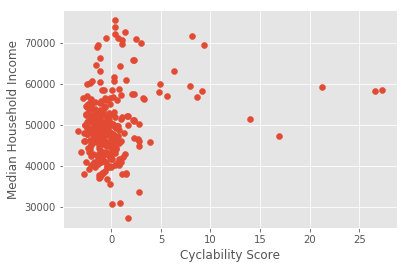

In [120]:
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
matplotlib.style.use('ggplot')

plt.scatter(x, y)
plt.xlabel("Cyclability Score")
plt.ylabel("Median Household Income")
plt.show()

#### Correlational Analysis between Average Monthly Rent and Cyclability Score

In [80]:
sqlcmd = """
         SELECT area_id, avg_monthly_rent
         FROM CensusStats;
         """
rent_dataset = pgquery(conn, sqlcmd)

for row in cyc_score_and_income:
    for row1 in rent_dataset:
        if row['area_id'] == row1[0]:
            row['avg_monthly_rent'] = row1[1]

In [81]:
# Removing an entry with None Average Household Income!
temp = []
for row in cyc_score_and_income:
    entry = {}
    entry['area_id'] = row['area_id']
    entry['income'] = row['income']
    entry['cyclability_score'] = row['cyclability_score']
    if row['avg_monthly_rent'] == None:
        continue
    else:
        entry['avg_monthly_rent'] = row['avg_monthly_rent']
    temp.append(entry)
cyc_score_and_income = temp

In [116]:
import numpy as np
x1 = [row['cyclability_score'] for row in cyc_score_and_income]
y1 = [row['avg_monthly_rent'] for row in cyc_score_and_income]

corr_coeff = np.corrcoef(y1, x1)[0][1]
print("Correlation Coefficient between Cyclability Score and Average Monthly Rent is "+ str(corr_coeff))

Correlation Coefficient between Cyclability Score and Average Monthly Rent is 0.21321580503202167


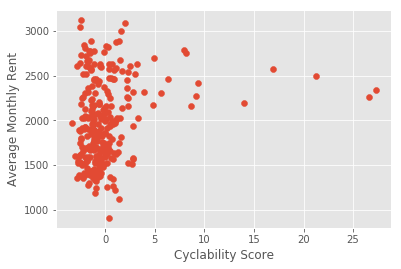

In [119]:
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
matplotlib.style.use('ggplot')

plt.scatter(x1, y1)
plt.xlabel("Cyclability Score")
plt.ylabel("Average Monthly Rent")
plt.show()